In [1010]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import matplotlib.dates as mdates
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

229


In [1011]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [1012]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [1522]:
def forecastRRA(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    acoef = [0.00022402, 0.01432195]
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/((acoef[0]*t+acoef[1]))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel, dtt, allmodel_1) 
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.set_ylim([0,1.1*max(max(waveform_1),max(allmodel*(1+3*diffStd0)))])
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    #formatter = mdates.ConciseDateFormatter(locator)
    locator = mdates.AutoDateLocator()
    formatter = mdates.ConciseDateFormatter(locator)
    formatter.formats = ['%y',  # ticks are mostly years
                         '%b',       # ticks are mostly months
                         '%d',       # ticks are mostly days
                         '%H:%M',    # hrs
                         '%H:%M',    # min
                         '%S.%f', ]  # secs
    # these are mostly just the level above...
    formatter.zero_formats = [''] + formatter.formats[:-1]
    # ...except for ticks that are mostly hours, then it is nice to have
    # month-day:
    formatter.zero_formats[3] = '%d-%b'

    formatter.offset_formats = ['',
                                '%Y',
                                '%b %Y',
                                '%d %b %Y',
                                '%d %b %Y',
                                '%d %b %Y %H:%M', ]
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t[-1],tt+8,allmodel 

def forecast2RRA(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a) 
    acoef = [0.00022485, 0.01425859]#[0.00022468, 0.01427208]
    def model(t, coeffs):
        coeffsUS=coeffs2#[5.34712379e+04,  1.87189938e+01, -9.10329896e+01,  2.63753359e-03]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+model0(t, coeffsUS))/(acoef[0]*t+acoef[1])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  (coeffs[0]*coeffs[1]*np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2]))/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]))/(acoef[0]*t+acoef[1])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    #x0 = np.array([5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03], dtype=float)
    x0 = np.array([5.40599372e+03, 4.02558326e+00, 9.34289930e+01, 9.87224726e-01], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
        
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    ax2.plot(dateSP[t+8], waveform_1, dtt, allmodel,dtt, allmodel_1)
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_RA.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_RA.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x, t+8,allmodel 

def forecast2RRD(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases',amc=1.0):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    dateSP = pd.to_datetime(dfSP['date'].values)
    dtt = pd.date_range(dateSP[0], periods=len(waveform_1)+period)
    dtt = pd.to_datetime(dtt.values)
    #years = mdates.YearLocator()   # every year
    #months = mdates.MonthLocator()  # every month
    #years_fmt = mdates.DateFormatter('%Y')
    # format the ticks
    #ax2.xaxis.set_major_locator(years)
    #ax2.xaxis.set_major_formatter(years_fmt)
    #ax2.xaxis.set_minor_locator(months)
    #ax2.format_xdata = mdates.DateFormatter('%Y-%m-%d')
    ax2.plot(dateSP[t[:]+8], waveform_1,dtt, allmodel,dtt, allmodel_1)
    #print (dtt)
    #print (dateSP)
    #print (dateSP[t+8])
    ax2.plot(dateSP[t[-1]+8],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(dtt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, date')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
#    locator = mdates.AutoDateLocator()
#    formatter = mdates.ConciseDateFormatter(locator)
#    formatter.formats = ['%y',  # ticks are mostly years
#                         '%b',       # ticks are mostly months
#                         '%d',       # ticks are mostly days
#                         '%H:%M',    # hrs
#                         '%H:%M',    # min
#                         '%S.%f', ]  # secs
#    # these are mostly just the level above...
#    formatter.zero_formats = [''] + formatter.formats[:-1]
#    # ...except for ticks that are mostly hours, then it is nice to have
#    # month-day:
#    formatter.zero_formats[3] = '%d-%b'
#
#    formatter.offset_formats = ['',
#                                '%Y',
#                                '%b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y',
#                                '%d %b %Y %H:%M', ]
    locator = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter = mdates.ConciseDateFormatter(locator)
    ax2.xaxis.set_major_locator(locator)
    ax2.xaxis.set_major_formatter(formatter)
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(dateSP[t[:-1]+8], np.diff(waveform_1),dtt[:-1], np.diff(allmodel))
    ax3.plot(dateSP[t[-1]+8], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(dtt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    locator3 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter3 = mdates.ConciseDateFormatter(locator3)
    ax3.xaxis.set_major_locator(locator3)
    ax3.xaxis.set_major_formatter(formatter3)
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, date')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    #z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ds = 35
    ds = int(ds*amc)
    ttt20=np.array([np.sum(np.diff(allmodel[-ds+i:i])) for i in range(ds,len(allmodel))])
    ttt19=np.array([np.sum(np.diff(allmodel_1[-ds+i:i])) for i in range(ds,len(allmodel_1))])
    ax4.plot(dateSP[t[:]+8], dfSP["active"][:],dtt[ds:], ttt20,dtt[ds:], ttt19)
    #ax4.plot(dateSP[t[:-3]+8],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    #ax4.fill_between(dateSP[t[:-1]+8], 0.8078285535018691, 1.,color='r',alpha=0.2)
    diffStd0a = np.std(1-dfSP["active"].values[ds:]/ttt20[:len(dfSP["active"].values[ds:])])
    print ('diffStd0a',diffStd0a)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+2*diffStd0a), alpha=0.2)
    ax4.fill_between(dtt[ds:], ttt20*(1-diffStd0a), ttt20*(1+3*diffStd0a), alpha=0.2)
    ax4.plot(dateSP[t[-1]+8],dfSP["active"].tail(1).values[0],'ro')
    loc = 'upper left'
    if Cntr=='USA' or Cntr=='Indonesia' or Cntr=='World':
        loc = 'upper right' 
    ax4.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc=loc) 
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('Total actives')
    ax4.set_xlabel('t, days')
    ax4.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    ax4.yaxis.tick_right()
    locator4 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter4 = mdates.ConciseDateFormatter(locator4)
    ax4.xaxis.set_major_locator(locator4)
    ax4.xaxis.set_major_formatter(formatter4)
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(dateSP[xt],yt,label=Cntr1)
    ax5.plot(dtt[range(x_pred12t)],y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(dtt[range(x_pred12t0)],y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(dateSP[vL], color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    locator5 = mdates.AutoDateLocator(minticks=3, maxticks=7)
    formatter5 = mdates.ConciseDateFormatter(locator5)
    ax5.xaxis.set_major_locator(locator5)
    ax5.xaxis.set_major_formatter(formatter5)
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


In [1035]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [1036]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [1037]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [1038]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1946369,NaN,46626.0,NaN,1641278.0,NaN,258465,2509.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1039]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
229,NaN,Total:,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
230,NaN,Total:,1946369,NaN,46626.0,NaN,1641278.0,NaN,258465,2509.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
231,NaN,Total:,41865,7.0,993.0,NaN,32879.0,NaN,7993,24.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
232,NaN,Total:,721,NaN,15.0,NaN,659.0,NaN,47,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
233,NaN,European Union,8851422,10099.0,207469.0,232.0,2321080.0,NaN,4291074,23726.0,19879.644653,465.960158,130784223.0,293731.77321,NaN,Europe,NaN,NaN,NaN


In [1040]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,Asia,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
2,NaN,South America,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
3,NaN,Europe,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,1946369,NaN,46626.0,NaN,1641278.0,NaN,258465,2509.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [1041]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
94,88.0,Lithuania,29812,0.0,244.0,0.0,7096.0,0,22472,83.0,11009.0,90.0,1146969.0,423544.0,"2,708,028",Europe,91,"11,098",2


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


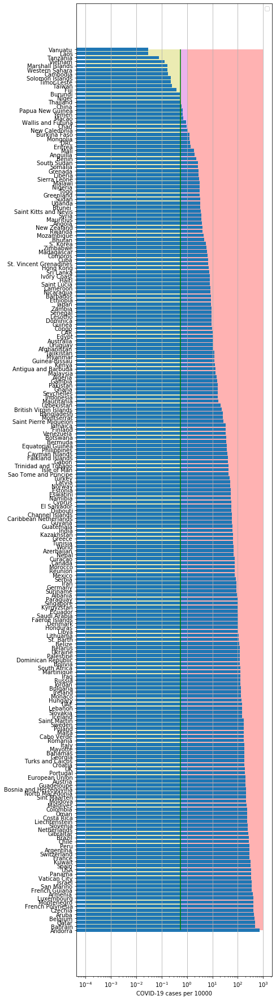

In [1042]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:816: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


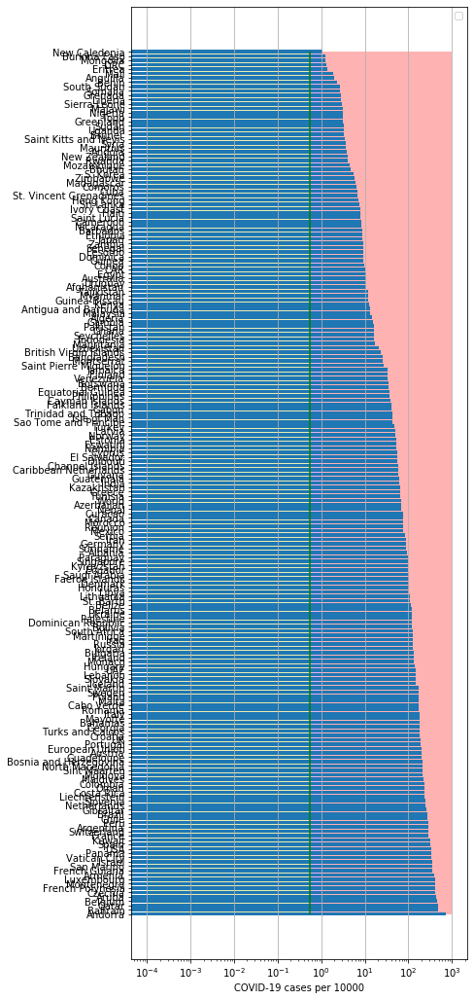

In [1043]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

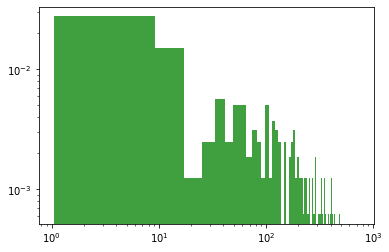

In [1044]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [1045]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date    cases  active    death
267 2020-11-08  1413756       0  38833.0
268 2020-11-09  1426602       0  39345.0
269 2020-11-10  1443997       0  39756.0
270 2020-11-11  1463093       0  40105.0
271 2020-11-12  1484868       0  40461.0
GB
           date    cases  active    death
256 2020-11-08  1192013       0  49044.0
257 2020-11-09  1213363       0  49238.0
258 2020-11-10  1233775       0  49770.0
259 2020-11-11  1256725       0  50365.0
260 2020-11-12  1290195       0  50928.0
IT
           date    cases  active    death
259 2020-11-08   935104  558636  41394.0
260 2020-11-09   960373  573334  41750.0
261 2020-11-10   995463  590110  42330.0
262 2020-11-11  1028424  613358  42953.0
263 2020-11-12  1066401  635054  43589.0
LT
           date    cases  active  death      tests
244 2020-11-08  25755.0   19629  210.0  1106660.0
245 2020-11-09  26841.0   20658  221.0  1119422.0
246 2020-11-10  28262.0   21419  235.0  1132514.0
247 2020-11-11  29812.0   22382  244.0  114696

IR
           date    cases  active   death
253 2020-11-08  65394.0   40083  1947.0
254 2020-11-09  65659.0   40347  1948.0
255 2020-11-10  65889.0   40562  1963.0
256 2020-11-11  66247.0   40918  1965.0
257 2020-11-12  66632.0   41303  1965.0
CL
           date   cases  active    death
250 2020-11-08  521558    9604  14543.0
251 2020-11-09  522879    9387  14588.0
252 2020-11-10  523907    9154  14611.0
253 2020-11-11  524804    8745  14633.0
254 2020-11-12  526438    9264  14699.0
CH
           date     cases  active   death
252 2020-11-08  414828.0  166841  4858.0
253 2020-11-09  417181.0  168148  5028.0
254 2020-11-10  429880.0  147084  5323.0
255 2020-11-11  438805.0  147994  5570.0
256 2020-11-12  446675.0  140201  5755.0
RM
           date     cases    active   death
256 2020-11-08  303751.0   91193.0  7879.0
257 2020-11-09  306991.0   92189.0  8009.0
258 2020-11-10  314295.0   94701.0  8186.0
259 2020-11-11  324094.0   97619.0  8389.0
260 2020-11-12  334236.0  100810.0  8510.0


In [1046]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [1047]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.587194154642148
intercept: 1.5487365798361807
slope: [0.01695063]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


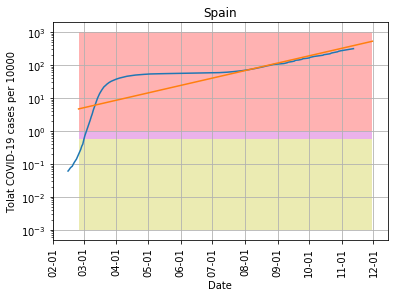

In [1048]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-11-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [1049]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.5583695793503783
intercept: -0.01865415981583496
slope: [0.0229491]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


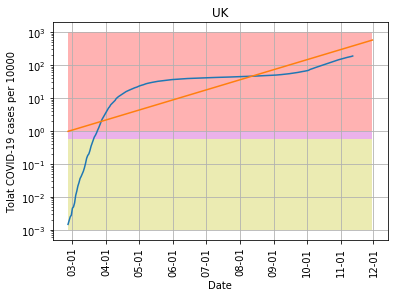

In [1050]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-11-30', "pictures/coronaGB.png", model1, 'UK',1000)

In [1051]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 7.01378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6483678595487938
intercept: 1.5944665163185179
slope: [-0.00328802]


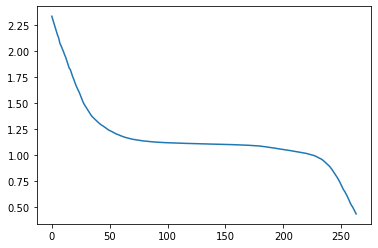

In [1052]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


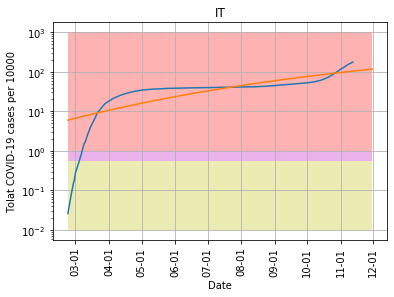

In [1053]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-11-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [1054]:
cs=y_pred11[-1]/10000.*populationIT

In [1055]:
cs

704813.789840351

In [1056]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6319241607229666
intercept: -0.09350152874095419
slope: [0.01633132]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


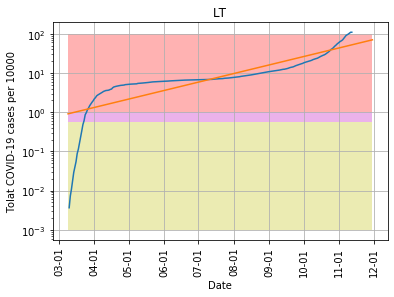

In [1057]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-11-30', "pictures/coronaLT.png", model1, 'LT',100)

In [1058]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7396907139678129
intercept: -1.9886293174788803
slope: [0.03100183]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


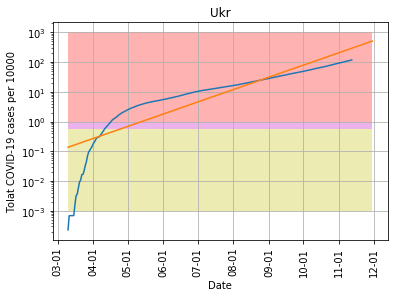

In [1059]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-11-30', "pictures/coronaUkr.png", model11, 'Ukr',1000)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


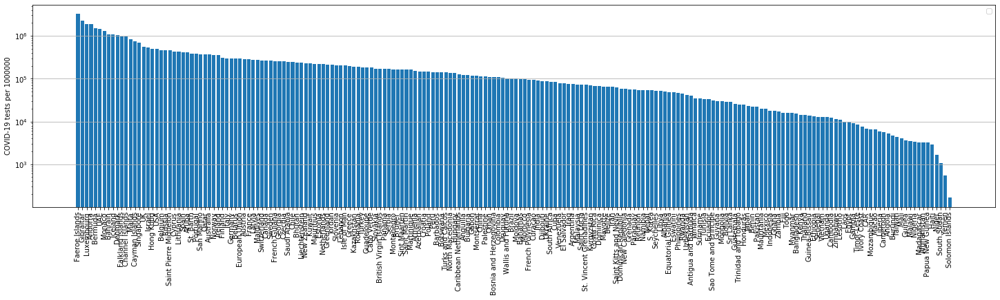

In [1060]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [1061]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6100568311876027
intercept: 0.5296464727475749
slope: [0.0255717]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:52: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


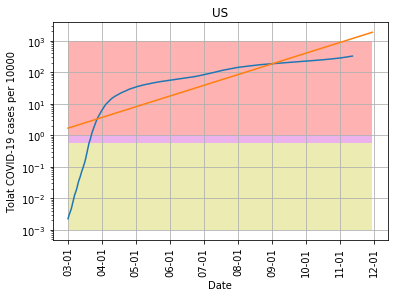

In [1062]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-11-30', "pictures/coronaUS.png", model11, 'US',1000)

In [1063]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
233  European Union  0.023439


Text(0.5, 1.0, 'Death rate')

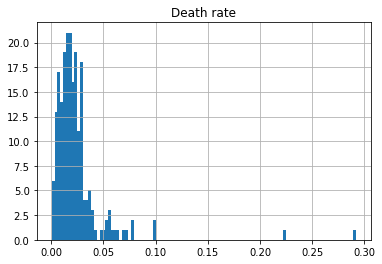

In [1064]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
#plt.xlim([0,0.15])

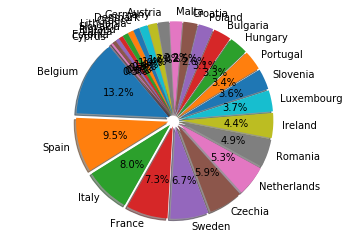

In [1065]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [1066]:
dfTTh.head()

,Country,Deathsper1Mpop
24,Belgium,1197.0
12,Spain,865.0
16,Italy,721.0
10,France,658.0
44,Sweden,605.0


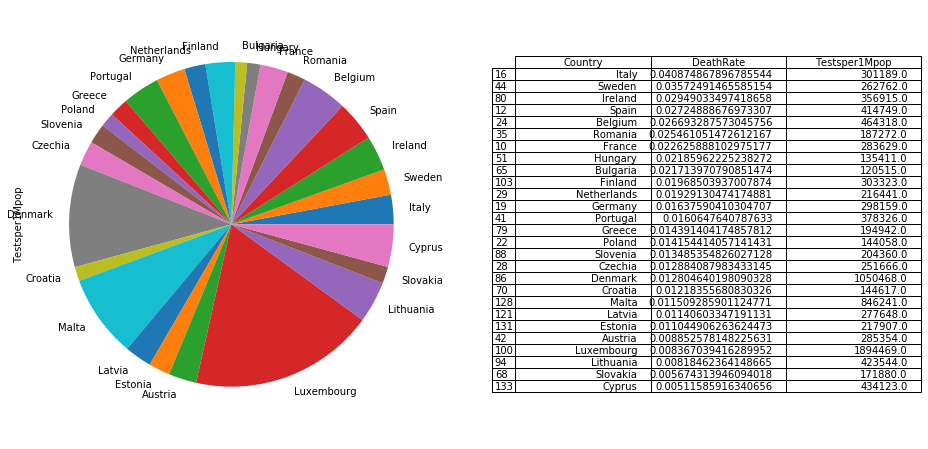

In [1067]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
#dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

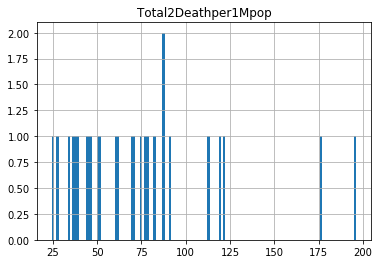

In [1068]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [1069]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
10,France,29065.0,658.0
12,Spain,31754.0,865.0
16,Italy,17647.0,721.0
19,Germany,8937.0,146.0
22,Poland,16957.0,240.0


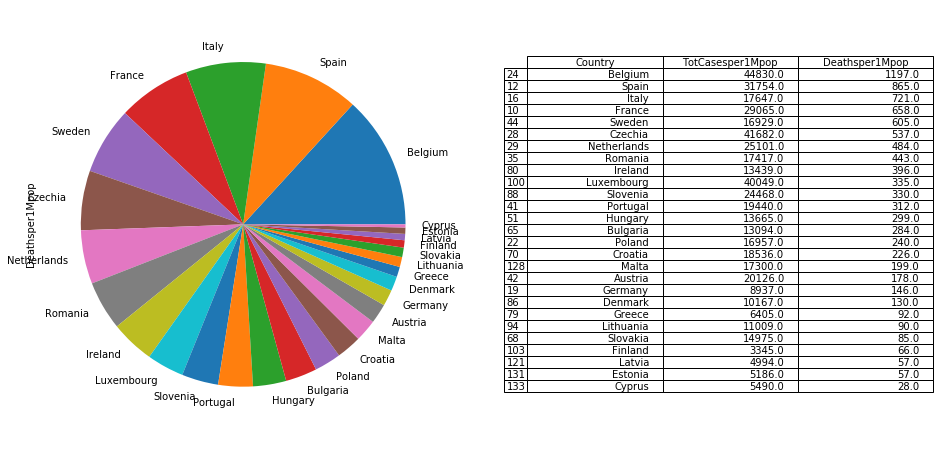

In [1070]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [1071]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,Asia,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
2,0.0,South America,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
3,0.0,Europe,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,1946369,0.0,46626.0,0.0,1641278.0,0,258465,2509.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [1072]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
10,France,0.102475
12,Spain,0.076562
16,Italy,0.058591
19,Germany,0.029974
22,Poland,0.117710


In [1073]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
     Czechia             0.165624
     Croatia             0.128173
    Slovenia             0.119730
      Poland             0.117710
 Netherlands             0.115972
    Bulgaria             0.108650
      France             0.102475
     Hungary             0.100915
     Belgium             0.096550
     Romania             0.093004
    Slovakia             0.087125
       Spain             0.076562
     Austria             0.070530
      Sweden             0.064427
       Italy             0.058591
    Portugal             0.051384
     Ireland             0.037653
      Greece             0.032856
     Germany             0.029974
   Lithuania             0.025993
     Estonia             0.023799
  Luxembourg             0.021140
       Malta             0.020443
      Latvia             0.017987
      Cyprus             0.012646
     Finland             0.011028
     Denmark             0.009679


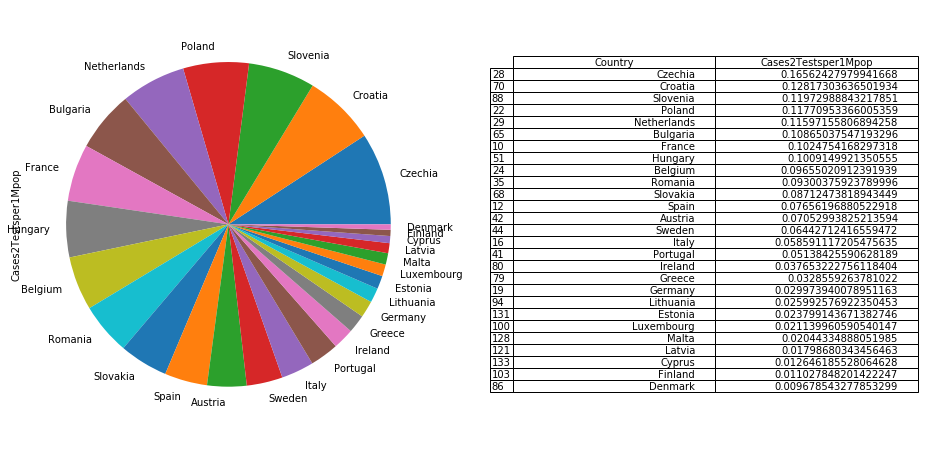

In [1074]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [1075]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
87,Singapore,0.000482,693154.0
177,Gibraltar,0.001157,2247069.0
181,Burundi,0.001605,4732.0
171,Curaçao,0.001646,92631.0
48,Qatar,0.001732,368950.0
...,...,...,...
109,Sudan,0.077495,0.0
17,Mexico,0.097855,19886.0
219,Western Sahara,0.100000,0.0
220,MS Zaandam,0.222222,0.0


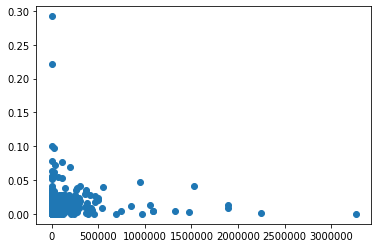

In [1076]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


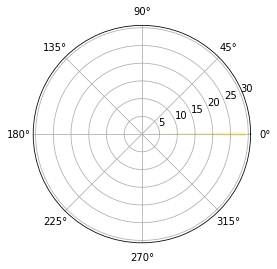

In [1077]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

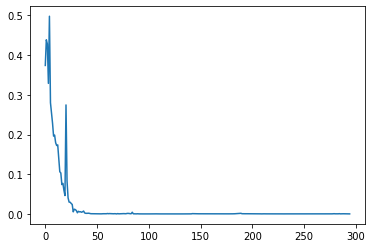

In [1078]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [1079]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


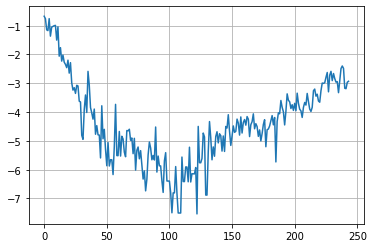

In [1080]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

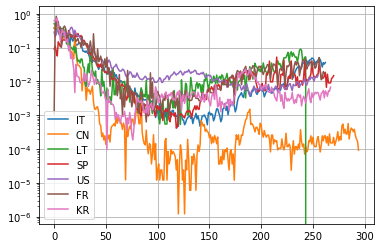

In [1081]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

256 256
coefficient of determination: 0.6645920235336761
intercept: -13.486090374495085
slope: [-0.03744865]


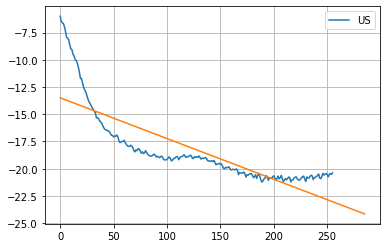

In [1082]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [1083]:
#np.diff(dfIT["cases"])

263 263
coefficient of determination: 0.28364202154202456
intercept: -14.51563922325397
slope: [-0.01892293]


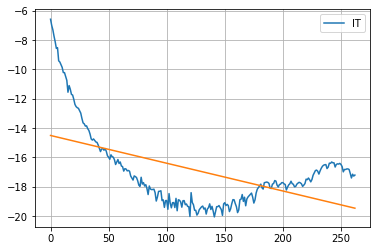

In [1084]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [1085]:
#model11.coef_

In [1086]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

245 245
coefficient of determination: 0.8610494805493706
intercept: -16.827578390936566
slope: [-0.02680092]


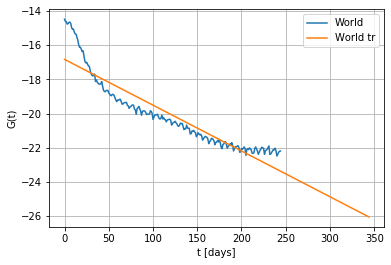

In [1087]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

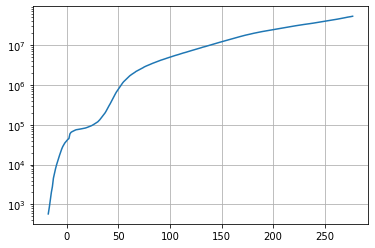

In [1088]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [1089]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 1.76509812e+08  3.12417539e-01 -3.26301148e+02  1.96124909e-02]


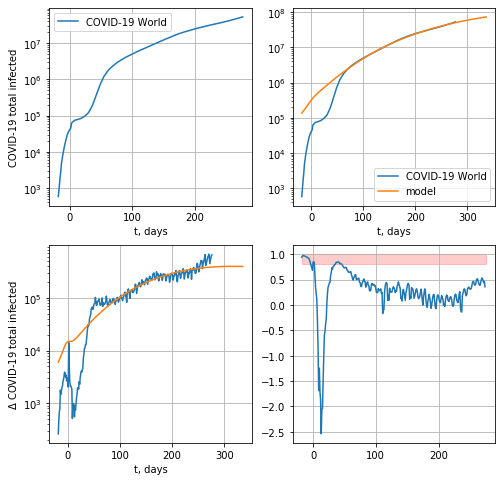

555133.0583360848


In [1090]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

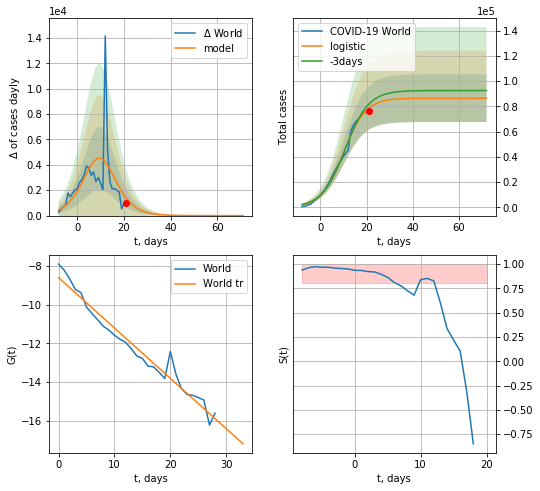

World data at: 2020-11-12
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  86473 ± 18834
	 total death:  2115 ± 1382
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


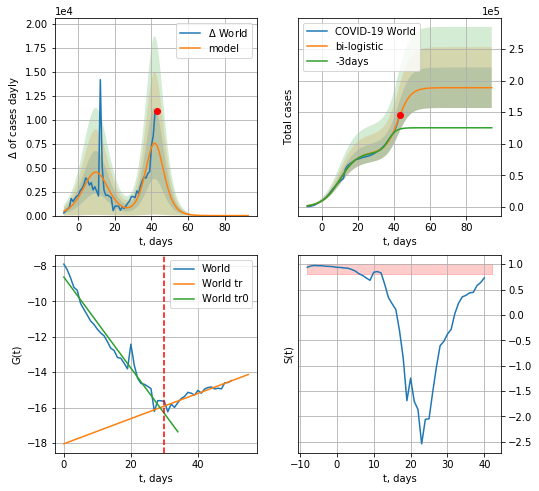

World data at: 2020-11-12
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  188701 ± 32065
	 total death:  4617 ± 2353
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp


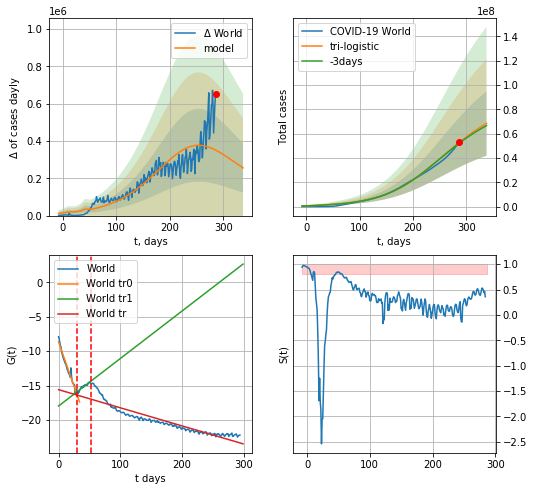

World data at: 2020-11-12
+3 day model MAPE: 0.012407683350335562
model: tri-logistic
coeffs:  [7.25099773e+07 1.91972161e-02 2.46860775e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.38739743242489344
forecast at the end of period: +51 days
	 deltaDaycases:  255725
	 total cases:  68301370 ± 26459775
	 total death:  1671189 ± 1942242
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.863434
 intercept: -15.588018
 slope: -0.026330


In [1091]:
vL = 30
T18 = 40
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

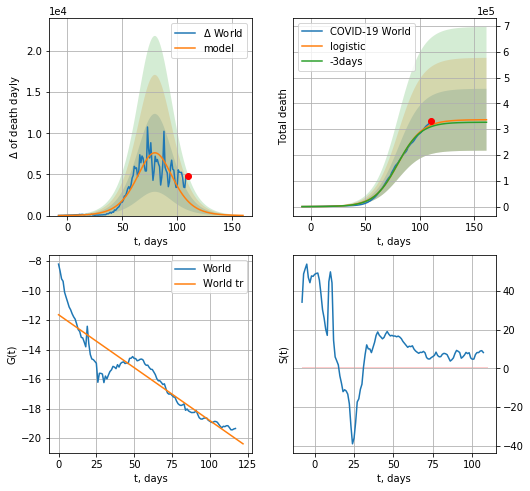

World data at: 2020-11-12
+3 day model MAPE: 0.020621037522772532
model: logistic
coeffs:  [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.356220604376718
forecast at the end of period: +51 days
	 total death:  336444 ± 119848
trend coefficient of determination: 0.862243
 intercept: -11.641434
 slope: -0.071737


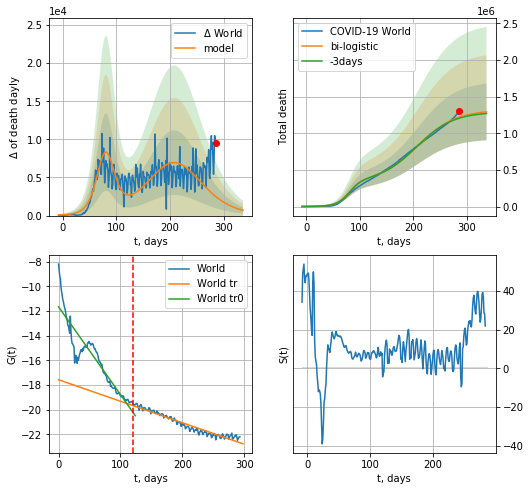

World data at: 2020-11-12
+3 day model MAPE: 0.011416100748452092
model: bi-logistic
coeffs:  [9.80153757e+05 2.83789612e-02 2.08177040e+02] [3.36666036e+05 9.06319611e-02 8.01803344e+01]
rational stdev:  0.29916810325807364
forecast at the end of period: +51 days
	 deltaDaydeath:  692
	 total death:  1292131 ± 386564
bi-logistic approximation splitting point: 120
trend0 coefficient of determination: 0.864805
 intercept: -11.666935
 slope: -0.071086
trend coefficient of determination: 0.942937
 intercept: -17.577013
 slope: -0.017408


In [1092]:
vL = 120#30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [1093]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


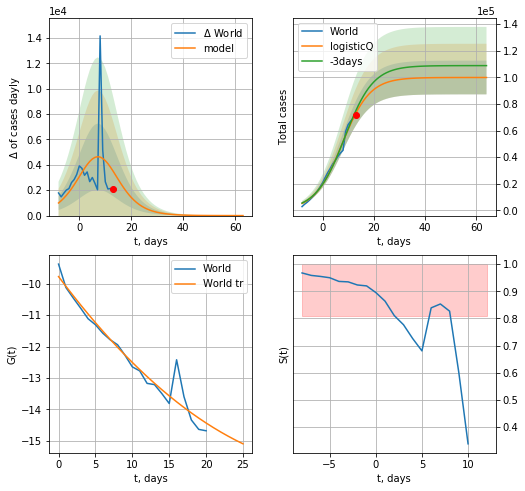

World data at: 2020-11-12
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 99861 ± 12678
	 total death: 2443 ± 930
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


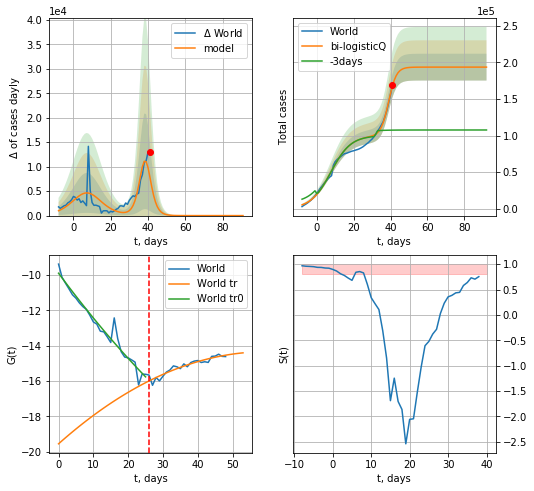

World data at: 2020-11-12
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 193626 ± 18336
	 total death: 4737 ± 1345
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


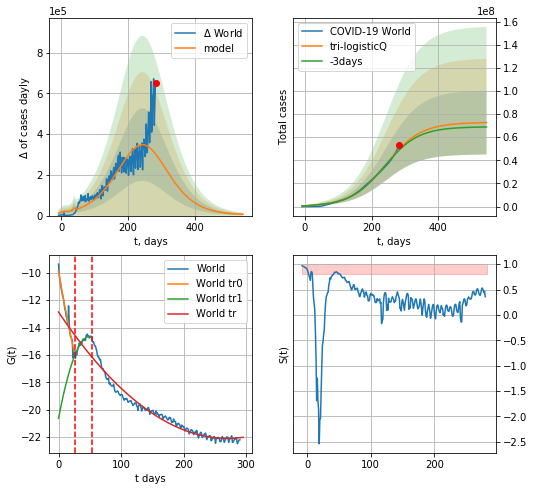

World data at: 2020-11-12
+3 day model MAPE: 0.016289
model: tri-logisticQ
coeffs: [ 7.24775813e+07  9.32963091e-08  2.42831181e+02 -2.05601367e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379630
forecast at the end of period: +261 days
	 deltaDaycases: 5970
	 total cases: 72628598 ± 27571999
	 total death: 1777067 ± 2023884
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.962959
 intercept_: -12.872328563309296
 coeffs_: [ 0.         -0.06822257  0.00012624]


In [1094]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

In [1523]:
#vL = 55
#x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RRD("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

296


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


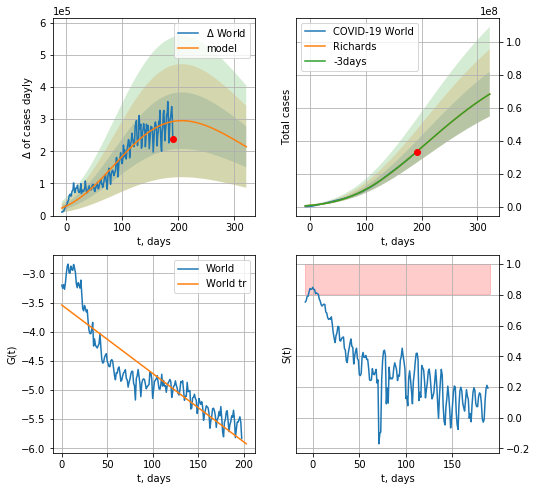

World data at: 2020-11-12
+3 day model MAPE: 0.000153
model: Richards
coeffs: [ 1.00574850e+08  1.59324796e-01 -1.56451036e+02  5.13454148e-02]
rational stdev: 0.198566
forecast at the end of period: +131 days
	 deltaDaycases: 213919
	 total cases: 68442068 ± 13590282
	 total death: 1674632 ± 997576
trend coefficient of determination: 0.817380
 intercept: -3.542094
 slope: -0.011731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


diffStd0a 0.11543231607844923


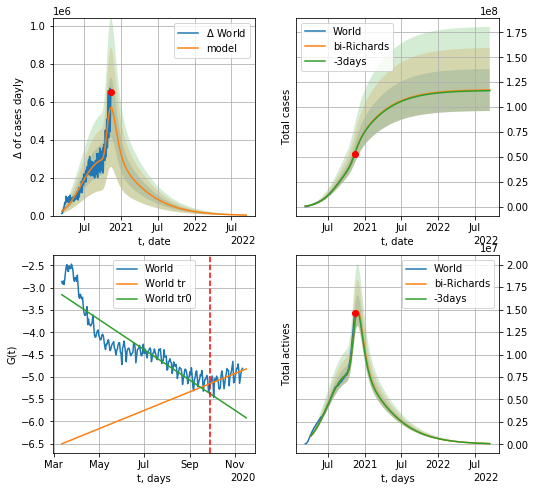

World data at: 2020-11-12
+3 day model MAPE: 0.000626
model: bi-Richards
coeffs: [1.69548585e+07 2.00689718e+00 1.54817539e+02 2.28284158e-02]
rational stdev: 0.179974
forecast at the end of period: +671 days
	 deltaDaycases: 2650
	 total cases: 117206499 ± 21094108
	 total death: 2867794 ± 1548384
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.812136
 intercept: -3.155547
 slope: -0.011103
trend coefficient of determination: 0.280706
 intercept: -6.503753
 slope: 0.006754


In [1524]:
print (len(dfW))
vL = 200+50
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("World",dfW[50:],d1,100*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50,amc=0.8)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


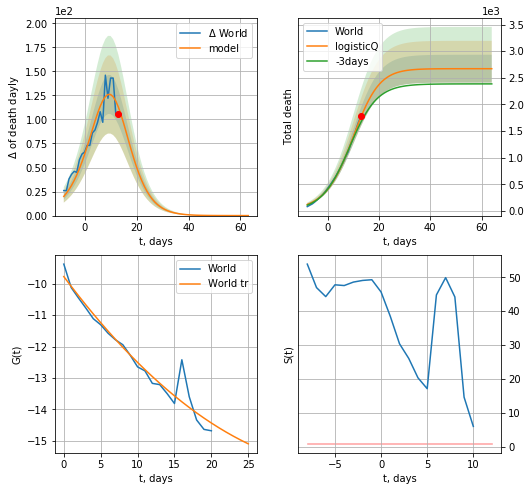

World data at: 2020-11-12
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +51 days
	 total death: 2670 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


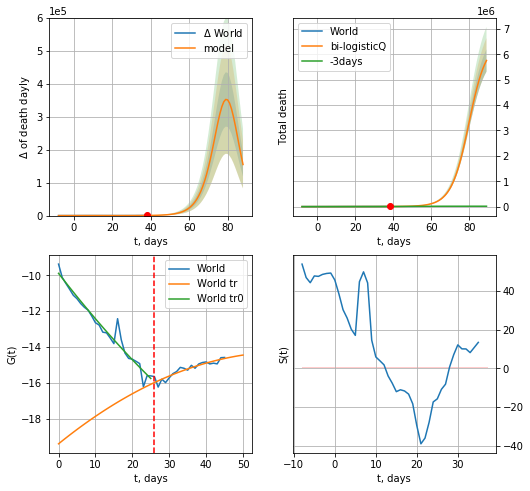

World data at: 2020-11-12
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +51 days
	 total death: 5758815 ± 441068
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


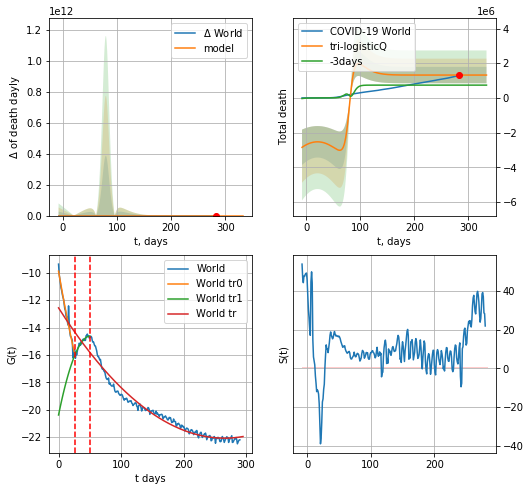

World data at: 2020-11-12
+3 day model MAPE: 0.786258
model: tri-logisticQ
coeffs: [-5.12518633e+06  3.02015084e-04  1.16652578e+01  2.94983167e+01]
rational stdev: 0.358691
forecast at the end of period: +51 days
	 total death: 1317587 ± 472607
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.960867
 intercept_: -12.56782032562003
 coeffs_: [ 0.         -0.07165103  0.00013502]


In [1097]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


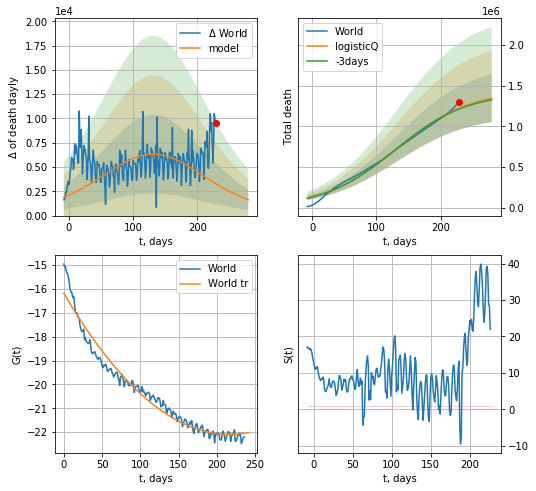

World data at: 2020-11-12
+3 day model MAPE: 0.009097
model: logisticQ
coeffs: [ 1.44517794e+06  1.13321135e-07  1.31496015e+02 -1.54358211e+05]
rational stdev: 0.217753
forecast at the end of period: +51 days
	 total death: 1345479 ± 292981
trend coefficient of determination: 0.962959
 intercept_: -16.18821042487327
 coeffs_: [ 0.         -0.05458941  0.00012624]


In [1098]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [1099]:
#trend(dfSP,'SP',10)

In [1100]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

In [1101]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    #x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    #xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

SP
           date    cases  active    death
267 2020-11-08  1413756       0  38833.0
268 2020-11-09  1426602       0  39345.0
269 2020-11-10  1443997       0  39756.0
270 2020-11-11  1463093       0  40105.0
271 2020-11-12  1484868       0  40461.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


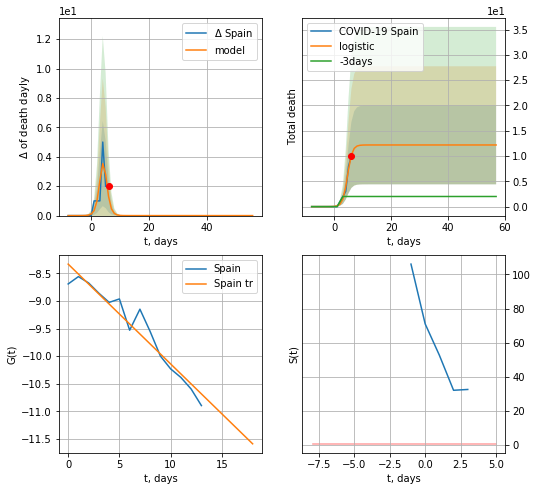

Spain data at: 2020-11-12
+3 day model MAPE: 4.756036700963932
model: logistic
coeffs:  [12.18291976  1.20295815  4.63698223]
rational stdev:  0.6384450788145528
forecast at the end of period: +51 days
	 total death:  12 ± 7
trend coefficient of determination: 0.932343
 intercept: -8.335143
 slope: -0.180548


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: invalid value encountered in true_divide


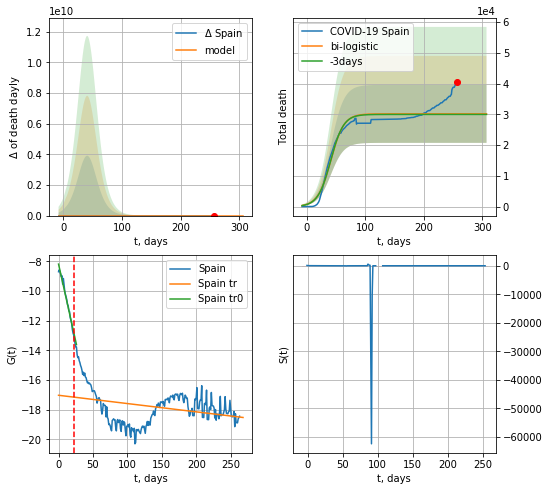

Spain data at: 2020-11-12
+3 day model MAPE: 0.0061396016911122115
model: bi-logistic
coeffs:  [3.01619379e+04 8.98579920e-02 4.12112223e+01] [12.18291976  1.20295815  4.63698223]
rational stdev:  0.31251465226611824
forecast at the end of period: +51 days
	 deltaDaydeath:  0
	 total death:  30174 ± 9429
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.977622
 intercept: -8.181737
 slope: -0.208457
trend coefficient of determination: 0.093395
 intercept: -17.021523
 slope: -0.005581


In [1102]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


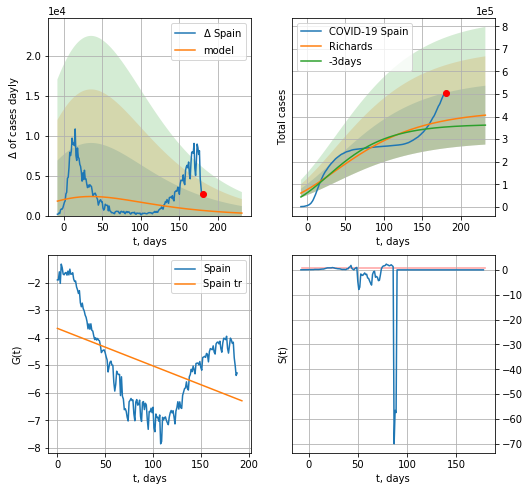

Spain data at: 2020-11-12
+3 day model MAPE: 0.082514
model: Richards
coeffs: [ 4.27280053e+05  3.16489052e+00 -3.13079673e+02  4.82672820e-03]
rational stdev: 0.320945
forecast at the end of period: +51 days
	 deltaDaycases: 313
	 total cases: 406389 ± 130429
	 total death: 11073 ± 10661
trend coefficient of determination: 0.201906
 intercept: -3.664041
 slope: -0.013609


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


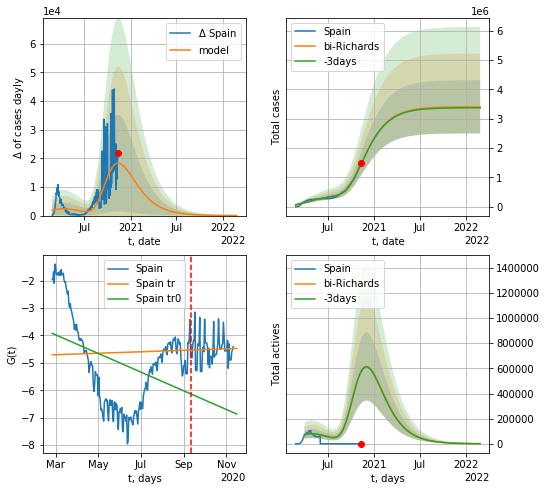

Spain data at: 2020-11-12
+3 day model MAPE: 0.001326
model: bi-Richards
coeffs: [ 2.97616862e+06  1.26930373e+00 -5.49219683e+00  1.31125679e-02]
rational stdev: 0.266692
forecast at the end of period: +471 days
	 deltaDaycases: 20
	 total cases: 3402226 ± 907345
	 total death: 92706 ± 74171
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.156612
 intercept: -3.922396
 slope: -0.011107
trend coefficient of determination: 0.000976
 intercept: -4.708764
 slope: 0.000883


In [1103]:
iL = 10
vL = 200+iL#75+iL#135+1
x = forecastRR('Spain',dfSP[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Spain',dfSP[iL:],d12f(1),7*100-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


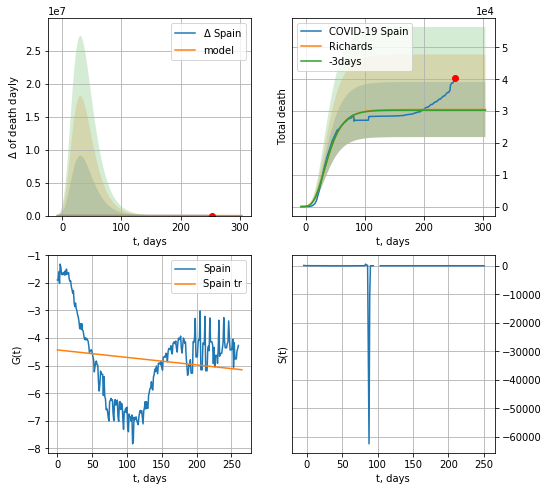

Spain data at: 2020-11-12
+3 day model MAPE: 0.006820
model: Richards
coeffs: [ 3.04992581e+04  1.69719056e+01 -6.89004325e+01  3.35527755e-03]
rational stdev: 0.283671
forecast at the end of period: +51 days
	 total death: 30499 ± 8651
trend coefficient of determination: 0.019833
 intercept: -4.430671
 slope: -0.002711


In [1104]:
x = forecastRR('Spain',dfSP[10:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

In [1105]:
#x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
#xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


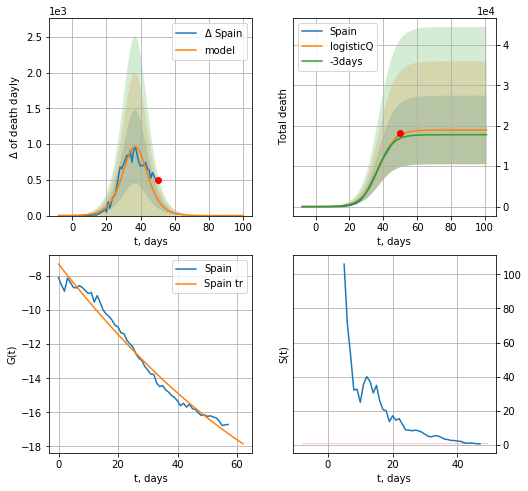

Spain data at: 2020-11-12
+3 day model MAPE: 0.047871
model: logisticQ
coeffs: [ 1.89599654e+04  5.38912704e-06  3.72491565e+01 -3.78046979e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.447682
forecast at the end of period: +51 days
	 total death: 18972 ± 8493
trend coefficient of determination: 0.978811
 intercept_: -7.301838938937334
 coeffs_: [ 0.         -0.22359908  0.00086295]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


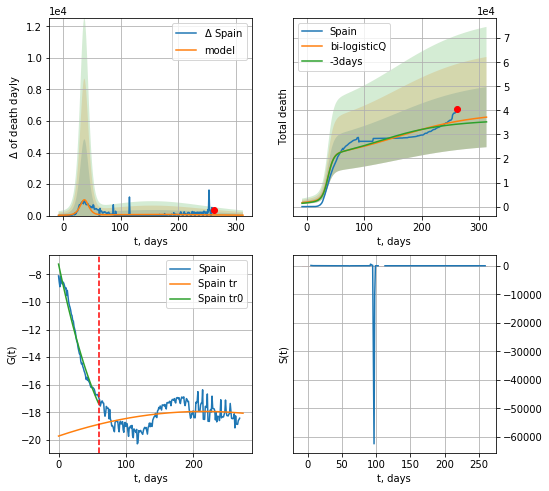

Spain data at: 2020-11-12
+3 day model MAPE: 0.034776
model: bi-logisticQ
coeffs: [ 1.94800820e+04  1.45570477e-08  1.54495789e+02 -1.01712518e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336244
forecast at the end of period: +51 days
	 total death: 37180 ± 12501
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.978897
 intercept_: -7.2487934110171
 coeffs_: [ 0.         -0.2311524   0.00102662]
trend coefficient of determination: 0.108397
 intercept_: -19.730026220669032
 coeffs_: [ 0.00000000e+00  1.65761807e-02 -3.83994647e-05]


In [1106]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [1107]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

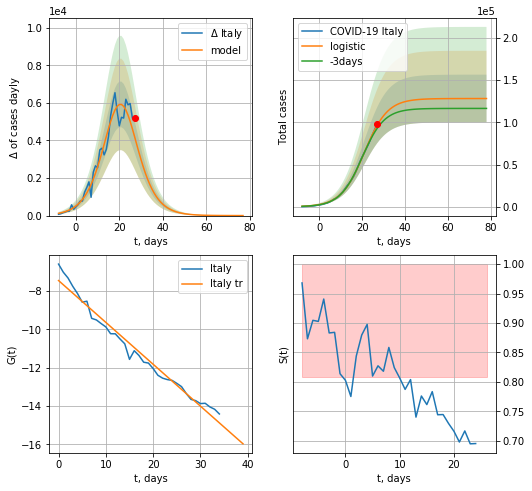

Italy data at: 2020-11-12
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  128135 ± 28273
	 total death:  5237 ± 3466
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


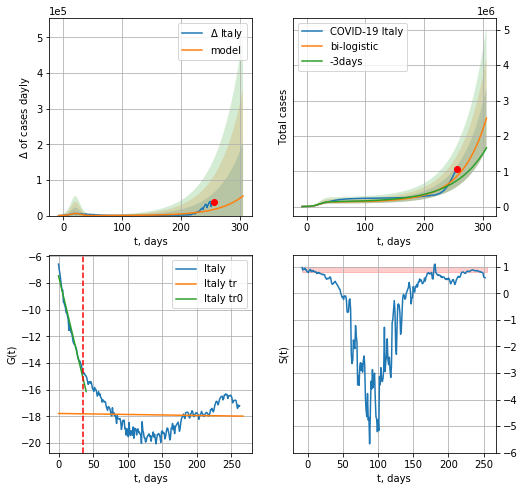

Italy data at: 2020-11-12
+3 day model MAPE: 0.16452458972860465
model: bi-logistic
coeffs:  [8.42921049e+09 2.34376580e-02 6.54777395e+02] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.3435510504085507
forecast at the end of period: +51 days
	 deltaDaycases:  54983
	 total cases:  2502317 ± 859673
	 total death:  102281 ± 105416
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.001499
 intercept: -17.792624
 slope: -0.000741


In [1108]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

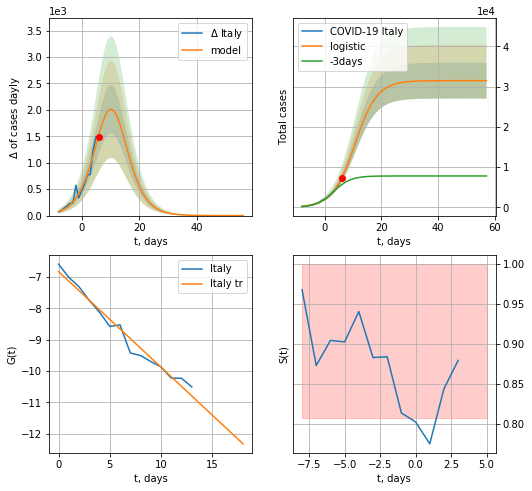

Italy data at: 2020-11-12
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  31497 ± 4456
	 total death:  1287 ± 546
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


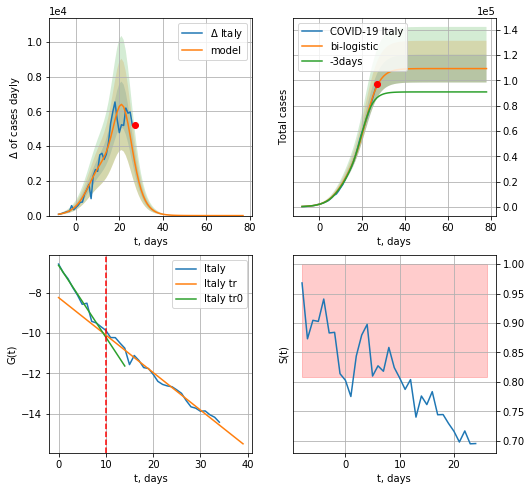

Italy data at: 2020-11-12
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  109362 ± 10990
	 total death:  4470 ± 1347
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:312: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


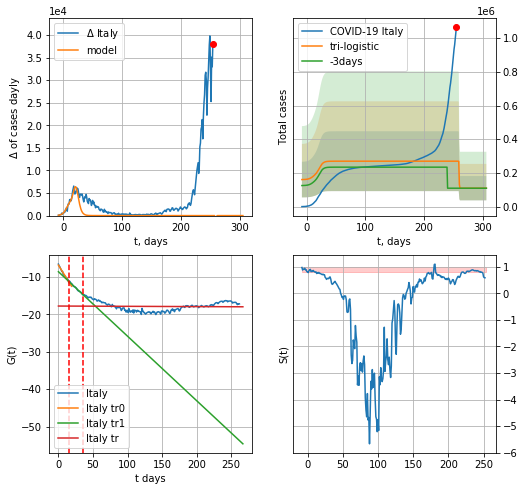

Italy data at: 2020-11-12
+3 day model MAPE: 1.4656047839485247
model: tri-logistic
coeffs:  [ 1.60281879e+05 -6.71829557e+00  2.59733177e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.6584955732811648
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  109362 ± 72014
	 total death:  4470 ± 8830
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.001499
 intercept: -17.792624
 slope: -0.000741


In [1109]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

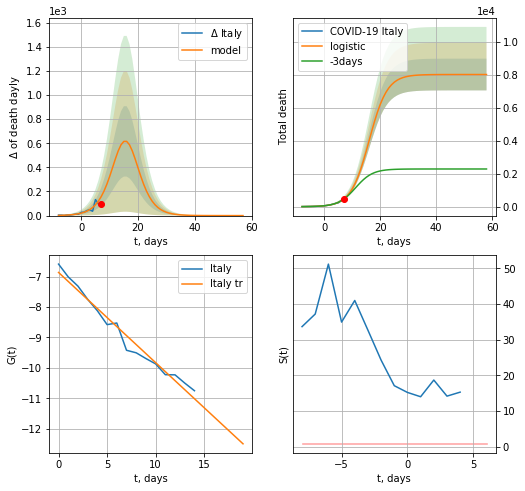

Italy data at: 2020-11-12
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +51 days
	 total death:  8021 ± 963
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


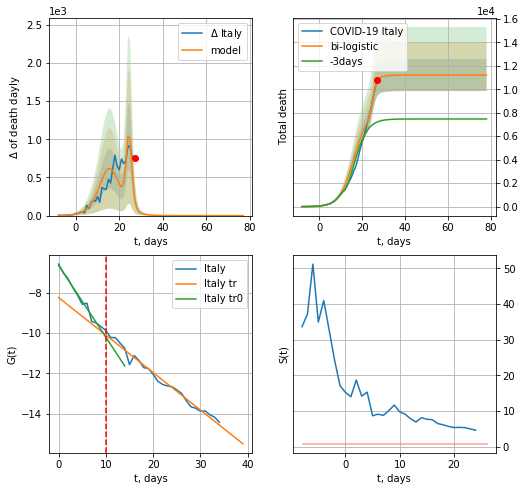

Italy data at: 2020-11-12
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +51 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


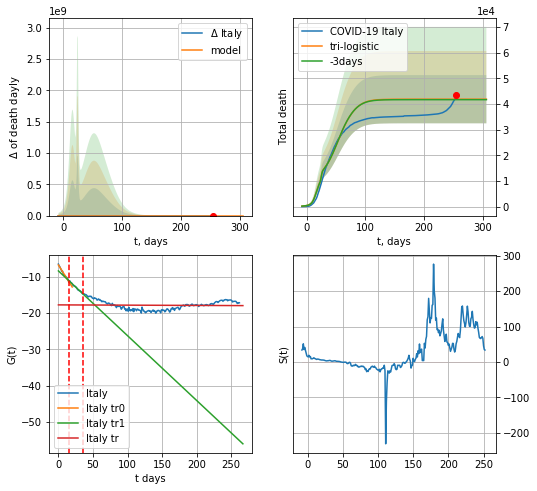

Italy data at: 2020-11-12
+3 day model MAPE: 0.004345593061161561
model: tri-logistic
coeffs:  [2.45534507e+04 8.30360984e-02 5.08462508e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.224340392188888
forecast at the end of period: +51 days
	 deltaDaydeath:  0
	 total death:  41903 ± 9400
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.001499
 intercept: -17.792624
 slope: -0.000741


In [1110]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


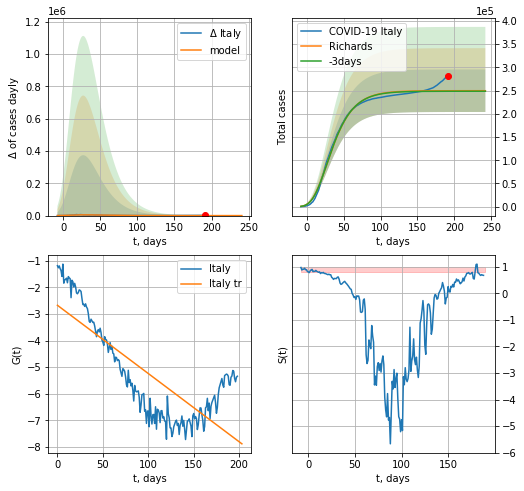

Italy data at: 2020-11-12
+3 day model MAPE: 0.004445
model: Richards
coeffs: [ 2.49818271e+05  1.03928665e+01 -7.87445552e+01  4.83991521e-03]
rational stdev: 0.183409
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 249813 ± 45818
	 total death: 10211 ± 5618
trend coefficient of determination: 0.624507
 intercept: -2.673566
 slope: -0.025683


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


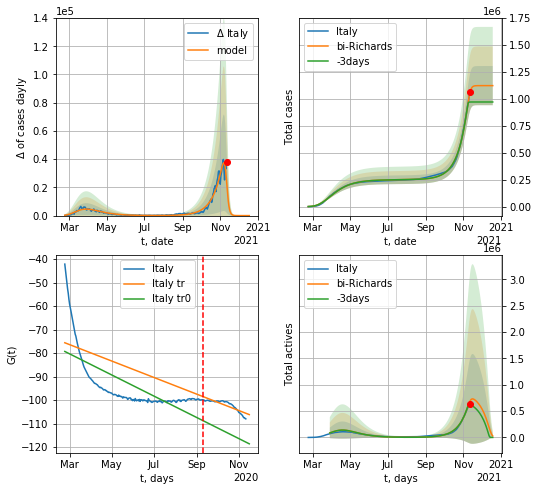

Italy data at: 2020-11-12
+3 day model MAPE: 0.111584
model: bi-Richards
coeffs: [8.72477224e+05 6.47510941e-02 2.54456760e+02 7.54107624e+00]
rational stdev: 0.161766
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 1122295 ± 181549
	 total death: 45873 ± 22262
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.498611
 intercept: -79.308059
 slope: -0.147235
trend coefficient of determination: 0.752702
 intercept: -75.605189
 slope: -0.114523


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


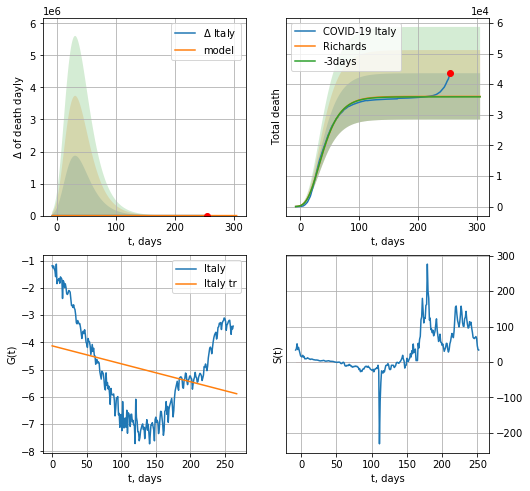

Italy data at: 2020-11-12
+3 day model MAPE: 0.004143
model: Richards
coeffs: [ 3.60170448e+04  1.04473968e+01 -7.63366994e+01  4.75180453e-03]
rational stdev: 0.210185
forecast at the end of period: +51 days
	 total death: 36017 ± 7570
trend coefficient of determination: 0.083999
 intercept: -4.125988
 slope: -0.006588


In [1410]:
vL=200#152
x = forecastRR('Italy',dfIT[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Italy',dfIT[:],d1,38*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

In [1112]:
#x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


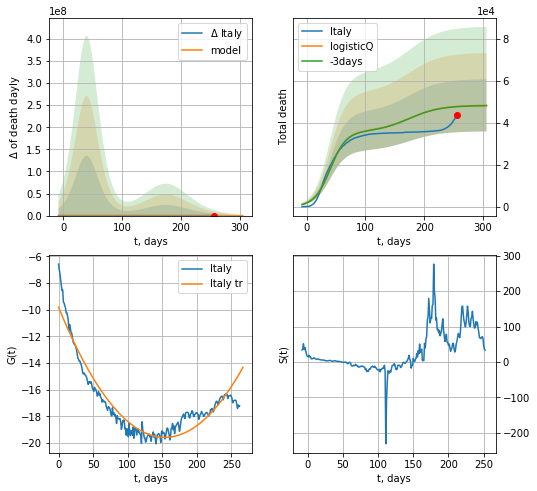

Italy data at: 2020-11-12
+3 day model MAPE: 0.003187
model: logisticQ
coeffs: [ 3.57002366e+04  1.08638526e-07  4.00468304e+01 -6.78273426e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.258032
forecast at the end of period: +51 days
	 total death: 48248 ± 12449
trend coefficient of determination: 0.902476
 intercept_: -9.824512132849444
 coeffs_: [ 0.         -0.1267651   0.00041161]


In [1113]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [1114]:
dT

229

FR
           date      cases   active    death
267 2020-11-08  1787324.0  1618271  40439.0
268 2020-11-09  1807479.0  1636757  40987.0
269 2020-11-10  1829659.0  1655532  42207.0
270 2020-11-11  1865538.0  1689307  42535.0
271 2020-11-12  1898710.0  1720796  42960.0


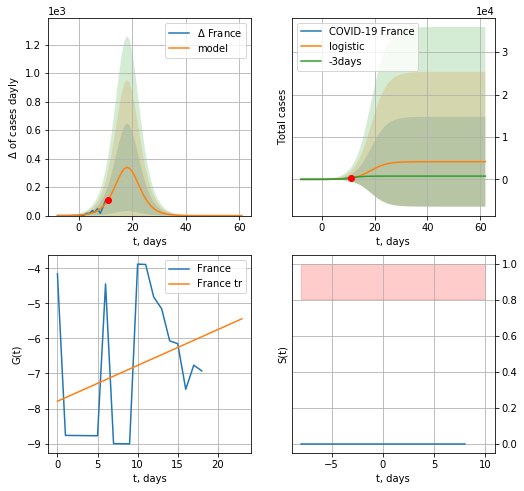

France data at: 2020-11-12
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  4173 ± 10597
	 total death:  94 ± 716
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


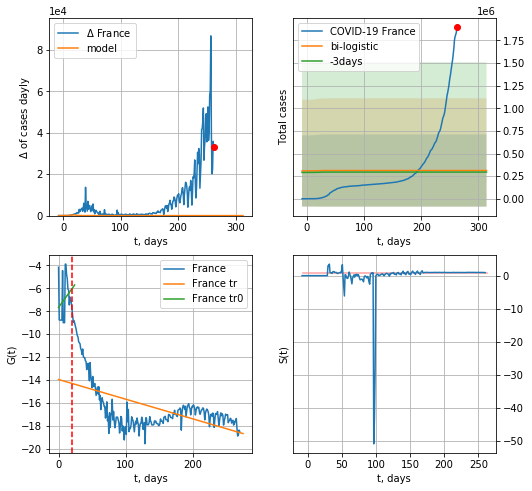

France data at: 2020-11-12
+3 day model MAPE: 0.05870703101493885
model: bi-logistic
coeffs:  [ 3.08047344e+05 -1.71889905e+01  4.18659967e+02] [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  1.2770254555547806
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  312221 ± 398714
	 total death:  7064 ± 27062
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.322805
 intercept: -13.967045
 slope: -0.017184


In [1115]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [1116]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

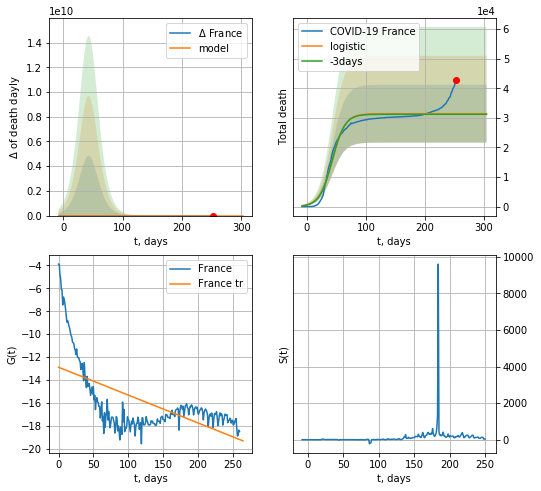

France data at: 2020-11-12
+3 day model MAPE: 0.006800221926093944
model: logistic
coeffs:  [3.14234269e+04 9.18324359e-02 4.32240293e+01]
rational stdev:  0.31116246887198296
forecast at the end of period: +51 days
	 total death:  31423 ± 9777
trend coefficient of determination: 0.379457
 intercept: -12.892571
 slope: -0.024302


In [1117]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


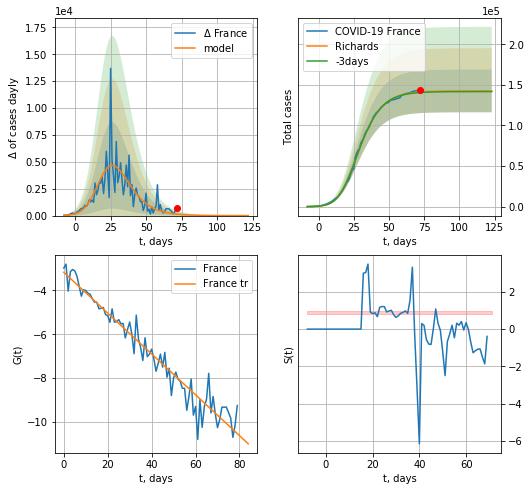

France data at: 2020-11-12
+3 day model MAPE: 0.005042
model: Richards
coeffs: [1.42540738e+05 3.12476603e-01 1.59919989e+01 3.30748014e-01]
rational stdev: 0.184343
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 142533 ± 26275
	 total death: 3224 ± 1782
trend coefficient of determination: 0.942455
 intercept: -3.170576
 slope: -0.093180


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


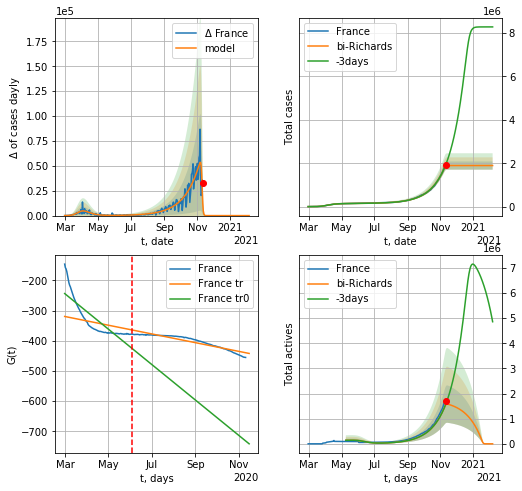

France data at: 2020-11-12
+3 day model MAPE: 0.088428
model: bi-Richards
coeffs: [1.75121512e+06 3.53789785e-02 2.47214417e+02 3.12053362e+01]
rational stdev: 0.099742
forecast at the end of period: +86 days
	 deltaDaycases: 0
	 total cases: 1893755 ± 188887
	 total death: 42847 ± 12820
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.715044
 intercept: -243.360773
 slope: -1.908537
trend coefficient of determination: 0.884246
 intercept: -319.284492
 slope: -0.469761


In [1411]:
vL = 95+14#100+14#86+14+40+29
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('France',dfFR[14:],d1,45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14,amc=2.0)

In [1119]:
#x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


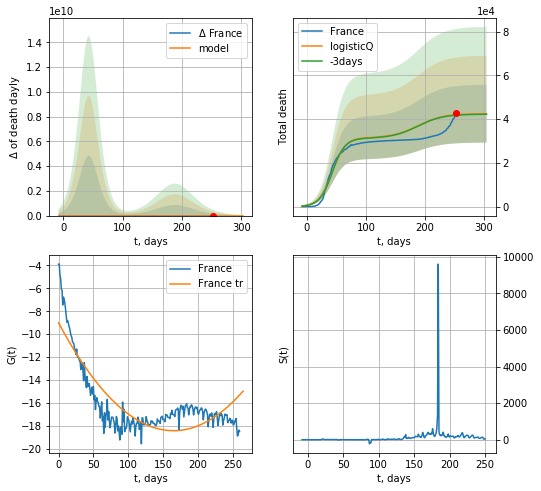

France data at: 2020-11-12
+3 day model MAPE: 0.005372
model: logisticQ
coeffs: [ 3.14234955e+04  1.21533336e-07  4.32251561e+01 -7.55300946e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311191
forecast at the end of period: +51 days
	 total death: 42499 ± 13225
trend coefficient of determination: 0.728514
 intercept_: -9.01063232446997
 coeffs_: [ 0.         -0.11423163  0.00034588]


In [1120]:
x = forecastRRR('France',dfFR[10:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [1121]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [1122]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

In [1123]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

GR
           date   cases  active    death
258 2020-11-08  672507  241802  11505.0
259 2020-11-09  688972  247715  11657.0
260 2020-11-10  705640  252580  11860.0
261 2020-11-11  726176  259294  12082.0
262 2020-11-12  749638  269562  12276.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


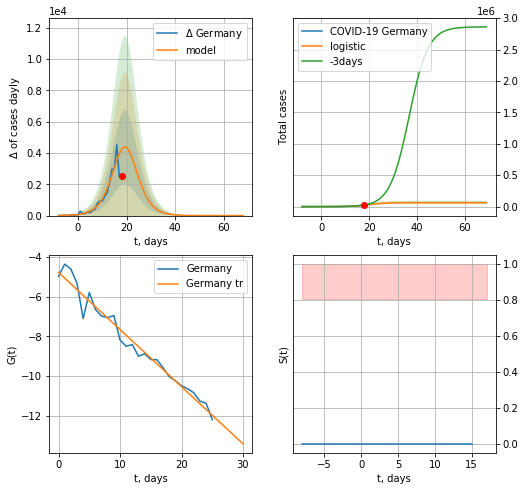

Germany data at: 2020-11-12
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  61550 ± 10963
	 total death:  1007 ± 538
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


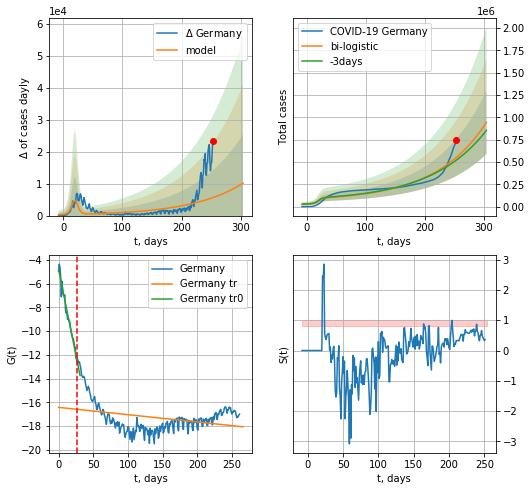

Germany data at: 2020-11-12
+3 day model MAPE: 0.06063565791308584
model: bi-logistic
coeffs:  [3.22429623e+09 1.15339373e-02 1.01617165e+03] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.37644269631746363
forecast at the end of period: +51 days
	 deltaDaycases:  10125
	 total cases:  944760 ± 355648
	 total death:  15471 ± 17471
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.102033
 intercept: -16.417006
 slope: -0.006142


In [1124]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

In [1125]:
dfGR = read_df(pd.DataFrame(),"GR")
#x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

GR
           date   cases  active    death
258 2020-11-08  672507  241802  11505.0
259 2020-11-09  688972  247715  11657.0
260 2020-11-10  705640  252580  11860.0
261 2020-11-11  726176  259294  12082.0
262 2020-11-12  749638  269562  12276.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


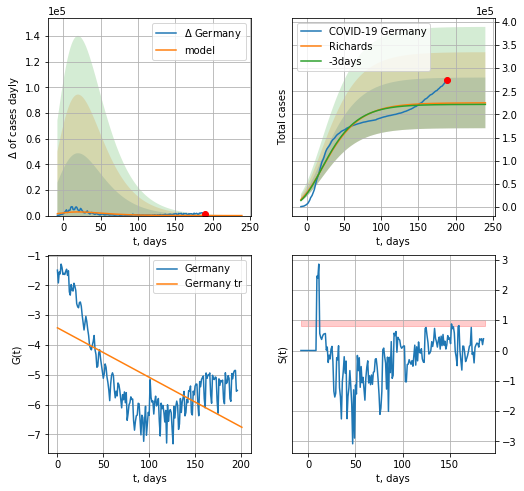

Germany data at: 2020-11-12
+3 day model MAPE: 0.014202
model: Richards
coeffs: [ 2.24991639e+05  1.08201736e+01 -1.45898747e+02  3.19943345e-03]
rational stdev: 0.243260
forecast at the end of period: +51 days
	 deltaDaycases: 3
	 total cases: 224880 ± 54704
	 total death: 3682 ± 2687
trend coefficient of determination: 0.409079
 intercept: -3.423509
 slope: -0.016610


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


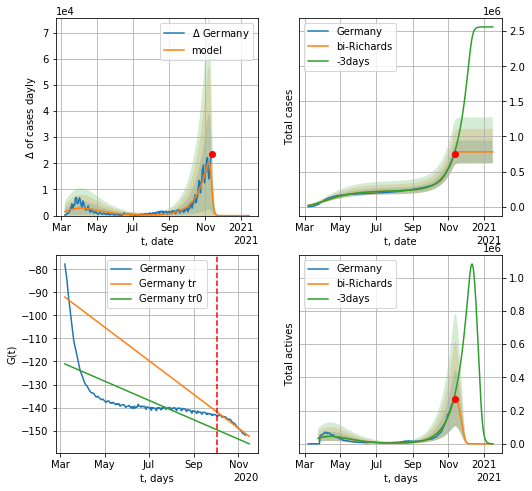

Germany data at: 2020-11-12
+3 day model MAPE: 0.059100
model: bi-Richards
coeffs: [5.54979866e+05 5.09554855e-02 2.42073389e+02 1.09817707e+01]
rational stdev: 0.209889
forecast at the end of period: +65 days
	 deltaDaycases: 0
	 total cases: 779960 ± 163705
	 total death: 12772 ± 8042
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.455738
 intercept: -121.047180
 slope: -0.136538
trend coefficient of determination: 0.943055
 intercept: -92.047211
 slope: -0.237952


In [1412]:
vL = 210+12#94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Germany',dfGR[12:],d1,42*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.5)

In [1127]:
#x = forecastRRR('Germany',dfGR[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


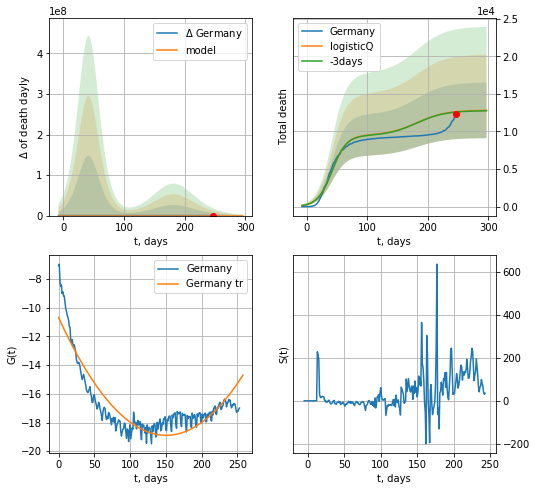

Germany data at: 2020-11-12
+3 day model MAPE: 0.004147
model: logisticQ
coeffs: [ 9.48539030e+03  1.21102028e-07  4.17420948e+01 -6.88170205e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.288859
forecast at the end of period: +51 days
	 total death: 12818 ± 3702
trend coefficient of determination: 0.815477
 intercept_: -10.671705518062744
 coeffs_: [ 0.         -0.10932666  0.00036337]


In [1128]:
x = forecastRRR('Germany',dfGR[8:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date     cases   active     death
252 2020-11-08  10288480  3561292  243768.0
253 2020-11-09  10422026  3624813  244449.0
254 2020-11-10  10568714  3720254  245943.0
255 2020-11-11  10708728  3812625  247398.0
256 2020-11-12  10873936  3897231  248585.0


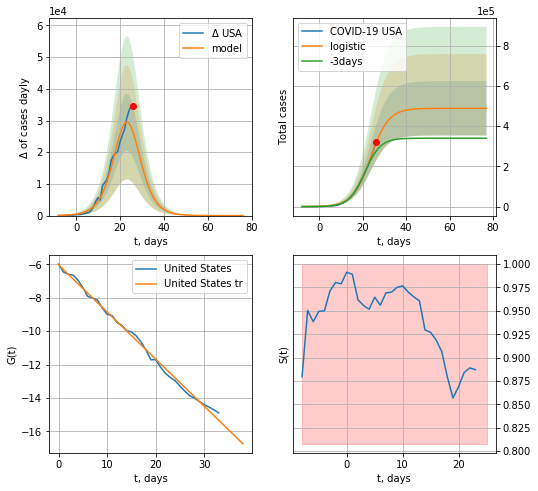

USA data at: 2020-11-12
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  489024 ± 135005
	 total death:  11179 ± 9258
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


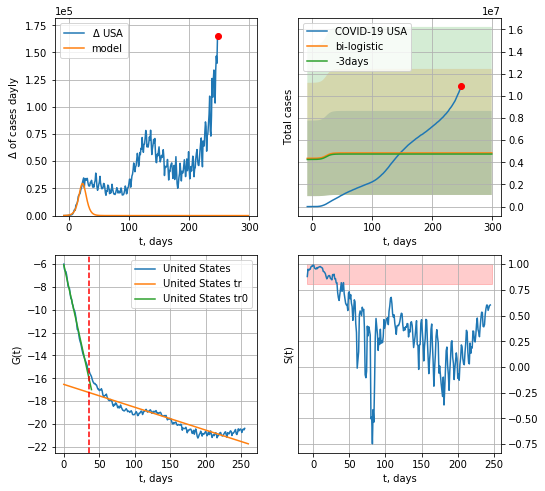

USA data at: 2020-11-12
+3 day model MAPE: 0.020954473507481846
model: bi-logistic
coeffs:  [ 3.48765397e+06 -3.92147706e+01  9.36070521e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7827540510439548
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  4848593 ± 3795256
	 total death:  110841 ± 260283
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.852618
 intercept: -16.534020
 slope: -0.020035


In [1129]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

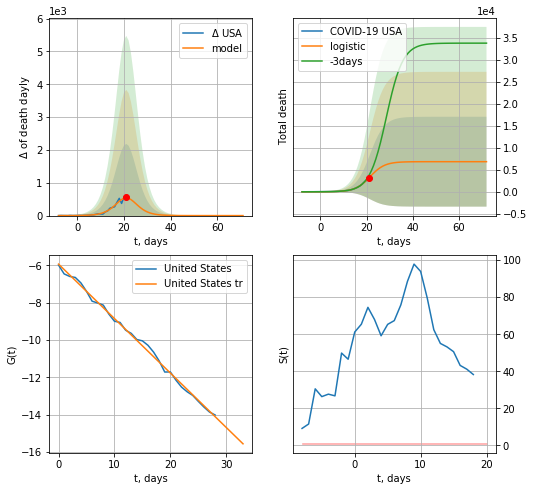

USA data at: 2020-11-12
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +51 days
	 total death:  6833 ± 10202
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


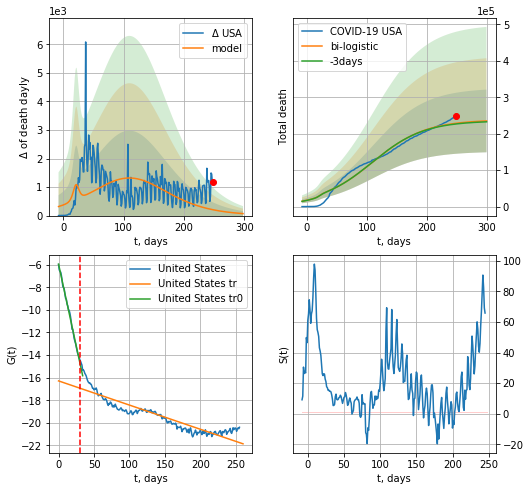

USA data at: 2020-11-12
+3 day model MAPE: 0.008362597898931895
model: bi-logistic
coeffs:  [2.31266573e+05 2.28101473e-02 1.09925308e+02] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.36588717215805683
forecast at the end of period: +51 days
	 deltaDaydeath:  69
	 total death:  235043 ± 85999
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.831981
 intercept: -16.284727
 slope: -0.021413


In [1130]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


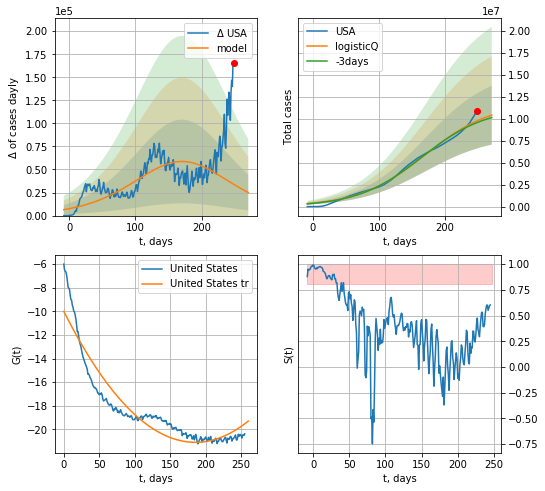

USA data at: 2020-11-12
+3 day model MAPE: 0.020421
model: logisticQ
coeffs: [ 1.17615292e+07  7.74083558e-08  1.70251481e+02 -2.57133014e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321679
forecast at the end of period: +23 days
	 deltaDaycases: 25026
	 total cases: 10405574 ± 3347256
	 total death: 237877 ± 229560
trend coefficient of determination: 0.881061
 intercept_: -9.9955755479798
 coeffs_: [ 0.         -0.11990193  0.00032335]


In [1131]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


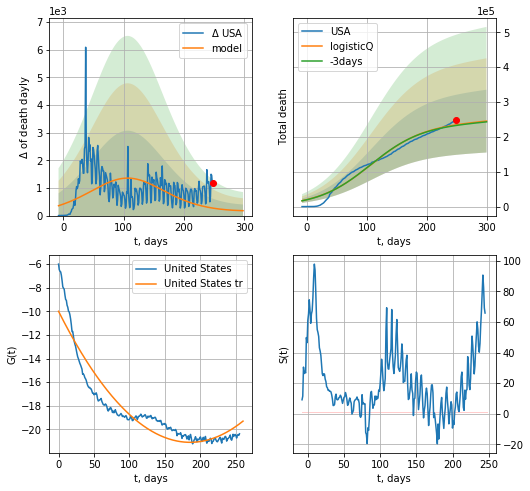

USA data at: 2020-11-12
+3 day model MAPE: 0.007787
model: logisticQ
coeffs: [ 2.37210642e+05  3.23849597e-08  1.06472380e+02 -6.97428130e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.367158
forecast at the end of period: +51 days
	 total death: 245351 ± 90082
trend coefficient of determination: 0.881061
 intercept_: -9.9955755479798
 coeffs_: [ 0.         -0.11990193  0.00032335]


In [1132]:
x = forecastRRR('USA',dfUS[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


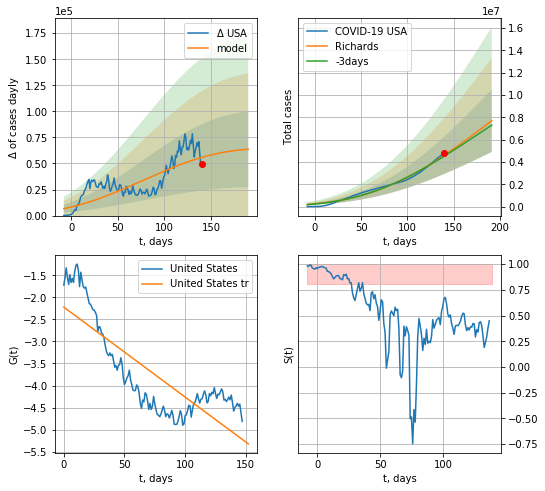

USA data at: 2020-11-12
+3 day model MAPE: 0.018711
model: Richards
coeffs: [ 2.31615491e+07  5.15148790e-01 -3.53277047e+02  1.46832715e-02]
rational stdev: 0.363581
forecast at the end of period: +51 days
	 deltaDaycases: 63602
	 total cases: 7703920 ± 2800996
	 total death: 176116 ± 192097
trend coefficient of determination: 0.668555
 intercept: -2.223272
 slope: -0.020376
diffStd0a 0.13619404972810378


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


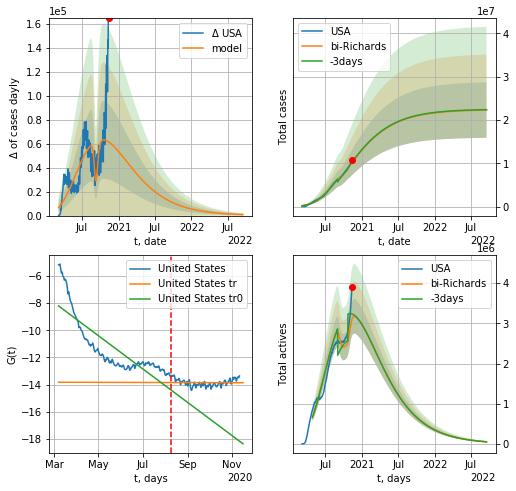

USA data at: 2020-11-12
+3 day model MAPE: 0.010292
model: bi-Richards
coeffs: [-7.75470422e+05  2.66701310e-01  1.75635283e+02  5.65752706e-01]
rational stdev: 0.287355
forecast at the end of period: +674 days
	 deltaDaycases: 806
	 total cases: 22279587 ± 6402160
	 total death: 509325 ± 439071
bi-Richards approximation splitting point: 155
trend coefficient of determination: 0.704094
 intercept: -8.209785
 slope: -0.039909
trend coefficient of determination: 0.000245
 intercept: -13.819061
 slope: -0.000149


In [1528]:
iL = 6
vL = 155+iL#193+iL#90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('USA',dfUS[iL:],d1,7*129-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.5)

In [1414]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date    cases  active    death
256 2020-11-08  1192013       0  49044.0
257 2020-11-09  1213363       0  49238.0
258 2020-11-10  1233775       0  49770.0
259 2020-11-11  1256725       0  50365.0
260 2020-11-12  1290195       0  50928.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


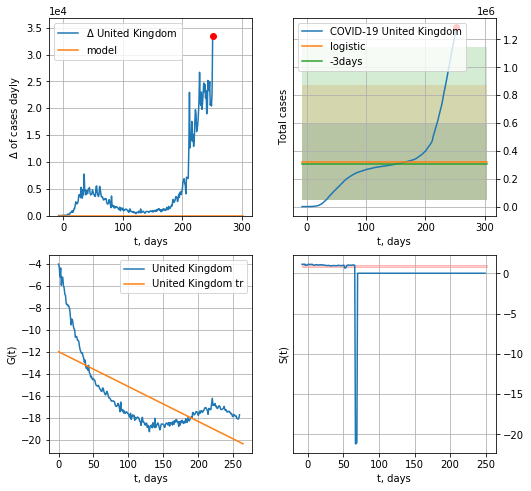

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.035313519395048835
model: logistic
coeffs:  [ 3.20394518e+05 -1.68598933e+01  4.17026159e+02]
rational stdev:  0.8590227500628954
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  320394 ± 275226
	 total death:  12646 ± 32589
trend coefficient of determination: 0.491715
 intercept: -11.992005
 slope: -0.031703


In [1135]:
try:
    dfGB = read_df(pd.DataFrame(),"GB")
    x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
    #x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
    #xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)
except:
    print ("Exception occurs")

In [1136]:
#x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


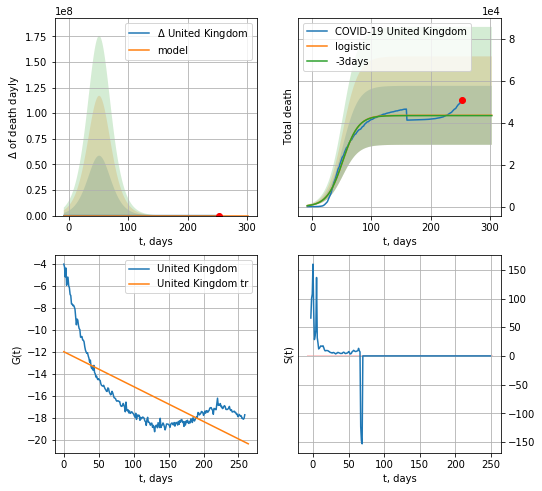

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.0032082346710422516
model: logistic
coeffs:  [4.36281487e+04 7.54633056e-02 5.19057277e+01]
rational stdev:  0.32280268677735297
forecast at the end of period: +51 days
	 total death:  43628 ± 14083
trend coefficient of determination: 0.491715
 intercept: -11.992005
 slope: -0.031703


In [1137]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


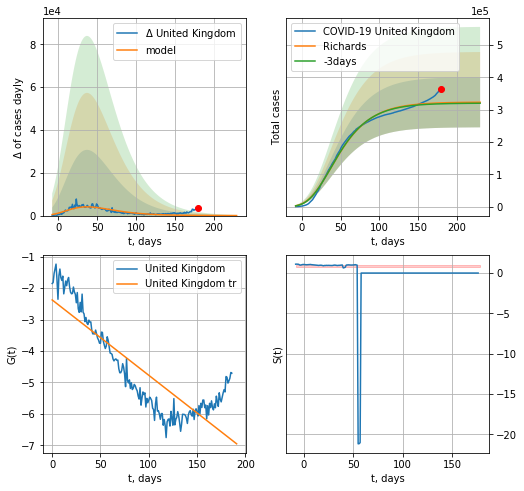

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.008801
model: Richards
coeffs: [ 3.23415604e+05  7.89136664e+00 -1.20373121e+02  4.36893740e-03]
rational stdev: 0.240393
forecast at the end of period: +51 days
	 deltaDaycases: 14
	 total cases: 322995 ± 77645
	 total death: 12749 ± 9194
trend coefficient of determination: 0.735594
 intercept: -2.373746
 slope: -0.023973


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


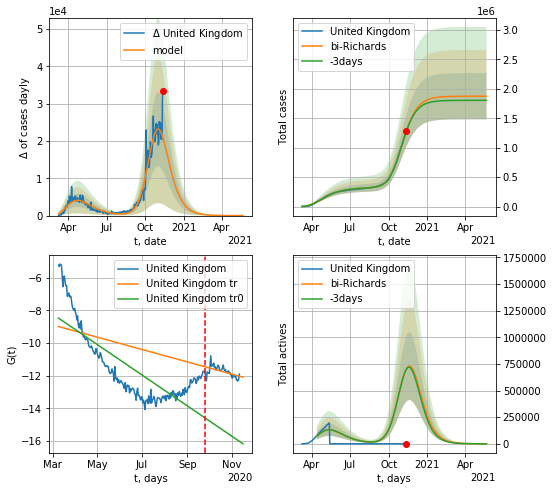

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.004376
model: bi-Richards
coeffs: [1.55123188e+06 8.88597208e-02 2.18583108e+02 5.86364085e-01]
rational stdev: 0.209299
forecast at the end of period: +191 days
	 deltaDaycases: 2
	 total cases: 1874605 ± 392352
	 total death: 73996 ± 46461
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.627846
 intercept: -8.479835
 slope: -0.030497
trend coefficient of determination: 0.289091
 intercept: -8.993604
 slope: -0.012289


In [1138]:
vL = 200+12#143+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('United Kingdom',dfGB[12:],d1,60*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


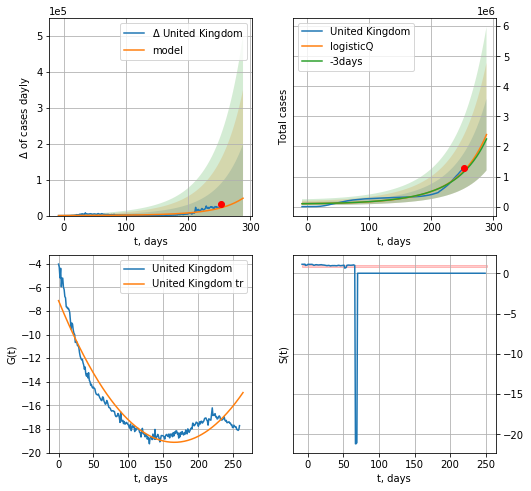

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.031694
model: logisticQ
coeffs: [ 3.49164792e+09  3.26684513e-05  5.42505421e+02 -5.90497567e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.498103
forecast at the end of period: +37 days
	 deltaDaycases: 48390
	 total cases: 2395927 ± 1193418
	 total death: 94574 ± 141322
trend coefficient of determination: 0.912477
 intercept_: -7.126716843419816
 coeffs_: [ 0.         -0.14484944  0.00043686]


In [1139]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


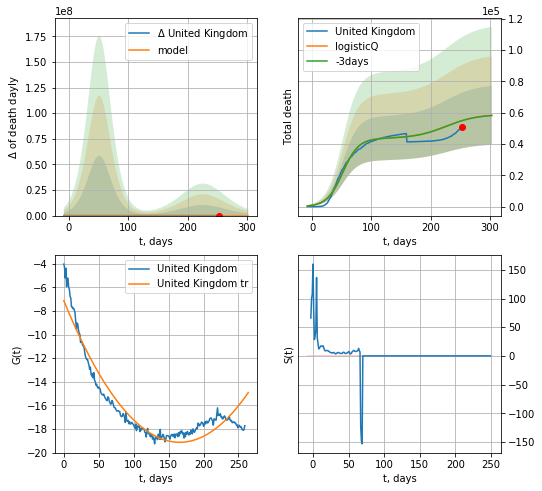

United Kingdom data at: 2020-11-12
+3 day model MAPE: 0.001426
model: logisticQ
coeffs: [ 4.36280660e+04  1.41013646e-07  5.19063350e+01 -5.34900869e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322824
forecast at the end of period: +51 days
	 total death: 58283 ± 18815
trend coefficient of determination: 0.912477
 intercept_: -7.126716843419816
 coeffs_: [ 0.         -0.14484944  0.00043686]


In [1140]:
x = forecastRRR('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1141]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [1142]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [1143]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [1144]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [1145]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
255 2020-11-08  55121.0   14073  743.0
256 2020-11-09  55892.0   13913  747.0
257 2020-11-10  56958.0   13959  750.0
258 2020-11-11  57952.0   13716  753.0
259 2020-11-12  58963.0   13515  755.0


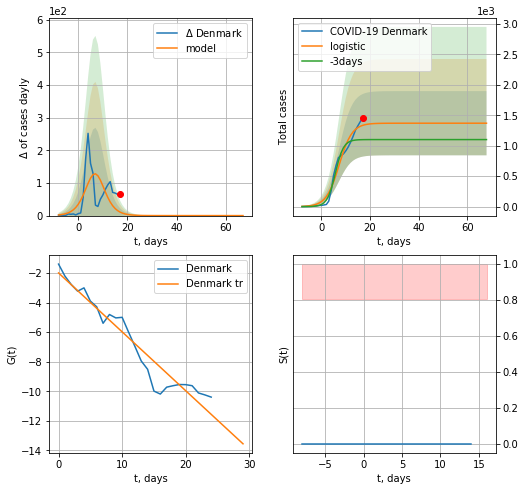

Denmark data at: 2020-11-12
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  17 ± 19
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


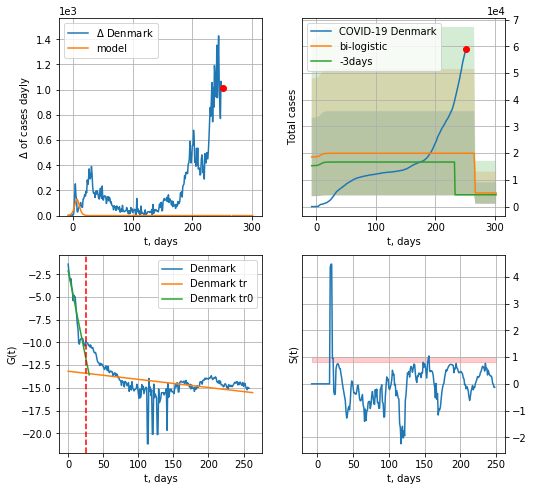

Denmark data at: 2020-11-12
+3 day model MAPE: 3.5054706570472747
model: bi-logistic
coeffs:  [14880.5070763   -134.51621399   266.00340592] [1.36966074e+03 3.75718857e-01 7.30059730e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.78968027889672
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  5089 ± 4019
	 total death:  65 ± 153
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.133851
 intercept: -13.167110
 slope: -0.008955


In [1146]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [1147]:
d12f(4)

'2020-11-09'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


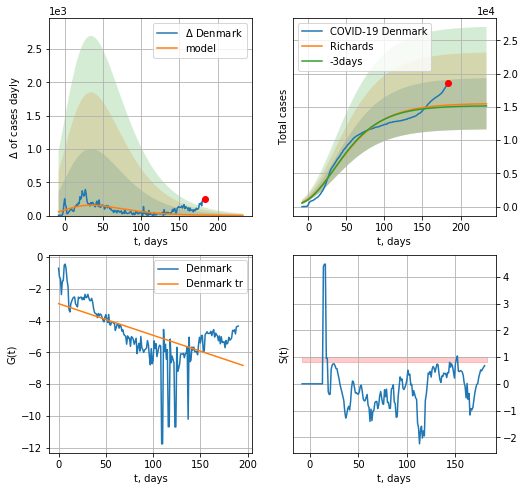

Denmark data at: 2020-11-12
+3 day model MAPE: 0.018367
model: Richards
coeffs: [ 1.55387411e+04  7.02926074e+00 -1.66867960e+02  3.90987733e-03]
rational stdev: 0.249168
forecast at the end of period: +51 days
	 deltaDaycases: 1
	 total cases: 15473 ± 3855
	 total death: 198 ± 148
trend coefficient of determination: 0.355292
 intercept: -2.934034
 slope: -0.019949


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


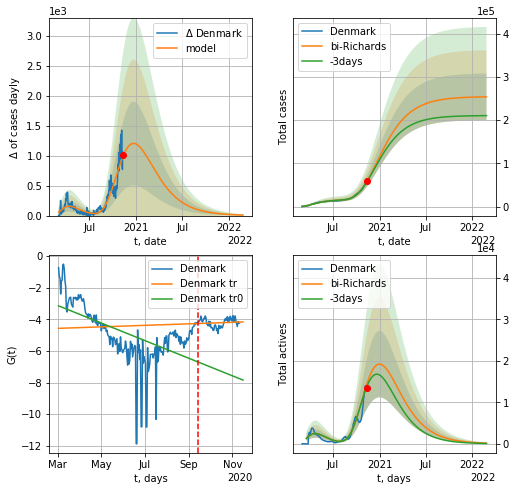

Denmark data at: 2020-11-12
+3 day model MAPE: 0.013777
model: bi-Richards
coeffs: [ 2.39229057e+05  8.90881817e-01 -1.45283540e+01  1.54853565e-02]
rational stdev: 0.212272
forecast at the end of period: +471 days
	 deltaDaycases: 8
	 total cases: 254137 ± 53946
	 total death: 3254 ± 2072
bi-Richards approximation splitting point: 196
trend coefficient of determination: 0.312445
 intercept: -3.146791
 slope: -0.018129
trend coefficient of determination: 0.009470
 intercept: -4.569415
 slope: 0.001560


In [1416]:
vL = 200#125+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Denmark',dfDK[4:],d1,100*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.5)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

In [1417]:
#x = forecastRRR('Denmark',dfDK[:18],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
#x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date    cases  active  death
256 2020-11-08  24732.0   12584  285.0
257 2020-11-09  25325.0   13177  285.0
258 2020-11-10  25887.0   13739  285.0
259 2020-11-11  26511.0   14363  285.0
260 2020-11-12  27228.0   15074  291.0


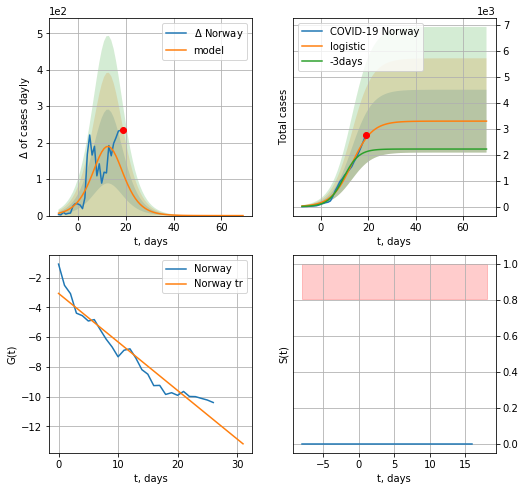

Norway data at: 2020-11-12
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  3297 ± 1211
	 total death:  35 ± 38
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


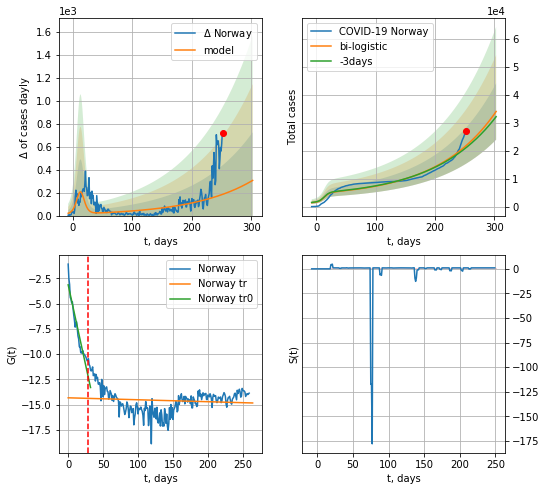

Norway data at: 2020-11-12
+3 day model MAPE: 0.03472805721306999
model: bi-logistic
coeffs:  [6.93349133e+07 1.00131325e-02 1.07405550e+03] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.29635471859275747
forecast at the end of period: +51 days
	 deltaDaycases:  306
	 total cases:  34038 ± 10087
	 total death:  363 ± 322
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.010685
 intercept: -14.309433
 slope: -0.001932


In [1150]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

In [1151]:
vL = 28#len(dfNG)-13-dT
#x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
#xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


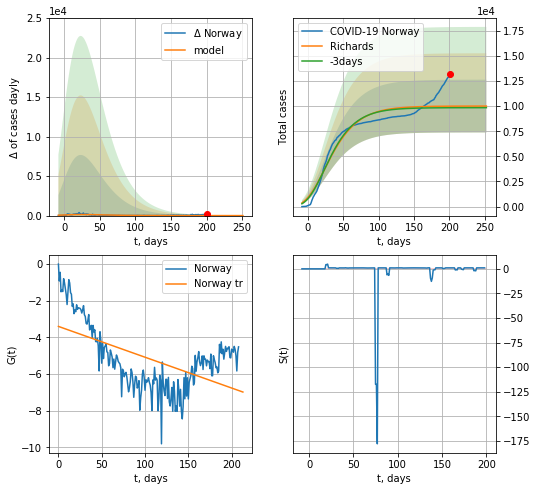

Norway data at: 2020-11-12
+3 day model MAPE: 0.015762
model: Richards
coeffs: [ 1.00040704e+04  1.30654907e+01 -1.29861253e+02  2.91049631e-03]
rational stdev: 0.262498
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 10002 ± 2625
	 total death: 106 ± 83
trend coefficient of determination: 0.314756
 intercept: -3.399379
 slope: -0.016798


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


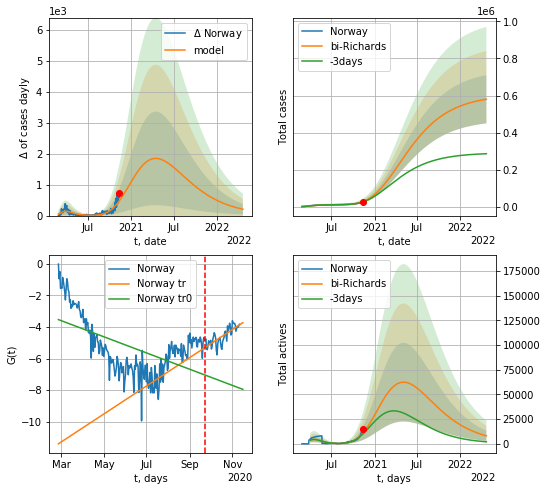

Norway data at: 2020-11-12
+3 day model MAPE: 0.029414
model: bi-Richards
coeffs: [ 5.94550595e+05  4.53216933e-01 -6.01019930e+01  1.87758792e-02]
rational stdev: 0.224458
forecast at the end of period: +527 days
	 deltaDaycases: 205
	 total cases: 579992 ± 130184
	 total death: 6198 ± 4173
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.310958
 intercept: -3.533138
 slope: -0.016724
trend coefficient of determination: 0.582319
 intercept: -11.395258
 slope: 0.029046


In [1152]:
vL = 210#96+22#170#96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Norway',dfNG[:],d1,108*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

In [1153]:
#x = forecastRRR('Norway',dfNG[:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


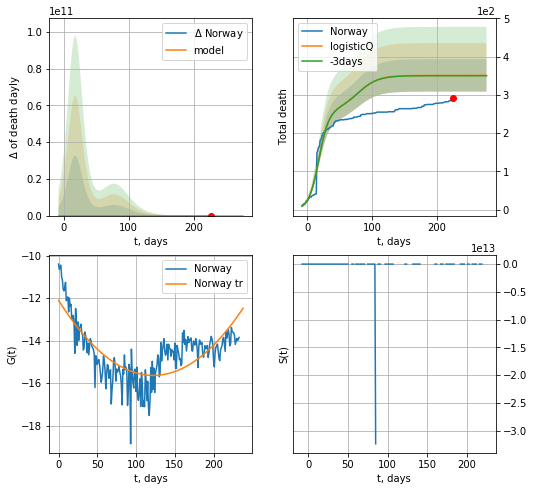

Norway data at: 2020-11-12
+3 day model MAPE: 0.001992
model: logisticQ
coeffs: [ 2.59044660e+02  1.36644527e-07  1.79701418e+01 -9.34548510e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.120392
forecast at the end of period: +51 days
	 total death: 350 ± 42
trend coefficient of determination: 0.568326
 intercept_: -12.104104589306633
 coeffs_: [ 0.         -0.05773988  0.00023594]


In [1154]:
x = forecastRRR('Norway',dfNG[26:],d1,T18*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date   cases  active   death
257 2020-11-08  154148       0  6022.0
258 2020-11-09  158142       0  6022.0
259 2020-11-10  162240       0  6057.0
260 2020-11-11  166707       0  6082.0
261 2020-11-12  171365       0  6122.0


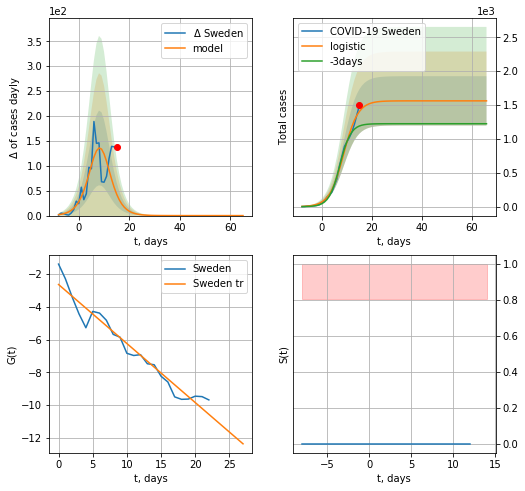

Sweden data at: 2020-11-12
+3 day model MAPE: 0.20348254679733155
model: logistic
coeffs:  [1.56232986e+03 3.49134536e-01 8.72829156e+00]
rational stdev:  0.2329336409619122
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1562 ± 363
	 total death:  55 ± 38
trend coefficient of determination: 0.947679
 intercept: -2.633085
 slope: -0.360867


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


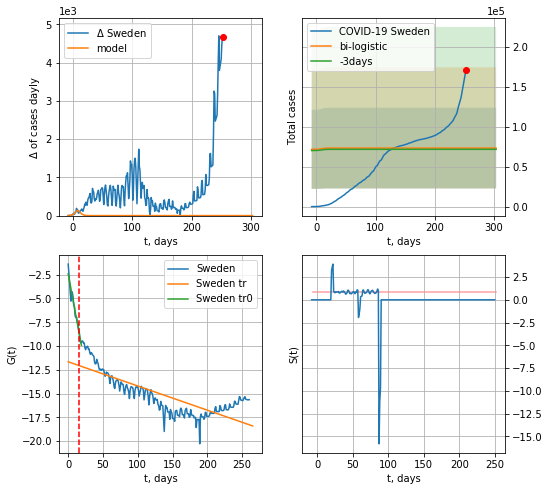

Sweden data at: 2020-11-12
+3 day model MAPE: 0.02181237255207837
model: bi-logistic
coeffs:  [ 5.73016477e+04 -2.06387072e+01  5.03432266e+02] [1.56232986e+03 3.49134536e-01 8.72829156e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6898286024884469
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  73189 ± 50488
	 total death:  2614 ± 5409
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.906612
 intercept: -2.393320
 slope: -0.396924
trend coefficient of determination: 0.633520
 intercept: -11.661719
 slope: -0.025466


In [1155]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date   cases  active   death
257 2020-11-08  154148       0  6022.0
258 2020-11-09  158142       0  6022.0
259 2020-11-10  162240       0  6057.0
260 2020-11-11  166707       0  6082.0
261 2020-11-12  171365       0  6122.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


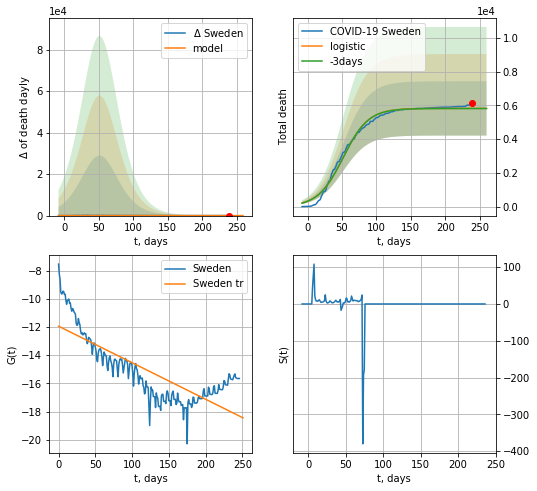

Sweden data at: 2020-11-12
+3 day model MAPE: 0.0012324575554248111
model: logistic
coeffs:  [5.82038045e+03 5.49468023e-02 5.17513744e+01]
rational stdev:  0.2765853355133419
forecast at the end of period: +21 days
	 total death:  5820 ± 1609
trend coefficient of determination: 0.634640
 intercept: -11.946192
 slope: -0.025904


In [1156]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


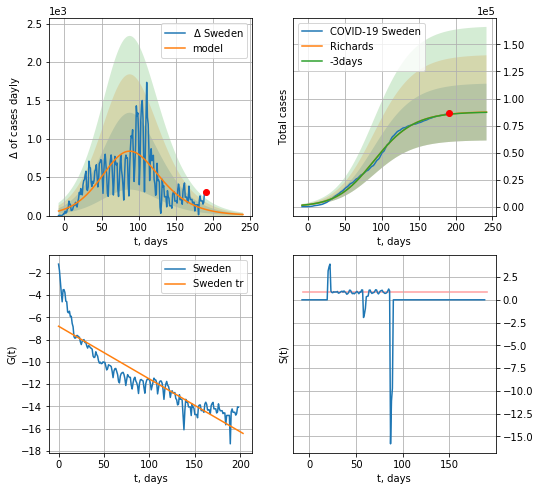

Sweden data at: 2020-11-12
+3 day model MAPE: 0.001624
model: Richards
coeffs: [8.78275804e+04 4.73720199e-02 8.00051782e+01 7.42307087e-01]
rational stdev: 0.300484
forecast at the end of period: +51 days
	 deltaDaycases: 14
	 total cases: 87431 ± 26271
	 total death: 3123 ± 2815
trend coefficient of determination: 0.834538
 intercept: -6.794116
 slope: -0.047468


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


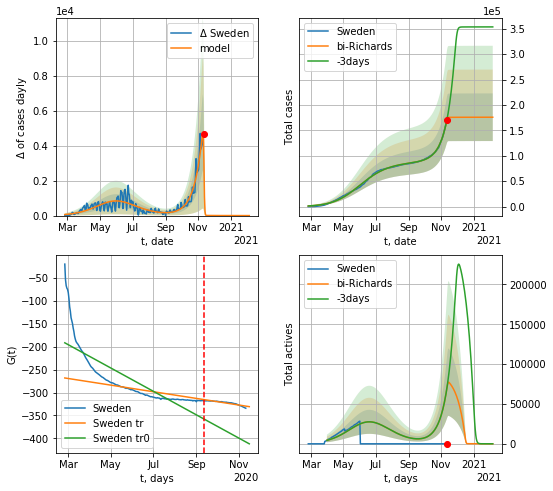

Sweden data at: 2020-11-12
+3 day model MAPE: 0.019178
model: bi-Richards
coeffs: [8.81493874e+04 6.34878040e-02 2.53635048e+02 2.74258335e+01]
rational stdev: 0.266491
forecast at the end of period: +86 days
	 deltaDaycases: 0
	 total cases: 175963 ± 46892
	 total death: 6286 ± 5025
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.666077
 intercept: -191.419326
 slope: -0.831615
trend coefficient of determination: 0.858005
 intercept: -268.128563
 slope: -0.236086


In [1157]:
iL = 0
vL = 200+iL
x = forecastRR('Sweden',dfSW[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sweden',dfSW[iL:],d12f(1),45*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


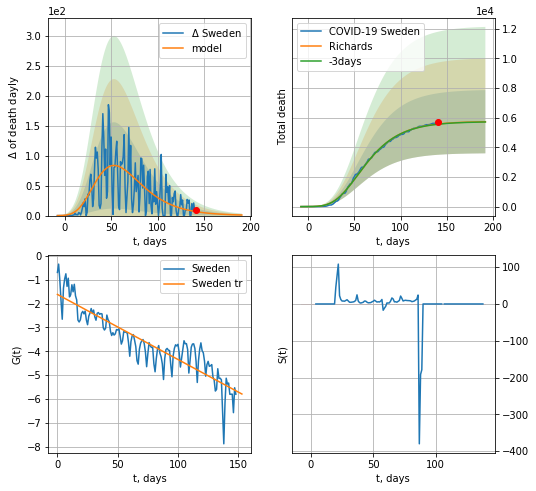

Sweden data at: 2020-11-12
+3 day model MAPE: 0.002445
model: Richards
coeffs: [ 5.75133549e+03  5.79293366e+00 -7.21072797e+01  6.85063513e-03]
rational stdev: 0.372383
forecast at the end of period: +51 days
	 total death: 5727 ± 2132
trend coefficient of determination: 0.814804
 intercept: -1.618399
 slope: -0.027247


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


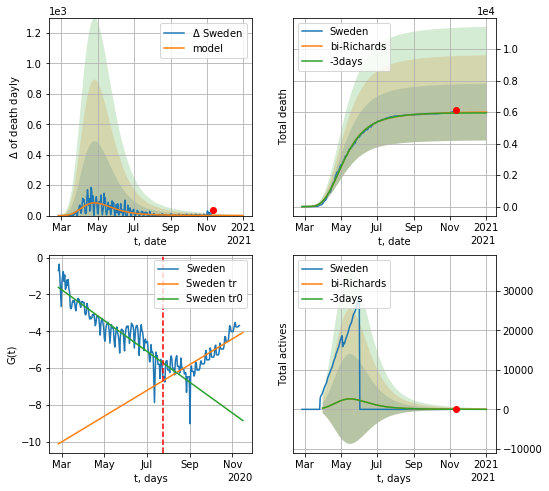

Sweden data at: 2020-11-12
+3 day model MAPE: 0.005272
model: bi-Richards
coeffs: [ 2.65099252e+02  2.79413668e+00 -9.74889225e+01  6.73289839e-03]
rational stdev: 0.300413
forecast at the end of period: +51 days
	 total death: 5996 ± 1801
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.818267
 intercept: -1.614796
 slope: -0.027301
trend coefficient of determination: 0.628637
 intercept: -10.110720
 slope: 0.022808


In [1158]:
vL = 150
x = forecastRR('Sweden',dfSW[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RRD('Sweden',dfSW[:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

In [1159]:
#x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


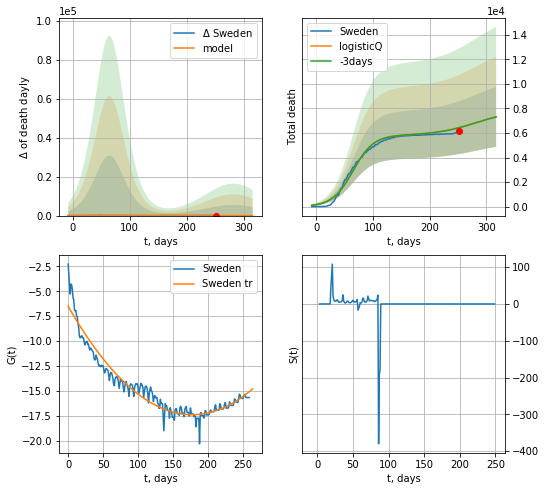

Sweden data at: 2020-11-12
+3 day model MAPE: 0.000785
model: logisticQ
coeffs: [ 5.81736977e+03  7.54813308e-08  6.47520559e+01 -7.33997160e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.334353
forecast at the end of period: +65 days
	 total death: 7311 ± 2444
trend coefficient of determination: 0.933485
 intercept_: -6.519217960106907
 coeffs_: [ 0.         -0.12235663  0.00034479]


In [1160]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
291 2020-11-08  86245.0     424  4634.0
292 2020-11-09  86267.0     426  4634.0
293 2020-11-10  86284.0     422  4634.0
294 2020-11-11  86299.0     413  4634.0
295 2020-11-12  86307.0     394  4634.0


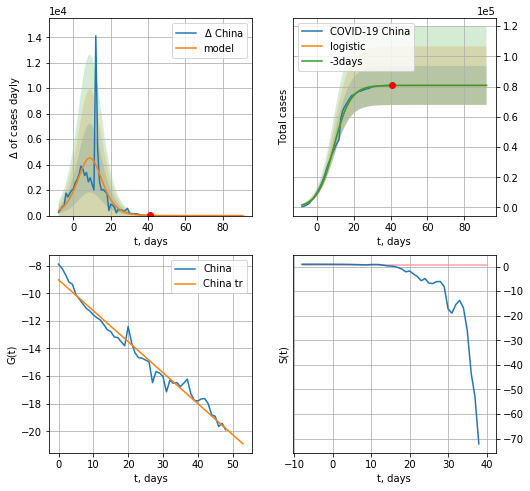

China data at: 2020-11-12
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4338 ± 2078
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


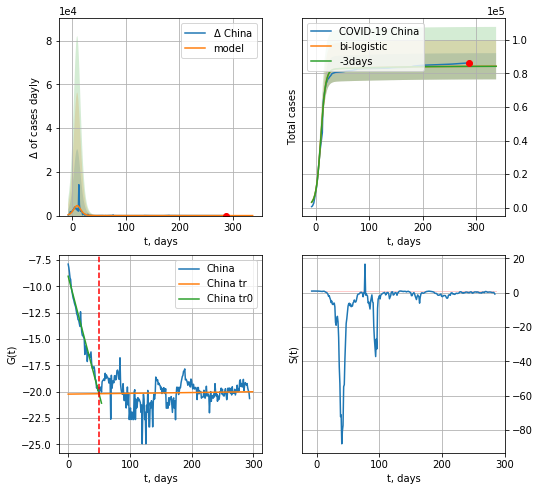

China data at: 2020-11-12
+3 day model MAPE: 0.00041352714290329105
model: bi-logistic
coeffs:  [3.54078027e+03 1.20586751e-02 1.02712209e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.09281508979359401
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  84284 ± 7822
	 total death:  4525 ± 1259
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.002053
 intercept: -20.235247
 slope: 0.000749


In [1161]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [1162]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

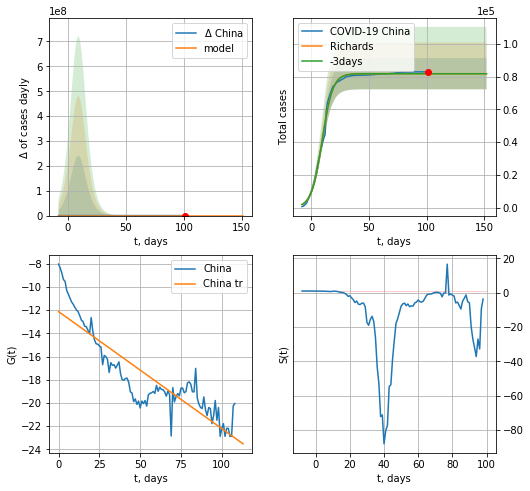

China data at: 2020-11-12
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4390 ± 1533
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


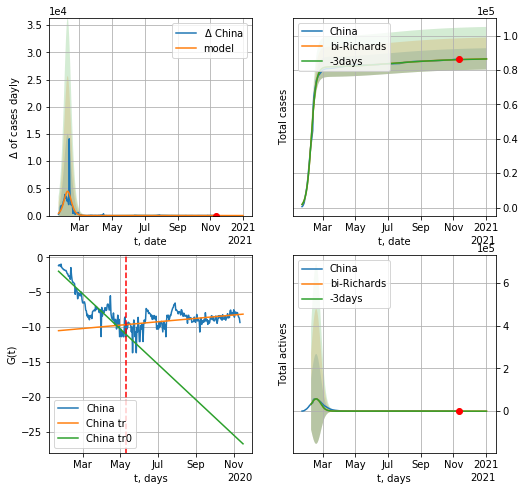

China data at: 2020-11-12
+3 day model MAPE: 0.000339
model: bi-Richards
coeffs: [ 5.12045459e+03  2.68323638e+00 -2.64487705e+02  4.75959778e-03]
rational stdev: 0.071670
forecast at the end of period: +51 days
	 deltaDaycases: 5
	 total cases: 86427 ± 6194
	 total death: 4640 ± 997
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820993
 intercept: -2.000975
 slope: -0.082717
trend coefficient of determination: 0.157421
 intercept: -10.515701
 slope: 0.007920


In [1418]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RRD('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=vL,amc=0.5)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

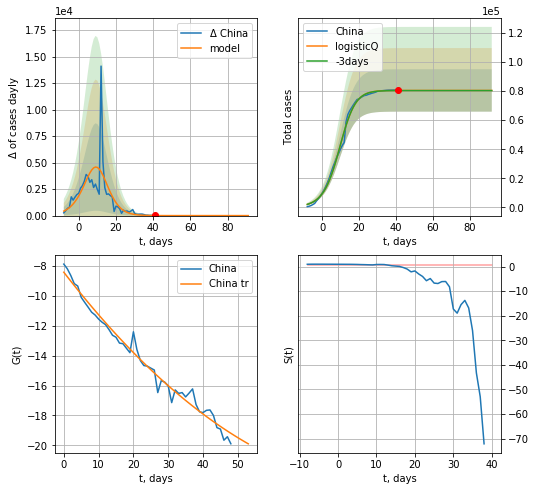

China data at: 2020-11-12
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4317 ± 2344
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


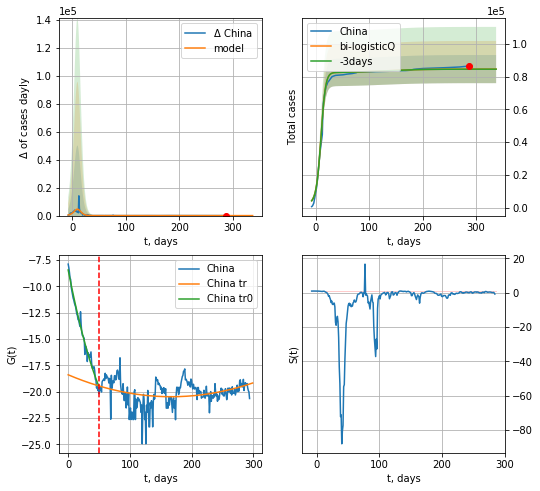

China data at: 2020-11-12
+3 day model MAPE: 0.000497
model: bi-logisticQ
coeffs: [ 4.11179324e+03  7.77336054e-05  2.47189423e+01 -5.46363026e-02]
rational stdev: 0.101549
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 84528 ± 8583
	 total death: 4538 ± 1382
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.083813
 intercept_: -18.39836031741532
 coeffs_: [ 0.00000000e+00 -2.49564187e-02  7.47249946e-05]


In [1164]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [1165]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
267 2020-11-08  27553  2044.0  480.0
268 2020-11-09  27653  2008.0  485.0
269 2020-11-10  27799  2046.0  487.0
270 2020-11-11  27942  2051.0  487.0
271 2020-11-12  28133  2108.0  488.0


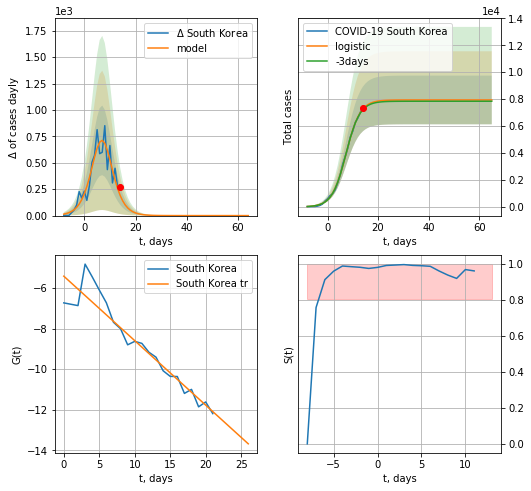

South Korea data at: 2020-11-12
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  137 ± 93
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


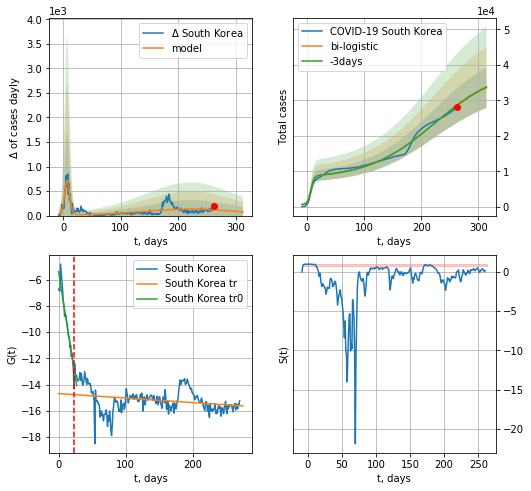

South Korea data at: 2020-11-12
+3 day model MAPE: 0.003682147903504795
model: bi-logistic
coeffs:  [3.07210963e+04 1.73620356e-02 2.21687634e+02] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.17079746846420893
forecast at the end of period: +51 days
	 deltaDaycases:  74
	 total cases:  33513 ± 5724
	 total death:  581 ± 297
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.075300
 intercept: -14.680113
 slope: -0.003440


In [1166]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,T18*7-dT,x,1.0,vL=23)

In [1167]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

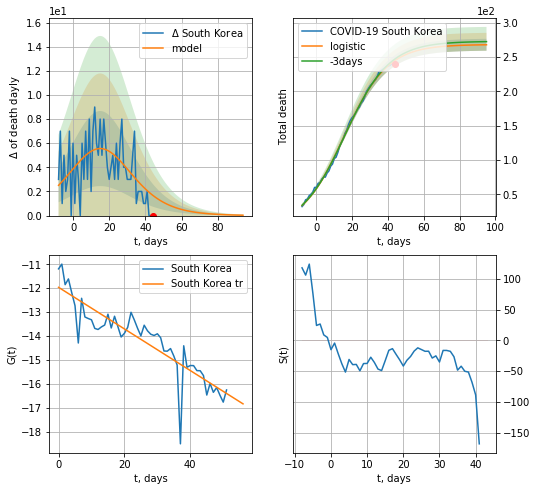

South Korea data at: 2020-11-12
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +51 days
	 total death:  268 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:252: RuntimeWarning: divide by zero encountered in true_divide


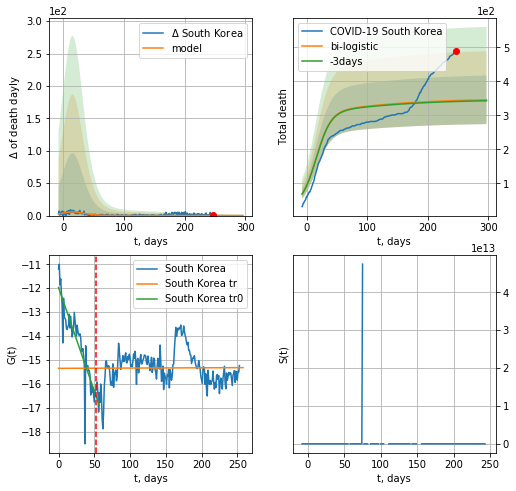

South Korea data at: 2020-11-12
+3 day model MAPE: 0.007898081174162781
model: bi-logistic
coeffs:  [8.03032433e+01 1.11057494e-02 9.90853966e+00] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.2064277579717731
forecast at the end of period: +51 days
	 deltaDaydeath:  0
	 total death:  345 ± 71
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.000081
 intercept: -15.352284
 slope: 0.000110


In [1168]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in power


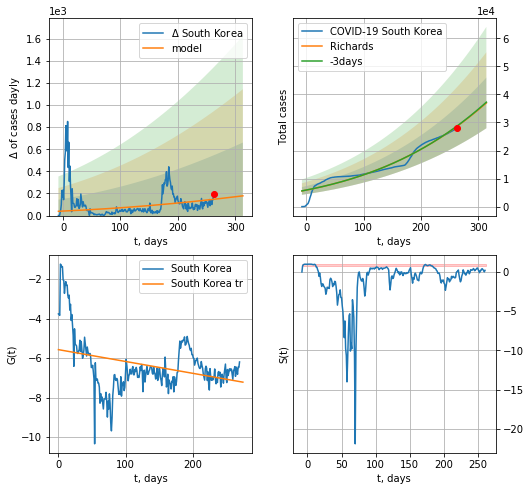

South Korea data at: 2020-11-12
+3 day model MAPE: 0.003559
model: Richards
coeffs: [ 9.34157813e+05  1.53382833e-02 -1.15833934e+02  1.17413498e-01]
rational stdev: 0.244076
forecast at the end of period: +51 days
	 deltaDaycases: 178
	 total cases: 36966 ± 9022
	 total death: 641 ± 469
trend coefficient of determination: 0.113304
 intercept: -5.572267
 slope: -0.005987


In [1169]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


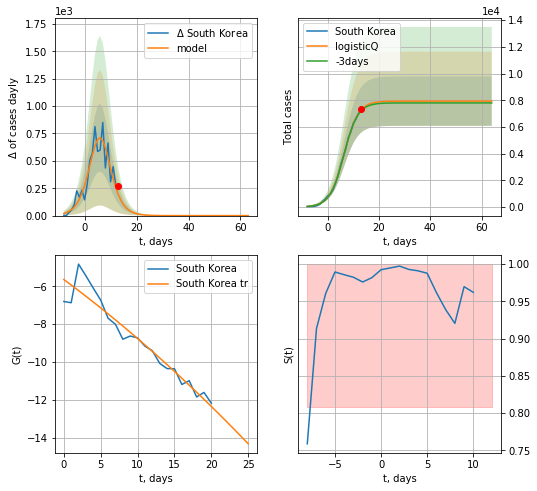

South Korea data at: 2020-11-12
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 137 ± 95
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


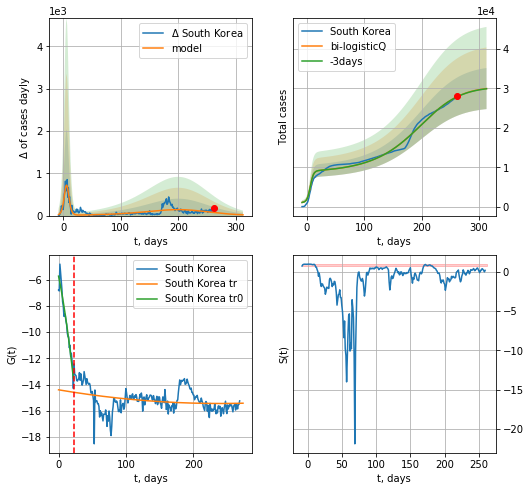

South Korea data at: 2020-11-12
+3 day model MAPE: 0.000900
model: bi-logisticQ
coeffs: [ 2.25441583e+04  4.63328248e-05  1.88404926e+02 -3.40967958e+02]
rational stdev: 0.173917
forecast at the end of period: +51 days
	 deltaDaycases: 18
	 total cases: 29975 ± 5213
	 total death: 519 ± 270
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.081184
 intercept_: -14.397150796974364
 coeffs_: [ 0.00000000e+00 -8.70128733e-03  1.81742691e-05]


In [1170]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [1171]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [1172]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


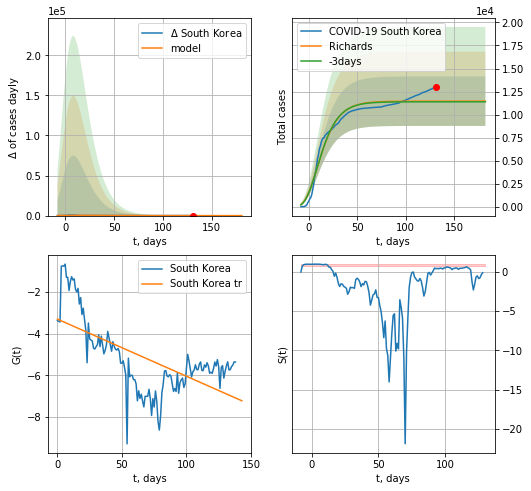

South Korea data at: 2020-11-12
+3 day model MAPE: 0.006245
model: Richards
coeffs: [ 1.14621909e+04  2.64955361e+01 -6.29475021e+01  3.05260511e-03]
rational stdev: 0.234092
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 11462 ± 2683
	 total death: 198 ± 139
trend coefficient of determination: 0.403266
 intercept: -3.307543
 slope: -0.027367


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


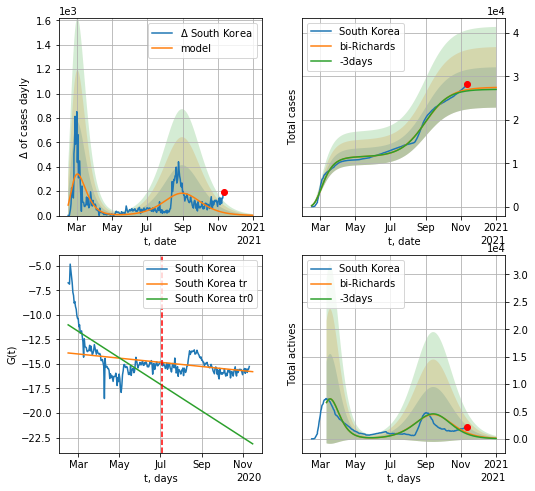

South Korea data at: 2020-11-12
+3 day model MAPE: 0.011080
model: bi-Richards
coeffs: [1.60384647e+04 4.56688501e-02 1.90776401e+02 1.00235576e+00]
rational stdev: 0.169259
forecast at the end of period: +51 days
	 deltaDaycases: 2
	 total cases: 27444 ± 4645
	 total death: 476 ± 241
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.455588
 intercept: -11.021700
 slope: -0.044069
trend coefficient of determination: 0.139724
 intercept: -13.886517
 slope: -0.006926


In [1420]:
iL = 0
vL = 140+iL
x = forecastRR('South Korea',dfKR[iL:vL-iL],d1,T18*7-dT,1.0)
xx=forecast2RRD('South Korea',dfKR[iL:],d1,T18*7-dT,x,1.0,vL=vL-iL,amc=0.75)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [1174]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [1175]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
290 2020-11-08  58064.0      61   28.0
291 2020-11-09  58073.0      64   28.0
292 2020-11-10  58091.0      78   28.0
293 2020-11-11  58102.0      84   28.0
294 2020-11-12  58114.0      84   28.0


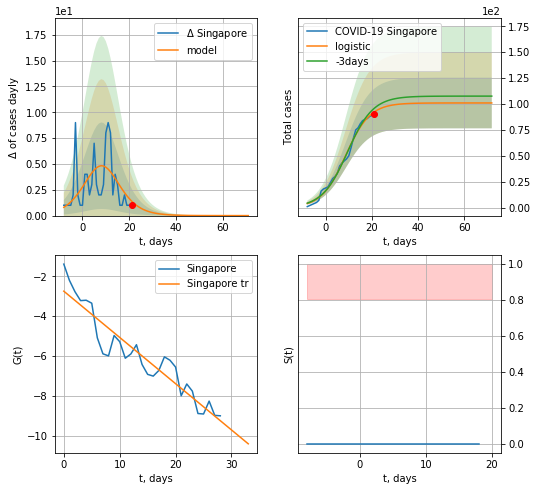

Singapore data at: 2020-11-12
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  101 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


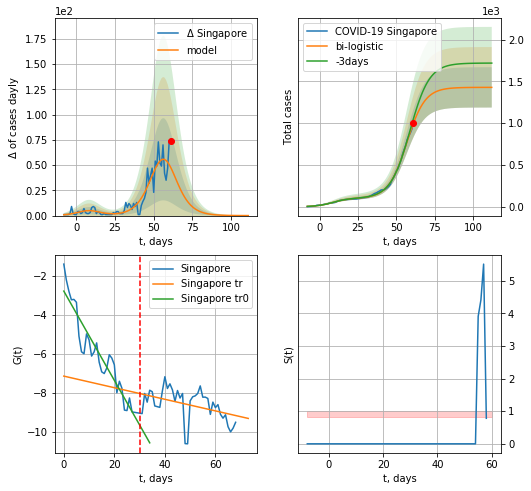

Singapore data at: 2020-11-12
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


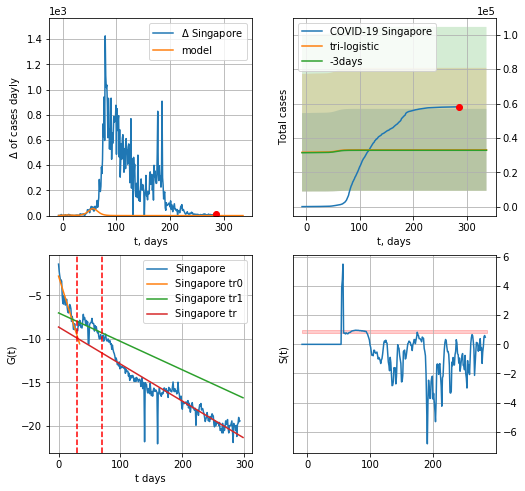

Singapore data at: 2020-11-12
+3 day model MAPE: 0.007854529797648972
model: tri-logistic
coeffs:  [ 3.16119365e+04 -1.97004794e+01  4.74667811e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.7219830399047327
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  33039 ± 23854
	 total death:  15 ± 32
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.872425
 intercept: -8.634420
 slope: -0.042698


In [1176]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,T18*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

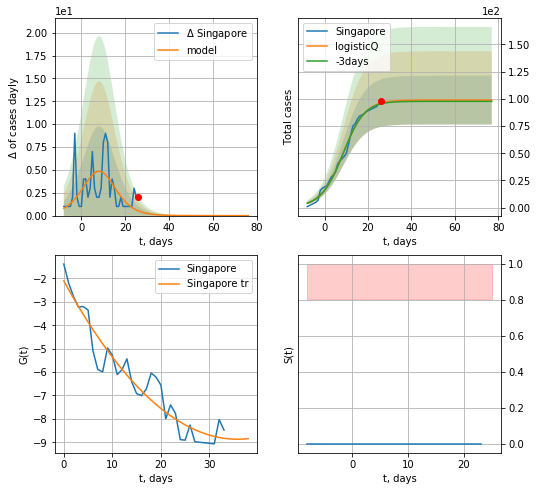

Singapore data at: 2020-11-12
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


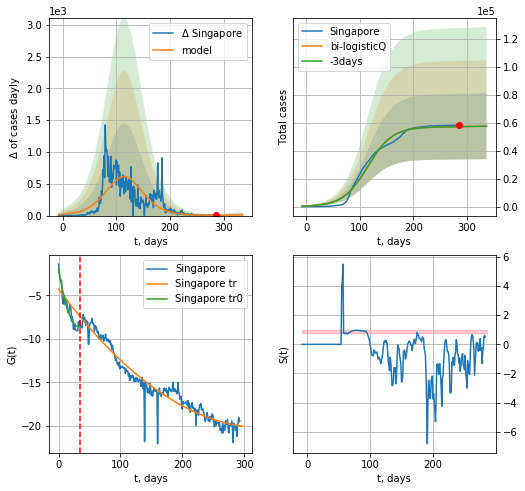

Singapore data at: 2020-11-12
+3 day model MAPE: 0.000825
model: bi-logisticQ
coeffs: [ 5.68242100e+04  5.25337602e-08  1.14679387e+02 -8.26746822e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410807
forecast at the end of period: +51 days
	 deltaDaycases: 11
	 total cases: 57476 ± 23611
	 total death: 27 ± 33
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.940115
 intercept_: -4.275444288896697
 coeffs_: [ 0.         -0.09612167  0.00014468]


In [1177]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d12f(1),T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [1178]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


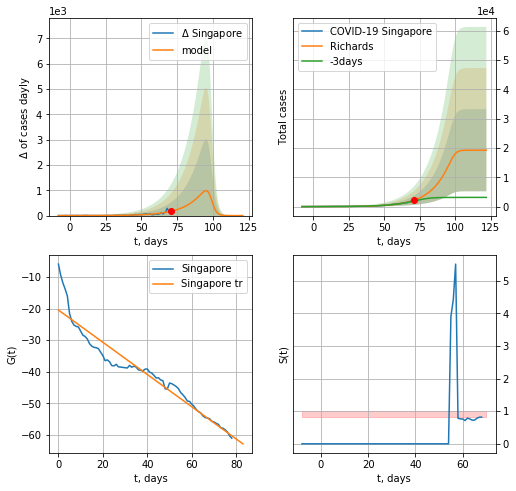

Singapore data at: 2020-11-12
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 19230 ± 14005
	 total death: 9 ± 19
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


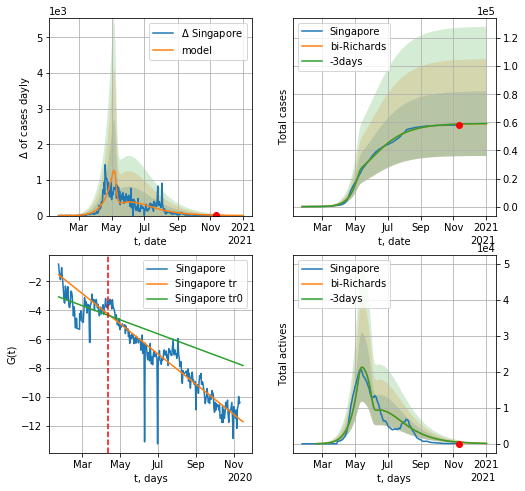

Singapore data at: 2020-11-12
+3 day model MAPE: 0.000777
model: bi-Richards
coeffs: [3.99347871e+04 1.64683827e-01 6.08564534e+01 1.70909524e-01]
rational stdev: 0.388866
forecast at the end of period: +51 days
	 deltaDaycases: 2
	 total cases: 59066 ± 22969
	 total death: 28 ± 32
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.128938
 intercept: -3.072556
 slope: -0.015910
trend coefficient of determination: 0.854168
 intercept: -1.539250
 slope: -0.034090


In [1421]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RRD('Singapore',dfSG[iL:],d12f(1),T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

In [1180]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    #x = forecast('Estonia',dfES[1:7],d1,17,1.)
    #xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

ES
           date   cases  active  death
241 2020-11-08  6250.0    1970   75.0
242 2020-11-09  6376.0    2081   76.0
243 2020-11-10  6441.0    2081   76.0
244 2020-11-11  6508.0    2054   76.0
245 2020-11-12  6881.0    2352   76.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


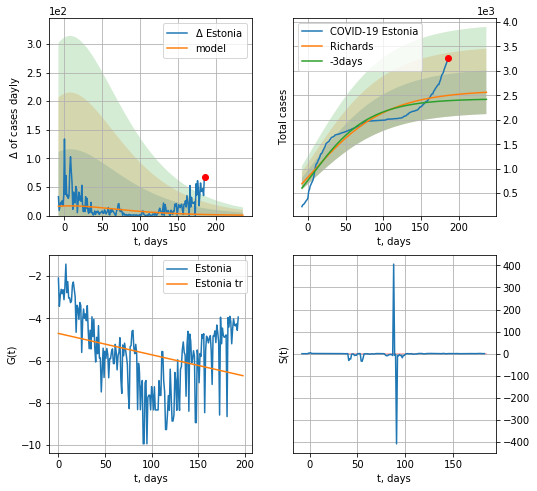

Estonia data at: 2020-11-12
+3 day model MAPE: 0.045435
model: Richards
coeffs: [ 2.60588093e+03  2.79002184e+00 -2.75729567e+02  6.38503599e-03]
rational stdev: 0.174012
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 2562 ± 445
	 total death: 28 ± 14
trend coefficient of determination: 0.100431
 intercept: -4.712830
 slope: -0.010110


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


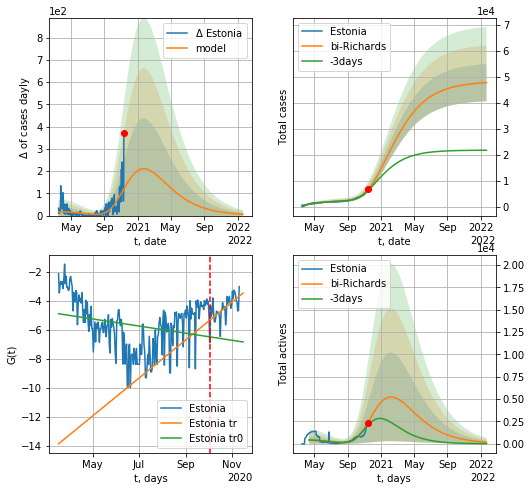

Estonia data at: 2020-11-12
+3 day model MAPE: 0.040514
model: bi-Richards
coeffs: [ 4.57601978e+04  1.27798538e+00 -6.38280482e+01  9.82461598e-03]
rational stdev: 0.149207
forecast at the end of period: +436 days
	 deltaDaycases: 5
	 total cases: 47892 ± 7145
	 total death: 528 ± 236
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.067125
 intercept: -4.876334
 slope: -0.007983
trend coefficient of determination: 0.380826
 intercept: -13.855233
 slope: 0.042644


In [1422]:
iL = 5
vL=200+iL
x = forecastRR('Estonia',dfES[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RRD('Estonia',dfES[iL:],d12f(1),7*95-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

In [1182]:
#x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
246 2020-11-08  8095.0    6530   99.0
247 2020-11-09  8187.0    6620  101.0
248 2020-11-10  8395.0    6821  103.0
249 2020-11-11  8848.0    7272  105.0
250 2020-11-12  9381.0    7759  107.0


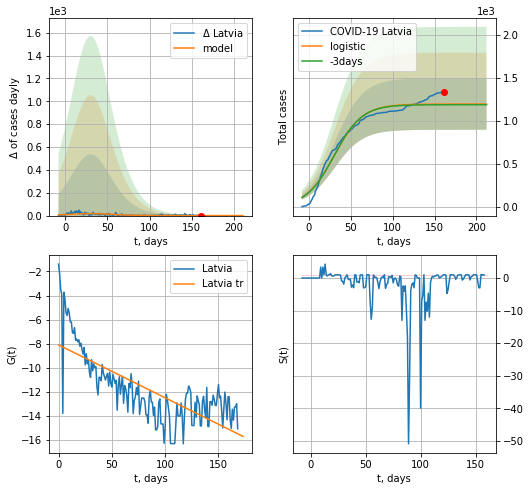

Latvia data at: 2020-11-12
+3 day model MAPE: 0.006385594006530808
model: logistic
coeffs:  [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.2505192877675996
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1194 ± 299
	 total death:  13 ± 9
trend coefficient of determination: 0.548772
 intercept: -8.111036
 slope: -0.044049


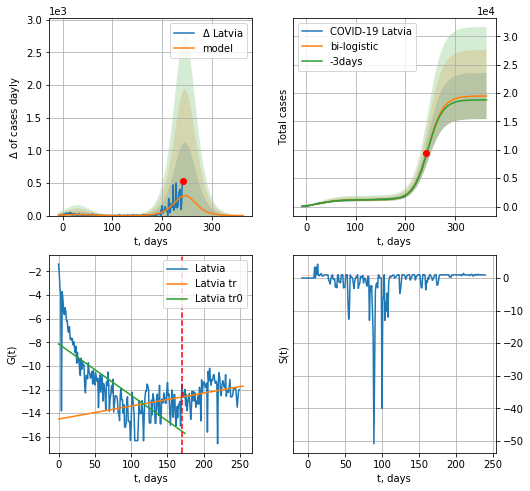

Latvia data at: 2020-11-12
+3 day model MAPE: 0.004101226026544856
model: bi-logistic
coeffs:  [1.82822844e+04 6.71102411e-02 2.45777111e+02] [1.19448476e+03 5.92278882e-02 3.05409104e+01]
rational stdev:  0.20837086766100174
forecast at the end of period: +121 days
	 deltaDaycases:  0
	 total cases:  19469 ± 4056
	 total death:  222 ± 138
bi-logistic approximation splitting point: 170
trend0 coefficient of determination: 0.544306
 intercept: -8.141730
 slope: -0.043501
trend coefficient of determination: 0.055660
 intercept: -14.498313
 slope: 0.010987


In [1183]:
vL=170
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,50*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


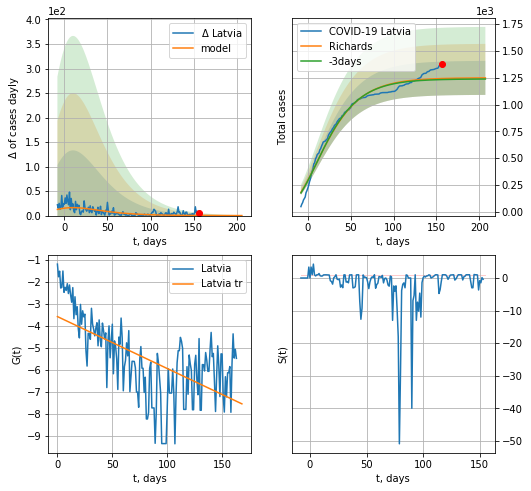

Latvia data at: 2020-11-12
+3 day model MAPE: 0.007772
model: Richards
coeffs: [ 1.24930626e+03  6.40625024e+00 -1.35573848e+02  5.54745387e-03]
rational stdev: 0.126894
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1248 ± 158
	 total death: 14 ± 5
trend coefficient of determination: 0.384319
 intercept: -3.580648
 slope: -0.023612


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


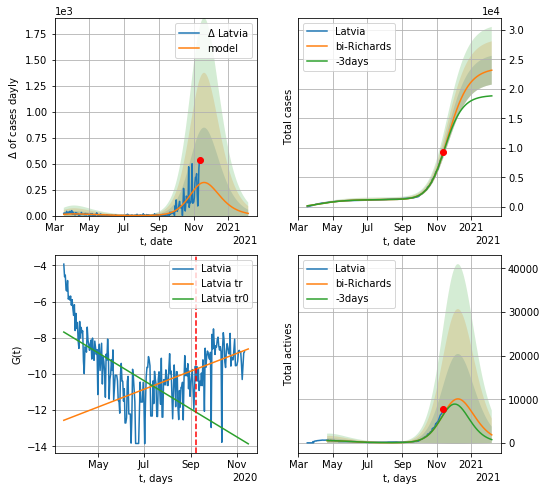

Latvia data at: 2020-11-12
+3 day model MAPE: 0.010424
model: bi-Richards
coeffs: [2.23363458e+04 7.86381627e-02 2.31027029e+02 6.45875747e-01]
rational stdev: 0.105580
forecast at the end of period: +86 days
	 deltaDaycases: 21
	 total cases: 23174 ± 2446
	 total death: 264 ± 83
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.403325
 intercept: -7.682892
 slope: -0.025333
trend coefficient of determination: 0.074256
 intercept: -12.562937
 slope: 0.016168


In [1184]:
iL=10
vL = 175+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*T18-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Latvia',dfLV[iL:],d12f(1),7*45-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

In [1185]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
#x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


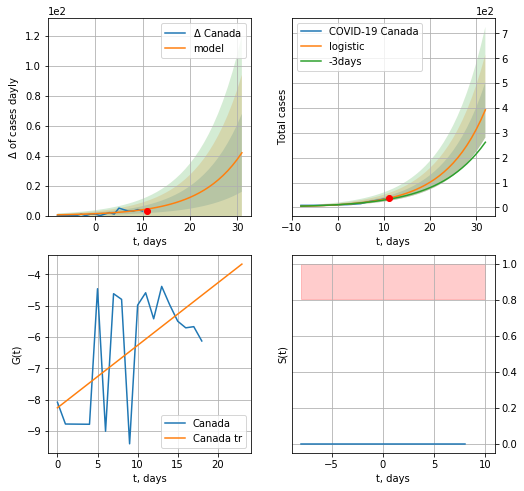

Canada data at: 2020-11-12
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  14 ± 11
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


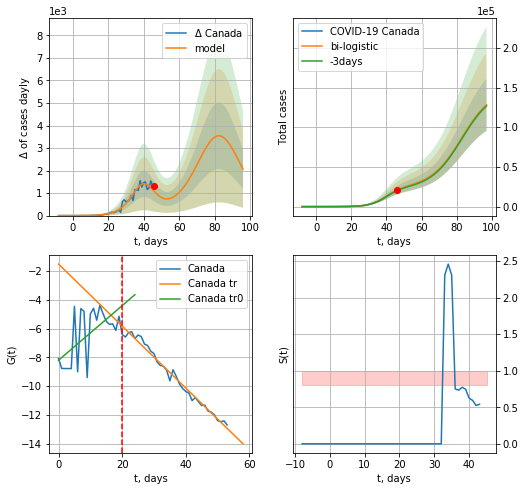

Canada data at: 2020-11-12
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +51 days
	 deltaDaycases:  2063
	 total cases:  128236 ± 32691
	 total death:  4886 ± 3736
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


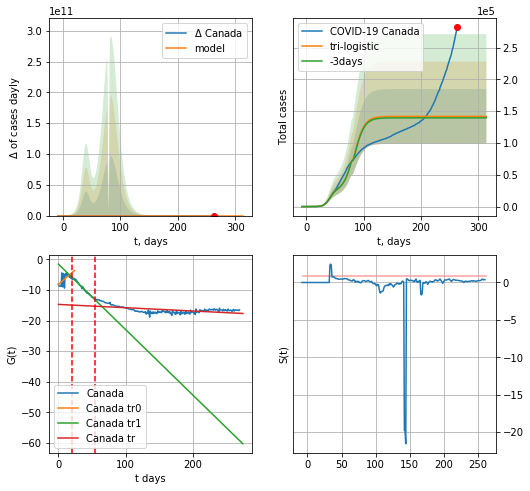

Canada data at: 2020-11-12
+3 day model MAPE: 0.01632249497741837
model: tri-logistic
coeffs:  [-7.50135714e+03  2.02099645e+00  7.98032094e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  0.30382810301827035
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  141857 ± 43100
	 total death:  5405 ± 4926
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.320170
 intercept: -14.743257
 slope: -0.010744


In [1186]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active    death
267 2020-11-08  264113.0   38586  10522.0
268 2020-11-09  268735.0   39771  10564.0
269 2020-11-10  273037.0   41126  10632.0
270 2020-11-11  277061.0   43177  10685.0
271 2020-11-12  282577.0   45034  10768.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


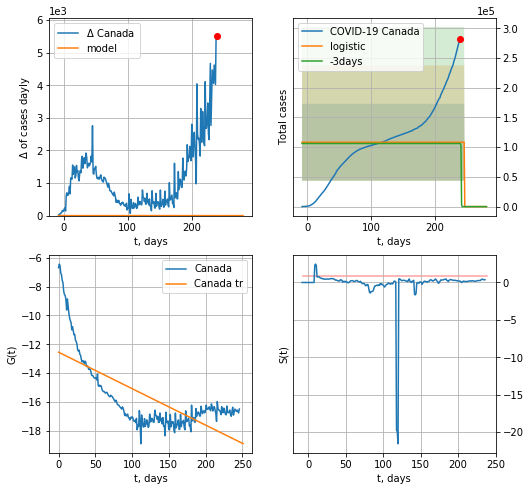

Canada data at: 2020-11-12
+3 day model MAPE: 0.01956980911342929
model: logistic
coeffs:  [108228.09671678   -145.83464126    246.69609195]
rational stdev:  0.59749622821404
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.497181
 intercept: -12.552210
 slope: -0.025257


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp


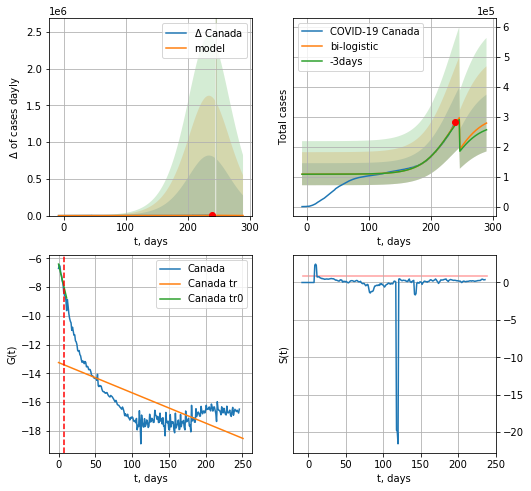

Canada data at: 2020-11-12
+3 day model MAPE: 0.01617531930965835
model: bi-logistic
coeffs:  [3.06778563e+05 4.16041986e-02 2.34693747e+02] [108228.09671678   -145.83464126    246.69609195]
rational stdev:  0.3395640841347062
forecast at the end of period: +51 days
	 deltaDaycases:  1074
	 total cases:  278848 ± 94686
	 total death:  10625 ± 10823
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.475553
 intercept: -13.246978
 slope: -0.021055


In [1187]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

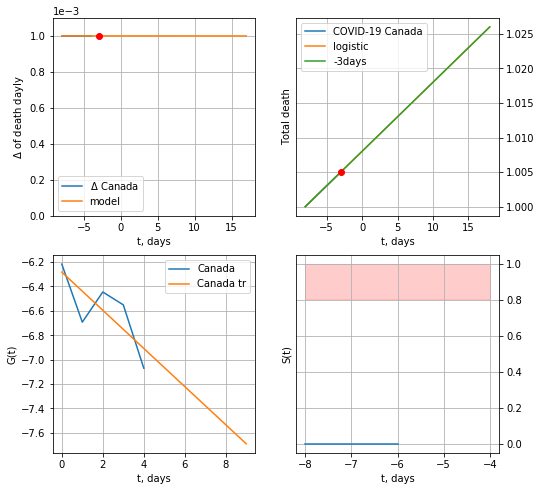

Canada data at: 2020-11-12
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


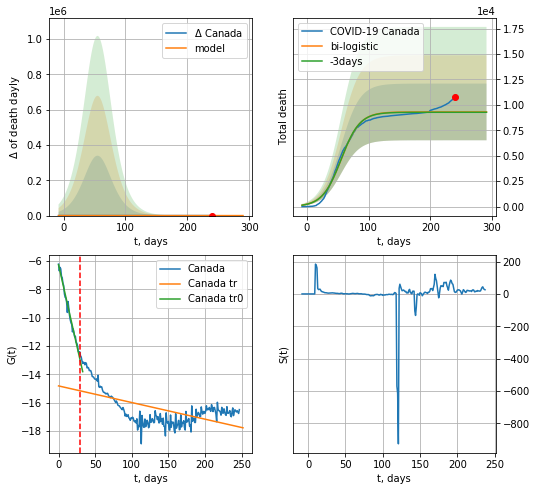

Canada data at: 2020-11-12
+3 day model MAPE: 0.0037368079525734333
model: bi-logistic
coeffs:  [9.31039425e+03 6.56786294e-02 5.54691936e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.29926843936871506
forecast at the end of period: +51 days
	 deltaDaydeath:  0
	 total death:  9311 ± 2786
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.347583
 intercept: -14.816310
 slope: -0.011739


In [1188]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


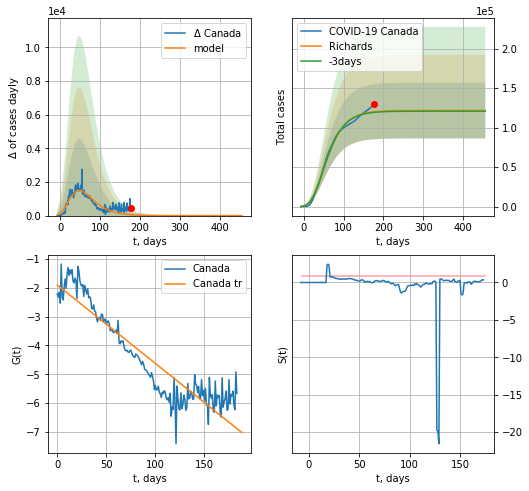

Canada data at: 2020-11-12
+3 day model MAPE: 0.006183
model: Richards
coeffs: [ 1.21659605e+05  6.14824851e+00 -1.08149315e+02  5.44441705e-03]
rational stdev: 0.289891
forecast at the end of period: +280 days
	 deltaDaycases: 0
	 total cases: 121659 ± 35267
	 total death: 4636 ± 4031
trend coefficient of determination: 0.846084
 intercept: -1.903764
 slope: -0.027207


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


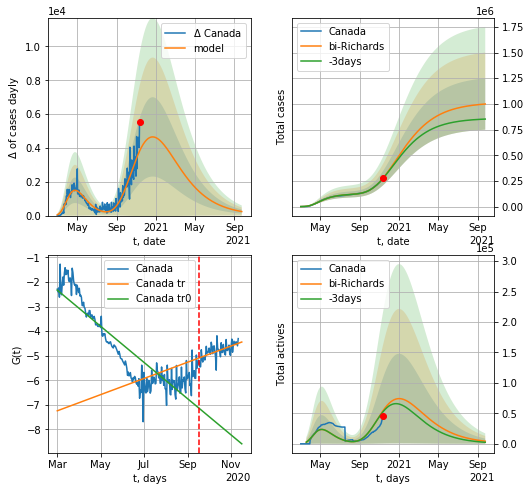

Canada data at: 2020-11-12
+3 day model MAPE: 0.007939
model: bi-Richards
coeffs: [8.93752810e+05 4.88162509e-01 4.24567895e+01 2.93939440e-02]
rational stdev: 0.250527
forecast at the end of period: +317 days
	 deltaDaycases: 238
	 total cases: 998723 ± 250207
	 total death: 38057 ± 28602
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.775328
 intercept: -2.333974
 slope: -0.024054
trend coefficient of determination: 0.352849
 intercept: -7.243943
 slope: 0.010768


In [1423]:
iL = 15
vL = 200 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Canada',dfCA[iL:],d1,78*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

In [1190]:
#x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date   cases  active   death
251 2020-11-08  179324   76647  2896.0
252 2020-11-09  183420   78378  2959.0
253 2020-11-10  187237   77338  3021.0
254 2020-11-11  192172   78716  3103.0
255 2020-11-12  198011   81141  3181.0


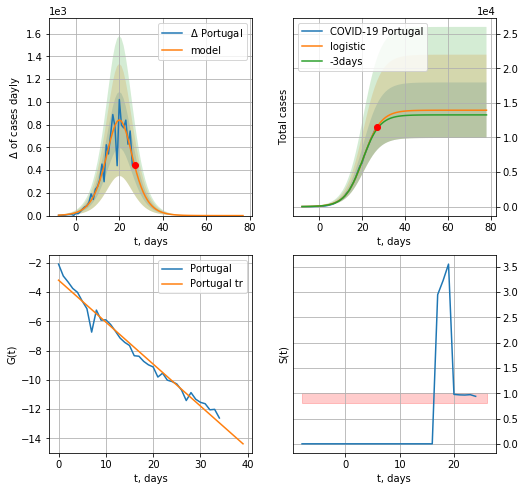

Portugal data at: 2020-11-12
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  13943 ± 4016
	 total death:  223 ± 192
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


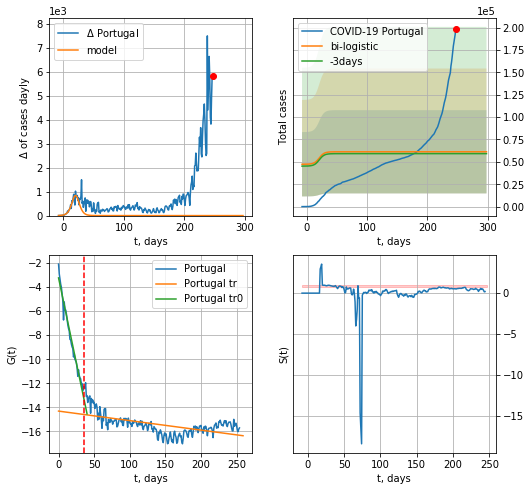

Portugal data at: 2020-11-12
+3 day model MAPE: 0.035254178543727914
model: bi-logistic
coeffs:  [ 3.78357532e+04 -1.36065706e+01  3.33979443e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.7591830478144407
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  61238 ± 46491
	 total death:  983 ± 2238
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.326705
 intercept: -14.319585
 slope: -0.007918


In [1191]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


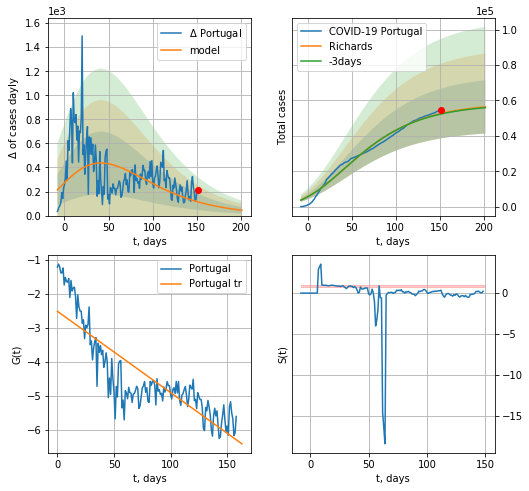

Portugal data at: 2020-11-12
+3 day model MAPE: 0.005487
model: Richards
coeffs: [ 5.85732808e+04  3.00313335e+00 -2.03470726e+02  6.78095718e-03]
rational stdev: 0.266912
forecast at the end of period: +51 days
	 deltaDaycases: 44
	 total cases: 56375 ± 15047
	 total death: 905 ± 724
trend coefficient of determination: 0.725401
 intercept: -2.517362
 slope: -0.023928


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


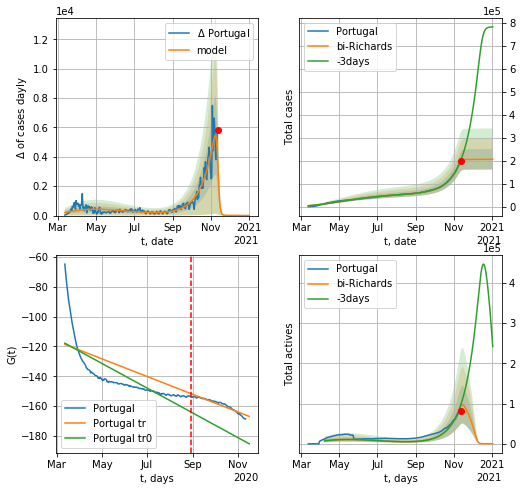

Portugal data at: 2020-11-12
+3 day model MAPE: 0.049688
model: bi-Richards
coeffs: [1.48066865e+05 4.81270719e-02 2.37245833e+02 1.35376635e+01]
rational stdev: 0.216680
forecast at the end of period: +51 days
	 deltaDaycases: 7
	 total cases: 206252 ± 44690
	 total death: 3313 ± 2153
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.597984
 intercept: -117.863243
 slope: -0.270431
trend coefficient of determination: 0.917128
 intercept: -118.624080
 slope: -0.193698


In [1424]:
iL = 10
vL=170+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

In [1193]:
#x = forecastRRR('Portugal',dfPT[:],d1,T18*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

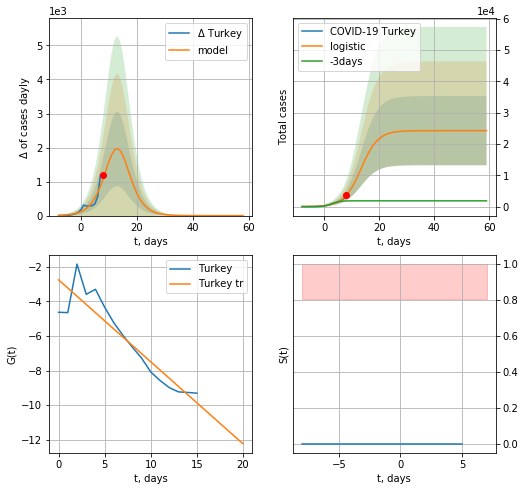

Turkey data at: 2020-11-12
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  24267 ± 11046
	 total death:  673 ± 919
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


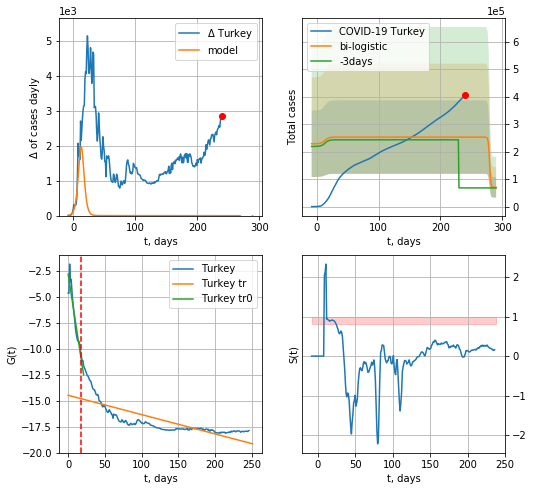

Turkey data at: 2020-11-12
+3 day model MAPE: 2.7166412694395197
model: bi-logistic
coeffs:  [ 1.82833962e+05 -1.04092740e+00  2.79380992e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5284404265907313
forecast at the end of period: +51 days
	 deltaDaycases:  -5
	 total cases:  69978 ± 36979
	 total death:  1941 ± 3077
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.588480
 intercept: -14.470279
 slope: -0.018618


In [1194]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


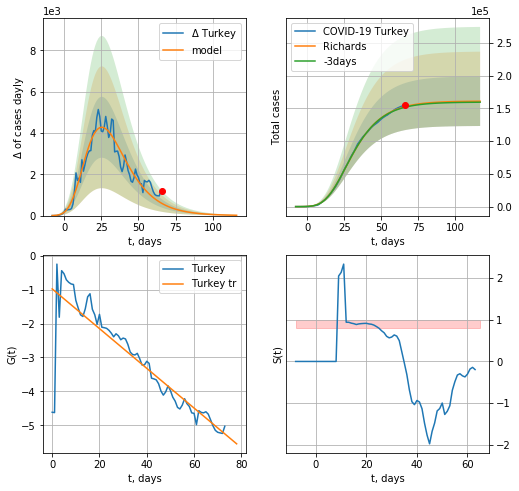

Turkey data at: 2020-11-12
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +51 days
	 deltaDaycases: 16
	 total cases: 161018 ± 37851
	 total death: 4467 ± 3150
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


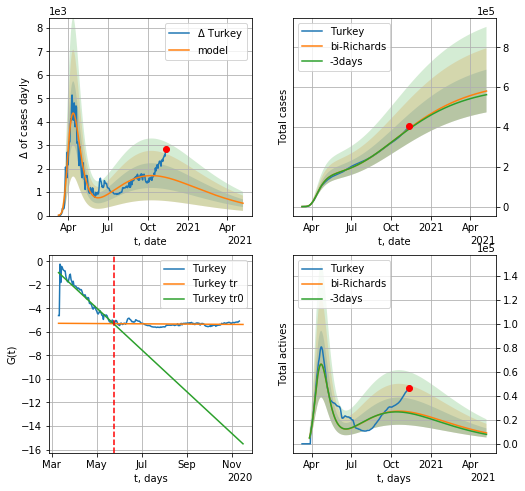

Turkey data at: 2020-11-12
+3 day model MAPE: 0.006360
model: bi-Richards
coeffs: [ 4.76847061e+05  1.03408326e+00 -2.72215263e+02  9.43829953e-03]
rational stdev: 0.184935
forecast at the end of period: +177 days
	 deltaDaycases: 526
	 total cases: 580729 ± 107397
	 total death: 16111 ± 8938
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.777037
 intercept: -0.967275
 slope: -0.057944
trend coefficient of determination: 0.013436
 intercept: -5.272363
 slope: -0.000389


In [1426]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Turkey',dfTR[:],d1,58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [1196]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

In [1197]:
#x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [1198]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0],dfTT[dfTT.Country=='%s'%("Lithuania")][0].values[0]

(0.01140603347191131, 0.00818462364148665)

In [1199]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date     cases  active   death
249 2020-11-08  568138.0  340722  8045.0
250 2020-11-09  580725.0  340722  8045.0
251 2020-11-10  593592.0  354556  8375.0
252 2020-11-11  618813.0  367133  8805.0
253 2020-11-12  641496.0  378067  9080.0


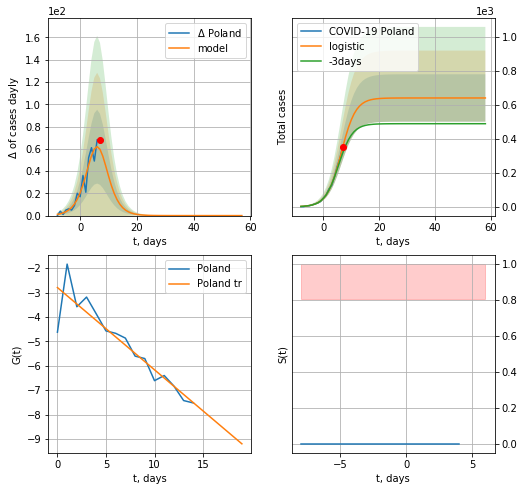

Poland data at: 2020-11-12
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  9 ± 5
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


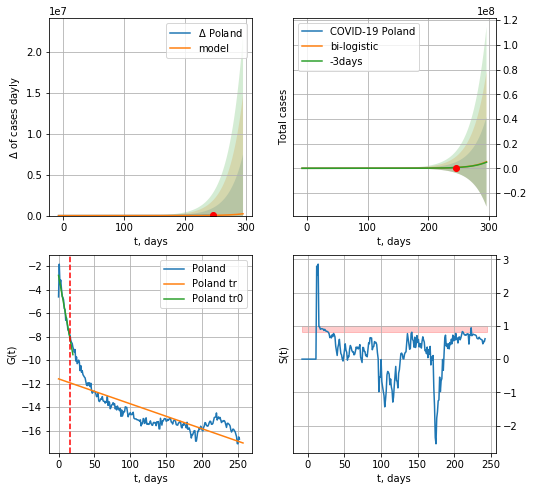

Poland data at: 2020-11-12
+3 day model MAPE: 0.024847081913906065
model: bi-logistic
coeffs:  [3.09025130e+09 4.21106963e-02 4.46896165e+02] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  6.7840245273711455
forecast at the end of period: +51 days
	 deltaDaycases:  220871
	 total cases:  5365807 ± 36401771
	 total death:  75949 ± 1545719
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.655945
 intercept: -11.598959
 slope: -0.021229


In [1200]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


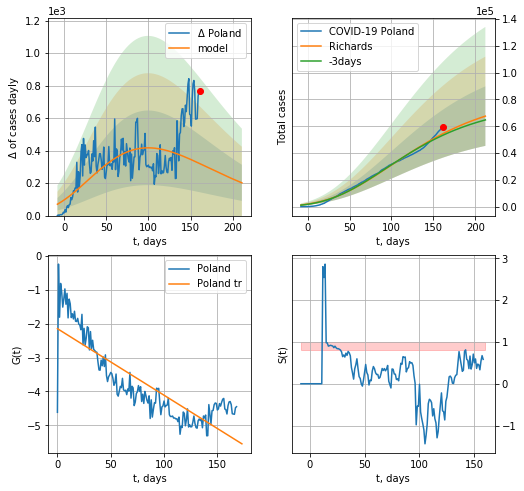

Poland data at: 2020-11-12
+3 day model MAPE: 0.021663
model: Richards
coeffs: [ 8.41741058e+04  1.47966569e+00 -2.46676717e+02  9.14859854e-03]
rational stdev: 0.328700
forecast at the end of period: +51 days
	 deltaDaycases: 201
	 total cases: 67577 ± 22212
	 total death: 956 ± 942
trend coefficient of determination: 0.711205
 intercept: -2.146265
 slope: -0.019650


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


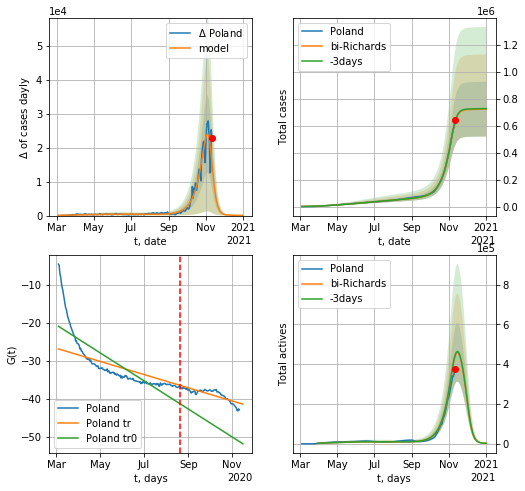

Poland data at: 2020-11-12
+3 day model MAPE: 0.005354
model: bi-Richards
coeffs: [6.44706072e+05 7.89675344e-02 2.41949951e+02 2.95321198e+00]
rational stdev: 0.281092
forecast at the end of period: +51 days
	 deltaDaycases: 75
	 total cases: 723150 ± 203271
	 total death: 10235 ± 8630
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.682215
 intercept: -20.935695
 slope: -0.119848
trend coefficient of determination: 0.690863
 intercept: -26.864782
 slope: -0.056335


In [1427]:
vL = 170
x =  forecastRR('Poland',dfPL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RRD('Poland',dfPL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

In [1202]:
#x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date     cases  active   death
260 2020-11-08  319562.0    8153  2674.0
261 2020-11-09  320184.0    8082  2678.0
262 2020-11-10  320912.0    8167  2684.0
263 2020-11-11  321326.0    8021  2700.0
264 2020-11-12  322159.0    8848  2706.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


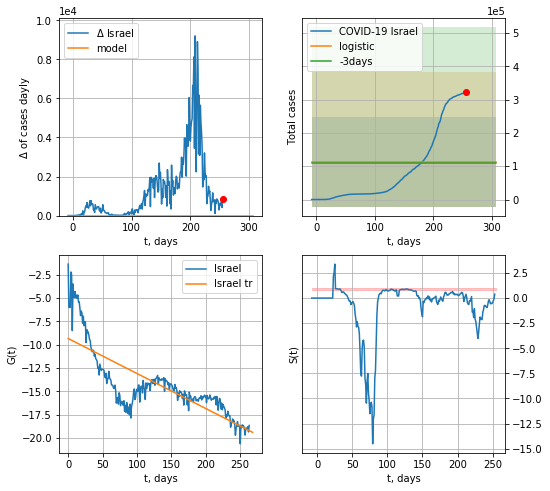

Israel data at: 2020-11-12
+3 day model MAPE: 0.029917795944468487
model: logistic
coeffs:  [ 9.08885355e+04 -3.84594969e+01  9.24757868e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.1867729540160878
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  113610 ± 134830
	 total death:  954 ± 3396
trend coefficient of determination: 0.634836
 intercept: -9.339344
 slope: -0.037461


In [1203]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


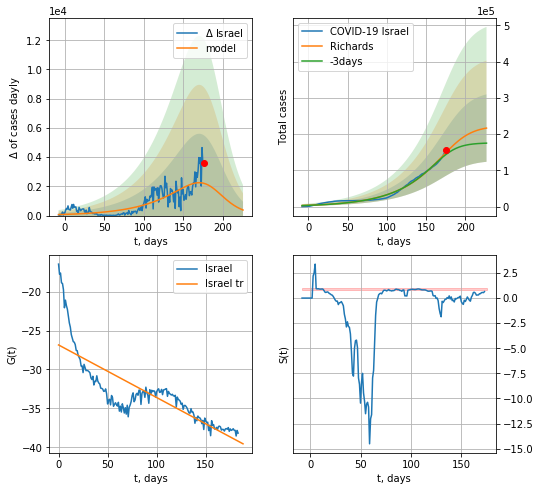

Israel data at: 2020-11-12
+3 day model MAPE: 0.043052
model: Richards
coeffs: [2.22982517e+05 2.18053289e-02 1.87753593e+02 2.87495191e+00]
rational stdev: 0.429268
forecast at the end of period: +51 days
	 deltaDaycases: 382
	 total cases: 216715 ± 93029
	 total death: 1820 ± 2343
trend coefficient of determination: 0.666990
 intercept: -26.852072
 slope: -0.067481


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


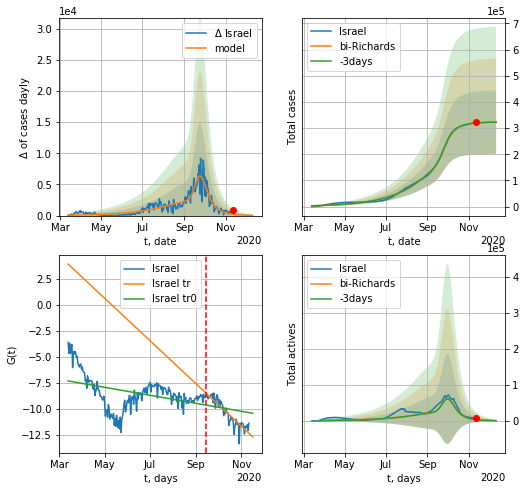

Israel data at: 2020-11-12
+3 day model MAPE: 0.000985
model: bi-Richards
coeffs: [1.00669918e+05 3.42233415e-01 1.82231765e+02 4.26682478e-01]
rational stdev: 0.375372
forecast at the end of period: +30 days
	 deltaDaycases: 36
	 total cases: 323079 ± 121275
	 total death: 2713 ± 3055
bi-Richards approximation splitting point: 185
trend coefficient of determination: 0.167014
 intercept: -7.304148
 slope: -0.012514
trend coefficient of determination: 0.833178
 intercept: 3.923437
 slope: -0.066894


In [1428]:
vL = 185+20
x = forecastRR('Israel',dfIS[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Israel',dfIS[20:],d1,37*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.33)

In [1205]:
#x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1206]:
#x = forecastRRR('Israel',dfIS[27:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date     cases  active   death
257 2020-11-08  223300.0  121841  2772.0
258 2020-11-09  229222.0  139020  2902.0
259 2020-11-10  235202.0  109589  3013.0
260 2020-11-11  243472.0  110359  3113.0
261 2020-11-12  250396.0  106180  3216.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


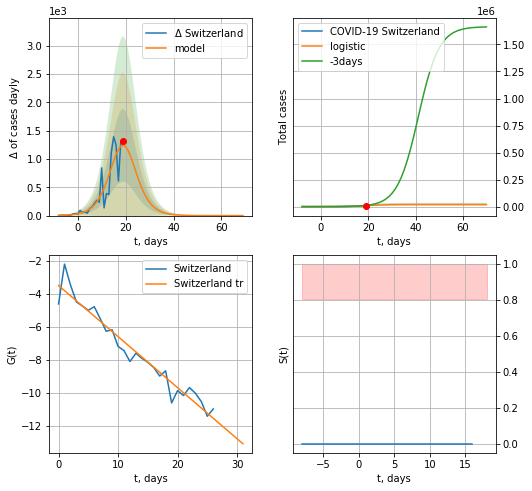

Switzerland data at: 2020-11-12
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  18706 ± 5724
	 total death:  240 ± 220
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


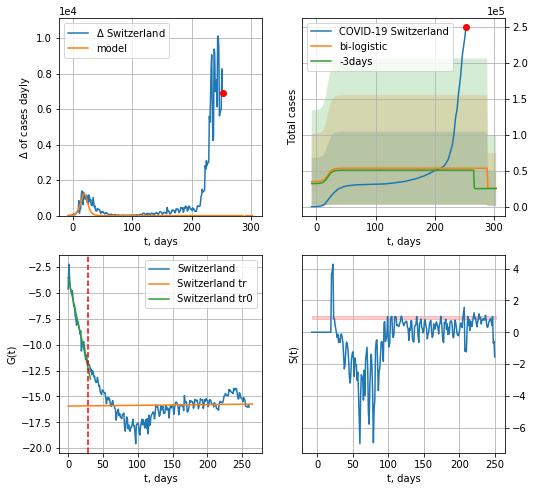

Switzerland data at: 2020-11-12
+3 day model MAPE: 0.05607776638428584
model: bi-logistic
coeffs:  [ 2.78841675e+04 -1.17535709e+01  2.89490101e+02] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9505710940811214
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  25677 ± 24407
	 total death:  329 ± 938
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.001349
 intercept: -15.931823
 slope: 0.000727


In [1207]:
vL= 28
try:
    dfSZ = read_df(pd.DataFrame(),"SZ")
    x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
    xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


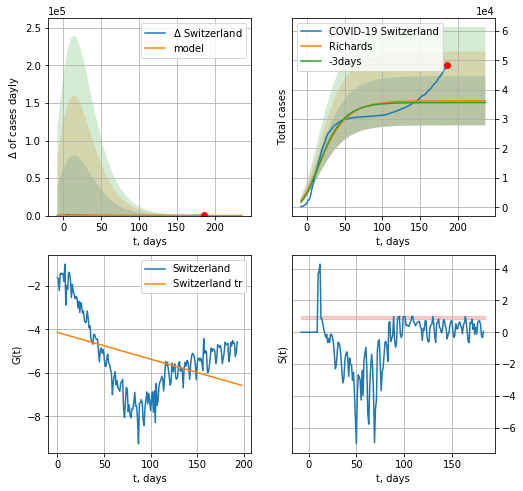

Switzerland data at: 2020-11-12
+3 day model MAPE: 0.017011
model: Richards
coeffs: [ 3.62432935e+04  1.60636037e+01 -1.13737864e+02  2.85003887e-03]
rational stdev: 0.231139
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 36241 ± 8376
	 total death: 465 ± 322
trend coefficient of determination: 0.162726
 intercept: -4.134057
 slope: -0.012335


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


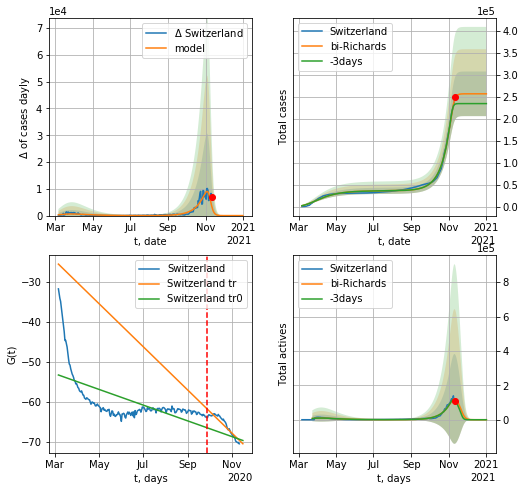

Switzerland data at: 2020-11-12
+3 day model MAPE: 0.066611
model: bi-Richards
coeffs: [2.20435206e+05 6.85533924e-02 2.39625304e+02 5.38745646e+00]
rational stdev: 0.197534
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 256678 ± 50702
	 total death: 3296 ± 1953
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.386393
 intercept: -53.308220
 slope: -0.064372
trend coefficient of determination: 0.861392
 intercept: -25.518581
 slope: -0.176572


In [1430]:
iL = 10
vL = 205 + iL#175 + iL#85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Switzerland',dfSZ[iL:],d12f(1),7*40-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

In [1209]:
#x = forecastRRR('Switzerland',dfSZ[:],d1,7*T18-dT,addpred=False,xcoef=koreaCoeffs)

In [1210]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date     cases  active   death
243 2020-11-08  469018.0  251310  8565.0
244 2020-11-09  479197.0  255784  8756.0
245 2020-11-10  489808.0  259402  8947.0
246 2020-11-11  500865.0  264026  9145.0
247 2020-11-12  512652.0  269486  9317.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:87: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


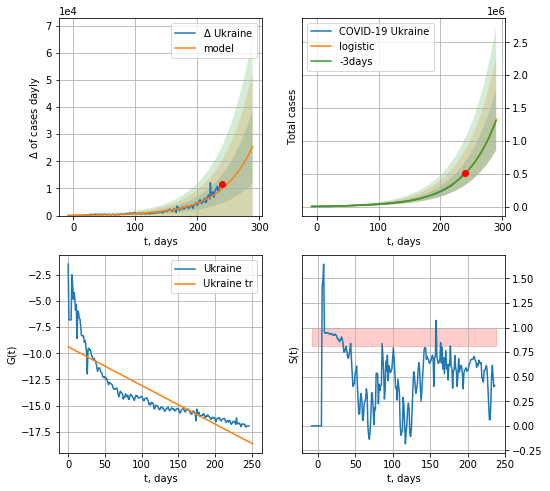

Ukraine data at: 2020-11-12
+3 day model MAPE: 0.008190097758442936
model: logistic
coeffs:  [5.57952278e+08 1.93526179e-02 6.01957510e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.35256551025603583
forecast at the end of period: +51 days
	 deltaDaycases:  25419
	 total cases:  1329357 ± 468685
	 total death:  24159 ± 25552
trend coefficient of determination: 0.730527
 intercept: -9.387627
 slope: -0.036823


In [1211]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


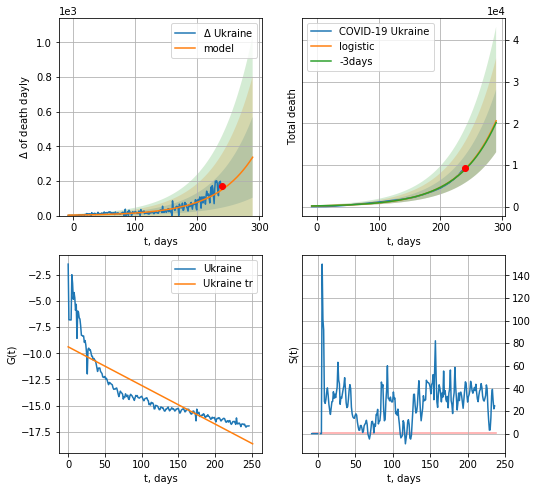

Ukraine data at: 2020-11-12
+3 day model MAPE: 0.010939232377799972
model: logistic
coeffs:  [1.04862226e+07 1.65299821e-02 6.66953390e+02]
rational stdev:  0.36493122891223173
forecast at the end of period: +51 days
	 total death:  20590 ± 7514
trend coefficient of determination: 0.730527
 intercept: -9.387627
 slope: -0.036823


In [1212]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


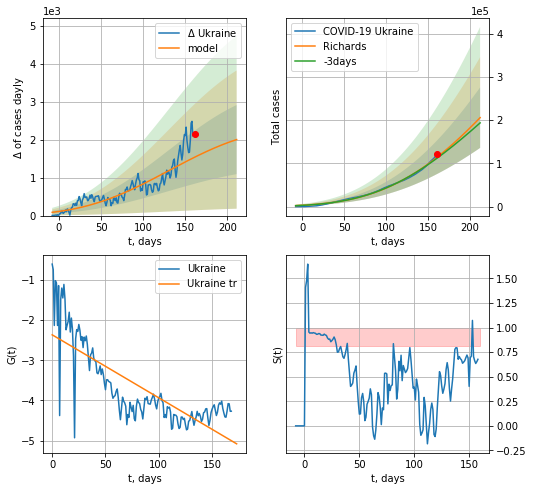

Ukraine data at: 2020-11-12
+3 day model MAPE: 0.020951
model: Richards
coeffs: [ 9.71556496e+05  3.24855332e-01 -3.33588886e+02  1.96162664e-02]
rational stdev: 0.340033
forecast at the end of period: +51 days
	 deltaDaycases: 2001
	 total cases: 205844 ± 69994
	 total death: 3741 ± 3816
trend coefficient of determination: 0.622475
 intercept: -2.366387
 slope: -0.015671


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


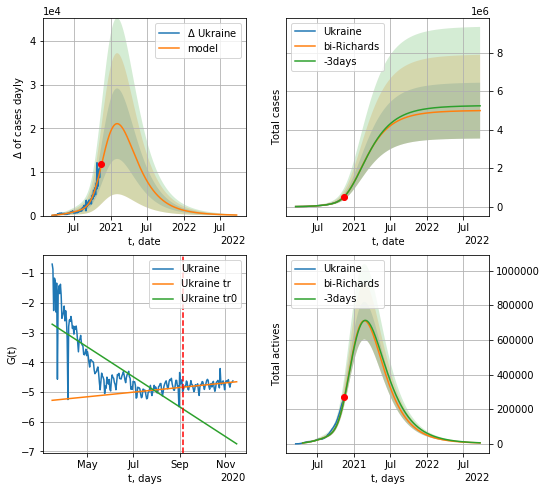

Ukraine data at: 2020-11-12
+3 day model MAPE: 0.003619
model: bi-Richards
coeffs: [4.03649630e+06 2.01729960e-01 1.09440675e+02 6.49491566e-02]
rational stdev: 0.290729
forecast at the end of period: +681 days
	 deltaDaycases: 130
	 total cases: 4989237 ± 1450516
	 total death: 90675 ± 79085
bi-Richards approximation splitting point: 175
trend coefficient of determination: 0.627757
 intercept: -2.718202
 slope: -0.016361
trend coefficient of determination: 0.137079
 intercept: -5.279443
 slope: 0.002538


In [1213]:
vL = 180#65+5 +55
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*T18-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RRD('Ukraine',dfUR[5:],d1,7*130-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [1214]:
#x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [1215]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

In [1216]:
dfIN = read_df(pd.DataFrame(),"IN")
#x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
#xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

IN
           date   cases  active    death
263 2020-11-08  682486  123866  38291.0
264 2020-11-09  692949  128559  38749.0
265 2020-11-10  703288  133392  39202.0
266 2020-11-11  715068  139299  39664.0
267 2020-11-12  726585  144898  40121.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


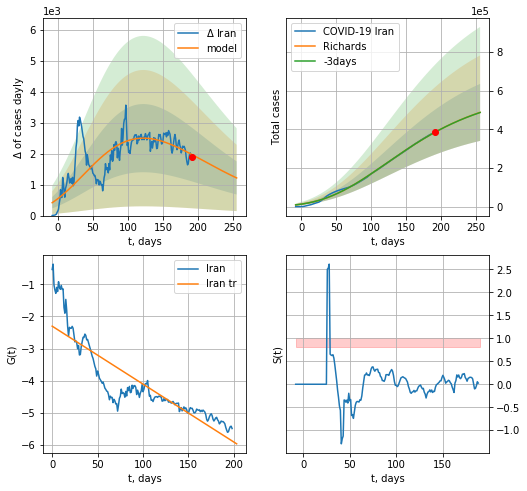

Iran data at: 2020-11-12
+3 day model MAPE: 0.000431
model: Richards
coeffs: [ 6.07518429e+05  7.96228644e-01 -2.54493530e+02  1.41818761e-02]
rational stdev: 0.302382
forecast at the end of period: +65 days
	 deltaDaycases: 1218
	 total cases: 487131 ± 147299
	 total death: 26898 ± 24400
trend coefficient of determination: 0.763759
 intercept: -2.302474
 slope: -0.018078


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


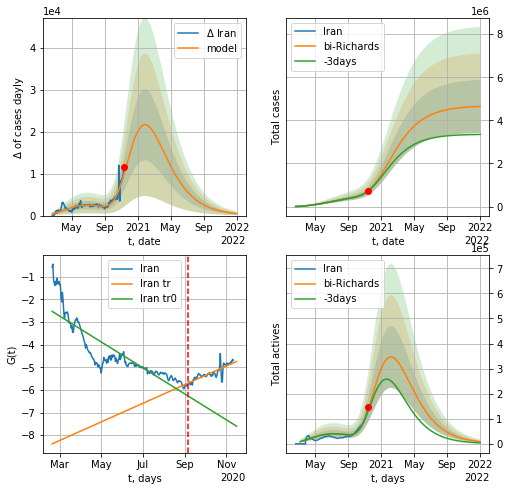

Iran data at: 2020-11-12
+3 day model MAPE: 0.007322
model: bi-Richards
coeffs: [4.07356736e+06 3.56379176e-01 1.13270437e+02 4.03707238e-02]
rational stdev: 0.264423
forecast at the end of period: +415 days
	 deltaDaycases: 468
	 total cases: 4648372 ± 1229138
	 total death: 256676 ± 203613
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.762009
 intercept: -2.531588
 slope: -0.018722
trend coefficient of determination: 0.702472
 intercept: -8.383251
 slope: 0.013433


In [1431]:
vL = 200
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Iran',dfIN[:],d12f(1),92*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [1218]:
#x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR('Iran',dfIN[:],d1,66*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date      cases  active    death
253 2020-11-08  1774334.0  430198  30793.0
254 2020-11-09  1796132.0  435207  31161.0
255 2020-11-10  1817109.0  436010  31593.0
256 2020-11-11  1836960.0  438368  32032.0
257 2020-11-12  1858568.0  441205  32443.0


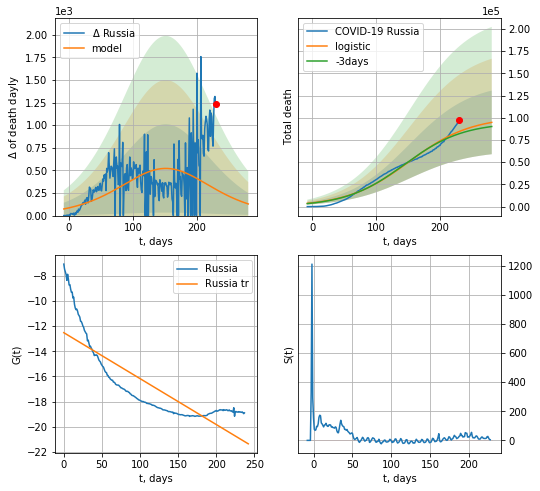

Russia data at: 2020-11-12
+3 day model MAPE: 0.030706164200506723
model: logistic
coeffs:  [1.01464313e+05 2.05613769e-02 1.51690545e+02]
rational stdev:  0.37796851213024096
forecast at the end of period: +51 days
	 total death:  94823 ± 35840
trend coefficient of determination: 0.687982
 intercept: -12.522217
 slope: -0.036461


In [1222]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


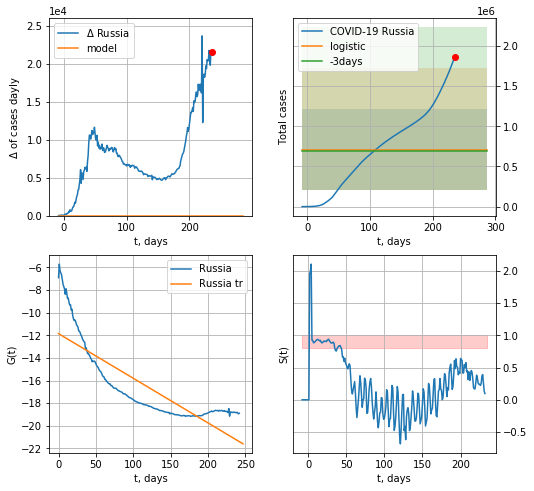

Russia data at: 2020-11-12
+3 day model MAPE: 0.020111751234864774
model: logistic
coeffs:  [ 7.11181951e+05 -1.77761222e+01  4.35376375e+02]
rational stdev:  0.7158114739032834
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  711181 ± 509072
	 total death:  12269 ± 26346
trend coefficient of determination: 0.687914
 intercept: -11.854456
 slope: -0.039451


In [1223]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


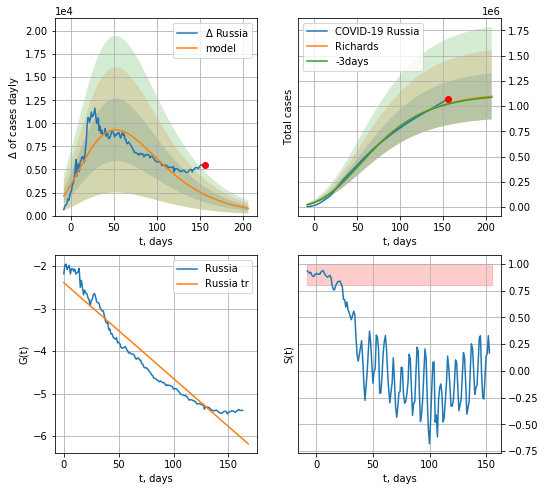

Russia data at: 2020-11-12
+3 day model MAPE: 0.006482
model: Richards
coeffs: [ 1.13371514e+06  2.45412243e+00 -1.57034582e+02  9.12424388e-03]
rational stdev: 0.208462
forecast at the end of period: +51 days
	 deltaDaycases: 785
	 total cases: 1098456 ± 228986
	 total death: 18950 ± 11851
trend coefficient of determination: 0.926508
 intercept: -2.389804
 slope: -0.022577


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


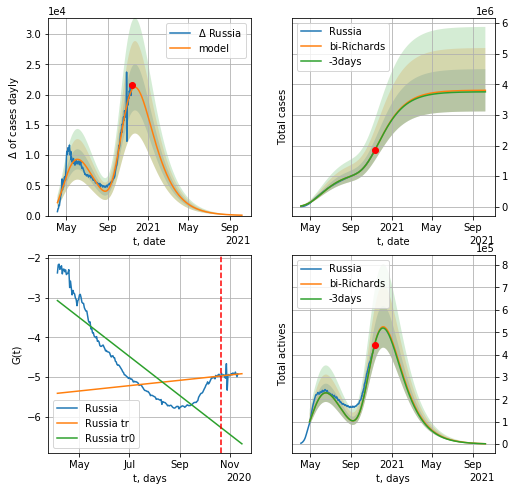

Russia data at: 2020-11-12
+3 day model MAPE: 0.000890
model: bi-Richards
coeffs: [2.67448383e+06 6.69052608e-01 6.48208692e+01 3.19301941e-02]
rational stdev: 0.181491
forecast at the end of period: +331 days
	 deltaDaycases: 63
	 total cases: 3805244 ± 690616
	 total death: 65647 ± 35742
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.731649
 intercept: -3.072507
 slope: -0.015938
trend coefficient of determination: 0.016596
 intercept: -5.404169
 slope: 0.002179


In [1432]:
vL = 200 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RRD('Russia',dfRS[35:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35,amc=0.75)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

In [1433]:
#x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date     cases  active   death
291 2020-11-08  107086.0    8077  1812.0
292 2020-11-09  108084.0    8612  1818.0
293 2020-11-10  108983.0    8880  1829.0
294 2020-11-11  110156.0    9207  1841.0
295 2020-11-12  111711.0    9855  1851.0


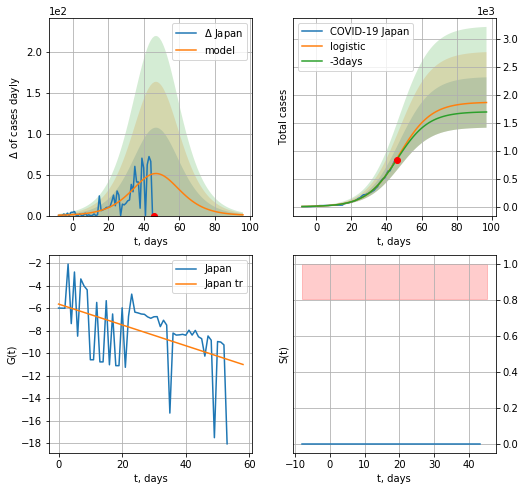

Japan data at: 2020-11-12
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1858 ± 449
	 total death:  30 ± 21
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


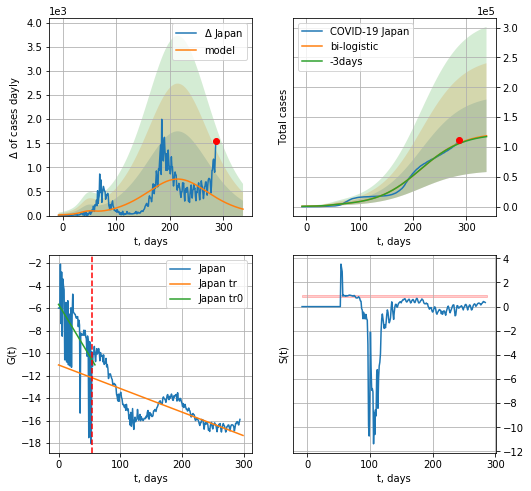

Japan data at: 2020-11-12
+3 day model MAPE: 0.007221229742583968
model: bi-logistic
coeffs:  [1.22476324e+05 2.47575948e-02 2.15257824e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.5123436992128596
forecast at the end of period: +51 days
	 deltaDaycases:  133
	 total cases:  118745 ± 60838
	 total death:  1967 ± 3023
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.585859
 intercept: -11.059196
 slope: -0.020954


In [1226]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

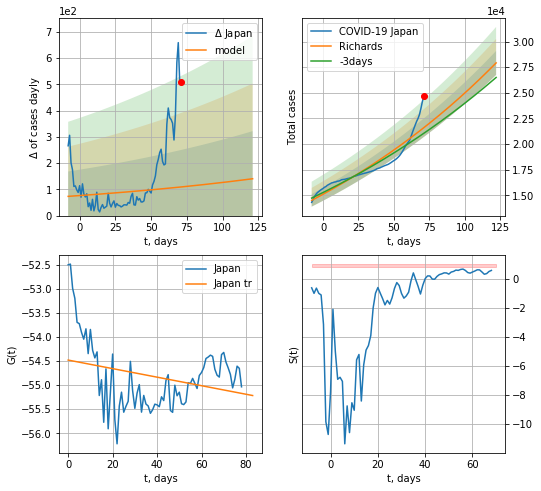

Japan data at: 2020-11-12
+3 day model MAPE: 0.026564
model: Richards
coeffs: [3.86231583e+05 5.03952099e-03 6.43301277e+02 5.05898798e+00]
rational stdev: 0.041949
forecast at the end of period: +51 days
	 deltaDaycases: 140
	 total cases: 27919 ± 1171
	 total death: 462 ± 58
trend coefficient of determination: 0.082257
 intercept: -54.480596
 slope: -0.008865


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


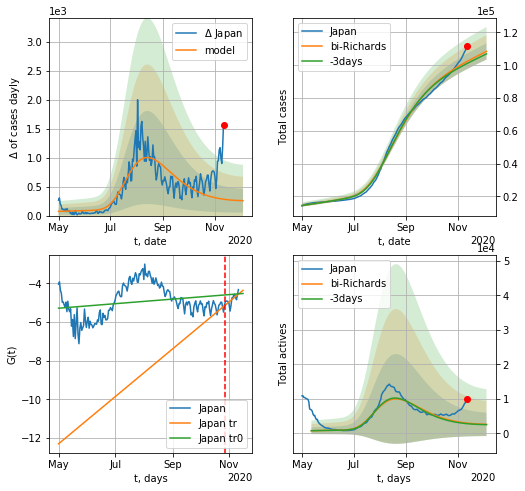

Japan data at: 2020-11-12
+3 day model MAPE: 0.012632
model: bi-Richards
coeffs: [ 6.60125794e+04  7.76961678e+00 -5.16368327e+01  4.66756143e-03]
rational stdev: 0.045873
forecast at the end of period: +23 days
	 deltaDaycases: 257
	 total cases: 108452 ± 4975
	 total death: 1797 ± 247
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.054761
 intercept: -5.289393
 slope: 0.003820
trend coefficient of determination: 0.425825
 intercept: -12.290244
 slope: 0.039827


In [1434]:
iL = 50+50
vL = 180+iL
x = forecastRR('Japan',dfJP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Japan',dfJP[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [1228]:
#x = forecastRRR('Japan',dfJP[54:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date     cases  active   death
255 2020-11-08  410065.0       0  8004.0
256 2020-11-09  414745.0       0  8043.0
257 2020-11-10  419412.0       0  8141.0
258 2020-11-11  424819.0       0  8215.0
259 2020-11-12  430453.0       0  8304.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


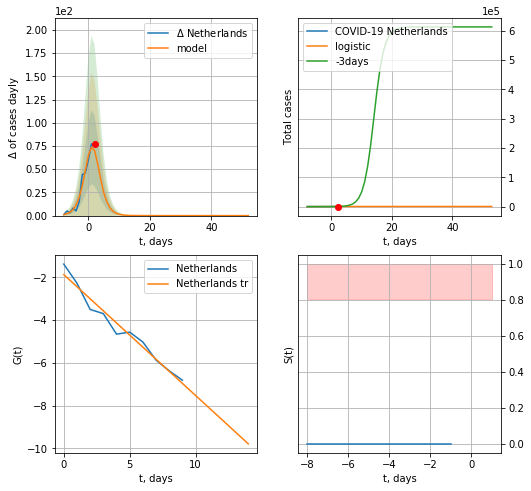

Netherlands data at: 2020-11-12
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  9 ± 6
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


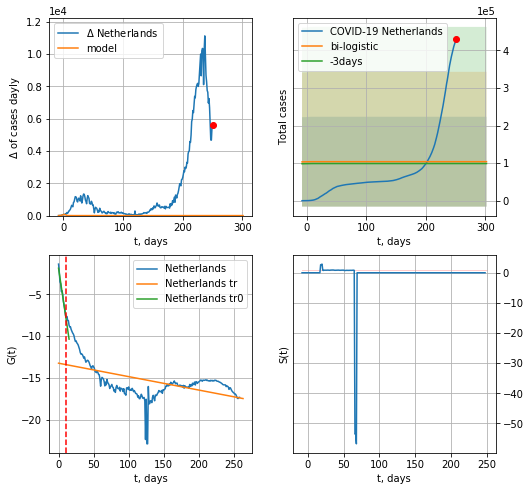

Netherlands data at: 2020-11-12
+3 day model MAPE: 0.050468595048626094
model: bi-logistic
coeffs:  [ 8.26467464e+04 -1.64016375e+01  4.18652860e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.151453034015474
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  103796 ± 119516
	 total death:  2002 ± 6915
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.274482
 intercept: -13.224212
 slope: -0.016059


In [1229]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


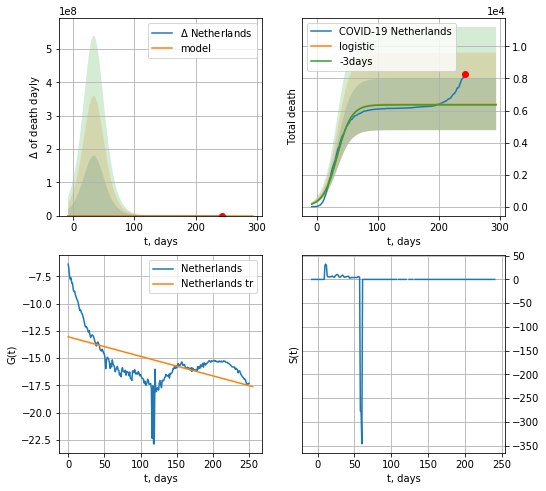

Netherlands data at: 2020-11-12
+3 day model MAPE: 0.005512357528638856
model: logistic
coeffs:  [6.38573266e+03 8.58611252e-02 3.41437891e+01]
rational stdev:  0.25240092110530055
forecast at the end of period: +51 days
	 total death:  6385 ± 1611
trend coefficient of determination: 0.299352
 intercept: -13.047186
 slope: -0.017885


In [1230]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


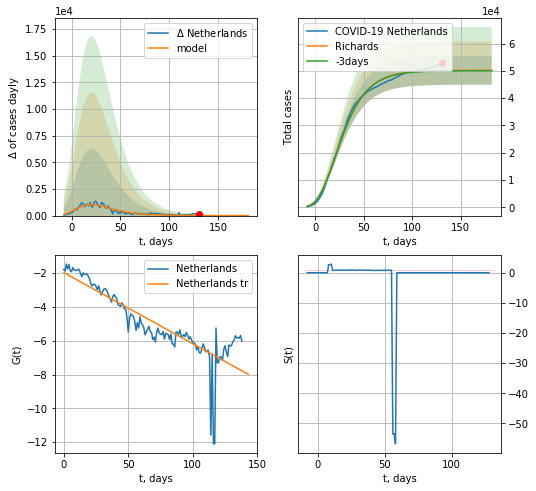

Netherlands data at: 2020-11-12
+3 day model MAPE: 0.003437
model: Richards
coeffs: [ 5.02415869e+04  8.73155449e+00 -6.99416502e+01  6.38067202e-03]
rational stdev: 0.105306
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 50235 ± 5290
	 total death: 969 ± 306
trend coefficient of determination: 0.744376
 intercept: -1.967578
 slope: -0.042068


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


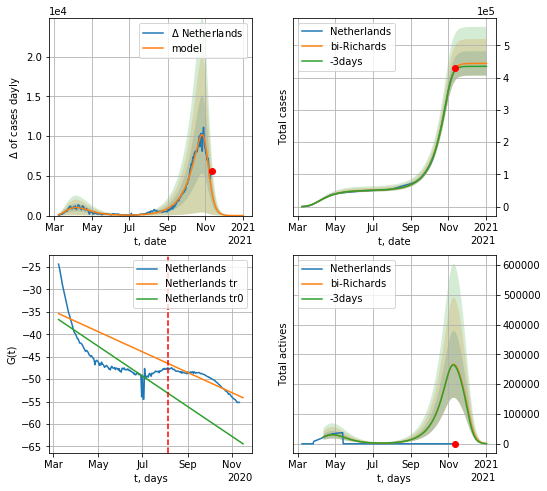

Netherlands data at: 2020-11-12
+3 day model MAPE: 0.011570
model: bi-Richards
coeffs: [3.93655300e+05 4.87956069e-02 2.32351633e+02 3.91957546e+00]
rational stdev: 0.084966
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 443895 ± 37716
	 total death: 8563 ± 2182
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.633354
 intercept: -36.720413
 slope: -0.109493
trend coefficient of determination: 0.858554
 intercept: -35.392203
 slope: -0.074115


In [1231]:
iL = 10
vL = 150+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Netherlands',dfNL[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1232]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


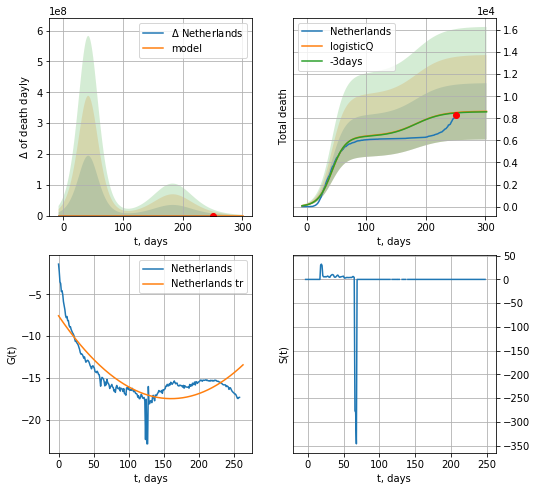

Netherlands data at: 2020-11-12
+3 day model MAPE: 0.004419
model: logisticQ
coeffs: [ 6.38473048e+03  1.38665076e-07  4.21452574e+01 -6.22159311e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.295559
forecast at the end of period: +51 days
	 total death: 8632 ± 2551
trend coefficient of determination: 0.741791
 intercept_: -7.561795337292615
 coeffs_: [ 0.         -0.12333866  0.00038424]


In [1233]:
#x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [1234]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date     cases  active   death
256 2020-11-08  153153.0   60023  1411.0
257 2020-11-09  158746.0   62665  1454.0
258 2020-11-10  164866.0   64704  1499.0
259 2020-11-11  172380.0   67057  1564.0
260 2020-11-12  181642.0   72159  1608.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


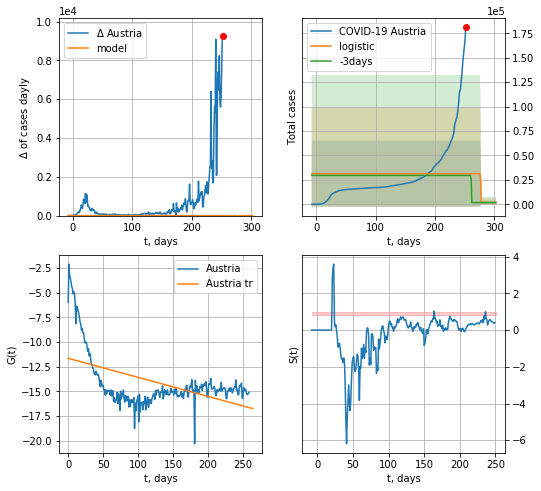

Austria data at: 2020-11-12
+3 day model MAPE: 0.0599904494886782
model: logistic
coeffs:  [ 2.94796247e+04 -1.01048650e+01  2.77095220e+02]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  1.0760183953057814
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1842 ± 1982
	 total death:  16 ± 51
trend coefficient of determination: 0.262873
 intercept: -11.652838
 slope: -0.019278


In [1235]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


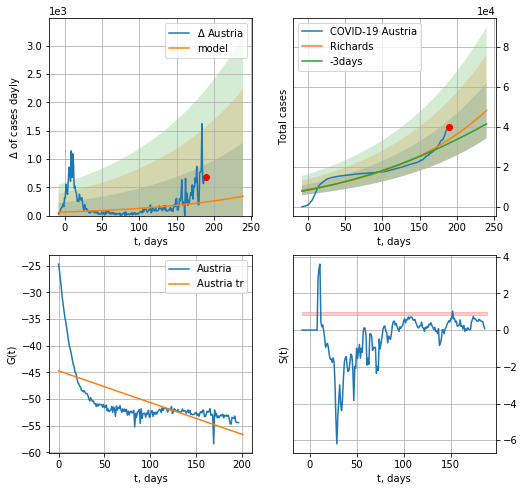

Austria data at: 2020-11-12
+3 day model MAPE: 0.060222
model: Richards
coeffs: [7.79127383e+05 7.10721944e-03 6.31550628e+02 4.75199089e+00]
rational stdev: 0.289325
forecast at the end of period: +51 days
	 deltaDaycases: 341
	 total cases: 48198 ± 13945
	 total death: 426 ± 369
trend coefficient of determination: 0.406393
 intercept: -44.706119
 slope: -0.059607


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


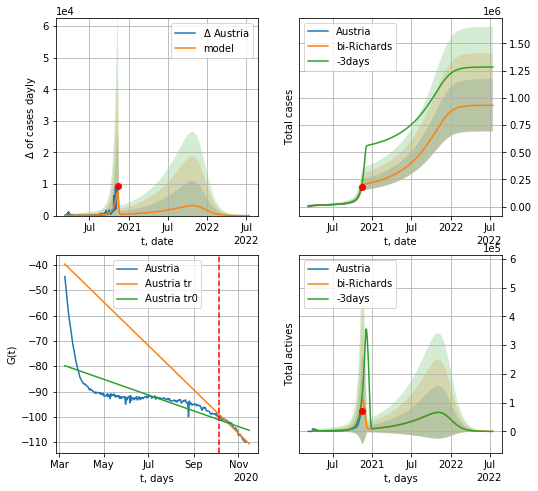

Austria data at: 2020-11-12
+3 day model MAPE: 0.046028
model: bi-Richards
coeffs: [1.52734378e+05 6.76940025e-02 2.41532278e+02 8.84454809e+00]
rational stdev: 0.257778
forecast at the end of period: +611 days
	 deltaDaycases: 3
	 total cases: 931762 ± 240188
	 total death: 8248 ± 6378
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.472083
 intercept: -79.804640
 slope: -0.101308
trend coefficient of determination: 0.948917
 intercept: -39.715551
 slope: -0.281472


In [1437]:
vL=210+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Austria',dfAT[12:],d12f(1),120*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12,amc=0.65)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

In [1237]:
#vL = 68
#x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date     cases  active    death
252 2020-11-08  500789.0  458083  13055.0
253 2020-11-09  503182.0  460170  13216.0
254 2020-11-10  507475.0  463410  13561.0
255 2020-11-11  515391.0  470503  13758.0
256 2020-11-12  520393.0  475130  13891.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


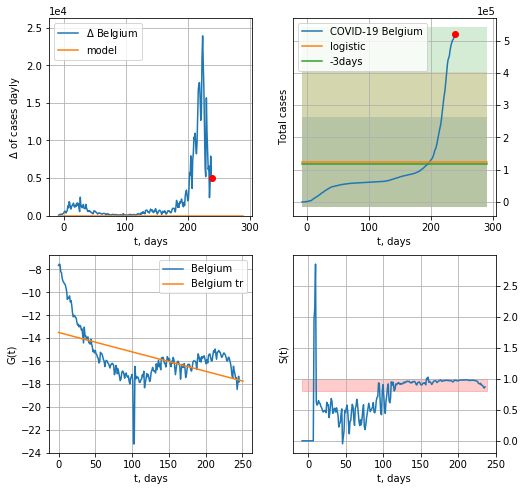

Belgium data at: 2020-11-12
+3 day model MAPE: 0.05346782896907601
model: logistic
coeffs:  [ 9.99859595e+04 -2.53856847e+01  6.68016114e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  1.1134056548442903
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  124982 ± 139156
	 total death:  3336 ± 11142
trend coefficient of determination: 0.278722
 intercept: -13.503921
 slope: -0.016930


In [1238]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

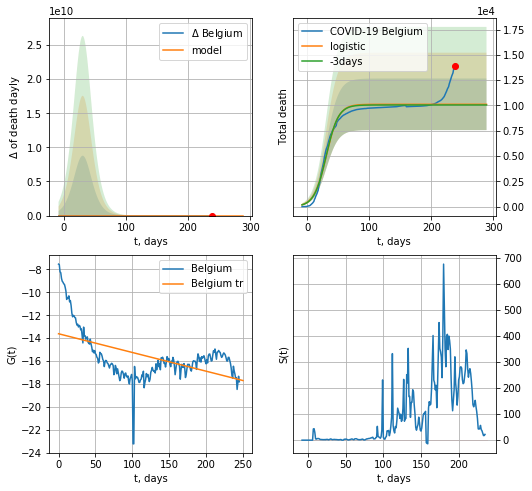

Belgium data at: 2020-11-12
+3 day model MAPE: 0.006693794736249556
model: logistic
coeffs:  [1.01153286e+04 1.01390879e-01 3.11739343e+01]
rational stdev:  0.2520738373350453
forecast at the end of period: +51 days
	 total death:  10115 ± 2549
trend coefficient of determination: 0.269941
 intercept: -13.616059
 slope: -0.016348


In [1239]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


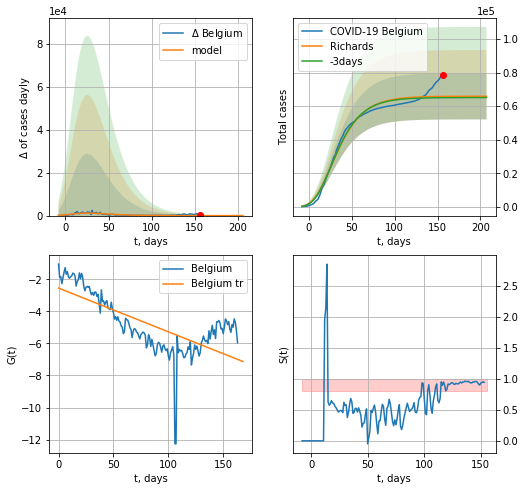

Belgium data at: 2020-11-12
+3 day model MAPE: 0.011690
model: Richards
coeffs: [ 6.59502350e+04  1.16564107e+01 -8.64901843e+01  4.18089404e-03]
rational stdev: 0.209120
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 65940 ± 13789
	 total death: 1760 ± 1104
trend coefficient of determination: 0.496391
 intercept: -2.551765
 slope: -0.027253


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


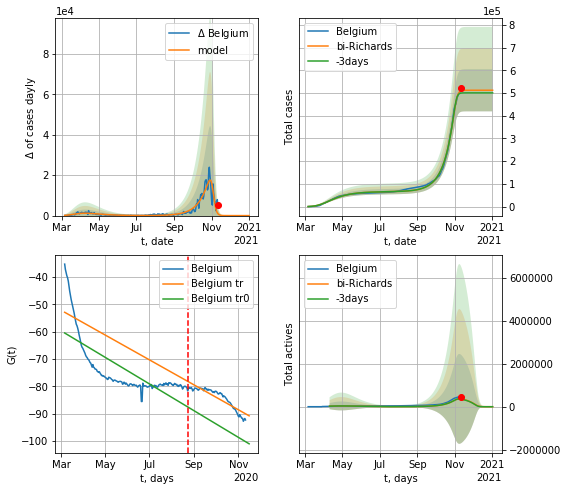

Belgium data at: 2020-11-12
+3 day model MAPE: 0.021460
model: bi-Richards
coeffs: [4.46339542e+05 6.15730487e-02 2.34439124e+02 6.66204858e+00]
rational stdev: 0.181350
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 512289 ± 92903
	 total death: 13674 ± 7439
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.552310
 intercept: -60.461181
 slope: -0.159282
trend coefficient of determination: 0.817768
 intercept: -52.867079
 slope: -0.148819


In [1240]:
iL = 5
vL = 170+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belgium',dfBG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1241]:
#x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1242]:
dfBZ.tail()

,date,cases,active,death
257,2020-11-08,5664115.0,437374,162397.0
258,2020-11-09,5675766.0,448784,162638.0
259,2020-11-10,5701283.0,474097,162842.0
260,2020-11-11,5749007.0,521257,163406.0
261,2020-11-12,5783647.0,362548,164332.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


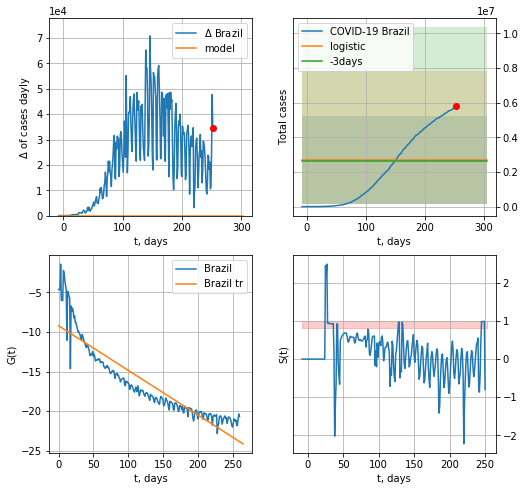

Brazil data at: 2020-11-12
+3 day model MAPE: 0.019707556838181824
model: logistic
coeffs:  [ 2.15273282e+06 -3.76355465e+01  8.96918407e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.9513361438257685
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  2690916 ± 2559965
	 total death:  76457 ± 218208
trend coefficient of determination: 0.830422
 intercept: -9.205776
 slope: -0.056329


In [1243]:
x = forecast('Brazil',dfBZ[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


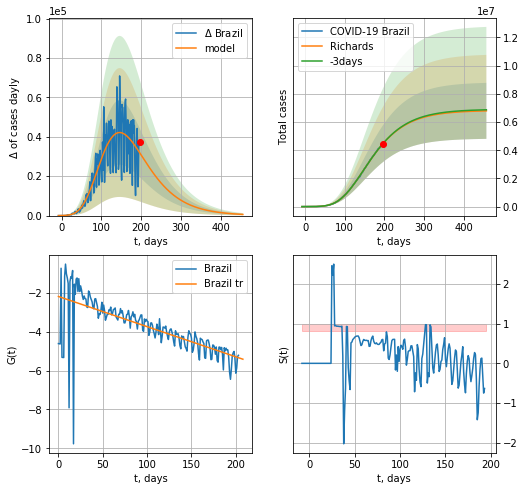

Brazil data at: 2020-11-12
+3 day model MAPE: 0.002583
model: Richards
coeffs: [ 6.82795585e+06  5.83841281e-01 -6.12360298e+01  2.91606457e-02]
rational stdev: 0.292338
forecast at the end of period: +261 days
	 deltaDaycases: 589
	 total cases: 6793556 ± 1986012
	 total death: 193026 ± 169286
trend coefficient of determination: 0.490475
 intercept: -2.194254
 slope: -0.015503


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


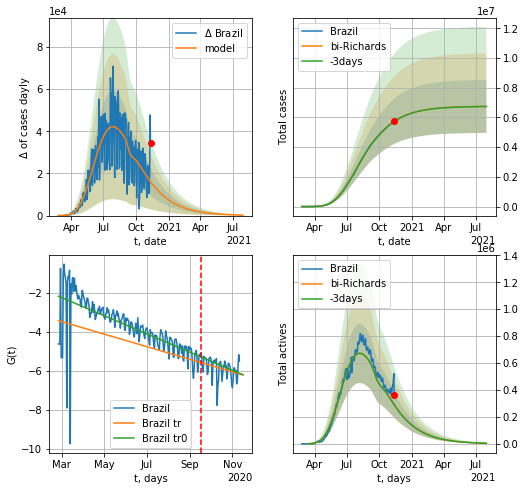

Brazil data at: 2020-11-12
+3 day model MAPE: 0.000633
model: bi-Richards
coeffs: [-7.37373896e+04  4.95498754e+00  1.65969708e+02  2.45201369e-02]
rational stdev: 0.264587
forecast at the end of period: +261 days
	 deltaDaycases: 223
	 total cases: 6741162 ± 1783622
	 total death: 191538 ± 152035
bi-Richards approximation splitting point: 205
trend coefficient of determination: 0.483769
 intercept: -2.166947
 slope: -0.015226
trend coefficient of determination: 0.105271
 intercept: -3.423607
 slope: -0.010504


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [1438]:
vL = 205
x = forecastRR('Brazil',dfBZ[:vL],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Brazil',dfBZ[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

In [1245]:
#x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1246]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
267 2020-11-08  27668.0    1307  907.0
268 2020-11-09  27674.0    1313  907.0
269 2020-11-10  27686.0    1320  907.0
270 2020-11-11  27699.0    1328  907.0
271 2020-11-12  27702.0    1327  907.0


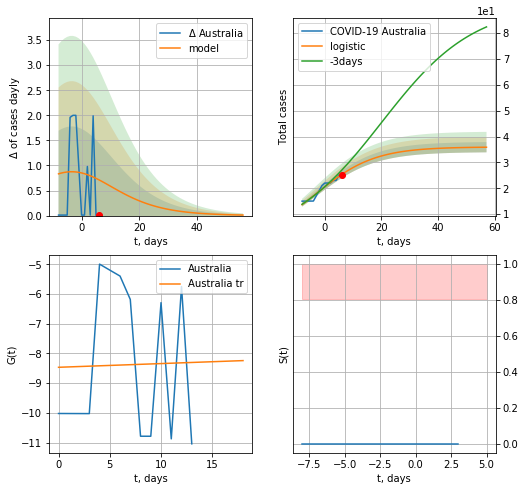

Australia data at: 2020-11-12
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  35 ± 1
	 total death:  1 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


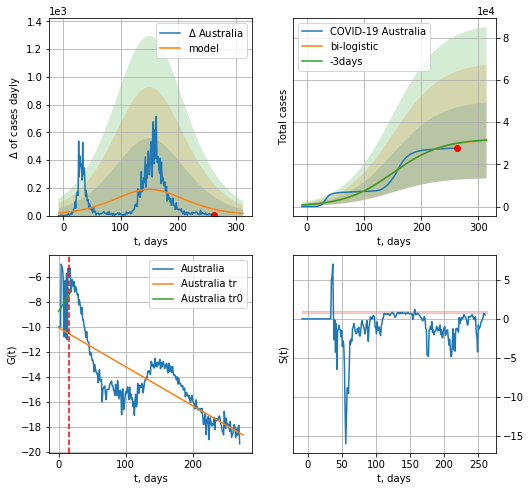

Australia data at: 2020-11-12
+3 day model MAPE: 0.00662136408104684
model: bi-logistic
coeffs:  [3.19015458e+04 2.36857853e-02 1.50600360e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5727830363782065
forecast at the end of period: +51 days
	 deltaDaycases:  15
	 total cases:  31285 ± 17920
	 total death:  1024 ± 1759
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.605655
 intercept: -10.076380
 slope: -0.031188


In [1247]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


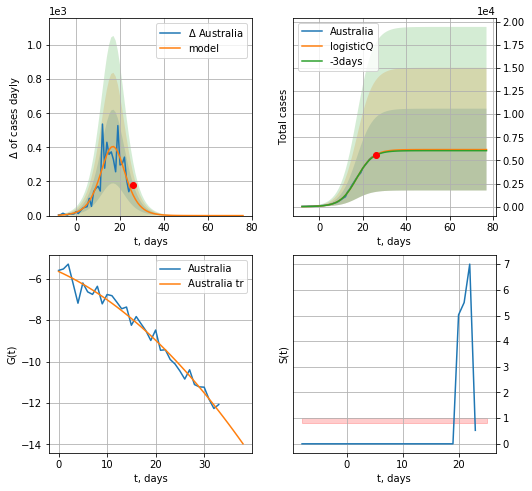

Australia data at: 2020-11-12
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 6168 ± 4420
	 total death: 201 ± 432
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


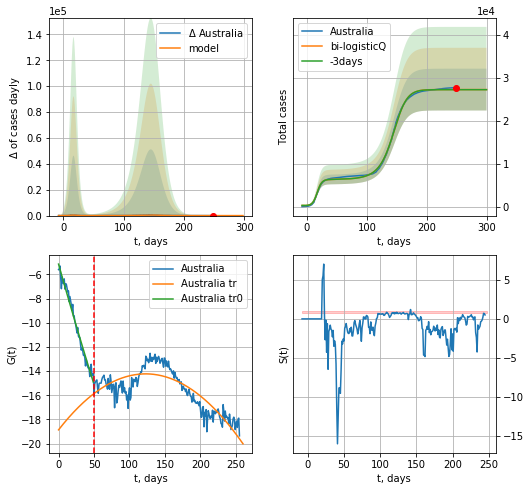

Australia data at: 2020-11-12
+3 day model MAPE: 0.000788
model: bi-logisticQ
coeffs: [ 2.10718059e+04  3.68268275e-04  1.43099826e+02 -8.44672036e+01]
rational stdev: 0.178341
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 27240 ± 4858
	 total death: 891 ± 476
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.711877
 intercept_: -18.86632144727321
 coeffs_: [ 0.          0.07548277 -0.00030739]


In [1248]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


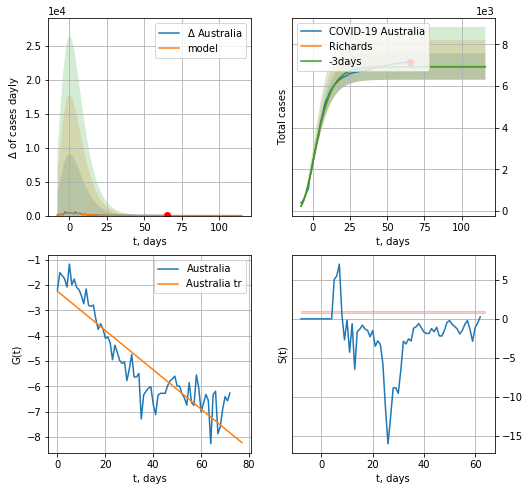

Australia data at: 2020-11-12
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 227 ± 62
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


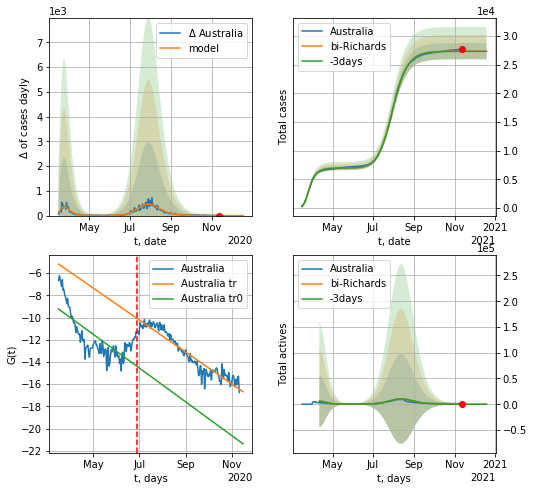

Australia data at: 2020-11-12
+3 day model MAPE: 0.000771
model: bi-Richards
coeffs: [2.04308933e+04 1.10495495e-01 1.23769549e+02 7.44889234e-01]
rational stdev: 0.051691
forecast at the end of period: +37 days
	 deltaDaycases: 0
	 total cases: 27364 ± 1414
	 total death: 895 ± 138
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544306
 intercept: -9.227199
 slope: -0.049579
trend coefficient of determination: 0.904216
 intercept: -5.186829
 slope: -0.046916


In [1439]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Australia',dfAS[iL:],d1,38*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

ML
           date    cases  active  death
255 2020-11-08  40209.0   11689  286.0
256 2020-11-09  41181.0   11308  294.0
257 2020-11-10  42050.0   11446  300.0
258 2020-11-11  42872.0   11497  302.0
259 2020-11-12  43791.0   11419  303.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


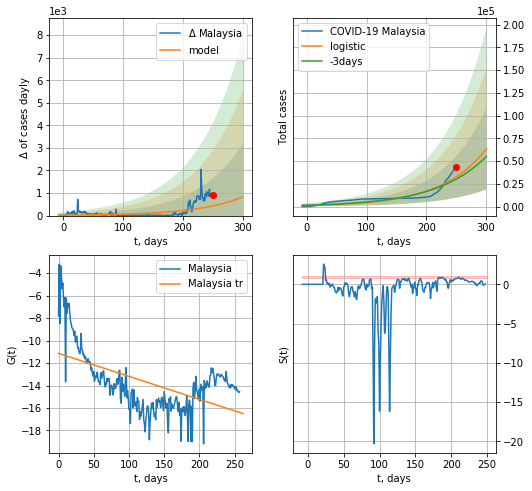

Malaysia data at: 2020-11-12
+3 day model MAPE: 0.0834666672417267
model: logistic
coeffs:  [3.28601077e+08 1.31403502e-02 9.51600904e+02]
rational stdev:  0.7006818318574065
forecast at the end of period: +51 days
	 deltaDaycases:  830
	 total cases:  63642 ± 44593
	 total death:  440 ± 924
trend coefficient of determination: 0.302286
 intercept: -11.139833
 slope: -0.020450


In [1250]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


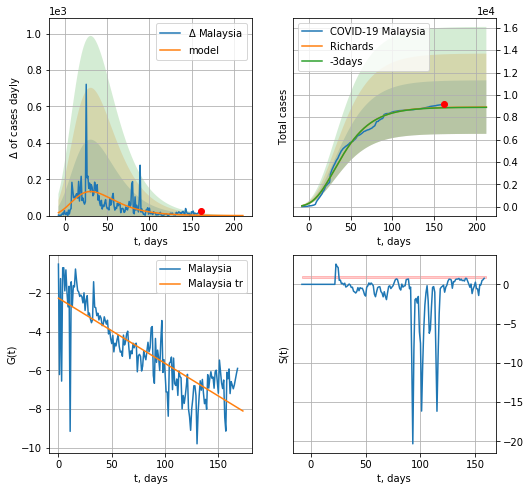

Malaysia data at: 2020-11-12
+3 day model MAPE: 0.002240
model: Richards
coeffs: [ 8.90988900e+03  9.44653085e+00 -1.04060324e+02  4.28353192e-03]
rational stdev: 0.268624
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 8904 ± 2391
	 total death: 61 ± 49
trend coefficient of determination: 0.661509
 intercept: -2.276525
 slope: -0.033689


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


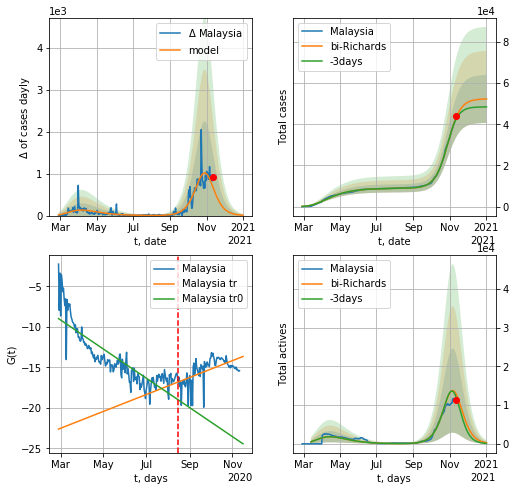

Malaysia data at: 2020-11-12
+3 day model MAPE: 0.021923
model: bi-Richards
coeffs: [4.34762349e+04 8.87925913e-02 2.38002292e+02 1.08043717e+00]
rational stdev: 0.223089
forecast at the end of period: +51 days
	 deltaDaycases: 8
	 total cases: 52299 ± 11667
	 total death: 361 ± 241
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.726752
 intercept: -8.980887
 slope: -0.058786
trend coefficient of determination: 0.340323
 intercept: -22.619445
 slope: 0.034080


In [1442]:
vL = 170
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Malaysia',dfML[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.45)

In [1252]:
#x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
254 2020-11-08  1986.0      51   25.0
255 2020-11-09  1987.0      52   25.0
256 2020-11-10  1988.0      52   25.0
257 2020-11-11  1991.0      53   25.0
258 2020-11-12  1995.0      53   25.0


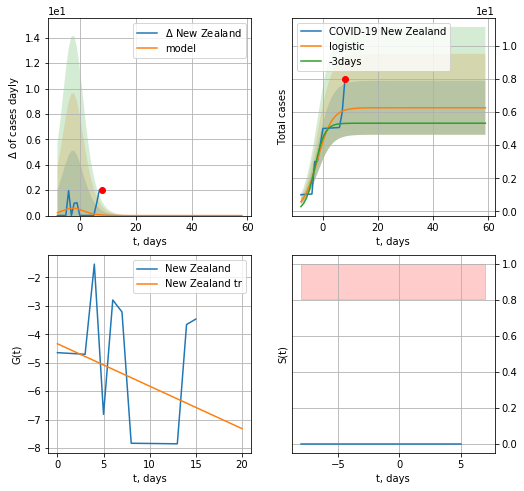

New Zealand data at: 2020-11-12
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


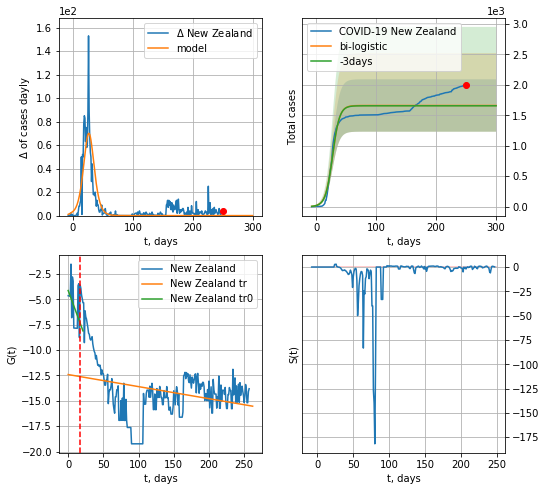

New Zealand data at: 2020-11-12
+3 day model MAPE: 0.0031450926048974767
model: bi-logistic
coeffs:  [1.65414646e+03 1.69605980e-01 2.70187879e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.25885818395837784
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1660 ± 429
	 total death:  20 ± 15
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.084499
 intercept: -12.413278
 slope: -0.011893


In [1253]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

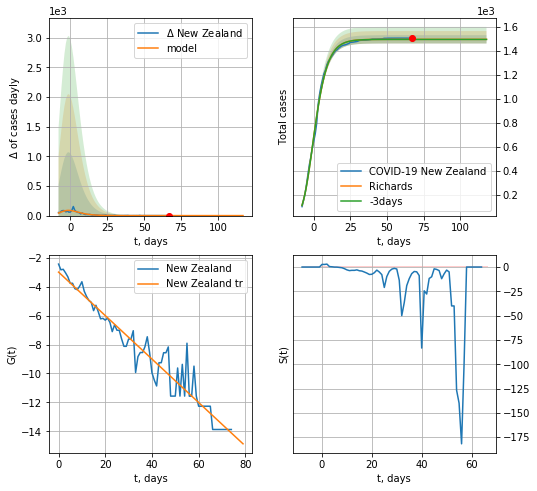

New Zealand data at: 2020-11-12
+3 day model MAPE: 0.000505
model: Richards
coeffs: [ 1.49487953e+03  6.79159620e-01 -8.03485752e+00  2.67314239e-01]
rational stdev: 0.023076
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1494 ± 34
	 total death: 18 ± 1
trend coefficient of determination: 0.938641
 intercept: -2.993592
 slope: -0.150300


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


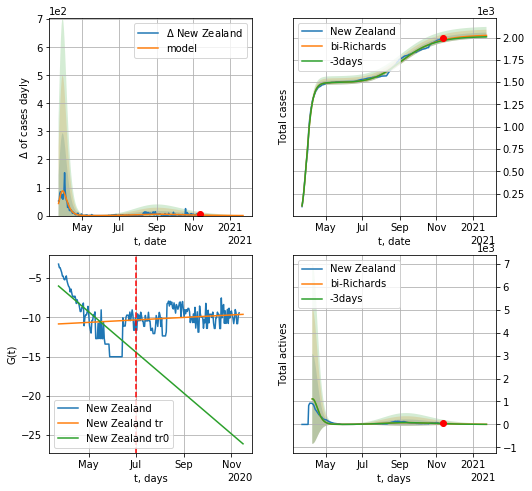

New Zealand data at: 2020-11-12
+3 day model MAPE: 0.003329
model: bi-Richards
coeffs: [5.35774965e+02 7.19405489e-02 1.27079979e+02 4.23108564e-01]
rational stdev: 0.015753
forecast at the end of period: +72 days
	 deltaDaycases: 0
	 total cases: 2023 ± 31
	 total death: 25 ± 1
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.545370
 intercept: -6.016450
 slope: -0.084388
trend coefficient of determination: 0.028648
 intercept: -10.841046
 slope: 0.005126


In [1444]:
iL = 24
vL = 100+iL
x = forecastRR('New Zealand',dfZL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('New Zealand',dfZL[iL:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [1255]:
#x = forecastRRR('New Zealand',dfZL[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1256]:
dfBR = read_df(pd.DataFrame(),"BR")
#x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
#xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date     cases  active   death
254 2020-11-08  106279.0   14274  1007.0
255 2020-11-09  107262.0   14898  1011.0
256 2020-11-10  108300.0   15638  1016.0
257 2020-11-11  109357.0   16069  1022.0
258 2020-11-12  110455.0   16585  1027.0


BR
           date     cases  active   death
254 2020-11-08  106279.0   14274  1007.0
255 2020-11-09  107262.0   14898  1011.0
256 2020-11-10  108300.0   15638  1016.0
257 2020-11-11  109357.0   16069  1022.0
258 2020-11-12  110455.0   16585  1027.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


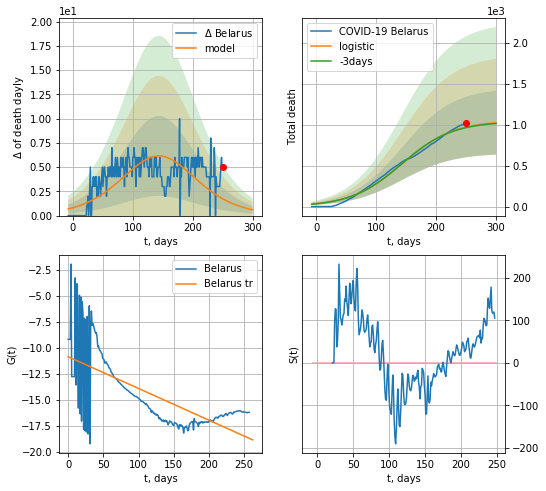

Belarus data at: 2020-11-12
+3 day model MAPE: 0.007269371253169146
model: logistic
coeffs:  [1.05306482e+03 2.33645043e-02 1.43726360e+02]
rational stdev:  0.3802744677265821
forecast at the end of period: +51 days
	 total death:  1027 ± 390
trend coefficient of determination: 0.475241
 intercept: -10.883329
 slope: -0.030523


In [1257]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


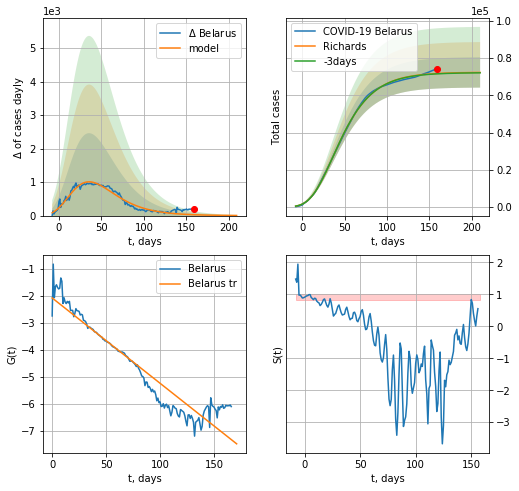

Belarus data at: 2020-11-12
+3 day model MAPE: 0.002728
model: Richards
coeffs: [ 7.24389440e+04  3.51273037e+00 -8.31196937e+01  1.08274995e-02]
rational stdev: 0.112826
forecast at the end of period: +51 days
	 deltaDaycases: 3
	 total cases: 72342 ± 8162
	 total death: 672 ± 227
trend coefficient of determination: 0.901412
 intercept: -2.084164
 slope: -0.031594


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


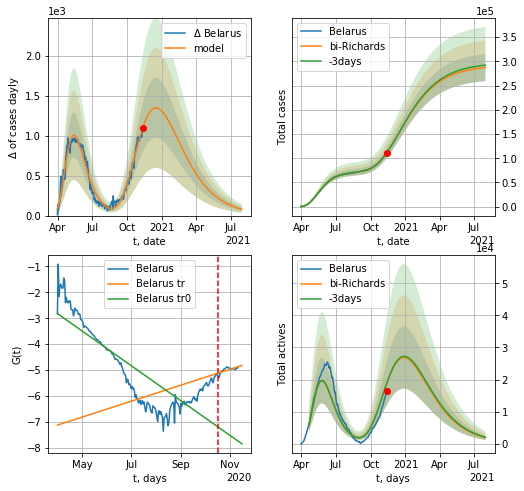

Belarus data at: 2020-11-12
+3 day model MAPE: 0.000440
model: bi-Richards
coeffs: [2.19475018e+05 6.70782439e-01 3.49511488e+01 2.52284450e-02]
rational stdev: 0.097341
forecast at the end of period: +261 days
	 deltaDaycases: 79
	 total cases: 287224 ± 27958
	 total death: 2670 ± 779
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.690530
 intercept: -2.819092
 slope: -0.021836
trend coefficient of determination: 0.479647
 intercept: -7.120244
 slope: 0.010006


In [1447]:
iL=32
vL = 200+iL#145+iL
x = forecastRR('Belarus',dfBR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Belarus',dfBR[iL:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.625)
#x = forecastRRR('Belarus',dfBR[iL:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


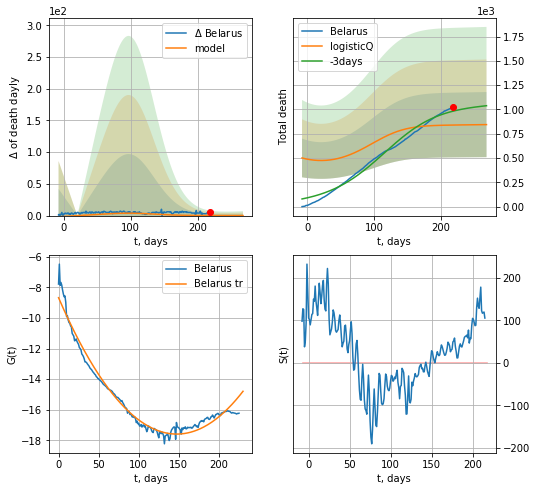

Belarus data at: 2020-11-12
+3 day model MAPE: 0.145620
model: logisticQ
coeffs: [7.11746860e+02 1.78636005e-04 3.61066771e+01 3.42079916e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.396649
forecast at the end of period: +51 days
	 total death: 844 ± 334
trend coefficient of determination: 0.970312
 intercept_: -8.679936288034426
 coeffs_: [ 0.         -0.12085311  0.00040991]


In [1259]:
x = forecastRRR('Belarus',dfBR[32:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

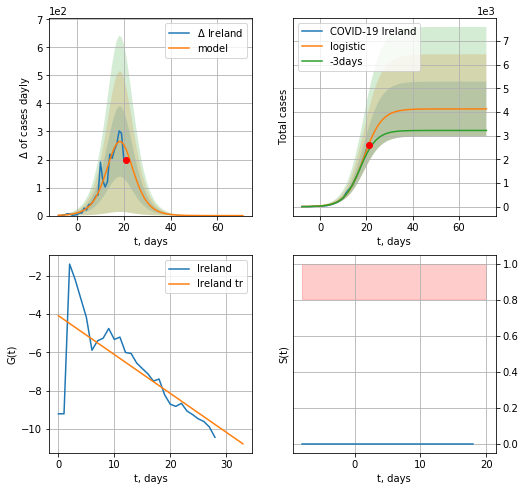

Ireland data at: 2020-11-12
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  4127 ± 1154
	 total death:  121 ± 101
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


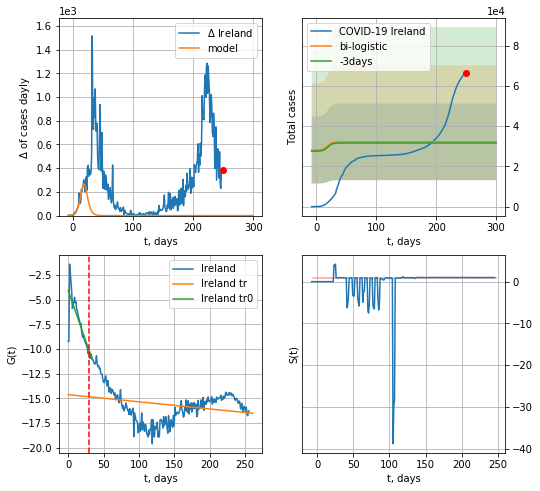

Ireland data at: 2020-11-12
+3 day model MAPE: 0.01842521556097352
model: bi-logistic
coeffs:  [ 2.24804492e+04 -1.65539193e+01  4.06699826e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5910377959111589
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  32227 ± 19047
	 total death:  950 ± 1684
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.066146
 intercept: -14.614824
 slope: -0.007227


In [1260]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


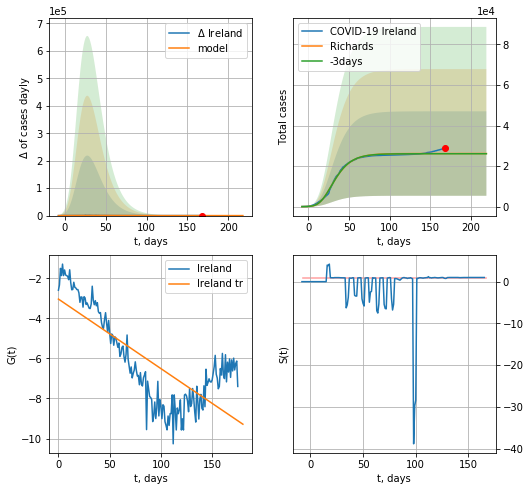

Ireland data at: 2020-11-12
+3 day model MAPE: 0.004030
model: Richards
coeffs: [ 2.61775984e+04  9.17020717e-01 -6.58016651e+00  8.00580200e-02]
rational stdev: 0.795180
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 26177 ± 20815
	 total death: 771 ± 1839
trend coefficient of determination: 0.587901
 intercept: -3.038276
 slope: -0.034699


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


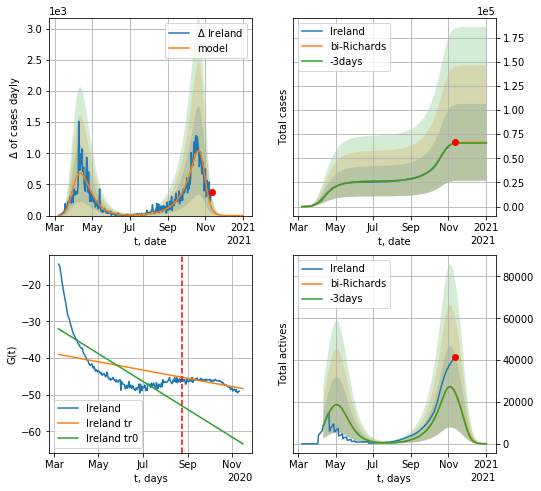

Ireland data at: 2020-11-12
+3 day model MAPE: 0.008866
model: bi-Richards
coeffs: [4.03778248e+04 4.86288539e-02 2.27603457e+02 3.95101986e+00]
rational stdev: 0.598170
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 66555 ± 39811
	 total death: 1962 ± 3520
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.583944
 intercept: -32.009228
 slope: -0.123499
trend coefficient of determination: 0.594804
 intercept: -38.991054
 slope: -0.036747


In [1262]:
ivL = 7
vL = 170 +ivL
x = forecastRR('Ireland',dfIR[ivL:vL+ivL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Ireland',dfIR[ivL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
#x = forecastRRR('Ireland',dfIR[3:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active    death
250 2020-11-08  521558    9604  14543.0
251 2020-11-09  522879    9387  14588.0
252 2020-11-10  523907    9154  14611.0
253 2020-11-11  524804    8745  14633.0
254 2020-11-12  526438    9264  14699.0


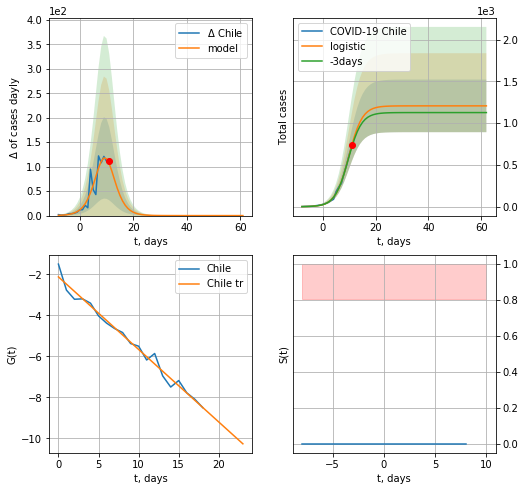

Chile data at: 2020-11-12
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  33 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


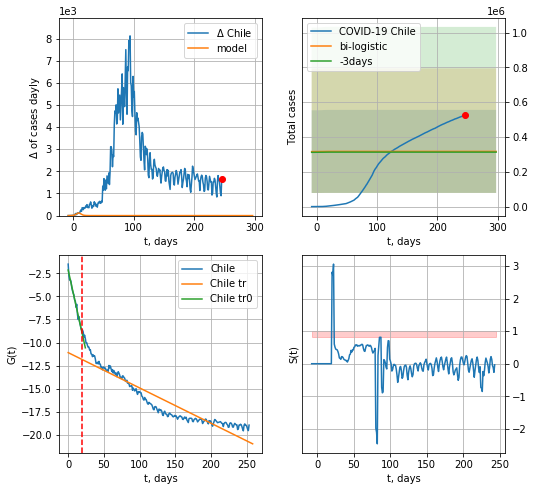

Chile data at: 2020-11-12
+3 day model MAPE: 0.012894568768218689
model: bi-logistic
coeffs:  [ 2.52643464e+05 -4.90623896e+01  1.17081843e+03] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7519812215229064
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  317011 ± 238387
	 total death:  8851 ± 19967
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.871113
 intercept: -11.094284
 slope: -0.038303


In [1263]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


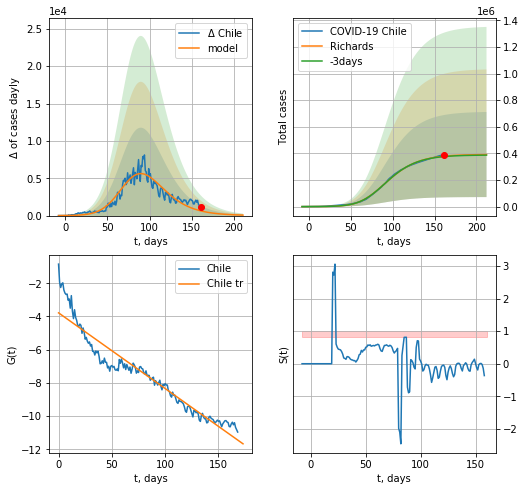

Chile data at: 2020-11-12
+3 day model MAPE: 0.007583
model: Richards
coeffs: [3.92652491e+05 1.16049666e-01 7.04582771e+01 4.00939983e-01]
rational stdev: 0.816952
forecast at the end of period: +51 days
	 deltaDaycases: 64
	 total cases: 391304 ± 319677
	 total death: 10925 ± 26775
trend coefficient of determination: 0.916357
 intercept: -3.781163
 slope: -0.045598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:339: RuntimeWarning: overflow encountered in power


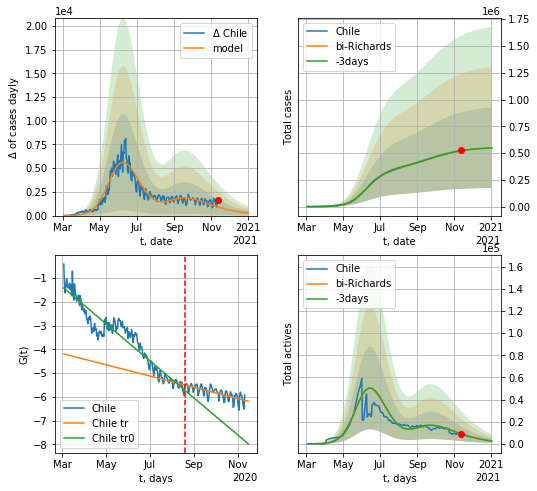

Chile data at: 2020-11-12
+3 day model MAPE: 0.002067
model: bi-Richards
coeffs: [1.66972820e+05 2.61745436e+00 3.49683235e+01 1.07365313e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.683716
forecast at the end of period: +51 days
	 deltaDaycases: 265
	 total cases: 550030 ± 376064
	 total death: 15357 ± 31499
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.913126
 intercept: -1.426560
 slope: -0.025375
trend coefficient of determination: 0.498763
 intercept: -4.194255
 slope: -0.007712


In [1449]:
vL = 170
x = forecastRR('Chile',dfCL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Chile',dfCL[:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL,amc=0.3)
#x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

In [1265]:
#x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

CH
           date     cases  active   death
252 2020-11-08  414828.0  166841  4858.0
253 2020-11-09  417181.0  168148  5028.0
254 2020-11-10  429880.0  147084  5323.0
255 2020-11-11  438805.0  147994  5570.0
256 2020-11-12  446675.0  140201  5755.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


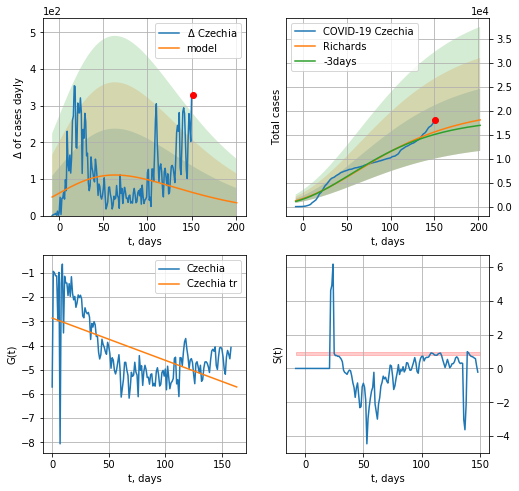

Czechia data at: 2020-11-12
+3 day model MAPE: 0.036194
model: Richards
coeffs: [ 2.05903469e+04  1.92716393e+00 -2.68842410e+02  7.61388243e-03]
rational stdev: 0.357386
forecast at the end of period: +51 days
	 deltaDaycases: 34
	 total cases: 18059 ± 6454
	 total death: 232 ± 248
trend coefficient of determination: 0.344405
 intercept: -2.865835
 slope: -0.017469


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


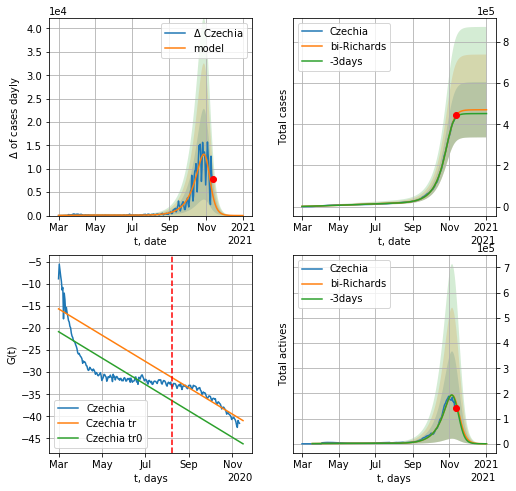

Czechia data at: 2020-11-12
+3 day model MAPE: 0.021115
model: bi-Richards
coeffs: [4.50594774e+05 6.27356817e-02 2.39351561e+02 2.88396272e+00]
rational stdev: 0.285136
forecast at the end of period: +51 days
	 deltaDaycases: 9
	 total cases: 470541 ± 134168
	 total death: 6062 ± 5185
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.565668
 intercept: -20.845065
 slope: -0.097561
trend coefficient of determination: 0.899442
 intercept: -15.683428
 slope: -0.097215


In [1450]:
vL= 160
dfCH = read_df(pd.DataFrame(),"CH")
x = forecastRR('Czechia',dfCH[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Czechia',dfCH[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Czechia',dfCH[:],d1,60*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1516]:
dfMX = read_df(pd.DataFrame(),"MX")
#x = forecast('Mexico',dfMX[:],d1,T18*7-dT,addpred=True,xcoef=[.25,1.,2.])#

MX
           date   cases  active    death
245 2020-11-08  967825  156821  95027.0
246 2020-11-09  972785  156484  95225.0
247 2020-11-10  978531  156843  95842.0
248 2020-11-11  986177  158279  96430.0
249 2020-11-12  991835  158582  97056.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


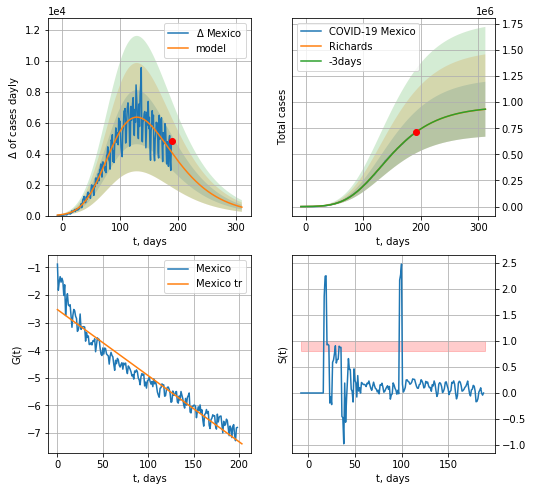

Mexico data at: 2020-11-12
+3 day model MAPE: 0.000227
model: Richards
coeffs: [9.60430195e+05 1.43865442e-01 2.46288519e+01 1.33315498e-01]
rational stdev: 0.281932
forecast at the end of period: +121 days
	 deltaDaycases: 544
	 total cases: 931822 ± 262710
	 total death: 91183 ± 77122
trend coefficient of determination: 0.932535
 intercept: -2.525774
 slope: -0.023953
diffStd0a 0.537977728279814


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


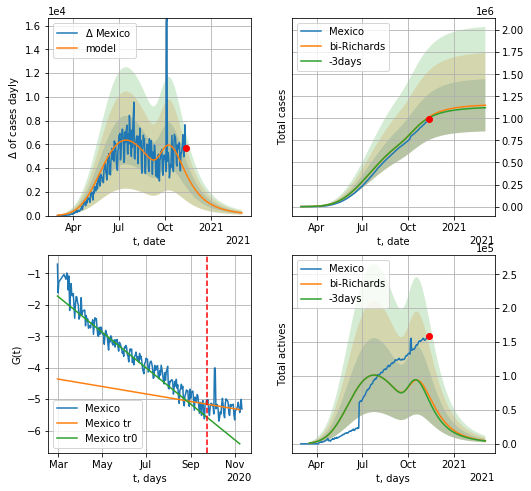

Mexico data at: 2020-11-12
+3 day model MAPE: 0.006094
model: bi-Richards
coeffs: [1.99398483e+05 4.12615356e+00 1.17697738e+02 1.06155391e-02]
rational stdev: 0.257741
forecast at the end of period: +121 days
	 deltaDaycases: 232
	 total cases: 1148324 ± 295970
	 total death: 112369 ± 86886
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.946120
 intercept: -1.721290
 slope: -0.018561
trend coefficient of determination: 0.031308
 intercept: -4.357289
 slope: -0.003856


In [1520]:
vL = 200#60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Mexico',dfMX[:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
#x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date    cases  active  death      tests
244 2020-11-08  25755.0   19629  210.0  1106660.0
245 2020-11-09  26841.0   20658  221.0  1119422.0
246 2020-11-10  28262.0   21419  235.0  1132514.0
247 2020-11-11  29812.0   22382  244.0  1146969.0
248 2020-11-12  31878.0   24284  253.0        0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


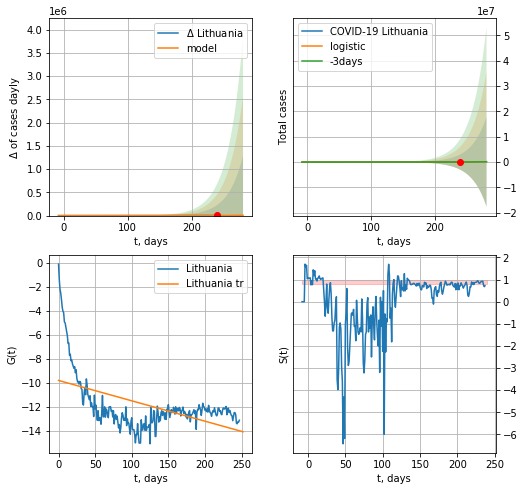

Lithuania data at: 2020-11-12
+3 day model MAPE: 0.12941527269626196
model: logistic
coeffs:  [1.93718062e+08 4.29077770e-02 4.45885518e+02]
rational stdev:  108.14409873717987
forecast at the end of period: +41 days
	 deltaDaycases:  6872
	 total cases:  163766 ± 17710392
	 total death:  1340 ± 434739
trend coefficient of determination: 0.263068
 intercept: -9.793723
 slope: -0.016968


In [1455]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [1456]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [1457]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: invalid value encountered in true_divide


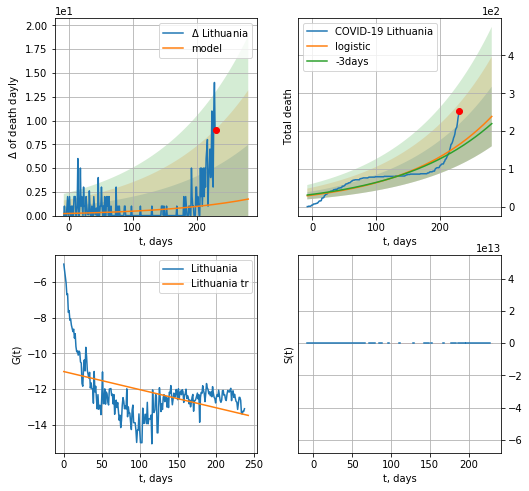

Lithuania data at: 2020-11-12
+3 day model MAPE: 0.058764535474189195
model: logistic
coeffs:  [3.35202252e+05 7.31015049e-03 1.27329294e+03]
rational stdev:  0.3308090784027155
forecast at the end of period: +51 days
	 total death:  238 ± 78
trend coefficient of determination: 0.188200
 intercept: -11.024834
 slope: -0.010109


In [1458]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


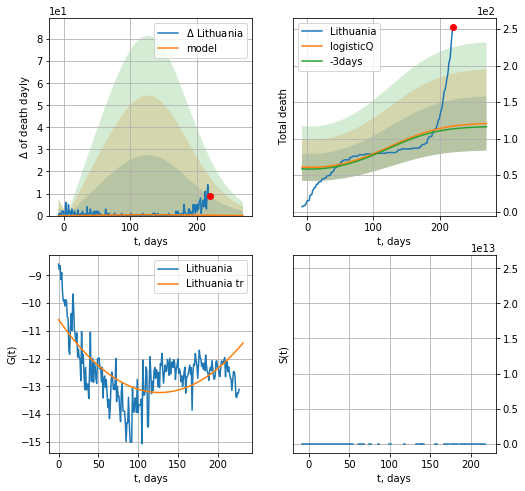

Lithuania data at: 2020-11-12
+3 day model MAPE: 0.033254
model: logisticQ
coeffs: [1.21586915e+02 7.11191269e-05 9.94347815e+00 1.06494410e+00]
rational stdev: 0.306922
forecast at the end of period: +51 days
	 total death: 120 ± 37
trend coefficient of determination: 0.407387
 intercept_: -10.589715182127865
 coeffs_: [ 0.         -0.04139146  0.0001627 ]


In [1459]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
#x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


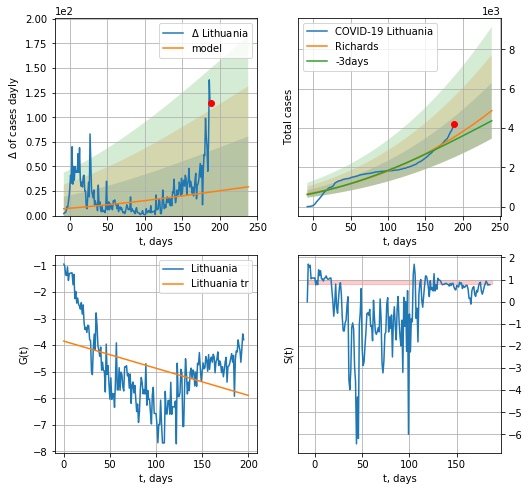

Lithuania data at: 2020-11-12
+3 day model MAPE: 0.047775
model: Richards
coeffs: [ 5.54183199e+04  1.08265666e-01 -8.74523027e+02  2.35063639e-02]
rational stdev: 0.291066
forecast at the end of period: +51 days
	 deltaDaycases: 29
	 total cases: 4878 ± 1419
	 total death: 39 ± 34
trend coefficient of determination: 0.159230
 intercept: -3.851608
 slope: -0.010200


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


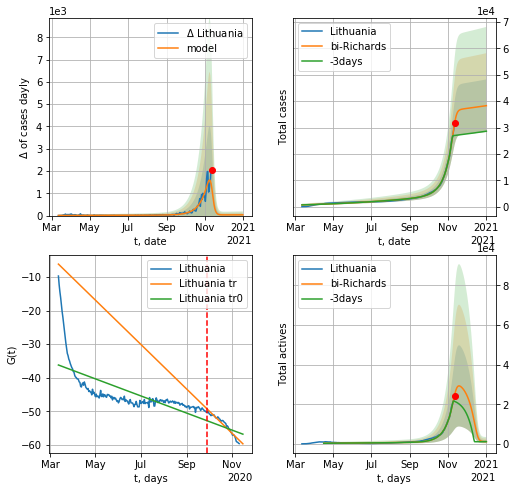

Lithuania data at: 2020-11-12
+3 day model MAPE: 0.217145
model: bi-Richards
coeffs: [3.18444130e+04 8.20669016e-02 2.38024905e+02 5.47883808e+00]
rational stdev: 0.260144
forecast at the end of period: +51 days
	 deltaDaycases: 34
	 total cases: 38284 ± 9959
	 total death: 313 ± 244
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.478373
 intercept: -36.182559
 slope: -0.082557
trend coefficient of determination: 0.940024
 intercept: -6.194736
 slope: -0.214512


In [1460]:
iL = 3
vL =200+iL#170+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

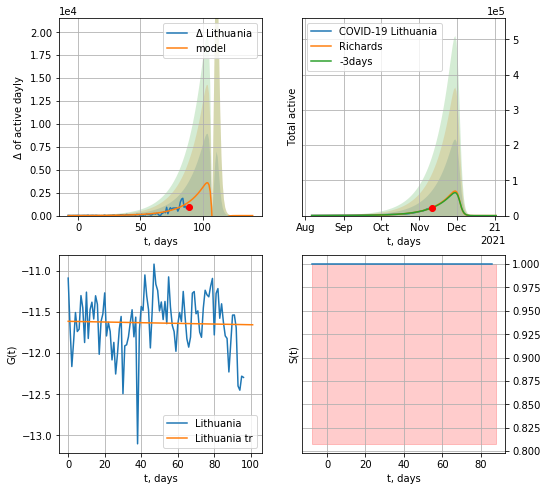

Lithuania data at: 2020-11-11
+3 day model MAPE: 0.029770
model: Richards
coeffs: [4.96207198e+03 7.63470130e-01 1.11305218e+02 9.06295319e-01]
rational stdev: 2.101341
forecast at the end of period: +52 days
	 total active: 0 ± 0
trend coefficient of determination: 0.001063
 intercept: -11.612319
 slope: -0.000415


In [963]:
iL = 150
vL =120+iL
RAkoreaCoeffs = [5.86900283e+04, 2.15711530e+01, -9.80541238e+01,  2.21893275e-03]
x, t, tt, allmodel = forecastRRA('Lithuania',dfLT[iL:],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='active')#
#xx = forecast2RRA('Lithuania',dfLT[iL:],d1,90*7-dT,x,addpred=False,xcoef=RAkoreaCoeffs,vL=vL-iL,cases='active')#

In [964]:
import datetime
a=zip(tt, allmodel)
print (t)
i = -1
stdevc = 0.867612
for a1,a2 in a:
    i = i + 1
    #print (i)
    if i<t+8: continue
    start_date = "11/4/20"
    date_1 = datetime.datetime.strptime(start_date, "%m/%d/%y")
    end_date = date_1 + datetime.timedelta(days=int(a1)-82-8)
    print('active',(end_date.strftime("%Y/%m/%d)"),int(a2),'±',int(a2*stdevc)))
    print('5%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.05),'±',int(0.05*a2*stdevc)))
    print('8%',(end_date.strftime("%Y/%m/%d)"),int(a2*0.08),'±',int(0.08*a2*stdevc)))
#dfLT['date'][tt]

89
active ('2020/11/11)', 22420, '±', 19452)
5% ('2020/11/11)', 1121, '±', 972)
8% ('2020/11/11)', 1793, '±', 1556)
active ('2020/11/12)', 23927, '±', 20759)
5% ('2020/11/12)', 1196, '±', 1037)
8% ('2020/11/12)', 1914, '±', 1660)
active ('2020/11/13)', 25535, '±', 22155)
5% ('2020/11/13)', 1276, '±', 1107)
8% ('2020/11/13)', 2042, '±', 1772)
active ('2020/11/14)', 27253, '±', 23645)
5% ('2020/11/14)', 1362, '±', 1182)
8% ('2020/11/14)', 2180, '±', 1891)
active ('2020/11/15)', 29088, '±', 25237)
5% ('2020/11/15)', 1454, '±', 1261)
8% ('2020/11/15)', 2327, '±', 2018)
active ('2020/11/16)', 31047, '±', 26937)
5% ('2020/11/16)', 1552, '±', 1346)
8% ('2020/11/16)', 2483, '±', 2154)
active ('2020/11/17)', 33140, '±', 28752)
5% ('2020/11/17)', 1657, '±', 1437)
8% ('2020/11/17)', 2651, '±', 2300)
active ('2020/11/18)', 35374, '±', 30691)
5% ('2020/11/18)', 1768, '±', 1534)
8% ('2020/11/18)', 2829, '±', 2455)
active ('2020/11/19)', 37761, '±', 32761)
5% ('2020/11/19)', 1888, '±', 1638)
8% ('202

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


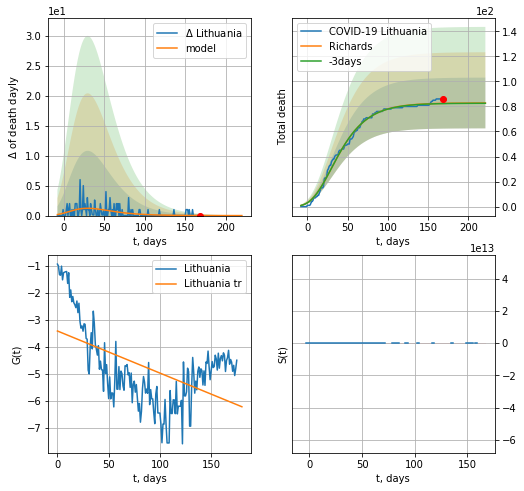

Lithuania data at: 2020-11-10
+3 day model MAPE: 0.002495
model: Richards
coeffs: [ 8.28105392e+01  6.19948354e+00 -9.53688137e+01  6.48963991e-03]
rational stdev: 0.244736
forecast at the end of period: +53 days
	 total death: 82 ± 20
trend coefficient of determination: 0.280445
 intercept: -3.404567
 slope: -0.015594


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:334: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:334: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: invalid value encountered in true_divide


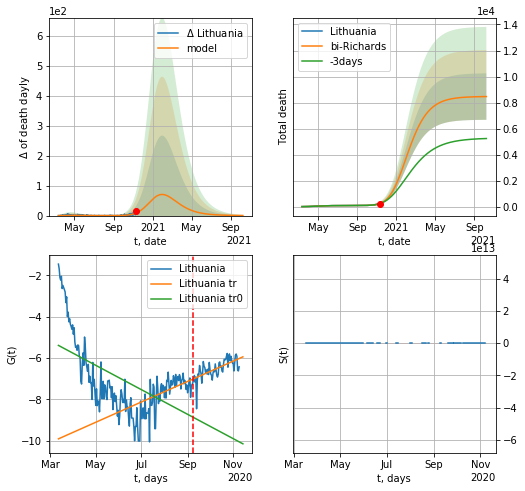

Lithuania data at: 2020-11-10
+3 day model MAPE: 0.019017
model: bi-Richards
coeffs: [8.38688900e+03 7.92704978e-02 2.74654433e+02 3.35533384e-01]
rational stdev: 0.211024
forecast at the end of period: +333 days
	 total death: 8459 ± 1785
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.326133
 intercept: -5.392244
 slope: -0.019293
trend coefficient of determination: 0.429137
 intercept: -9.917979
 slope: 0.016080


In [382]:
iL = 3
vL =180+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs,cases='death')#
xx = forecast2RRD('Lithuania',dfLT[iL:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,cases='death')#

In [383]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date    cases  active  death
246 2020-11-08  23051.0   10769  188.0
247 2020-11-09  23227.0    9121  193.0
248 2020-11-10  23710.0    9418  198.0
249 2020-11-11  24505.0   10205  206.0
250 2020-11-12  25218.0   10209  211.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


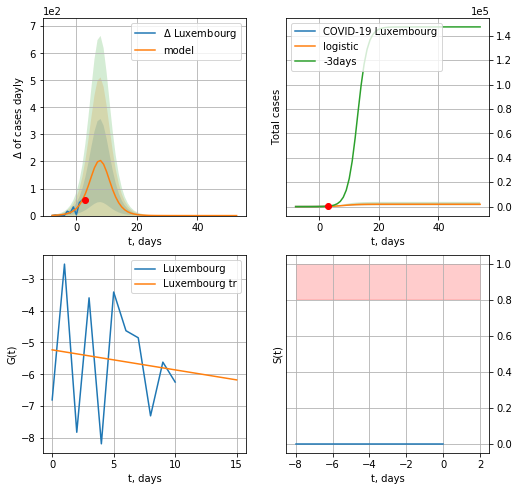

Luxembourg data at: 2020-11-12
model: logistic
coeffs:  [1.87757966e+03 4.36654344e-01 8.24919508e+00]
rational stdev:  0.35795936969501296
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1877 ± 672
	 total death:  15 ± 16
trend coefficient of determination: 0.012091
 intercept: -5.231862
 slope: -0.063083


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


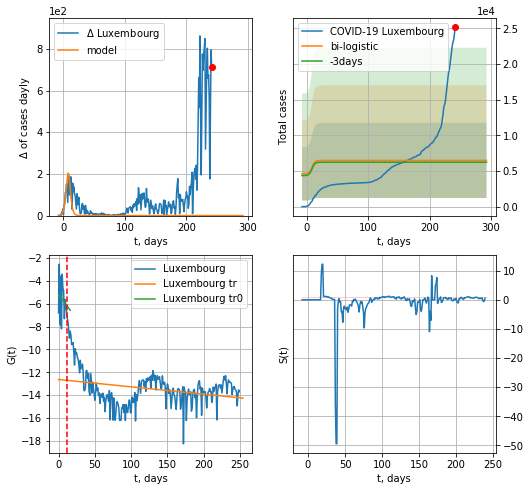

Luxembourg data at: 2020-11-12
+3 day model MAPE: 0.040429100525226164
model: bi-logistic
coeffs:  [4092.55308605  -23.64705055  591.25188868] [1.87757966e+03 4.36654344e-01 8.24919508e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.8131094857168405
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  6481 ± 5270
	 total death:  54 ± 131
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.030158
 intercept: -5.146907
 slope: -0.088569
trend coefficient of determination: 0.082183
 intercept: -12.626352
 slope: -0.006424


In [1270]:
try:
    dfLX = read_df(pd.DataFrame(),"LX")
    x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


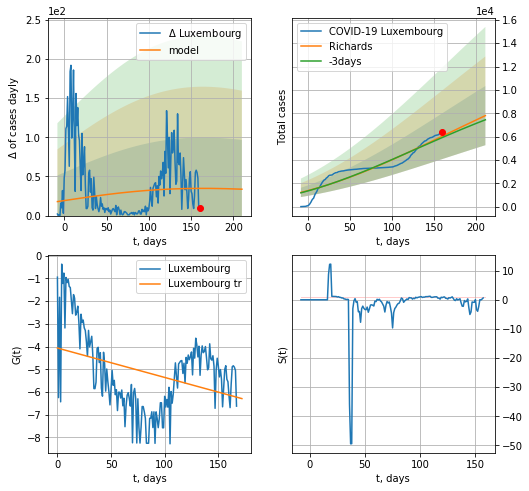

Luxembourg data at: 2020-11-12
+3 day model MAPE: 0.019794
model: Richards
coeffs: [ 1.66800613e+04  3.06060203e-01 -5.31170358e+02  1.86938235e-02]
rational stdev: 0.324841
forecast at the end of period: +51 days
	 deltaDaycases: 33
	 total cases: 7797 ± 2532
	 total death: 65 ± 63
trend coefficient of determination: 0.129435
 intercept: -4.066706
 slope: -0.012924


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


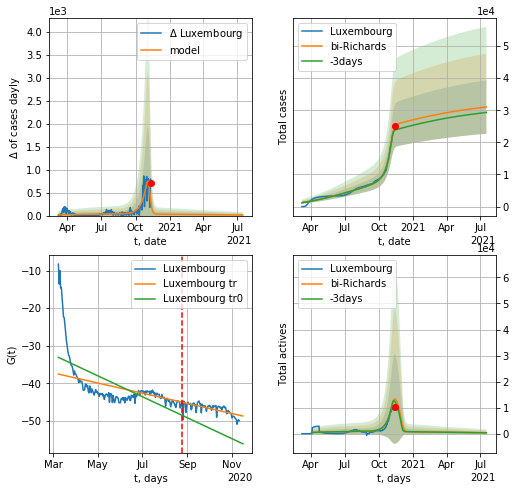

Luxembourg data at: 2020-11-12
+3 day model MAPE: 0.049899
model: bi-Richards
coeffs: [1.67285819e+04 7.60363967e-02 2.36874650e+02 4.57180164e+00]
rational stdev: 0.268339
forecast at the end of period: +247 days
	 deltaDaycases: 12
	 total cases: 30988 ± 8315
	 total death: 259 ± 208
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.415951
 intercept: -33.063308
 slope: -0.090823
trend coefficient of determination: 0.471060
 intercept: -37.505072
 slope: -0.044069


In [1461]:
iL=1
vL = 170+iL#105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Luxembourg",dfLX[iL:],d1,68*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.75)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


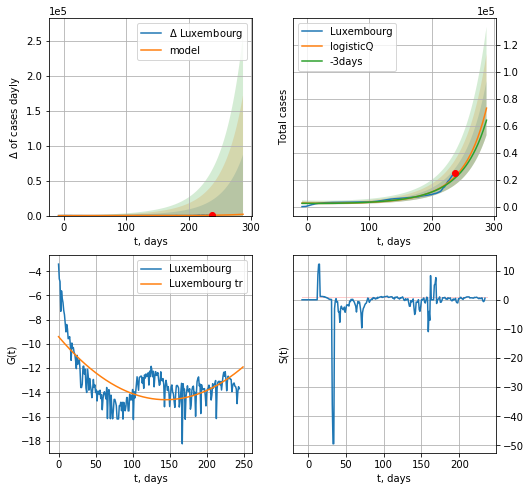

Luxembourg data at: 2020-11-12
+3 day model MAPE: 0.051453
model: logisticQ
coeffs: [ 7.01241787e+07  4.96857089e-05  4.80745452e+02 -4.28905132e+02]
rational stdev: 0.274882
forecast at the end of period: +51 days
	 deltaDaycases: 1872
	 total cases: 73068 ± 20085
	 total death: 611 ± 503
trend coefficient of determination: 0.457944
 intercept_: -9.402099337783822
 coeffs_: [ 0.         -0.07197114  0.00024866]


In [1272]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

In [1273]:
dfED = read_df(pd.DataFrame(),"ED")
#x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

ED
           date     cases  active    death
253 2020-11-08  174907.0  7121.0  12830.0
254 2020-11-09  175269.0  7474.0  12839.0
255 2020-11-10  175711.0  7906.0  12849.0
256 2020-11-11  176630.0  8754.0  12920.0
257 2020-11-12  177513.0  9611.0  12946.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


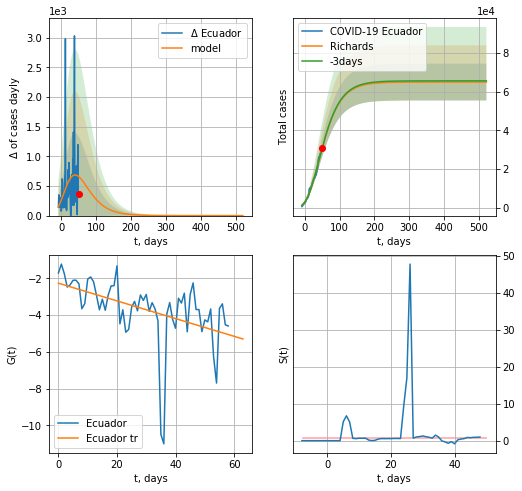

Ecuador data at: 2020-11-12
+3 day model MAPE: 0.001443
model: Richards
coeffs: [ 6.49031363e+04  1.85787235e+00 -1.03613231e+02  1.55703468e-02]
rational stdev: 0.146273
forecast at the end of period: +471 days
	 deltaDaycases: 0
	 total cases: 64903 ± 9493
	 total death: 4733 ± 2076
trend coefficient of determination: 0.218364
 intercept: -2.268609
 slope: -0.048096


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


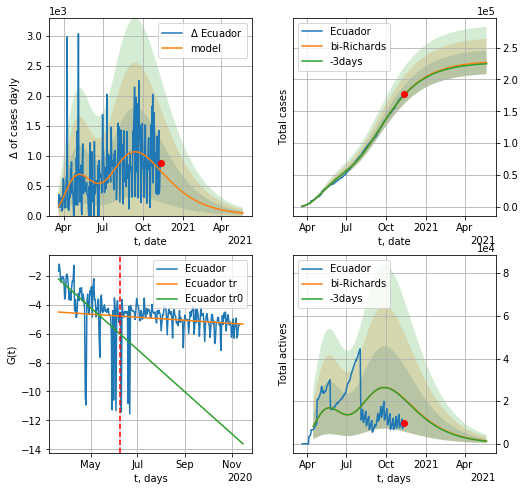

Ecuador data at: 2020-11-12
+3 day model MAPE: 0.002382
model: bi-Richards
coeffs: [ 1.64360867e+05  1.72795574e+00 -9.81606935e+01  9.83741103e-03]
rational stdev: 0.081712
forecast at the end of period: +191 days
	 deltaDaycases: 42
	 total cases: 226783 ± 18530
	 total death: 16539 ± 4054
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.273720
 intercept: -2.219850
 slope: -0.047316
trend coefficient of determination: 0.021131
 intercept: -4.507441
 slope: -0.003461


In [1462]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Ecuador",dfED[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [1275]:
#x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date    cases  active  death
257 2020-11-08  17887.0    4825  362.0
258 2020-11-09  17996.0    4824  363.0
259 2020-11-10  18107.0    5044  363.0
260 2020-11-11  18345.0    3980  365.0
261 2020-11-12  18542.0    4177  365.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


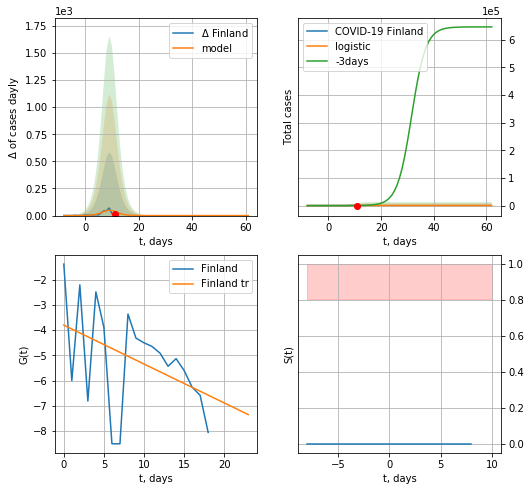

Finland data at: 2020-11-12
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  7 ± 231
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


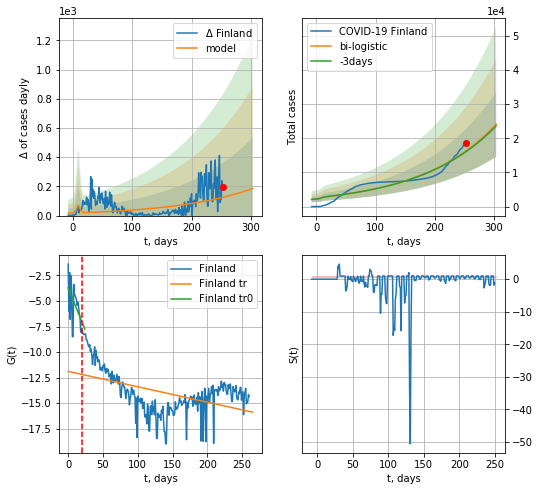

Finland data at: 2020-11-12
+3 day model MAPE: 0.015070566452447143
model: bi-logistic
coeffs:  [1.78913114e+07 7.82206186e-03 1.15072885e+03] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.39351275165161664
forecast at the end of period: +51 days
	 deltaDaycases:  184
	 total cases:  24127 ± 9494
	 total death:  474 ± 559
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.235211
 intercept: -11.897879
 slope: -0.015089


In [1276]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


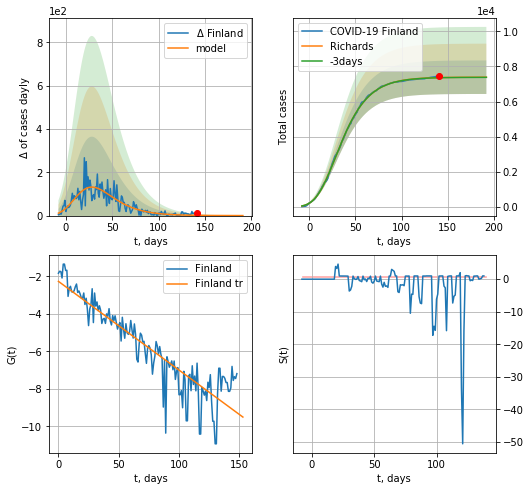

Finland data at: 2020-11-12
+3 day model MAPE: 0.001103
model: Richards
coeffs: [ 7.38854164e+03  5.39963308e-01 -1.81801816e+01  9.38814747e-02]
rational stdev: 0.129256
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 7386 ± 954
	 total death: 145 ± 56
trend coefficient of determination: 0.823115
 intercept: -2.267352
 slope: -0.047318


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


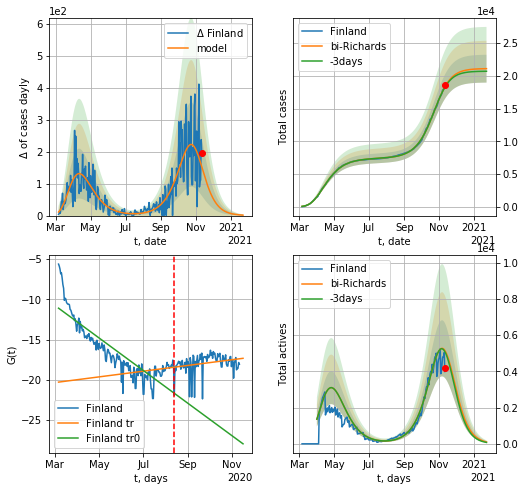

Finland data at: 2020-11-12
+3 day model MAPE: 0.004525
model: bi-Richards
coeffs: [1.37217617e+04 5.26126273e-02 2.28370503e+02 1.37612056e+00]
rational stdev: 0.100823
forecast at the end of period: +72 days
	 deltaDaycases: 1
	 total cases: 21091 ± 2126
	 total death: 415 ± 125
bi-Richards approximation splitting point: 160
trend coefficient of determination: 0.744221
 intercept: -11.092463
 slope: -0.066191
trend coefficient of determination: 0.062588
 intercept: -20.293152
 slope: 0.011612


In [1463]:
vL = 170#96 + 10 + 25
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Finland",dfFI[10:],d12f(1),43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.75)

In [1464]:
## x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases   active   death
243 2020-11-08  75160  49087.0  1665.0
244 2020-11-09  78976  51922.0  1771.0
245 2020-11-10  83366  55716.0  1851.0
246 2020-11-11  87311  58699.0  1898.0
247 2020-11-12  90725  61168.0  1970.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


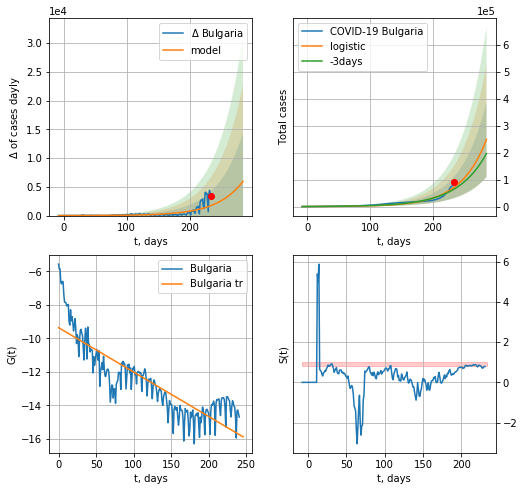

Bulgaria data at: 2020-11-12
+3 day model MAPE: 0.1083899941559377
model: logistic
coeffs:  [5.89194959e+08 2.42135454e-02 6.05851224e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.5586291852856317
forecast at the end of period: +51 days
	 deltaDaycases:  5952
	 total cases:  248923 ± 139055
	 total death:  5405 ± 9058
trend coefficient of determination: 0.736327
 intercept: -9.354254
 slope: -0.026496


In [1465]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,T18*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


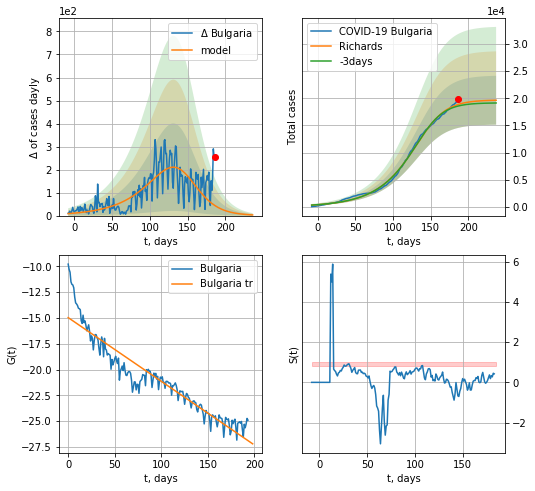

Bulgaria data at: 2020-11-12
+3 day model MAPE: 0.015854
model: Richards
coeffs: [1.96955662e+04 2.71935660e-02 1.44494444e+02 2.07644343e+00]
rational stdev: 0.229297
forecast at the end of period: +51 days
	 deltaDaycases: 2
	 total cases: 19644 ± 4504
	 total death: 426 ± 293
trend coefficient of determination: 0.884878
 intercept: -14.971872
 slope: -0.061709


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


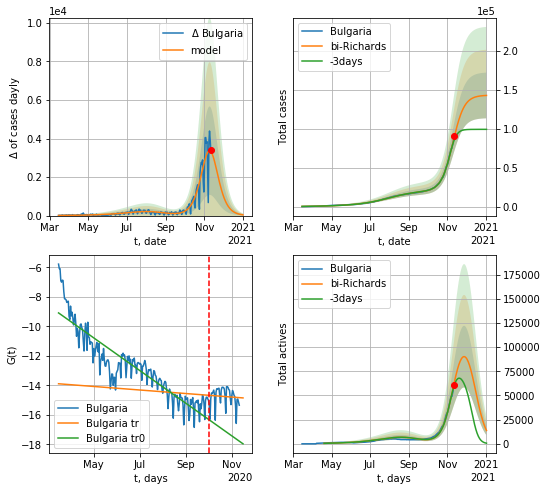

Bulgaria data at: 2020-11-12
+3 day model MAPE: 0.059749
model: bi-Richards
coeffs: [1.23684639e+05 1.04863011e-01 2.32060842e+02 1.05742341e+00]
rational stdev: 0.205490
forecast at the end of period: +51 days
	 deltaDaycases: 38
	 total cases: 143047 ± 29394
	 total death: 3106 ± 1914
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.826609
 intercept: -9.094054
 slope: -0.036065
trend coefficient of determination: 0.005651
 intercept: -13.896353
 slope: -0.003898


In [1280]:
vL = 200+5#71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bulgaria',dfBL[5:],d1,40*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

In [1281]:
#x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
255 2020-11-08  3840.0   119.0   60.0
256 2020-11-09  3844.0   114.0   60.0
257 2020-11-10  3847.0   102.0   60.0
258 2020-11-11  3852.0    99.0   60.0
259 2020-11-12  3861.0   104.0   60.0


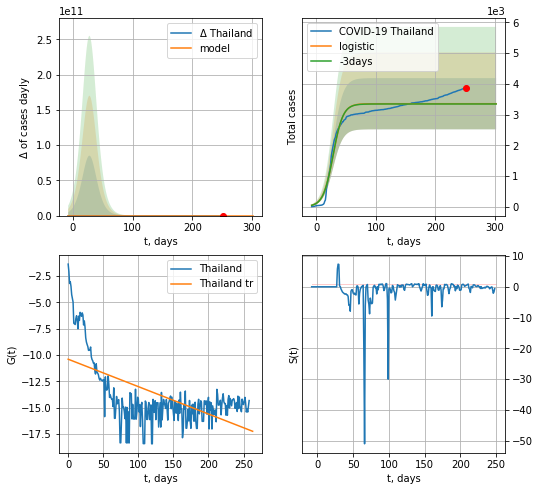

Thailand data at: 2020-11-12
+3 day model MAPE: 0.002530294499887179
model: logistic
coeffs:  [3.35227052e+03 1.19929155e-01 2.80353906e+01]
rational stdev:  0.24876329257027904
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  3352 ± 833
	 total death:  52 ± 38
trend coefficient of determination: 0.364255
 intercept: -10.401280
 slope: -0.025975


In [1282]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [1283]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


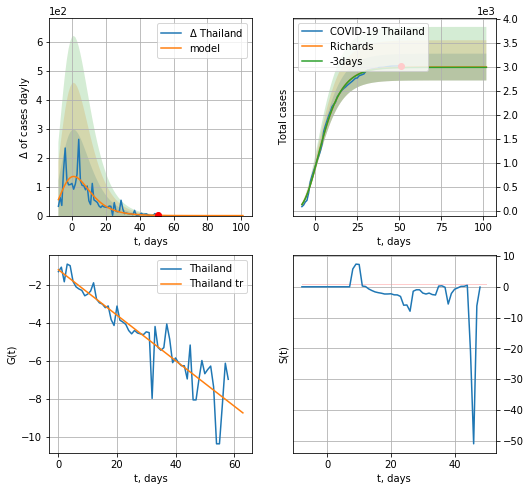

Thailand data at: 2020-11-12
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 46 ± 12
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


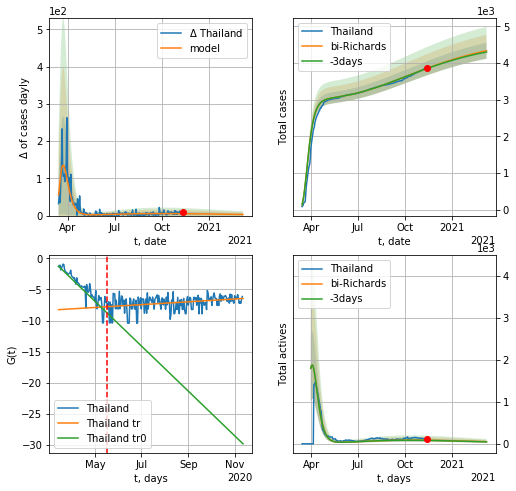

Thailand data at: 2020-11-12
+3 day model MAPE: 0.001733
model: bi-Richards
coeffs: [ 1.72497915e+03  9.55190290e-01 -3.47162973e+02  9.08066407e-03]
rational stdev: 0.050001
forecast at the end of period: +121 days
	 deltaDaycases: 2
	 total cases: 4332 ± 216
	 total death: 67 ± 10
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843388
 intercept: -1.257466
 slope: -0.117600
trend coefficient of determination: 0.110113
 intercept: -8.249135
 slope: 0.007398


In [1466]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Thailand",dfTH[20:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.5)

In [1467]:
#x = forecastRRR("Thailand",dfTH[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

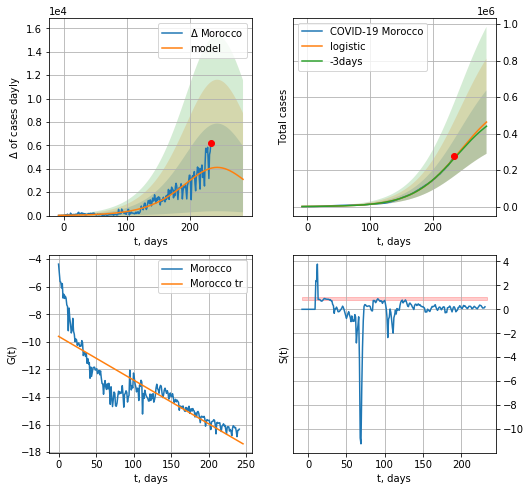

Morocco data at: 2020-11-12
+3 day model MAPE: 0.0135221266386608
model: logistic
coeffs:  [6.17220504e+05 2.66730790e-02 2.43631878e+02]
rational stdev:  0.3752594348055225
forecast at the end of period: +51 days
	 deltaDaycases:  3099
	 total cases:  463470 ± 173921
	 total death:  7651 ± 8613
trend coefficient of determination: 0.763733
 intercept: -9.600790
 slope: -0.031683


In [1468]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


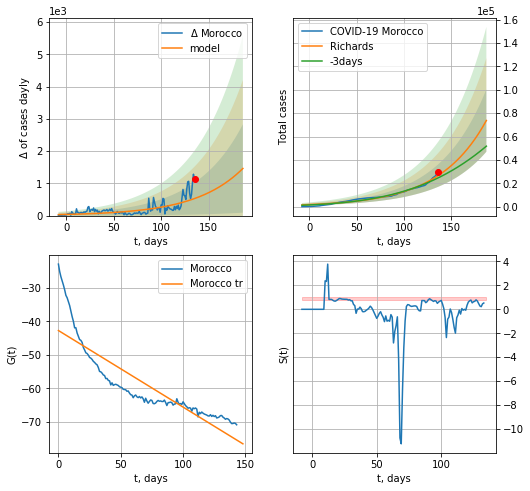

Morocco data at: 2020-11-12
+3 day model MAPE: 0.084312
model: Richards
coeffs: [2.79033948e+05 2.00180443e-02 2.53488041e+02 6.56605643e+00]
rational stdev: 0.361985
forecast at the end of period: +51 days
	 deltaDaycases: 1460
	 total cases: 73725 ± 26687
	 total death: 1217 ± 1321
trend coefficient of determination: 0.761351
 intercept: -42.734375
 slope: -0.228487


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


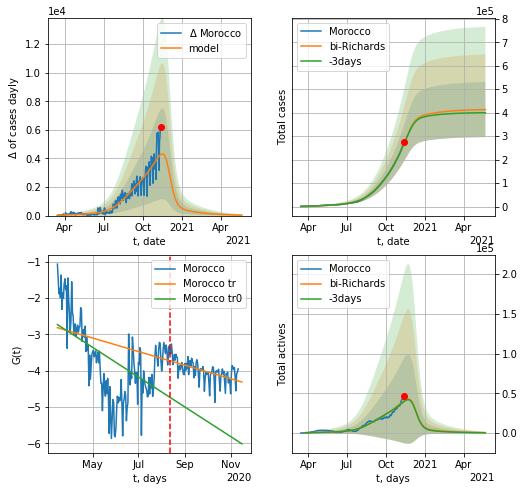

Morocco data at: 2020-11-12
+3 day model MAPE: 0.008527
model: bi-Richards
coeffs: [ 1.35903941e+05  1.64766317e+00 -3.05611777e+01  1.17845694e-02]
rational stdev: 0.283989
forecast at the end of period: +191 days
	 deltaDaycases: 32
	 total cases: 413287 ± 117369
	 total death: 6822 ± 5812
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.297517
 intercept: -2.732167
 slope: -0.013321
trend coefficient of determination: 0.333605
 intercept: -2.816066
 slope: -0.006074


In [1469]:
vL = 155 
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Morocco",dfMR[5:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5,amc=0.33)

In [1288]:
#x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1529]:
dfRM = read_df(pd.DataFrame(),"RM")
#x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

RM
           date     cases  active   death
256 2020-11-08  303751.0   91193  7879.0
257 2020-11-09  306991.0   92189  8009.0
258 2020-11-10  314295.0   94701  8186.0
259 2020-11-11  324094.0   97619  8389.0
260 2020-11-12  334236.0  100810  8510.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


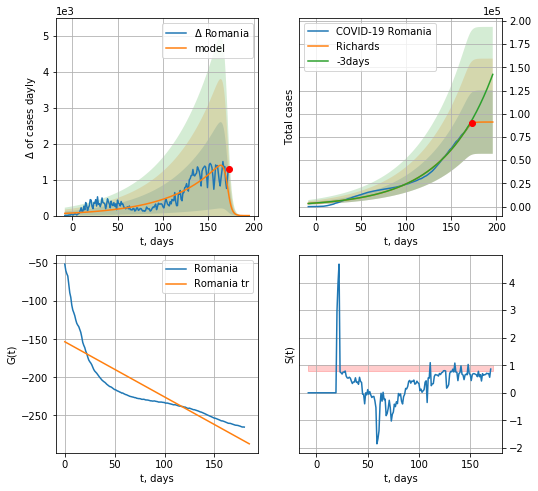

Romania data at: 2020-11-12
+3 day model MAPE: 0.053954
model: Richards
coeffs: [9.10483361e+04 1.84517813e-02 1.71468019e+02 2.28787361e+01]
rational stdev: 0.374976
forecast at the end of period: +23 days
	 deltaDaycases: 0
	 total cases: 91048 ± 34140
	 total death: 2318 ± 2607
trend coefficient of determination: 0.713660
 intercept: -153.246272
 slope: -0.723824
diffStd0a 0.9427446505588559


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


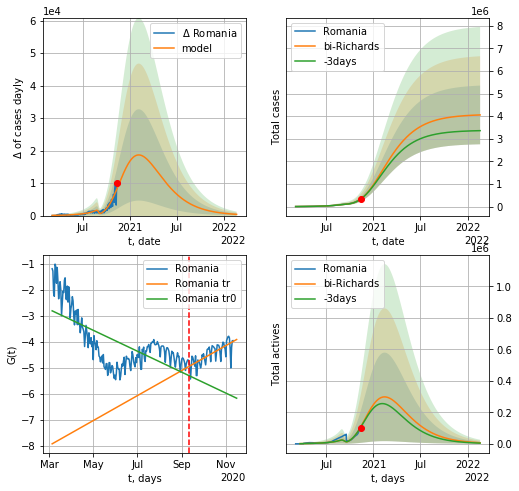

Romania data at: 2020-11-12
+3 day model MAPE: 0.007896
model: bi-Richards
coeffs: [3.99352914e+06 3.64521353e-01 6.97489571e+01 3.54777395e-02]
rational stdev: 0.320108
forecast at the end of period: +464 days
	 deltaDaycases: 378
	 total cases: 4055400 ± 1298167
	 total death: 103254 ± 99157
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.476927
 intercept: -2.800003
 slope: -0.013132
trend coefficient of determination: 0.534223
 intercept: -7.917251
 slope: 0.015681


In [1530]:
vL = 190+8#87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Romania",dfRM[8:],d12f(1),99*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8,amc=0.5)

In [1291]:
#xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1292]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

In [1293]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
#x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
#xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

EU
           date    cases   active     death
274 2020-11-08  8086216  3968310  194534.0
275 2020-11-09  8245042  4043209  197227.0
276 2020-11-10  8434606  4092417  201374.0
277 2020-11-11  8639459  4194745  204530.0
278 2020-11-12  8851422  4291074  207469.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


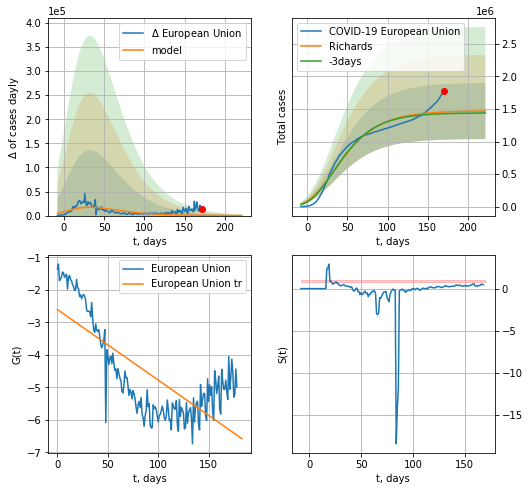

European Union data at: 2020-11-12
+3 day model MAPE: 0.018821
model: Richards
coeffs: [ 1.47108264e+06  9.68553883e+00 -1.45516242e+02  3.30701527e-03]
rational stdev: 0.293203
forecast at the end of period: +51 days
	 deltaDaycases: 111
	 total cases: 1467652 ± 430320
	 total death: 34400 ± 30258
trend coefficient of determination: 0.571524
 intercept: -2.605625
 slope: -0.021726


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


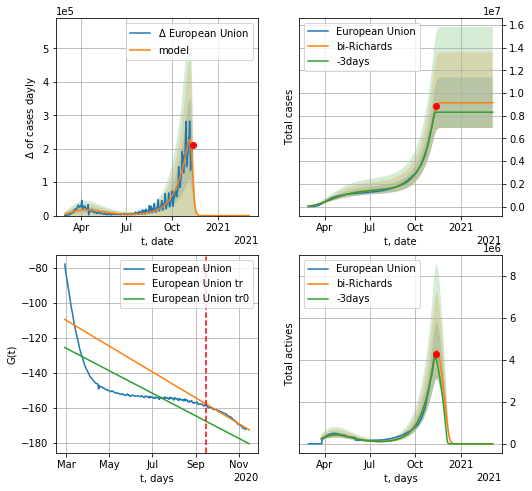

European Union data at: 2020-11-12
+3 day model MAPE: 0.070339
model: bi-Richards
coeffs: [7.67124565e+06 4.12118724e-02 2.48962567e+02 1.05394751e+01]
rational stdev: 0.243222
forecast at the end of period: +114 days
	 deltaDaycases: 1
	 total cases: 9142291 ± 2223607
	 total death: 214286 ± 156357
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.533281
 intercept: -125.424973
 slope: -0.210484
trend coefficient of determination: 0.967881
 intercept: -109.360045
 slope: -0.241290


In [1473]:
vL = 200+20#83+20+17
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("European Union",dfEU[20:],d1,49*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20,amc=0.75)

In [1295]:
#x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1296]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [1297]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [1298]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [1299]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [1300]:
#dfIC[:]

IC
           date   cases  active  death
252 2020-11-08  5078.0     635   20.0
253 2020-11-09  5101.0     622   23.0
254 2020-11-10  5114.0     569   24.0
255 2020-11-11  5142.0     542   24.0
256 2020-11-12  5160.0     472   25.0


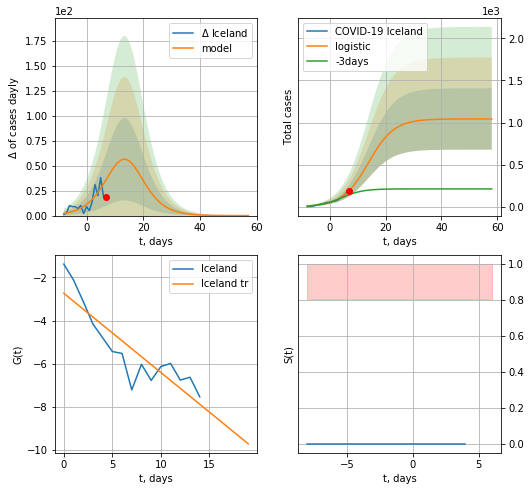

Iceland data at: 2020-11-12
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1042 ± 364
	 total death:  5 ± 5
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


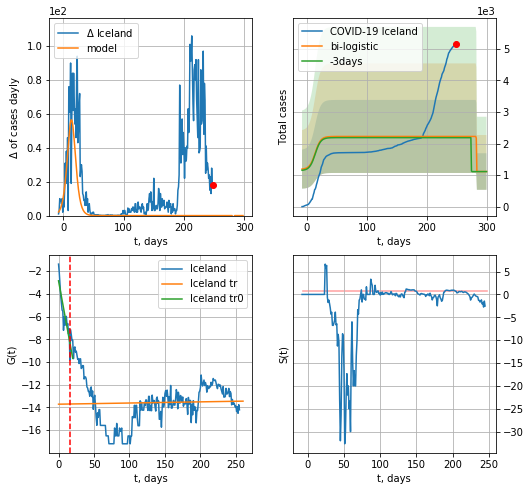

Iceland data at: 2020-11-12
+3 day model MAPE: 0.01712872042592651
model: bi-logistic
coeffs:  [1111.53627993  -10.38580439  282.28222145] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.5201834888068222
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1112 ± 578
	 total death:  5 ± 7
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.001240
 intercept: -13.711975
 slope: 0.001027


In [1301]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


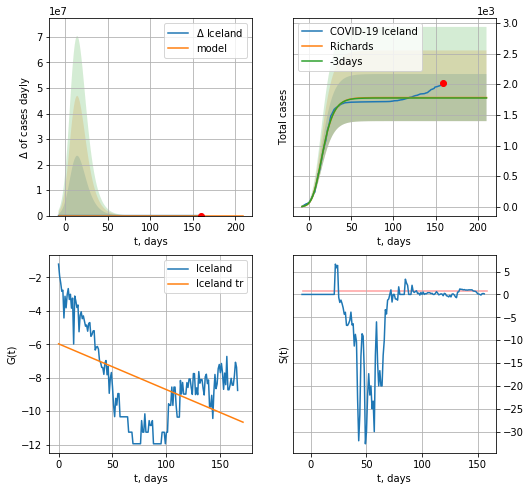

Iceland data at: 2020-11-12
+3 day model MAPE: 0.003798
model: Richards
coeffs: [1.78218704e+03 4.15281218e-01 4.51711528e+00 2.96176572e-01]
rational stdev: 0.215516
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1782 ± 384
	 total death: 8 ± 5
trend coefficient of determination: 0.246093
 intercept: -5.976231
 slope: -0.027410


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


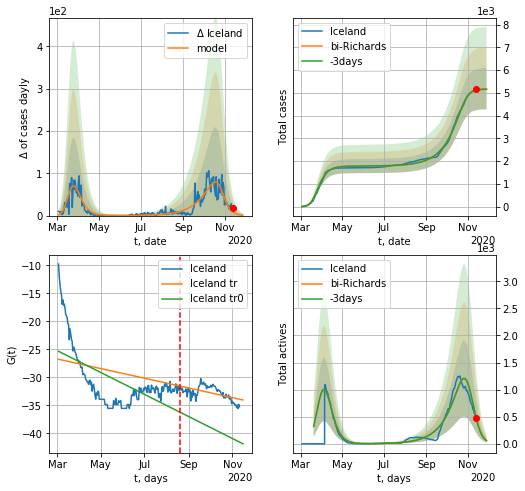

Iceland data at: 2020-11-12
+3 day model MAPE: 0.003875
model: bi-Richards
coeffs: [3.40443036e+03 4.64998024e-02 2.28864667e+02 3.46622549e+00]
rational stdev: 0.174550
forecast at the end of period: +16 days
	 deltaDaycases: 0
	 total cases: 5181 ± 904
	 total death: 25 ± 13
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.359630
 intercept: -25.367182
 slope: -0.064037
trend coefficient of determination: 0.318645
 intercept: -26.785874
 slope: -0.028188


In [1474]:
vL = 170+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iceland",dfIC[2:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2,amc=0.5)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

In [1303]:
#x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date   cases   active   death
243 2020-11-08  139527  18959.0  2798.0
244 2020-11-09  140331  18812.0  2808.0
245 2020-11-10  141302  18778.0  2817.0
246 2020-11-11  142465  18819.0  2823.0
247 2020-11-12  143352  18452.0  2830.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


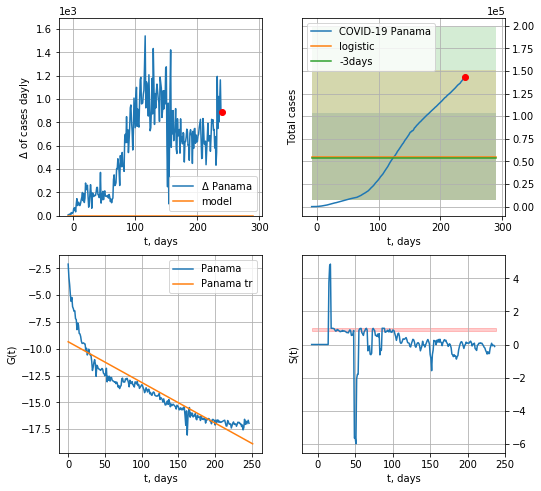

Panama data at: 2020-11-12
+3 day model MAPE: 0.01966398436830582
model: logistic
coeffs:  [ 5.52921411e+04 -4.61339682e+01  1.11462406e+03]
rational stdev:  0.8646067914027148
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  55292 ± 47805
	 total death:  1091 ± 2829
trend coefficient of determination: 0.821015
 intercept: -9.347194
 slope: -0.037954


In [1304]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


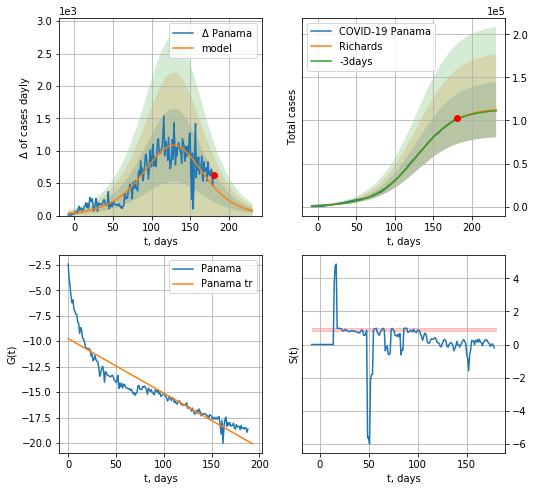

Panama data at: 2020-11-12
+3 day model MAPE: 0.004779
model: Richards
coeffs: [1.14376005e+05 3.40368038e-02 1.33227436e+02 1.17332145e+00]
rational stdev: 0.284778
forecast at the end of period: +51 days
	 deltaDaycases: 74
	 total cases: 112522 ± 32043
	 total death: 2221 ± 1897
trend coefficient of determination: 0.821505
 intercept: -9.752317
 slope: -0.053459


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


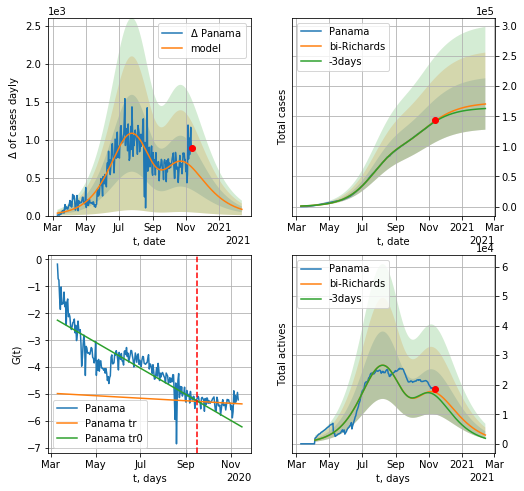

Panama data at: 2020-11-12
+3 day model MAPE: 0.006962
model: bi-Richards
coeffs: [5.88565184e+04 2.65068066e+00 6.83540569e+01 1.07732671e-02]
rational stdev: 0.250483
forecast at the end of period: +93 days
	 deltaDaycases: 82
	 total cases: 170334 ± 42665
	 total death: 3362 ± 2526
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.711194
 intercept: -2.255896
 slope: -0.015771
trend coefficient of determination: 0.015927
 intercept: -4.979122
 slope: -0.001527


In [1475]:
vL = 190#70
x = forecastRR("Panama",dfPM[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Panama",dfPM[:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)

In [1306]:
#x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


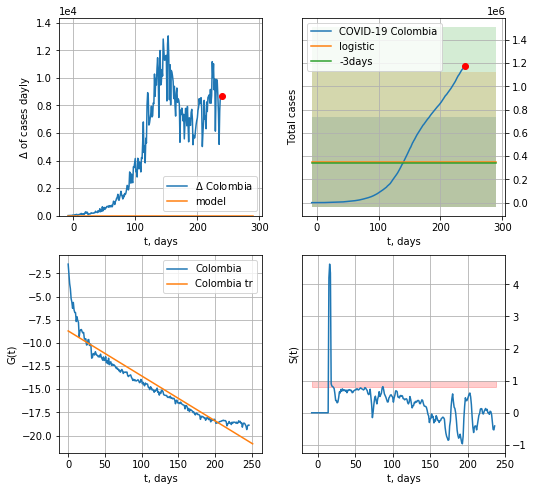

Colombia data at: 2020-11-12
+3 day model MAPE: 0.029102544958367216
model: logistic
coeffs:  [ 3.52119465e+05 -2.57386189e+01  6.17883623e+02]
rational stdev:  1.0967704717049729
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  352119 ± 386194
	 total death:  10044 ± 33047
trend coefficient of determination: 0.896508
 intercept: -8.713411
 slope: -0.048525


In [1307]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


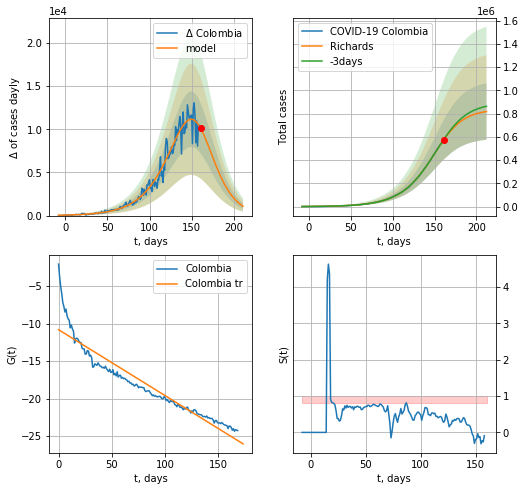

Colombia data at: 2020-11-12
+3 day model MAPE: 0.007195
model: Richards
coeffs: [8.34733445e+05 4.05910499e-02 1.56797482e+02 1.52613261e+00]
rational stdev: 0.296867
forecast at the end of period: +51 days
	 deltaDaycases: 1082
	 total cases: 817305 ± 242630
	 total death: 23315 ± 20764
trend coefficient of determination: 0.889696
 intercept: -10.819712
 slope: -0.087917


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


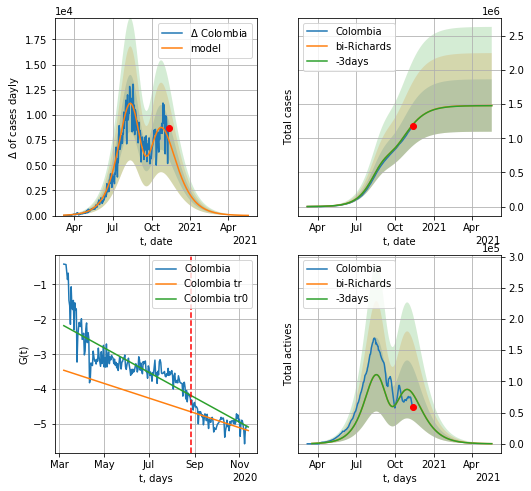

Colombia data at: 2020-11-12
+3 day model MAPE: 0.000237
model: bi-Richards
coeffs: [6.44878841e+05 2.99969725e+00 9.92166749e+01 1.16838642e-02]
rational stdev: 0.259232
forecast at the end of period: +191 days
	 deltaDaycases: 18
	 total cases: 1479103 ± 383430
	 total death: 42194 ± 32814
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.633870
 intercept: -2.182097
 slope: -0.011558
trend coefficient of determination: 0.425865
 intercept: -3.458930
 slope: -0.006880


In [1479]:
vL = 170#41
x = forecastRR("Colombia",dfCB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Colombia",dfCB[:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.333)

In [1309]:
#x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases   active   death
249 2020-11-08  62051.0  17966.0  2048.0
250 2020-11-09  62693.0  18306.0  2062.0
251 2020-11-10  63446.0  18743.0  2077.0
252 2020-11-11  64257.0  19184.0  2093.0
253 2020-11-12  65108.0  20017.0  2111.0


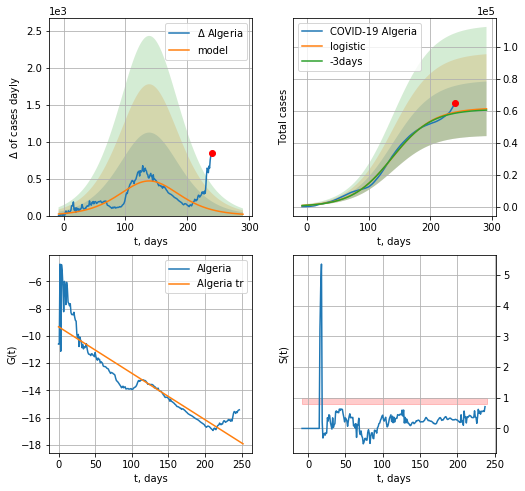

Algeria data at: 2020-11-12
+3 day model MAPE: 0.010623212809016295
model: logistic
coeffs:  [6.18850689e+04 3.03058218e-02 1.38911211e+02]
rational stdev:  0.2789938651036854
forecast at the end of period: +51 days
	 deltaDaycases:  18
	 total cases:  61274 ± 17095
	 total death:  1986 ± 1662
trend coefficient of determination: 0.832853
 intercept: -9.328675
 slope: -0.034081


In [1310]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


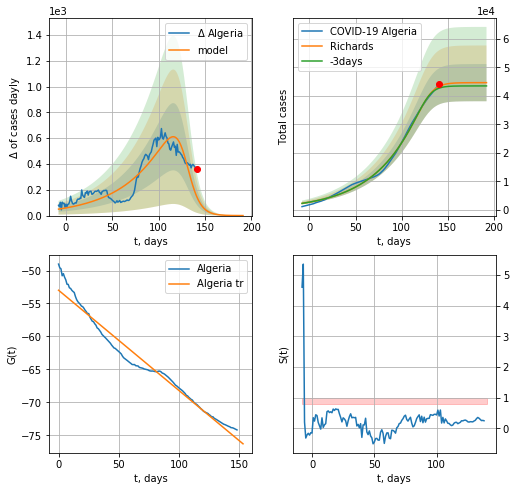

Algeria data at: 2020-11-12
+3 day model MAPE: 0.015957
model: Richards
coeffs: [4.46472187e+04 2.15635914e-02 1.29583000e+02 6.48850976e+00]
rational stdev: 0.145963
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 44646 ± 6516
	 total death: 1447 ± 633
trend coefficient of determination: 0.966080
 intercept: -52.986797
 slope: -0.152377


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


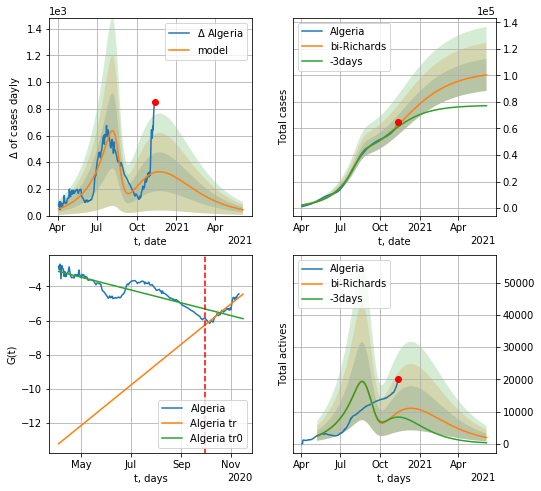

Algeria data at: 2020-11-12
+3 day model MAPE: 0.023589
model: bi-Richards
coeffs: [ 5.86202258e+04  1.73157793e+00 -8.27308674e+01  8.83936191e-03]
rational stdev: 0.120103
forecast at the end of period: +205 days
	 deltaDaycases: 44
	 total cases: 100325 ± 12049
	 total death: 3252 ± 1171
bi-Richards approximation splitting point: 180
trend coefficient of determination: 0.702943
 intercept: -3.118111
 slope: -0.012201
trend coefficient of determination: 0.896607
 intercept: -13.219462
 slope: 0.038645


In [1311]:
iL = 30
vL = 180+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[iL:],d1,62*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1312]:
#x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases  active    death
244 2020-11-08  439140   54804  14614.0
245 2020-11-09  440569   53614  14689.0
246 2020-11-10  444348   53846  14761.0
247 2020-11-11  452291   55274  14933.0
248 2020-11-12  457735   57604  15037.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


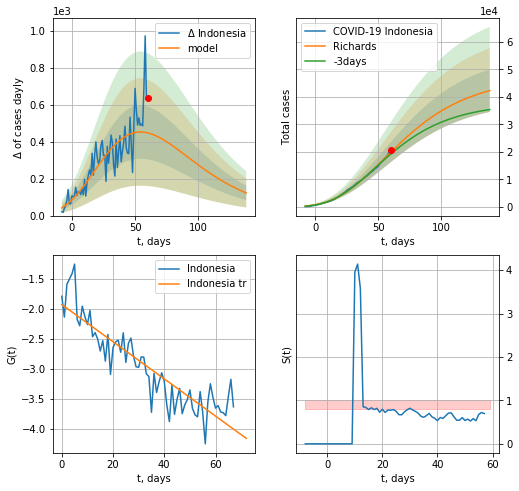

Indonesia data at: 2020-11-12
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +79 days
	 deltaDaycases: 122
	 total cases: 42259 ± 7730
	 total death: 1395 ± 765
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064
diffStd0a 0.36931695896523387


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


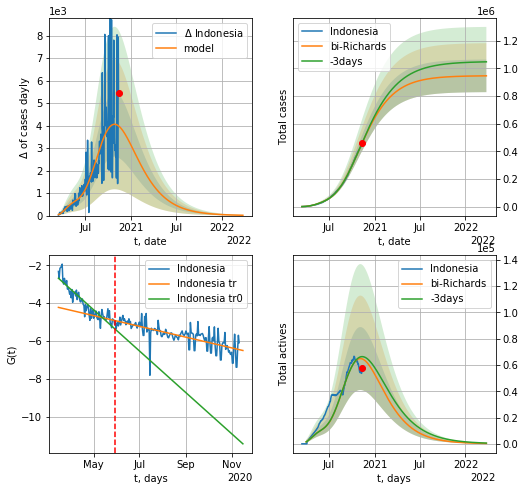

Indonesia data at: 2020-11-12
+3 day model MAPE: 0.005440
model: bi-Richards
coeffs: [8.99458969e+05 1.02258349e-01 5.96738213e+01 1.27056932e-01]
rational stdev: 0.124694
forecast at the end of period: +499 days
	 deltaDaycases: 14
	 total cases: 945460 ± 117892
	 total death: 31215 ± 11676
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.835626
 intercept: -2.682081
 slope: -0.035552
trend coefficient of determination: 0.562209
 intercept: -4.222152
 slope: -0.009254


In [1514]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    #x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Indonesia",dfIE[6:],d12f(1),104*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6,amc=0.5)
except:
    print ("Exception occurs")

In [1314]:
#x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1315]:
vL=10
vL1=25
try:
    dfPH = read_df(pd.DataFrame(),"PH")
    #x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
    #xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])
except:
    print ("Exception occurs")

PH
           date   cases   active   death
246 2020-11-08  398449  29018.0  7647.0
247 2020-11-09  399749  30169.0  7661.0
248 2020-11-10  401416  31489.0  7710.0
249 2020-11-11  402820  32682.0  7721.0
250 2020-11-12  404713  34058.0  7752.0


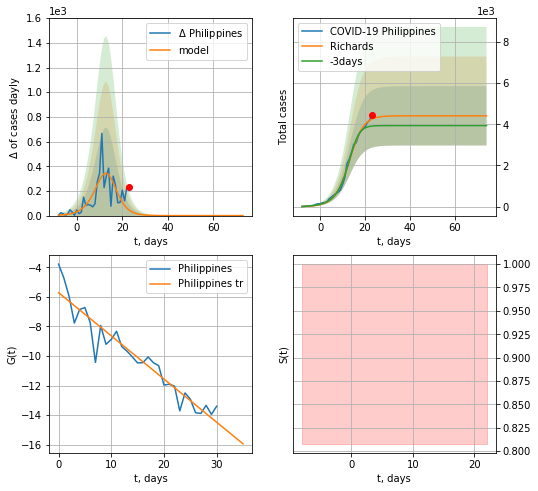

Philippines data at: 2020-11-12
+3 day model MAPE: 0.095041
model: Richards
coeffs: [4.40831989e+03 2.70678377e-01 1.39356489e+01 1.24523177e+00]
rational stdev: 0.326084
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 4408 ± 1437
	 total death: 84 ± 82
trend coefficient of determination: 0.911495
 intercept: -5.712821
 slope: -0.292234


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


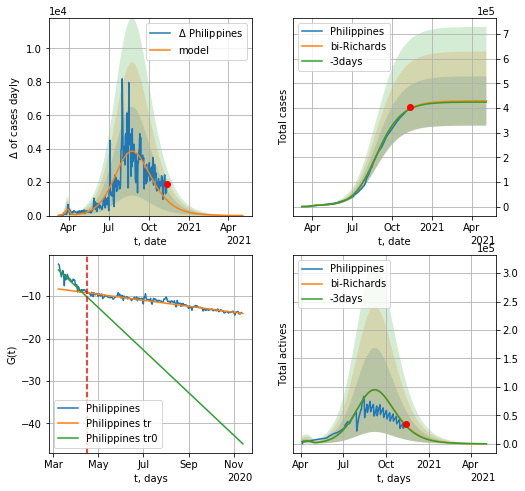

Philippines data at: 2020-11-12
+3 day model MAPE: 0.005158
model: bi-Richards
coeffs: [4.24706612e+05 4.91935960e-02 1.48160656e+02 6.58878473e-01]
rational stdev: 0.233386
forecast at the end of period: +177 days
	 deltaDaycases: 3
	 total cases: 429001 ± 100122
	 total death: 8217 ± 5753
bi-Richards approximation splitting point: 36
trend coefficient of determination: 0.835749
 intercept: -3.806621
 slope: -0.164026
trend coefficient of determination: 0.922369
 intercept: -8.291438
 slope: -0.023122


In [1482]:
vL = 36 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Philippines",dfPH[4:],d12f(1),58*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4,amc=0.75)

In [1317]:
#x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1318]:
dfGC = read_df(pd.DataFrame(),"GC")
#x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
#xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

GC
           date    cases  active  death
253 2020-11-08  56698.0   45925  784.0
254 2020-11-09  58187.0   47373  825.0
255 2020-11-10  60570.0   49715  866.0
256 2020-11-11  63321.0   52423  909.0
257 2020-11-12  66637.0   55689  959.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


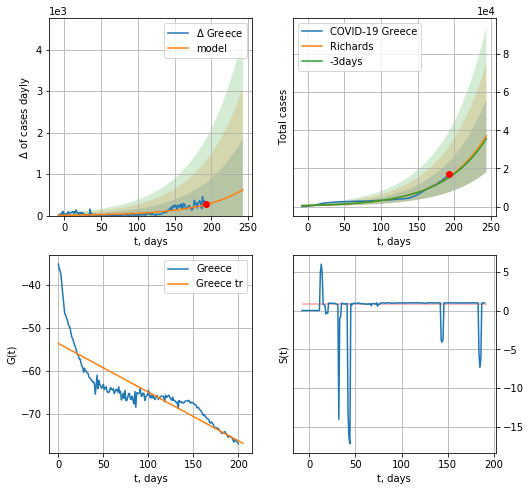

Greece data at: 2020-11-12
+3 day model MAPE: 0.022680
model: Richards
coeffs: [1.22839764e+05 1.69681107e-02 3.14569453e+02 7.48237291e+00]
rational stdev: 0.511475
forecast at the end of period: +51 days
	 deltaDaycases: 624
	 total cases: 37093 ± 18972
	 total death: 533 ± 817
trend coefficient of determination: 0.729021
 intercept: -53.624106
 slope: -0.113112
diffStd0a 0.40304097736327993


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


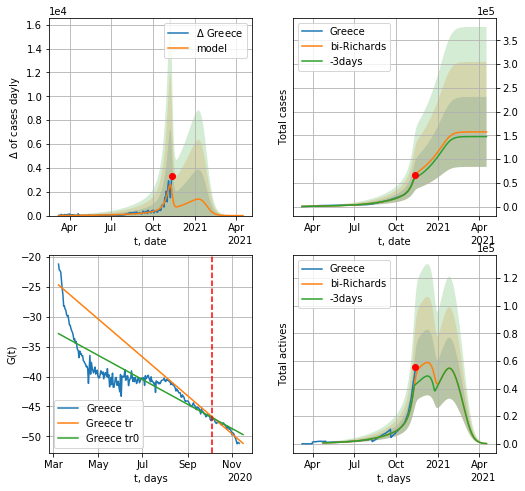

Greece data at: 2020-11-12
+3 day model MAPE: 0.117212
model: bi-Richards
coeffs: [3.45451232e+04 1.07256209e-01 2.40189734e+02 4.33503869e+00]
rational stdev: 0.468249
forecast at the end of period: +156 days
	 deltaDaycases: 0
	 total cases: 157384 ± 73695
	 total death: 2264 ± 3180
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.697549
 intercept: -32.846626
 slope: -0.066552
trend coefficient of determination: 0.890855
 intercept: -24.726066
 slope: -0.104404


In [1532]:
iL = 8
vL = 210+iL
x = forecastRR("Greece",dfGC[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Greece",dfGC[iL:],d1,55*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.33)

In [1320]:
#x = forecastRRR("Greece",dfGC[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1321]:
dfHG = read_df(pd.DataFrame(),"HG")
#try:
#    x = forecast("Hungary",dfHG[:],d1,T18*7-dT,addpred=True,xcoef=[.35,.5,4,1])
#except:
#    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

HG
           date     cases  active   death
247 2020-11-08  114778.0   86124  2493.0
248 2020-11-09  118918.0   88737  2596.0
249 2020-11-10  122863.0   91358  2697.0
250 2020-11-11  126790.0   94704  2784.0
251 2020-11-12  131887.0   99202  2883.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


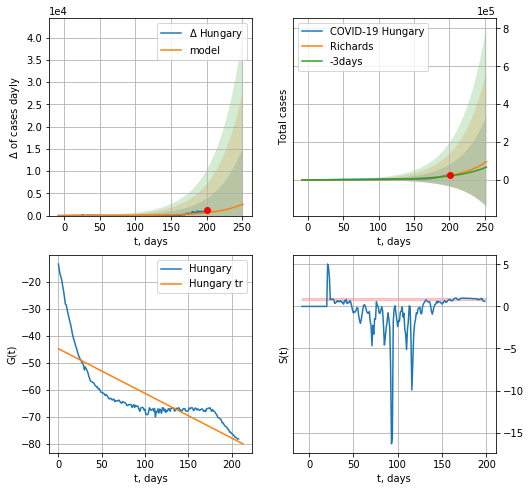

Hungary data at: 2020-11-12
+3 day model MAPE: 0.145721
model: Richards
coeffs: [1.69960015e+05 2.73419286e-02 2.72689391e+02 7.30777798e+00]
rational stdev: 2.462186
forecast at the end of period: +51 days
	 deltaDaycases: 2561
	 total cases: 96322 ± 237163
	 total death: 2105 ± 15548
trend coefficient of determination: 0.621950
 intercept: -44.694459
 slope: -0.165218


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


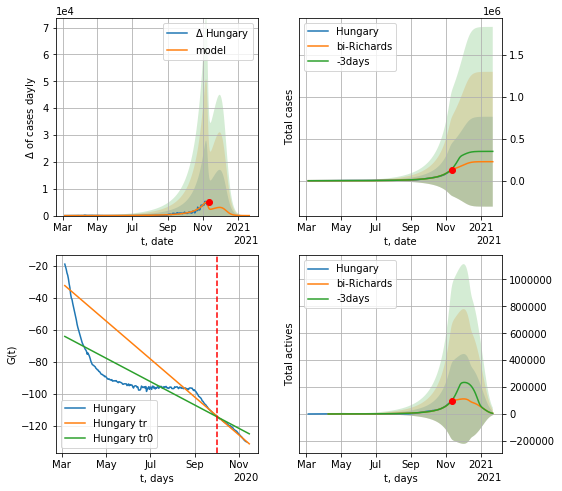

Hungary data at: 2020-11-12
+3 day model MAPE: 0.077692
model: bi-Richards
coeffs: [5.73193394e+04 7.64364522e-02 2.41733168e+02 1.07598645e+01]
rational stdev: 2.359501
forecast at the end of period: +72 days
	 deltaDaycases: 1
	 total cases: 227274 ± 536254
	 total death: 4968 ± 35165
bi-Richards approximation splitting point: 210
trend coefficient of determination: 0.633607
 intercept: -64.185082
 slope: -0.239047
trend coefficient of determination: 0.987872
 intercept: -32.371277
 slope: -0.388355


In [1322]:
vL = 210#130
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Hungary",dfHG[:],d1,43*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [1323]:
#x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


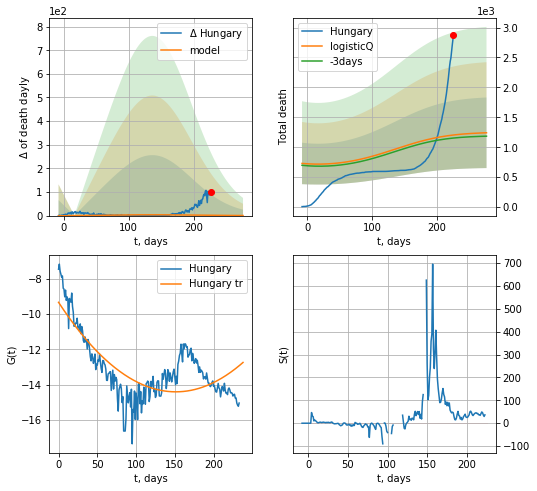

Hungary data at: 2020-11-12
+3 day model MAPE: 0.044248
model: logisticQ
coeffs: [1.05845106e+03 7.17842564e-05 2.31208833e+01 8.39677325e+00]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.474873
forecast at the end of period: +51 days
	 total death: 1241 ± 589
trend coefficient of determination: 0.565446
 intercept_: -9.340042775714558
 coeffs_: [ 0.         -0.06696899  0.00022129]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:139: RuntimeWarning: divide by zero encountered in true_divide


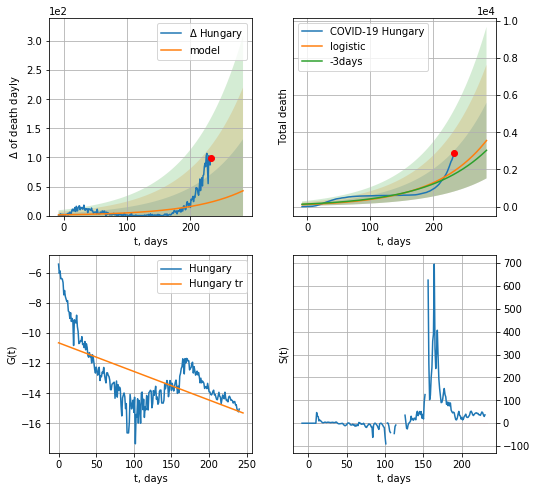

Hungary data at: 2020-11-12
+3 day model MAPE: 0.09979653539342467
model: logistic
coeffs:  [1.80585536e+07 1.20836911e-02 9.90145967e+02]
rational stdev:  0.5727738016271549
forecast at the end of period: +51 days
	 total death:  3554 ± 2036
trend coefficient of determination: 0.377100
 intercept: -10.647315
 slope: -0.018995


In [1324]:
x = forecastRRR("Hungary",dfHG[17:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

In [1325]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    #x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    #xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

MT
           date   cases  active  death
245 2020-11-08  7141.0    1962   76.0
246 2020-11-09  7243.0    1980   78.0
247 2020-11-10  7396.0    2041   81.0
248 2020-11-11  7537.0    2078   88.0
249 2020-11-12  7646.0    2079   88.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


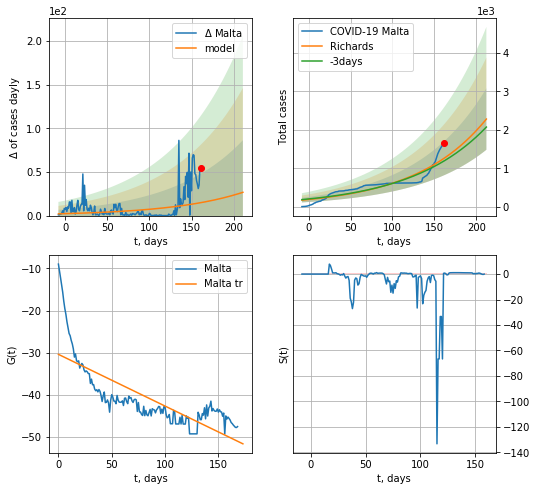

Malta data at: 2020-11-12
+3 day model MAPE: 0.058506
model: Richards
coeffs: [1.79480999e+04 1.17638464e-02 3.87365718e+02 5.94374794e+00]
rational stdev: 0.350416
forecast at the end of period: +51 days
	 deltaDaycases: 26
	 total cases: 2280 ± 799
	 total death: 26 ± 27
trend coefficient of determination: 0.590889
 intercept: -30.386213
 slope: -0.122562


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


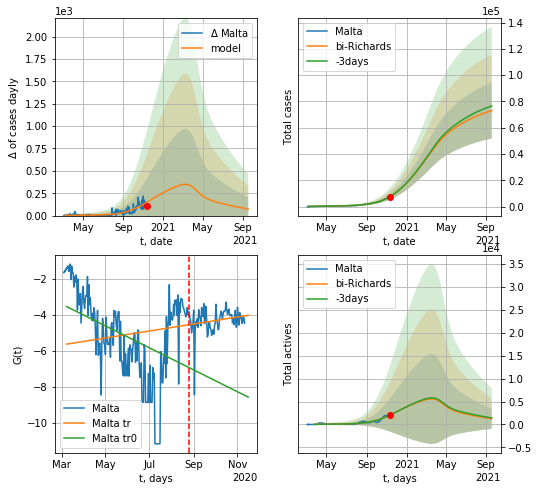

Malta data at: 2020-11-12
+3 day model MAPE: 0.002458
model: bi-Richards
coeffs: [ 6.32887405e+04  4.37342445e-01 -5.27335669e+01  2.19331338e-02]
rational stdev: 0.290818
forecast at the end of period: +310 days
	 deltaDaycases: 73
	 total cases: 73021 ± 21235
	 total death: 840 ± 732
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.172916
 intercept: -3.525935
 slope: -0.019946
trend coefficient of determination: 0.050332
 intercept: -5.618093
 slope: 0.006343


In [1484]:
vL = 170#112
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Malta",dfMT[:],d12f(1),77*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [1327]:
#x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
#xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

In [1328]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
#try:
#    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
#    xx = forecast2("Slovakia",dfSL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
#except:
#    print("Exception ocurs")

SL
           date    cases   active  death
243 2020-11-08  75782.0  55663.0  351.0
244 2020-11-09  76072.0  55949.0  366.0
245 2020-11-10  77123.0  55015.0  390.0
246 2020-11-11  79181.0  55520.0  414.0
247 2020-11-12  81772.0  56994.0  464.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


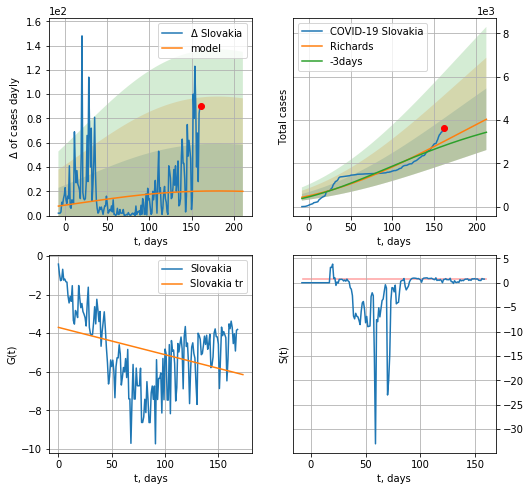

Slovakia data at: 2020-11-12
+3 day model MAPE: 0.071099
model: Richards
coeffs: [ 9.22154238e+03  4.41676744e-01 -5.31921240e+02  1.36332717e-02]
rational stdev: 0.352489
forecast at the end of period: +51 days
	 deltaDaycases: 19
	 total cases: 4033 ± 1421
	 total death: 22 ± 23
trend coefficient of determination: 0.127387
 intercept: -3.700946
 slope: -0.014153


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


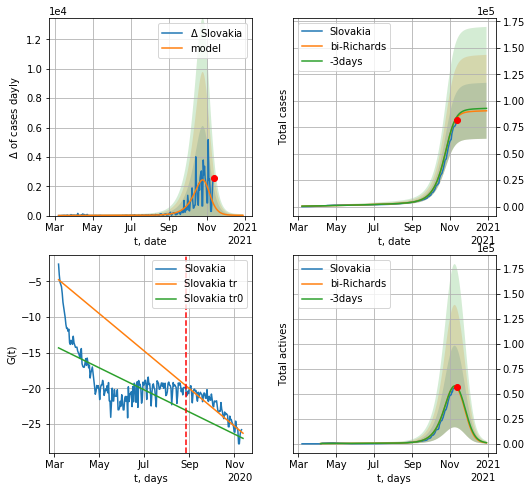

Slovakia data at: 2020-11-12
+3 day model MAPE: 0.010116
model: bi-Richards
coeffs: [8.49858692e+04 7.43151587e-02 2.29142696e+02 1.97522595e+00]
rational stdev: 0.291865
forecast at the end of period: +51 days
	 deltaDaycases: 17
	 total cases: 90472 ± 26405
	 total death: 513 ± 449
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.409514
 intercept: -14.319098
 slope: -0.050535
trend coefficient of determination: 0.852937
 intercept: -4.764058
 slope: -0.085735


In [1486]:
vL = 170
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovakia",dfSL[:],d12f(1),40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.875)

In [1330]:
#x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1331]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
#try:
#    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
#    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
#except:
#    print ("Exception occurs")

SV
           date    cases   active  death
248 2020-11-08  45161.0  22164.0  554.0
249 2020-11-09  45625.0  21514.0  578.0
250 2020-11-10  46717.0  21105.0  605.0
251 2020-11-11  48939.0  20717.0  645.0
252 2020-11-12  50870.0  20157.0  686.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


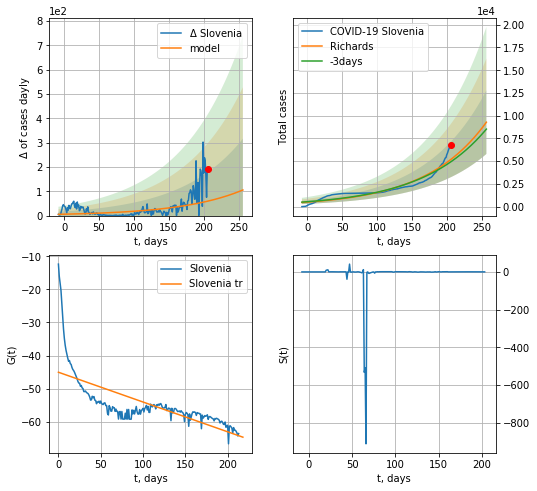

Slovenia data at: 2020-11-12
+3 day model MAPE: 0.053302
model: Richards
coeffs: [5.33121990e+04 1.14026926e-02 4.10279311e+02 6.80297430e+00]
rational stdev: 0.376258
forecast at the end of period: +51 days
	 deltaDaycases: 105
	 total cases: 9284 ± 3493
	 total death: 125 ± 141
trend coefficient of determination: 0.495384
 intercept: -45.035075
 slope: -0.089994


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


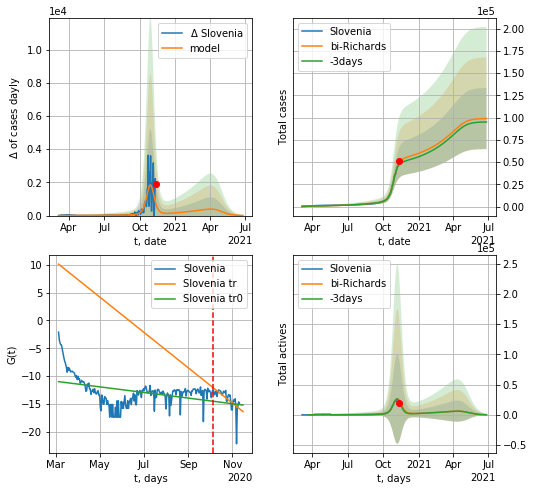

Slovenia data at: 2020-11-12
+3 day model MAPE: 0.037533
model: bi-Richards
coeffs: [4.56405597e+04 1.48275007e-01 2.30327017e+02 1.06955096e+00]
rational stdev: 0.346998
forecast at the end of period: +226 days
	 deltaDaycases: 6
	 total cases: 98876 ± 34310
	 total death: 1333 ± 1387
bi-Richards approximation splitting point: 215
trend coefficient of determination: 0.159291
 intercept: -11.000812
 slope: -0.016450
trend coefficient of determination: 0.408268
 intercept: 10.127472
 slope: -0.103564


In [1487]:
vL = 215
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Slovenia",dfSV[:],d12f(1),65*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)

In [1333]:
#print(koreaCoeffs)
#x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases   active  death
243 2020-11-08  62747  30321.0  890.0
244 2020-11-09  64065  31628.0  901.0
245 2020-11-10  66888  34437.0  915.0
246 2020-11-11  70424  37952.0  936.0
247 2020-11-12  73765  41274.0  955.0


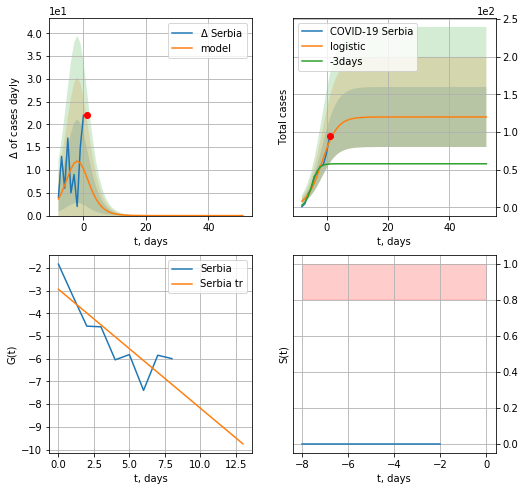

Serbia data at: 2020-11-12
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  1 ± 0
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:196: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


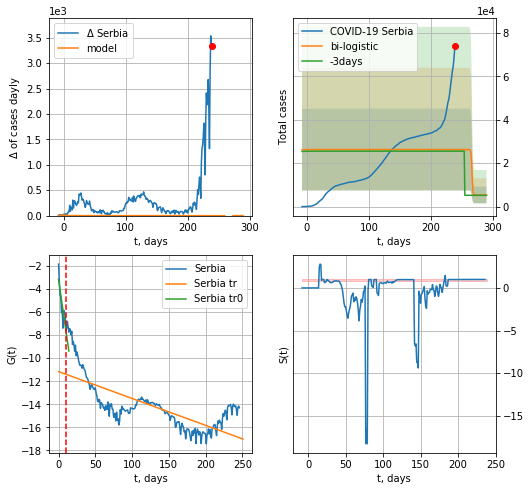

Serbia data at: 2020-11-12
+3 day model MAPE: 0.029557847654824877
model: bi-logistic
coeffs:  [ 2.09335984e+04 -1.43873002e+00  2.66532951e+02] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.7163393257335372
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  5353 ± 3834
	 total death:  69 ± 148
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.538465
 intercept: -11.160484
 slope: -0.023324


In [1334]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


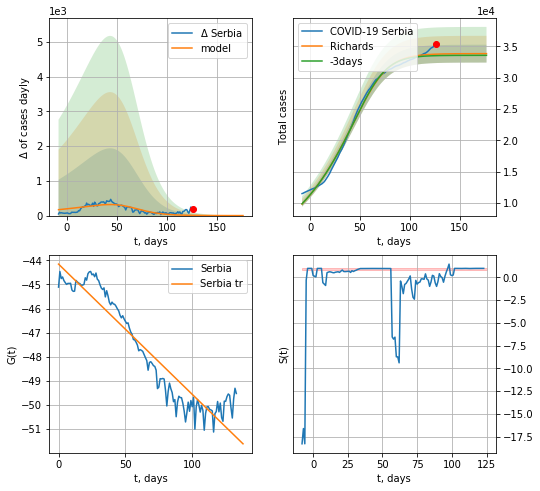

Serbia data at: 2020-11-12
+3 day model MAPE: 0.007213
model: Richards
coeffs: [3.38502992e+04 1.71762320e-02 6.37510211e+01 4.23525933e+00]
rational stdev: 0.042000
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 33848 ± 1421
	 total death: 438 ± 55
trend coefficient of determination: 0.897677
 intercept: -44.154427
 slope: -0.054115


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


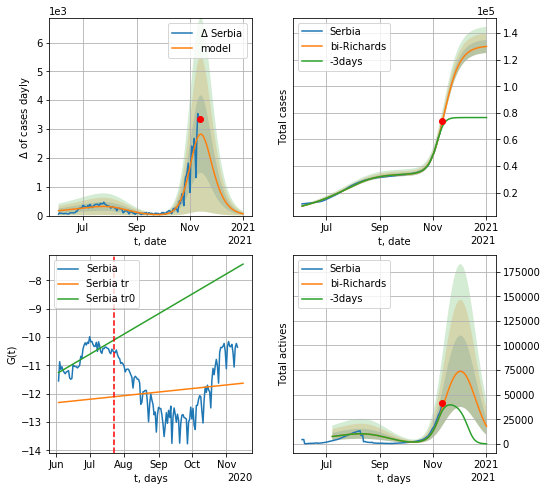

Serbia data at: 2020-11-12
+3 day model MAPE: 0.071522
model: bi-Richards
coeffs: [9.66478359e+04 1.60734062e-01 1.51748989e+02 6.48230606e-01]
rational stdev: 0.037687
forecast at the end of period: +51 days
	 deltaDaycases: 63
	 total cases: 129920 ± 4896
	 total death: 1682 ± 190
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.582102
 intercept: -11.254551
 slope: 0.023063
trend coefficient of determination: 0.018326
 intercept: -12.310457
 slope: 0.004105


In [1335]:
iL=85
vL=50+iL
x = forecastRR("Serbia",dfSB[iL:vL+iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Serbia",dfSB[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1336]:
#x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1337]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    #x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    #xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

CT
           date    cases   active  death
253 2020-11-08  68007.0  15678.0  794.0
254 2020-11-09  68776.0  14942.0  832.0
255 2020-11-10  70243.0  14524.0  865.0
256 2020-11-11  72840.0  15513.0  893.0
257 2020-11-12  75922.0  16348.0  925.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


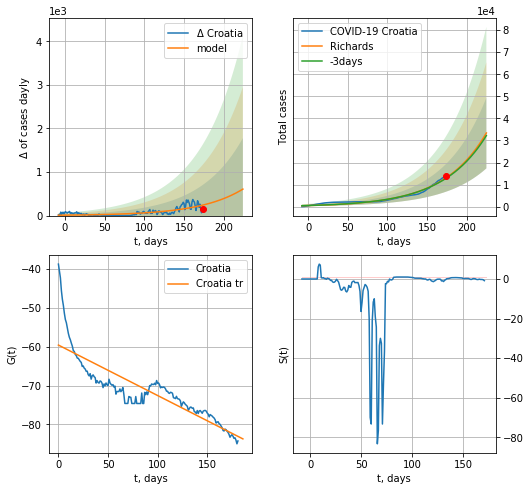

Croatia data at: 2020-11-12
+3 day model MAPE: 0.018027
model: Richards
coeffs: [1.05375743e+05 1.83779062e-02 2.87513636e+02 8.37165434e+00]
rational stdev: 0.479243
forecast at the end of period: +51 days
	 deltaDaycases: 608
	 total cases: 33403 ± 16008
	 total death: 406 ± 583
trend coefficient of determination: 0.727056
 intercept: -59.566484
 slope: -0.130027


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


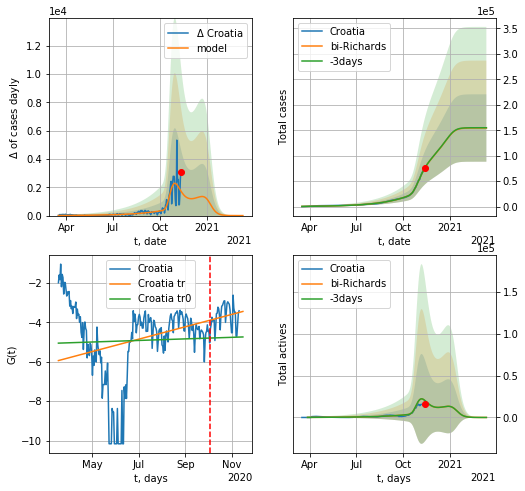

Croatia data at: 2020-11-12
+3 day model MAPE: 0.002821
model: bi-Richards
coeffs: [4.91111231e+04 5.05999508e+00 1.77992508e+02 1.90819663e-02]
rational stdev: 0.428564
forecast at the end of period: +121 days
	 deltaDaycases: 0
	 total cases: 154486 ± 66207
	 total death: 1882 ± 2419
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.001376
 intercept: -5.058460
 slope: 0.001287
trend coefficient of determination: 0.037974
 intercept: -5.943193
 slope: 0.010219


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power


In [1488]:
iL = 17
vL = 200+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Croatia",dfCT[iL:],d12f(1),50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)

In [1339]:
#x = forecastRRR("Croatia",dfCT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)

In [1340]:
dfEG = read_df(pd.DataFrame(),"EG")
#x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
#xx = forecast2("Egypt",dfEG[:],d1,30*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

EG
           date   cases  active   death
247 2020-11-08  109201    2491  6368.0
248 2020-11-09  109422    2603  6380.0
249 2020-11-10  109654    2720  6394.0
250 2020-11-11  109881    2814  6405.0
251 2020-11-12  110095    2918  6417.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


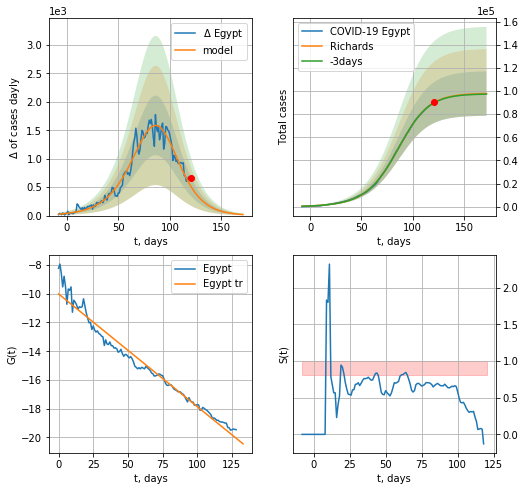

Egypt data at: 2020-11-12
+3 day model MAPE: 0.002349
model: Richards
coeffs: [9.80452652e+04 5.49784423e-02 9.01515288e+01 1.27472002e+00]
rational stdev: 0.196169
forecast at the end of period: +51 days
	 deltaDaycases: 17
	 total cases: 97797 ± 19184
	 total death: 5700 ± 3354
trend coefficient of determination: 0.969341
 intercept: -10.012670
 slope: -0.078415


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


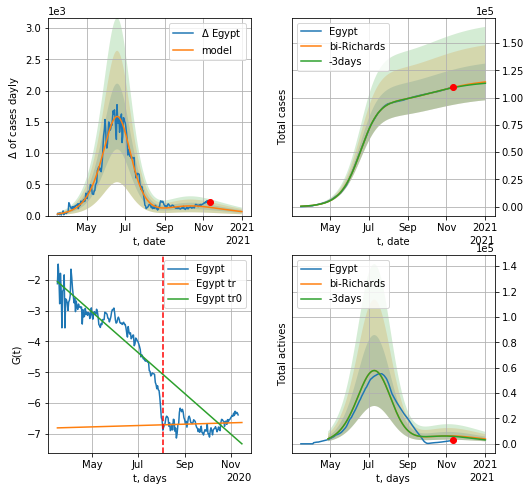

Egypt data at: 2020-11-12
+3 day model MAPE: 0.002991
model: bi-Richards
coeffs: [ 1.95267044e+04  1.73993488e+00 -9.69174806e-01  1.23033468e-02]
rational stdev: 0.147012
forecast at the end of period: +51 days
	 deltaDaycases: 63
	 total cases: 114322 ± 16806
	 total death: 6663 ± 2938
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.799202
 intercept: -2.055717
 slope: -0.021506
trend coefficient of determination: 0.008508
 intercept: -6.806978
 slope: 0.000710


In [1490]:
iL = 10
vL = 140+iL
x = forecastRR("Egypt",dfEG[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Egypt",dfEG[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=1.25)

In [1342]:
#x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active    death
250 2020-11-08  498549  58294.0  11327.0
251 2020-11-09  501733  58120.0  11380.0
252 2020-11-10  505310  59213.0  11432.0
253 2020-11-11  508508  60369.0  11482.0
254 2020-11-12  511806  61046.0  11532.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


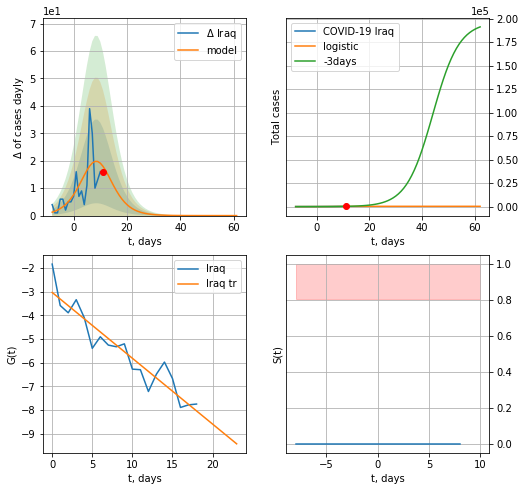

Iraq data at: 2020-11-12
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  317 ± 65
	 total death:  7 ± 4
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


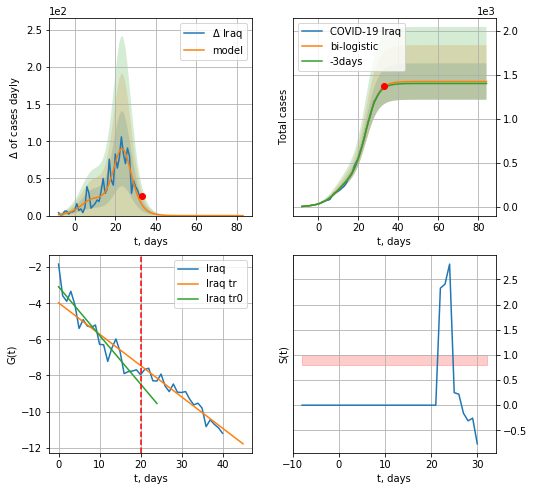

Iraq data at: 2020-11-12
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  32 ± 13
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:354: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


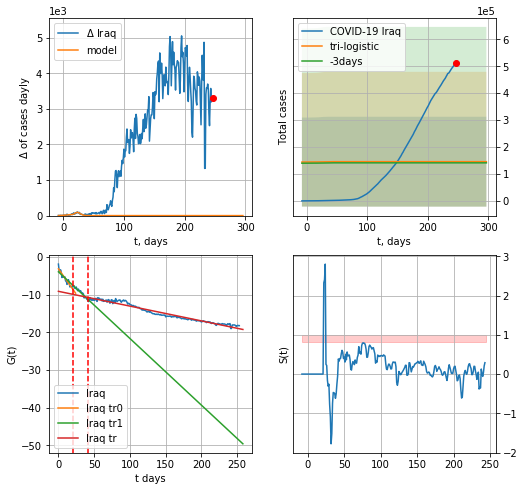

Iraq data at: 2020-11-12
+3 day model MAPE: 0.03057670014134367
model: tri-logistic
coeffs:  [ 1.44194587e+05 -1.32392083e+01  3.22858150e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  1.145901710428667
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  145620 ± 166866
	 total death:  3281 ± 11279
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.958653
 intercept: -9.062416
 slope: -0.039289


In [1343]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


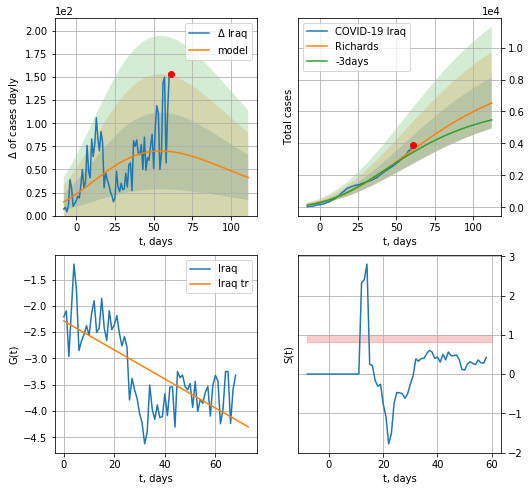

Iraq data at: 2020-11-12
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +51 days
	 deltaDaycases: 41
	 total cases: 6528 ± 1586
	 total death: 147 ± 107
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


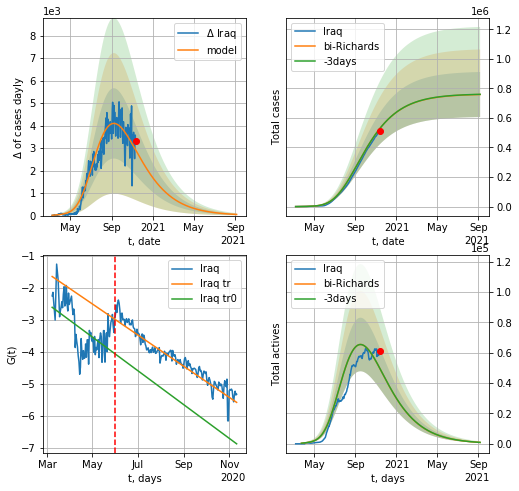

Iraq data at: 2020-11-12
+3 day model MAPE: 0.000177
model: bi-Richards
coeffs: [ 7.52872865e+05  6.92205558e-01 -8.22110792e+01  2.15319054e-02]
rational stdev: 0.201124
forecast at the end of period: +303 days
	 deltaDaycases: 49
	 total cases: 758218 ± 152495
	 total death: 17084 ± 10307
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.286894
 intercept: -2.610963
 slope: -0.017206
trend coefficient of determination: 0.926261
 intercept: -1.648758
 slope: -0.015861


In [1491]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Iraq",dfIQ[iL:],d1,76*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [1345]:
#x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
#xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [1346]:
#len(dfAR)

AR
           date    cases   active   death
249 2020-11-08  62051.0  17966.0  2048.0
250 2020-11-09  62693.0  18306.0  2062.0
251 2020-11-10  63446.0  18743.0  2077.0
252 2020-11-11  64257.0  19184.0  2093.0
253 2020-11-12  65108.0  20017.0  2111.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


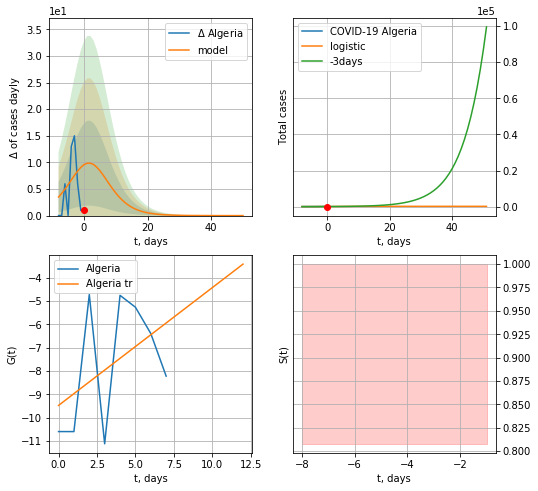

Algeria data at: 2020-11-12
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  5 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


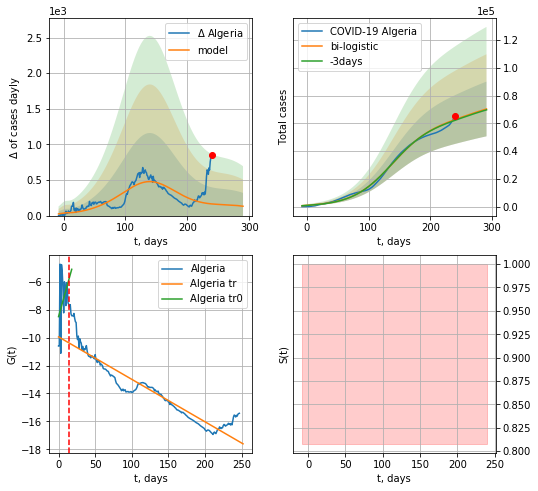

Algeria data at: 2020-11-12
+3 day model MAPE: 0.008393543889914654
model: bi-logistic
coeffs:  [6.15578687e+04 3.06181464e-02 1.38936524e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2800683738616756
forecast at the end of period: +51 days
	 deltaDaycases:  131
	 total cases:  70368 ± 19707
	 total death:  2281 ± 1916
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.875016
 intercept: -9.943572
 slope: -0.030416


In [1347]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


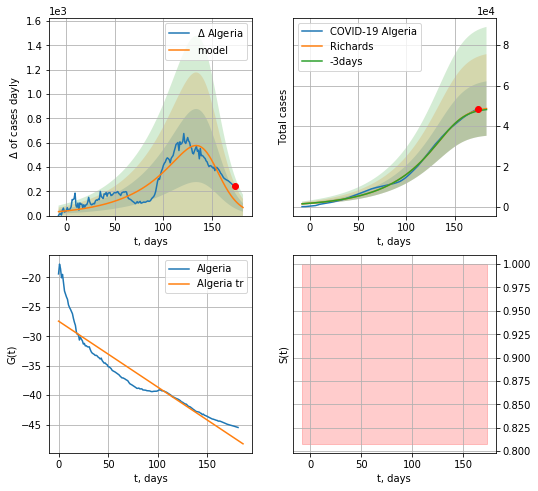

Algeria data at: 2020-11-12
+3 day model MAPE: 0.008153
model: Richards
coeffs: [4.93857112e+04 2.24652282e-02 1.49911075e+02 3.72492228e+00]
rational stdev: 0.277282
forecast at the end of period: +9 days
	 deltaDaycases: 66
	 total cases: 48585 ± 13471
	 total death: 1575 ± 1310
trend coefficient of determination: 0.867745
 intercept: -27.438960
 slope: -0.111955


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


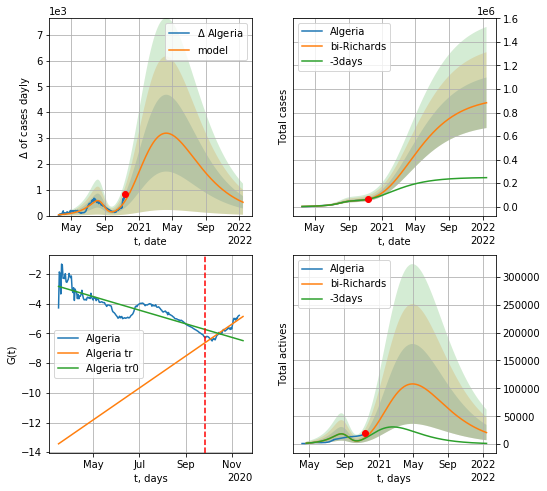

Algeria data at: 2020-11-12
+3 day model MAPE: 0.016226
model: bi-Richards
coeffs: [8.86987041e+05 2.51825335e-01 5.89171035e+01 3.95820995e-02]
rational stdev: 0.243431
forecast at the end of period: +429 days
	 deltaDaycases: 515
	 total cases: 883184 ± 214994
	 total death: 28635 ± 20911
bi-Richards approximation splitting point: 195
trend coefficient of determination: 0.738610
 intercept: -2.825655
 slope: -0.014922
trend coefficient of determination: 0.863643
 intercept: -13.436243
 slope: 0.035029


In [1348]:
vL = 195+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Algeria",dfAR[12:],d1,94*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

In [1349]:
#x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
241 2020-11-08  5987.0  4077.0   28.0
242 2020-11-09  6098.0  4188.0   28.0
243 2020-11-10  6296.0  4385.0   29.0
244 2020-11-11  6461.0  4546.0   33.0
245 2020-11-12  6646.0  4730.0   34.0


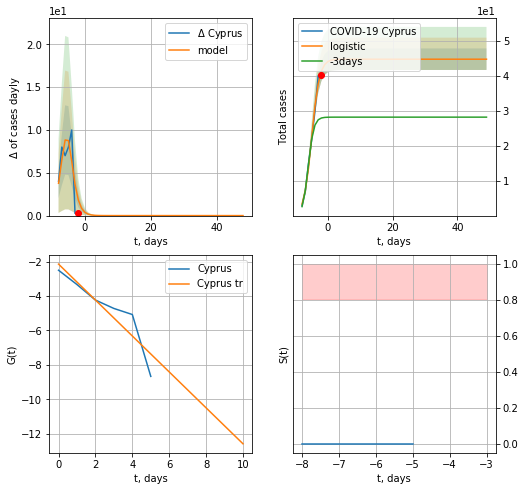

Cyprus data at: 2020-11-12
+3 day model MAPE: 0.5347775670777937
model: logistic
coeffs:  [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.06852146203610965
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  44 ± 3
	 total death:  0 ± 0
trend coefficient of determination: 0.837222
 intercept: -2.149855
 slope: -1.042802


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


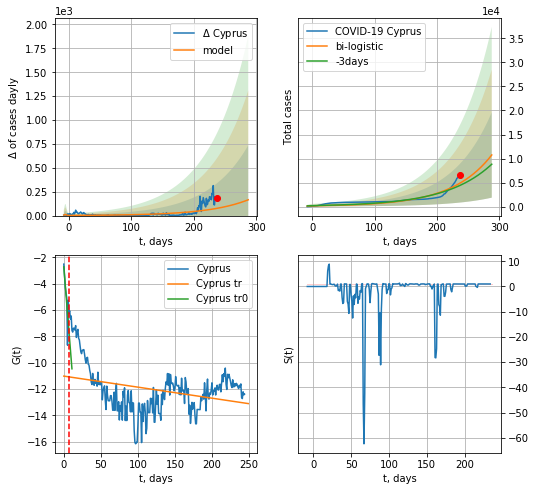

Cyprus data at: 2020-11-12
+3 day model MAPE: 0.10869133944125184
model: bi-logistic
coeffs:  [5.08932710e+07 1.55807917e-02 8.31414873e+02] [44.71273924  0.83168064 -5.024159  ]
rational stdev:  0.8261578344845435
forecast at the end of period: +51 days
	 deltaDaycases:  165
	 total cases:  10746 ± 8878
	 total death:  54 ± 133
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.605369
 intercept: -2.714226
 slope: -0.704180
trend coefficient of determination: 0.102479
 intercept: -11.015032
 slope: -0.008384


In [1350]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


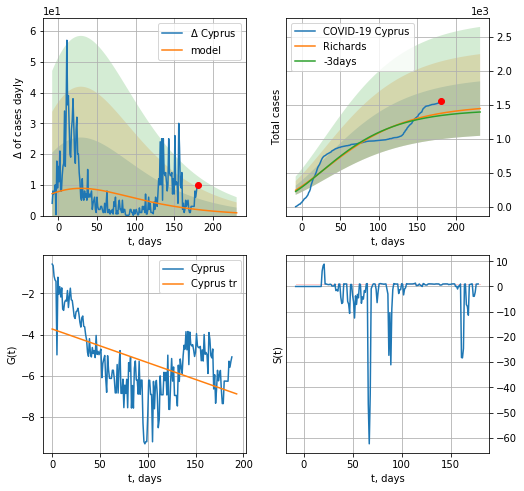

Cyprus data at: 2020-11-12
+3 day model MAPE: 0.024435
model: Richards
coeffs: [ 1.50521752e+03  2.72486761e+00 -2.90172794e+02  5.89172949e-03]
rational stdev: 0.277159
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1447 ± 401
	 total death: 7 ± 5
trend coefficient of determination: 0.254348
 intercept: -3.732430
 slope: -0.016375


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


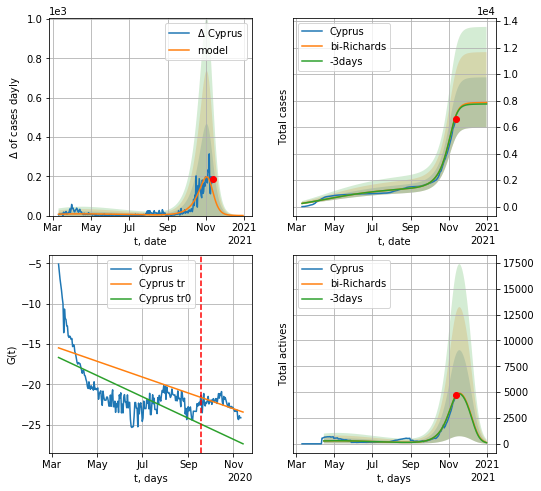

Cyprus data at: 2020-11-12
+3 day model MAPE: 0.003311
model: bi-Richards
coeffs: [6.37364788e+03 7.37568564e-02 2.34296488e+02 2.33420958e+00]
rational stdev: 0.242205
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 7855 ± 1902
	 total death: 40 ± 29
bi-Richards approximation splitting point: 190
trend coefficient of determination: 0.455521
 intercept: -16.665301
 slope: -0.042933
trend coefficient of determination: 0.376993
 intercept: -15.474075
 slope: -0.031922


In [1351]:
iL = 0
vL=190+iL
x = forecastRR("Cyprus",dfCP[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RRD("Cyprus",dfCP[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [1352]:
#vL=33
#x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
246 2020-11-08  922333  43854.0  34879.0
247 2020-11-09  923527  40238.0  34943.0
248 2020-11-10  925431  39769.0  34992.0
249 2020-11-11  928006  39767.0  35031.0
250 2020-11-12  930237  39147.0  35067.0


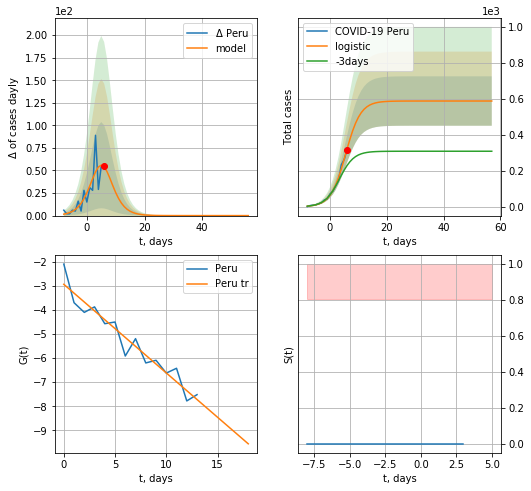

Peru data at: 2020-11-12
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  22 ± 15
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


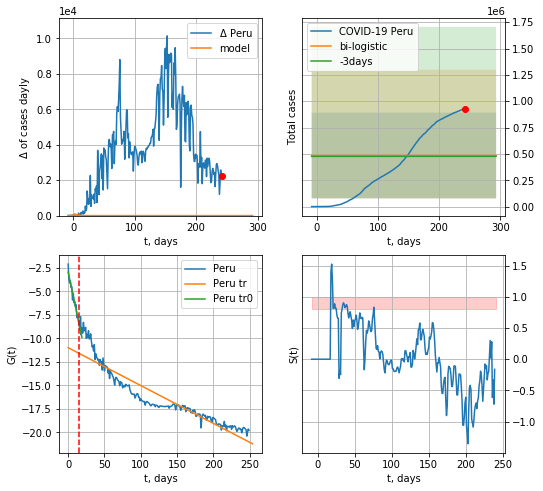

Peru data at: 2020-11-12
+3 day model MAPE: 0.01710594405633153
model: bi-logistic
coeffs:  [ 3.87668494e+05 -4.38019727e+01  1.04532351e+03] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.8380451834965913
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  485174 ± 406598
	 total death:  18289 ± 45981
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.859561
 intercept: -10.988377
 slope: -0.040220


In [1353]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


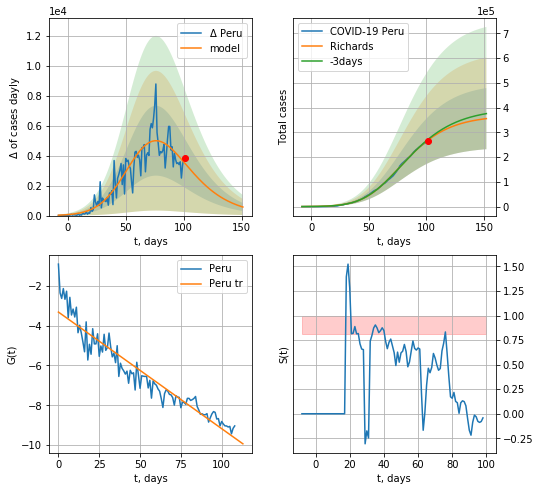

Peru data at: 2020-11-12
+3 day model MAPE: 0.011915
model: Richards
coeffs: [3.68474787e+05 1.13868989e-01 5.48653842e+01 3.85481107e-01]
rational stdev: 0.347400
forecast at the end of period: +51 days
	 deltaDaycases: 573
	 total cases: 355357 ± 123451
	 total death: 13395 ± 13960
trend coefficient of determination: 0.910589
 intercept: -3.314617
 slope: -0.058598


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


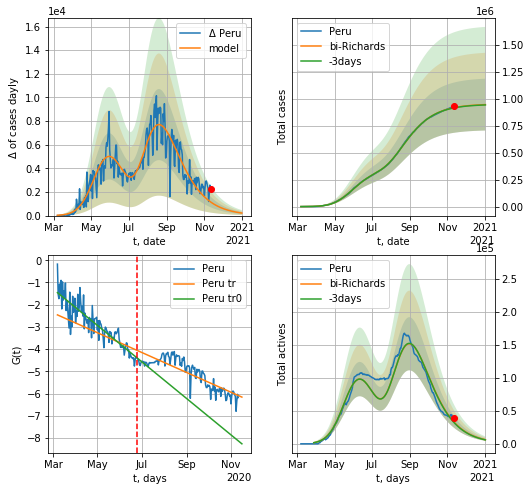

Peru data at: 2020-11-12
+3 day model MAPE: 0.002245
model: bi-Richards
coeffs: [5.83362907e+05 3.19373007e+00 2.65321766e+01 1.06761120e-02]
rational stdev: 0.253886
forecast at the end of period: +51 days
	 deltaDaycases: 213
	 total cases: 945653 ± 240087
	 total death: 35648 ± 27151
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.801752
 intercept: -1.457936
 slope: -0.026782
trend coefficient of determination: 0.733531
 intercept: -2.459187
 slope: -0.014566


In [1494]:
vL = 110
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.625)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

In [1355]:
#x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active     death
253 2020-11-08  8555109  511065.0  126671.0
254 2020-11-09  8591730  505220.0  127104.0
255 2020-11-10  8636011  494613.0  127615.0
256 2020-11-11  8684039  491326.0  128165.0
257 2020-11-12  8728795  484529.0  128686.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


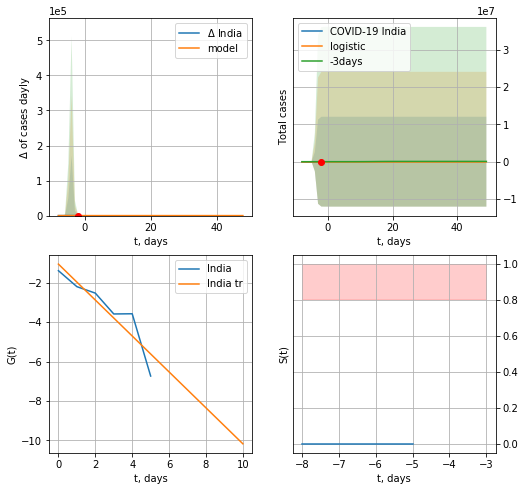

India data at: 2020-11-12
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


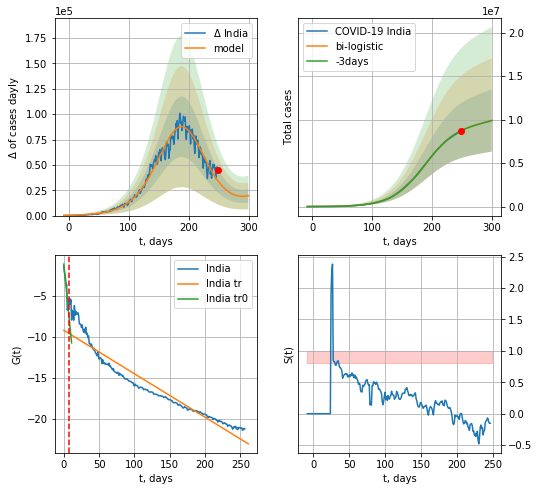

India data at: 2020-11-12
+3 day model MAPE: 0.001536189434763565
model: bi-logistic
coeffs:  [9.60895590e+06 3.63664920e-02 1.88312262e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.36133069235648385
forecast at the end of period: +51 days
	 deltaDaycases:  19488
	 total cases:  9915108 ± 3582632
	 total death:  146175 ± 158452
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.912453
 intercept: -9.196762
 slope: -0.053131


In [1356]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

In [1357]:
dfID.head()

,date,cases,active,death
0,2020-01-30,1,0.0,0.0
1,2020-02-02,2,0.0,0.0
2,2020-02-04,3,0.0,0.0
3,2020-03-03,5,0.0,0.0
4,2020-03-04,6,0.0,0.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


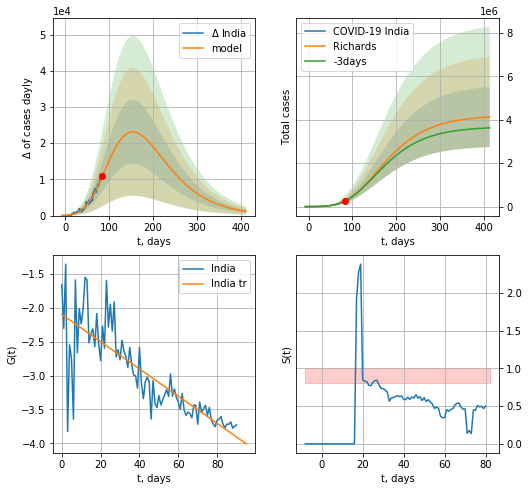

India data at: 2020-11-12
+3 day model MAPE: 0.006742
model: Richards
coeffs: [ 4.20225634e+06  3.29565236e-01 -4.59203879e+01  4.64727771e-02]
rational stdev: 0.335203
forecast at the end of period: +331 days
	 deltaDaycases: 1193
	 total cases: 4124123 ± 1382416
	 total death: 60800 ± 61140
trend coefficient of determination: 0.670933
 intercept: -2.097175
 slope: -0.020112


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


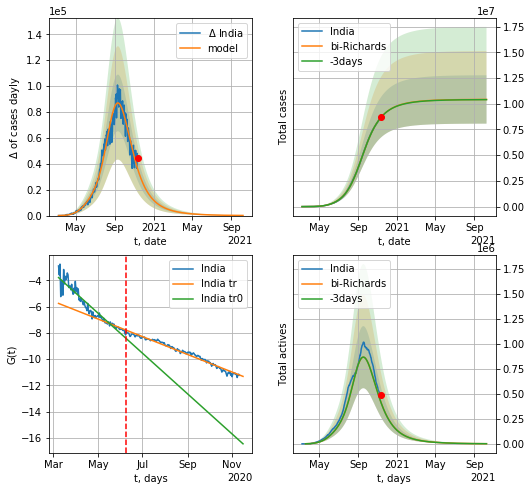

India data at: 2020-11-12
+3 day model MAPE: 0.000678
model: bi-Richards
coeffs: [6.22088284e+06 9.05596734e-02 1.51146847e+02 3.72024678e-01]
rational stdev: 0.225626
forecast at the end of period: +331 days
	 deltaDaycases: 108
	 total cases: 10416116 ± 2350148
	 total death: 153561 ± 103942
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.908765
 intercept: -3.776634
 slope: -0.050090
trend coefficient of determination: 0.978507
 intercept: -5.746503
 slope: -0.021987


In [1495]:
vL = 100
x = forecastRR("India",dfID[8:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD("India",dfID[8:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=1./3.)

In [1359]:
#x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date      cases    active    death
249 2020-11-08  1242182.0  145711.0  33560.0
250 2020-11-09  1250499.0  143015.0  33907.0
251 2020-11-10  1262476.0  146396.0  34183.0
252 2020-11-11  1273356.0  156928.0  34531.0
253 2020-11-12  1284519.0  149557.0  34782.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


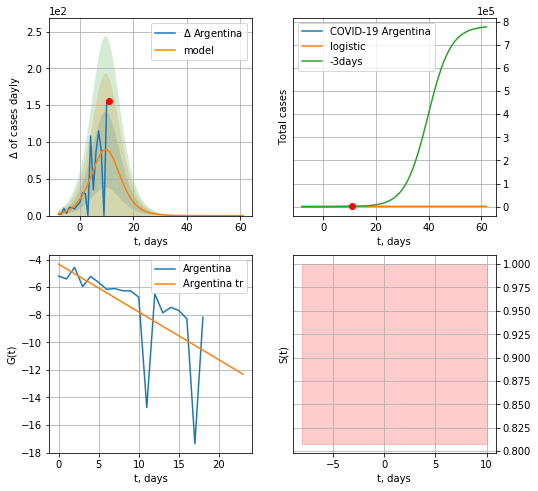

Argentina data at: 2020-11-12
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  1306 ± 362
	 total death:  35 ± 29
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:238: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


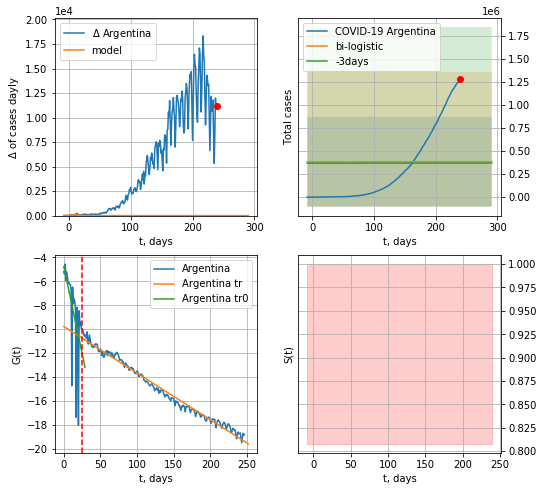

Argentina data at: 2020-11-12
+3 day model MAPE: 0.03979469827173734
model: bi-logistic
coeffs:  [ 3.06616735e+05 -2.53124071e+01  6.07101619e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2665039935516456
forecast at the end of period: +51 days
	 deltaDaycases:  0
	 total cases:  384576 ± 487068
	 total death:  10413 ± 39564
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.984868
 intercept: -9.776357
 slope: -0.038877


In [1360]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


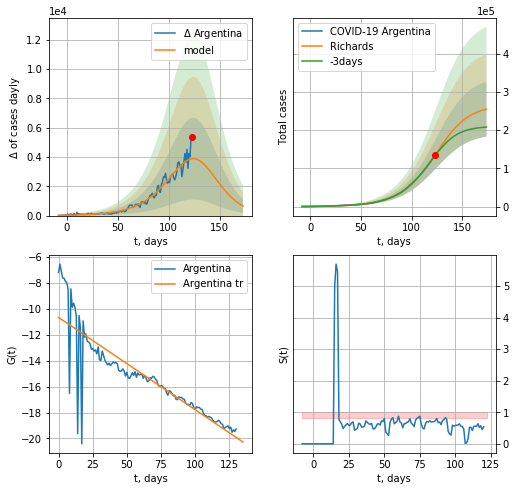

Argentina data at: 2020-11-12
+3 day model MAPE: 0.019206
model: Richards
coeffs: [2.65005155e+05 4.79026563e-02 1.29327238e+02 1.35592311e+00]
rational stdev: 0.281344
forecast at the end of period: +51 days
	 deltaDaycases: 654
	 total cases: 254756 ± 71674
	 total death: 6898 ± 5822
trend coefficient of determination: 0.758651
 intercept: -10.677920
 slope: -0.071075


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


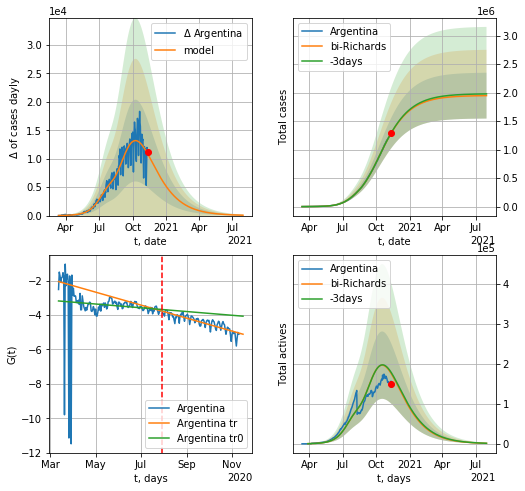

Argentina data at: 2020-11-12
+3 day model MAPE: 0.003237
model: bi-Richards
coeffs: [1.68473934e+06 8.59706768e-01 3.14346478e+01 2.48675196e-02]
rational stdev: 0.206426
forecast at the end of period: +261 days
	 deltaDaycases: 68
	 total cases: 1946592 ± 401826
	 total death: 52709 ± 32641
bi-Richards approximation splitting point: 140
trend coefficient of determination: 0.013273
 intercept: -3.181558
 slope: -0.003550
trend coefficient of determination: 0.750518
 intercept: -2.054656
 slope: -0.012284


In [1498]:
vL = 140+8#38
x = forecastRR('Argentina',dfAG[8:vL-8].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Argentina',dfAG[8:].fillna(0),d1,70*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8,amc=0.475)

In [1362]:
#x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

In [1363]:
#vL=33
#x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
#xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

QR
           date   cases  active  death
248 2020-11-08  134203  2695.0  232.0
249 2020-11-09  134433  2711.0  232.0
250 2020-11-10  134663  2697.0  233.0
251 2020-11-11  134887  2728.0  233.0
252 2020-11-12  135132  2745.0  234.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


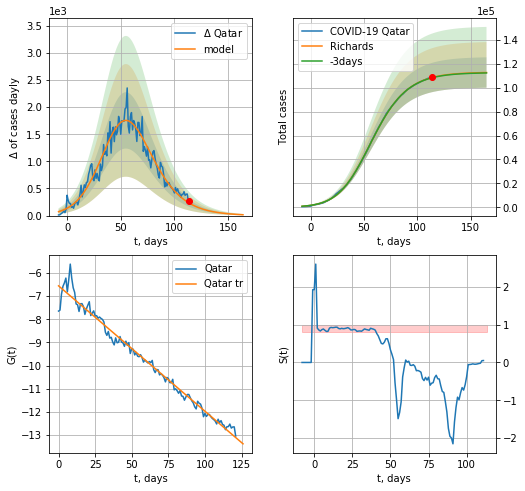

Qatar data at: 2020-11-12
+3 day model MAPE: 0.001883
model: Richards
coeffs: [1.13070089e+05 8.99170413e-02 4.60810469e+01 6.06536184e-01]
rational stdev: 0.112907
forecast at the end of period: +51 days
	 deltaDaycases: 15
	 total cases: 112786 ± 12734
	 total death: 195 ± 66
trend coefficient of determination: 0.979229
 intercept: -6.558422
 slope: -0.054146


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


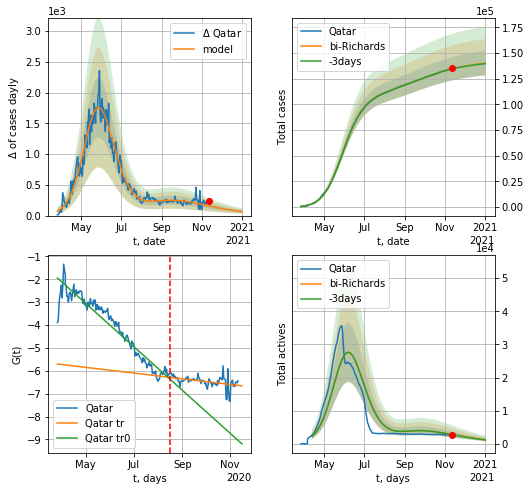

Qatar data at: 2020-11-12
+3 day model MAPE: 0.001258
model: bi-Richards
coeffs: [ 3.01179895e+04  2.02702953e+00 -3.84189723e+01  1.06226924e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.084150
forecast at the end of period: +51 days
	 deltaDaycases: 65
	 total cases: 139977 ± 11779
	 total death: 242 ± 61
bi-Richards approximation splitting point: 144
trend coefficient of determination: 0.918334
 intercept: -1.941955
 slope: -0.030859
trend coefficient of determination: 0.169582
 intercept: -5.704798
 slope: -0.004059


In [1499]:
iL = 21
vL = 144 + iL
dfQR = read_df(pd.DataFrame(),"QR")
x = forecastRR('Qatar',dfQR[iL:vL-iL].fillna(0),d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Qatar',dfQR[iL:].fillna(0),d12f(1),40*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

In [1365]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date     cases  active  death
267 2020-11-08  143289.0    3815  515.0
268 2020-11-09  143835.0    3815  515.0
269 2020-11-10  144385.0    4166  518.0
270 2020-11-11  145599.0    4637  520.0
271 2020-11-12  146735.0    4997  523.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


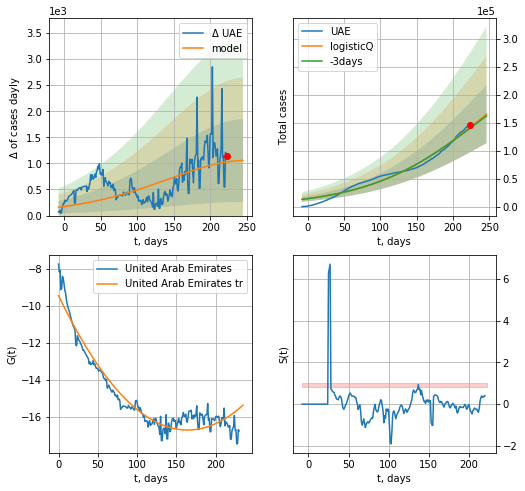

UAE data at: 2020-11-12
+3 day model MAPE: 0.011295
model: logisticQ
coeffs: [ 3.38930486e+05  1.16441737e-07  2.50005374e+02 -1.06621132e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.313615
forecast at the end of period: +23 days
	 deltaDaycases: 1057
	 total cases: 165856 ± 52015
	 total death: 591 ± 556
trend coefficient of determination: 0.928941
 intercept_: -9.43873617787038
 coeffs_: [ 0.         -0.08849338  0.00026936]


In [1366]:
try:
    dfUAE = read_df(pd.DataFrame(),"UAE")
    x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


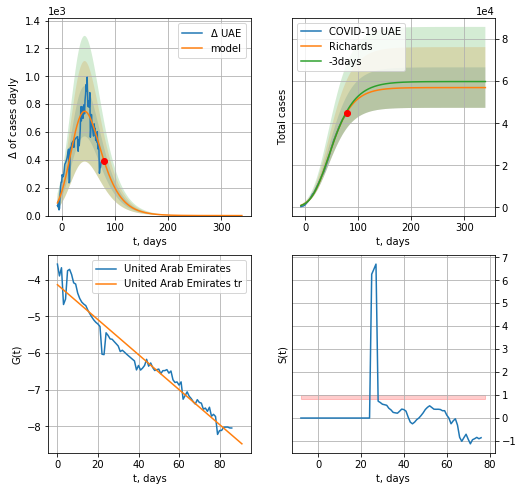

UAE data at: 2020-11-12
+3 day model MAPE: 0.009891
model: Richards
coeffs: [5.69575832e+04 1.33404785e-01 1.50634020e+01 3.08321872e-01]
rational stdev: 0.168958
forecast at the end of period: +261 days
	 deltaDaycases: 0
	 total cases: 56957 ± 9623
	 total death: 203 ± 102
trend coefficient of determination: 0.950927
 intercept: -4.139656
 slope: -0.047646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


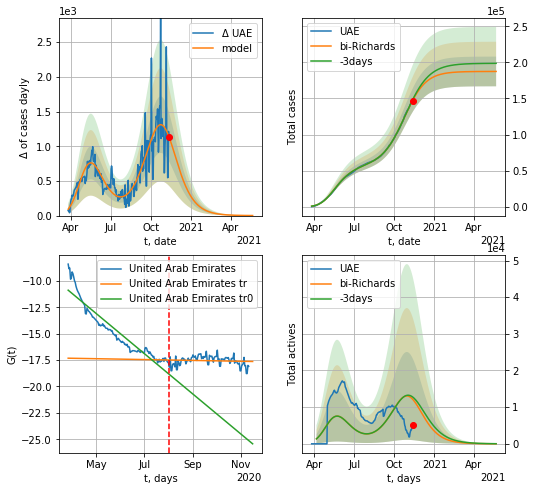

UAE data at: 2020-11-12
+3 day model MAPE: 0.006222
model: bi-Richards
coeffs: [1.30500184e+05 3.72911517e-02 2.06318601e+02 1.11148969e+00]
rational stdev: 0.109663
forecast at the end of period: +191 days
	 deltaDaycases: 0
	 total cases: 187436 ± 20554
	 total death: 668 ± 219
bi-Richards approximation splitting point: 128
trend coefficient of determination: 0.898216
 intercept: -10.871909
 slope: -0.061964
trend coefficient of determination: 0.007716
 intercept: -17.318875
 slope: -0.001323


In [1500]:
iL = 40
vL = 128 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('UAE',dfUAE[iL:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.33)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [1368]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

In [1369]:
dfSA = read_df(pd.DataFrame(),"SA")
#x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

SA
           date     cases  active   death
250 2020-11-08  350592.0    7666  5540.0
251 2020-11-09  350984.0    7637  5559.0
252 2020-11-10  351455.0    7598  5576.0
253 2020-11-11  351849.0    7557  5590.0
254 2020-11-12  352160.0    7441  5605.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


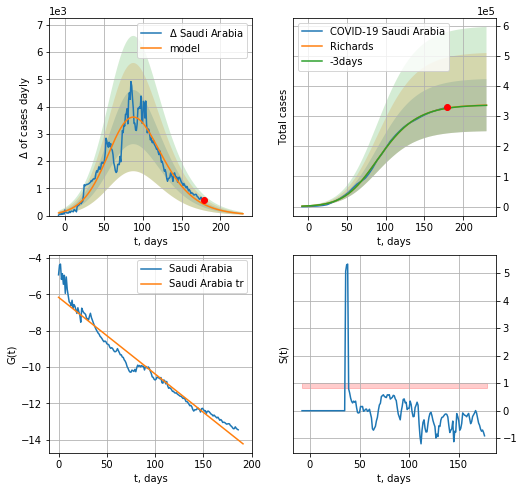

Saudi Arabia data at: 2020-11-12
+3 day model MAPE: 0.001288
model: Richards
coeffs: [3.38127321e+05 6.59352178e-02 7.28001513e+01 5.59722104e-01]
rational stdev: 0.257065
forecast at the end of period: +51 days
	 deltaDaycases: 68
	 total cases: 336308 ± 86453
	 total death: 5352 ± 4127
trend coefficient of determination: 0.960421
 intercept: -6.158396
 slope: -0.042260


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


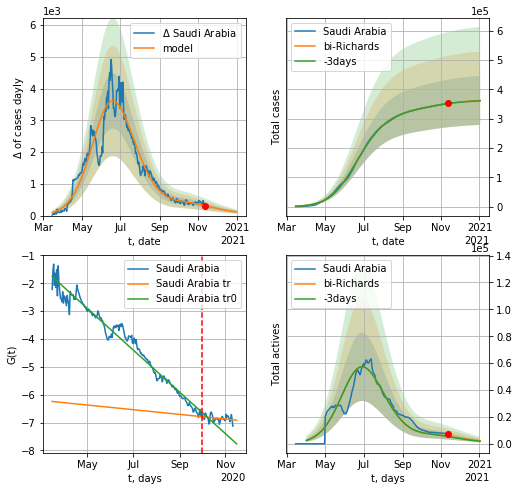

Saudi Arabia data at: 2020-11-12
+3 day model MAPE: 0.001025
model: bi-Richards
coeffs: [2.83023465e+04 3.55070462e+00 3.71868426e+01 7.63360754e-03]
rational stdev: 0.230732
forecast at the end of period: +51 days
	 deltaDaycases: 113
	 total cases: 362042 ± 83534
	 total death: 5762 ± 3988
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.970383
 intercept: -1.756132
 slope: -0.024421
trend coefficient of determination: 0.080871
 intercept: -6.242559
 slope: -0.002731


In [1501]:
iL = 12
vL = 200 + iL
x = forecastRR('Saudi Arabia',dfSA[iL:vL-iL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Saudi Arabia',dfSA[iL:],d1,T18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [1371]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    #x = forecastRRR('Sri Lanka',dfSri[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    #xx = forecast2RRR('Sri Lanka',dfSri[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

Sri
           date    cases  active  death
243 2020-11-08  13929.0    5609   35.0
244 2020-11-09  14285.0    5369   36.0
245 2020-11-10  14715.0    5137   41.0
246 2020-11-11  15350.0    5121   46.0
247 2020-11-12  15723.0    5022   48.0


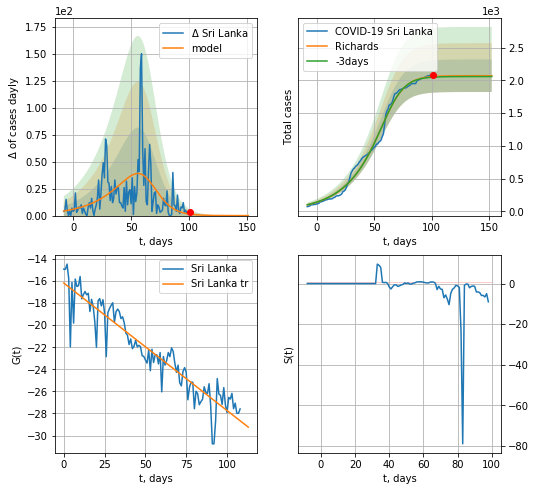

Sri Lanka data at: 2020-11-12
+3 day model MAPE: 0.004977
model: Richards
coeffs: [2.07051731e+03 4.15080701e-02 6.51914811e+01 2.75459097e+00]
rational stdev: 0.119919
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 2070 ± 248
	 total death: 6 ± 2
trend coefficient of determination: 0.877174
 intercept: -16.184142
 slope: -0.115477


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


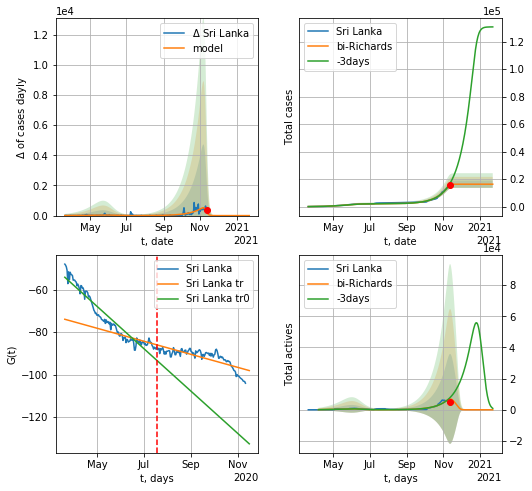

Sri Lanka data at: 2020-11-12
+3 day model MAPE: 0.087216
model: bi-Richards
coeffs: [1.42959219e+04 5.04713493e-02 2.28388370e+02 1.03799869e+01]
rational stdev: 0.162764
forecast at the end of period: +72 days
	 deltaDaycases: 0
	 total cases: 16366 ± 2663
	 total death: 49 ± 23
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.920212
 intercept: -54.218402
 slope: -0.324956
trend coefficient of determination: 0.624727
 intercept: -73.975543
 slope: -0.100076


In [1502]:
vL=130#88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Sri Lanka',dfSri[10:],d1,43*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10,amc=0.5)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
255 2020-11-08  344839.0   18981  6977.0
256 2020-11-09  346476.0   20045  7000.0
257 2020-11-10  348184.0   21098  7021.0
258 2020-11-11  349992.0   22088  7055.0
259 2020-11-12  352296.0   23641  7092.0


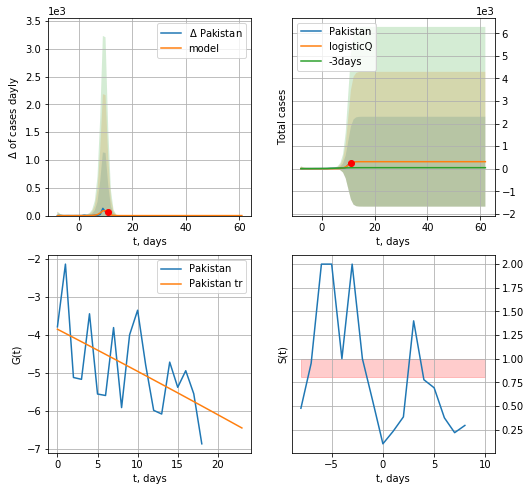

Pakistan data at: 2020-11-12
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


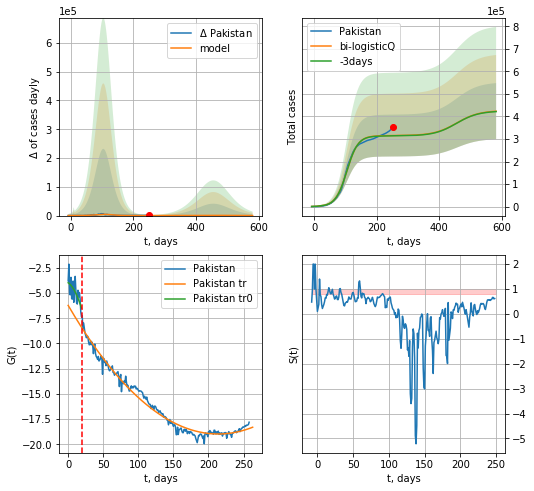

Pakistan data at: 2020-11-12
+3 day model MAPE: 0.004623
model: bi-logisticQ
coeffs: [ 3.14649700e+05  1.08151590e-07  1.04567247e+02 -5.13549918e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294606
forecast at the end of period: +331 days
	 deltaDaycases: 87
	 total cases: 423219 ± 124683
	 total death: 8519 ± 7529
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.981215
 intercept_: -6.223885672416033
 coeffs_: [ 0.         -0.11915656  0.00027847]


In [1373]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


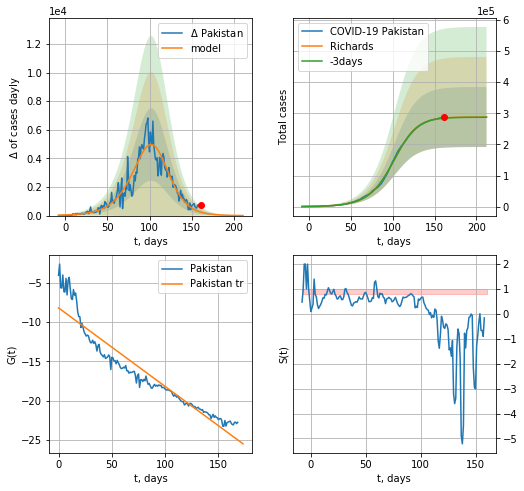

Pakistan data at: 2020-11-12
+3 day model MAPE: 0.002417
model: Richards
coeffs: [2.88169103e+05 5.68558279e-02 1.06265073e+02 1.33731169e+00]
rational stdev: 0.335042
forecast at the end of period: +51 days
	 deltaDaycases: 5
	 total cases: 288099 ± 96525
	 total death: 5799 ± 5828
trend coefficient of determination: 0.903657
 intercept: -8.180854
 slope: -0.100161


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


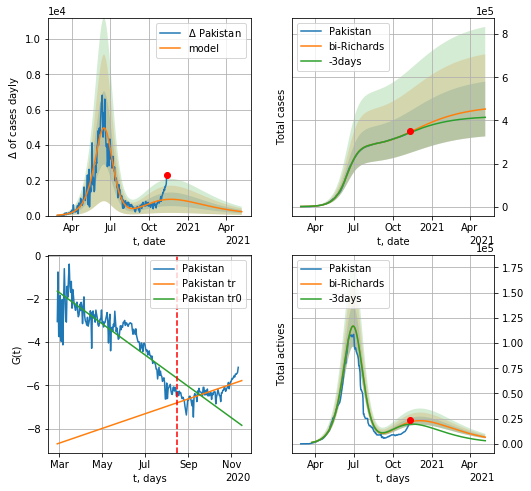

Pakistan data at: 2020-11-12
+3 day model MAPE: 0.007172
model: bi-Richards
coeffs: [ 1.81410066e+05  1.29612605e+00 -6.57461465e+01  1.07334784e-02]
rational stdev: 0.280516
forecast at the end of period: +177 days
	 deltaDaycases: 223
	 total cases: 452841 ± 127029
	 total death: 9116 ± 7671
bi-Richards approximation splitting point: 170
trend coefficient of determination: 0.746800
 intercept: -1.643793
 slope: -0.023592
trend coefficient of determination: 0.494325
 intercept: -8.703996
 slope: 0.011109


In [1503]:
vL = 170#25
x = forecastRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Pakistan',dfPS[:],d12f(1),58*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
245 2020-11-08  421921.0   76061  6092.0
246 2020-11-09  422769.0   76061  6092.0
247 2020-11-10  423620.0   76096  6108.0
248 2020-11-11  425353.0   76095  6127.0
249 2020-11-12  427198.0   76190  6140.0


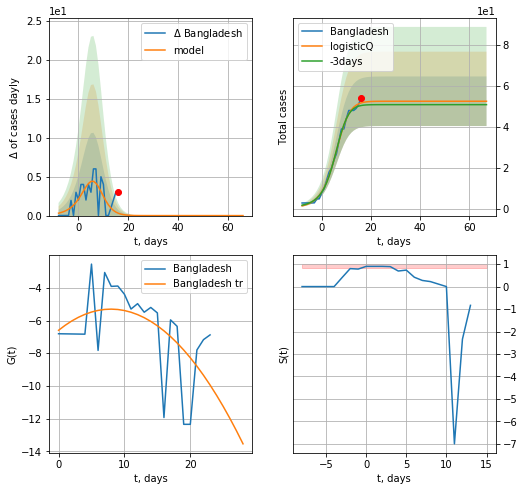

Bangladesh data at: 2020-11-12
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


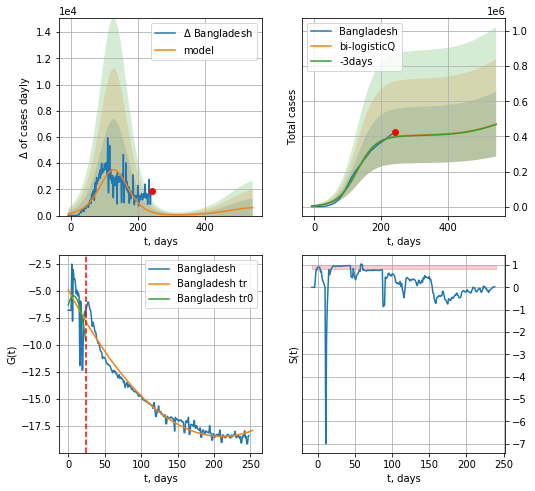

Bangladesh data at: 2020-11-12
+3 day model MAPE: 0.006792
model: bi-logisticQ
coeffs: [ 4.06719484e+05  7.30491749e-08  1.28081177e+02 -4.70872221e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.392792
forecast at the end of period: +303 days
	 deltaDaycases: 613
	 total cases: 469956 ± 184595
	 total death: 6754 ± 7958
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.970603
 intercept_: -4.913387870547547
 coeffs_: [ 0.         -0.12880521  0.00030574]


In [1375]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


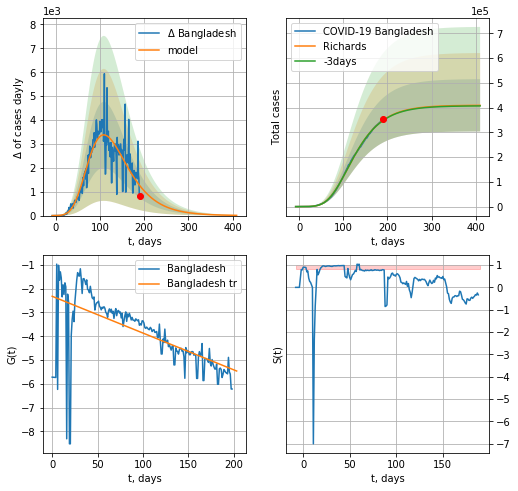

Bangladesh data at: 2020-11-12
+3 day model MAPE: 0.002602
model: Richards
coeffs: [ 4.09448499e+05  1.69324920e+00 -8.20191843e+01  1.33360757e-02]
rational stdev: 0.258135
forecast at the end of period: +219 days
	 deltaDaycases: 10
	 total cases: 408989 ± 105574
	 total death: 5878 ± 4551
trend coefficient of determination: 0.402732
 intercept: -2.317249
 slope: -0.015497


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


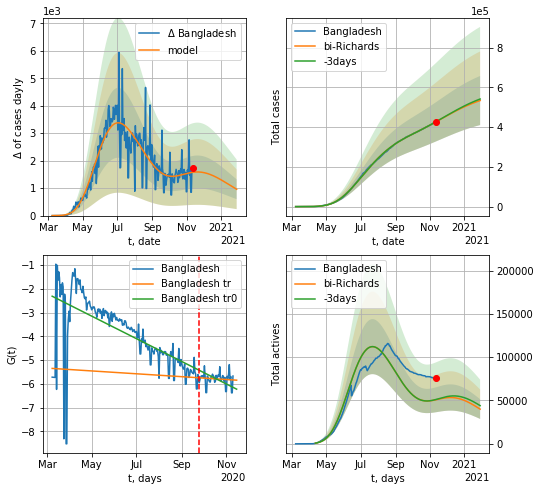

Bangladesh data at: 2020-11-12
+3 day model MAPE: 0.000825
model: bi-Richards
coeffs: [1.83453581e+05 1.43922300e+00 3.81032435e+01 1.32340015e-02]
rational stdev: 0.231375
forecast at the end of period: +79 days
	 deltaDaycases: 958
	 total cases: 534142 ± 123587
	 total death: 7677 ± 5328
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.407094
 intercept: -2.314678
 slope: -0.015524
trend coefficient of determination: 0.010695
 intercept: -5.353756
 slope: -0.001964


In [1380]:
vL=200
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date     cases  active  death
258 2020-11-08  131743.0    8356  811.0
259 2020-11-09  132478.0    8348  816.0
260 2020-11-10  133381.0    8404  821.0
261 2020-11-11  134159.0    8428  826.0
262 2020-11-12  134932.0    8509  830.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


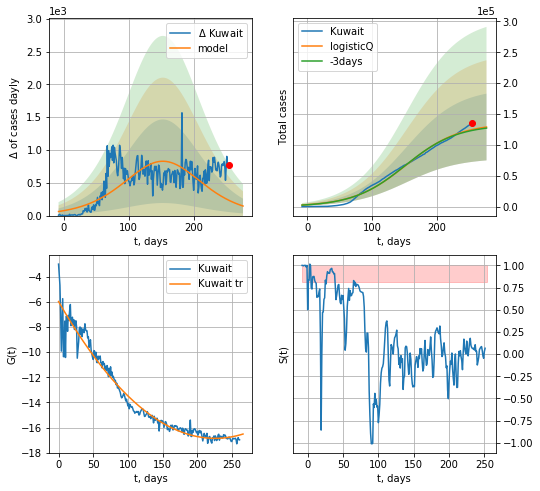

Kuwait data at: 2020-11-12
+3 day model MAPE: 0.011313
model: logisticQ
coeffs: [ 1.35090928e+05  4.97825058e-08  1.53045874e+02 -4.92774661e+05]
rational stdev: 0.419271
forecast at the end of period: +23 days
	 deltaDaycases: 145
	 total cases: 128938 ± 54060
	 total death: 793 ± 997
trend coefficient of determination: 0.957494
 intercept_: -5.980206335613287
 coeffs_: [ 0.         -0.09632975  0.00021331]


In [1381]:
try:
    dfKW = read_df(pd.DataFrame(),"KW")
    x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


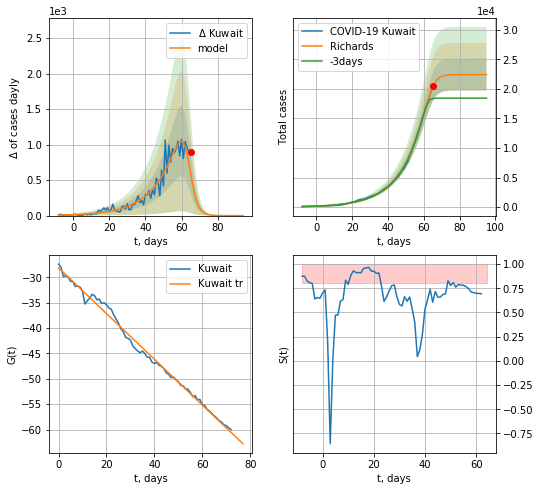

Kuwait data at: 2020-11-12
+3 day model MAPE: 0.136577
model: Richards
coeffs: [2.24365718e+04 7.66634183e-02 6.43548409e+01 5.72971780e+00]
rational stdev: 0.119998
forecast at the end of period: +30 days
	 deltaDaycases: 0
	 total cases: 22436 ± 2692
	 total death: 138 ± 49
trend coefficient of determination: 0.993036
 intercept: -28.143720
 slope: -0.450232


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


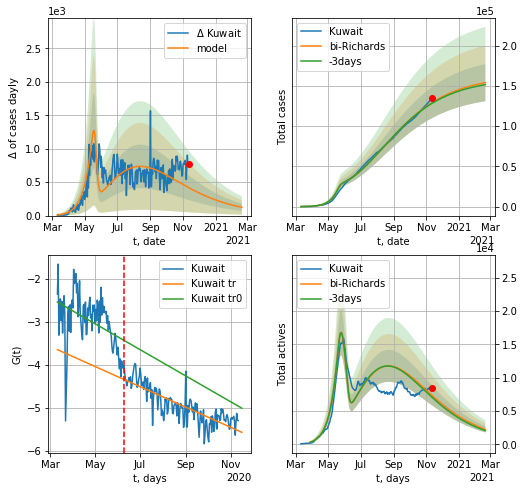

Kuwait data at: 2020-11-12
+3 day model MAPE: 0.007221
model: bi-Richards
coeffs: [ 1.40574225e+05  1.31114613e+00 -1.68236461e+02  1.09138916e-02]
rational stdev: 0.149938
forecast at the end of period: +100 days
	 deltaDaycases: 124
	 total cases: 154107 ± 23106
	 total death: 947 ± 425
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.170836
 intercept: -2.540744
 slope: -0.009854
trend coefficient of determination: 0.667761
 intercept: -3.644356
 slope: -0.007677


In [1504]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Kuwait',dfKW[iL:],d1,47*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL,amc=0.5)

DM
           date     cases  active   death
252 2020-11-08  130182.0   19896  2265.0
253 2020-11-09  130603.0   19953  2267.0
254 2020-11-10  131131.0   20097  2269.0
255 2020-11-11  131265.0   19936  2272.0
256 2020-11-12  131636.0   20227  2274.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


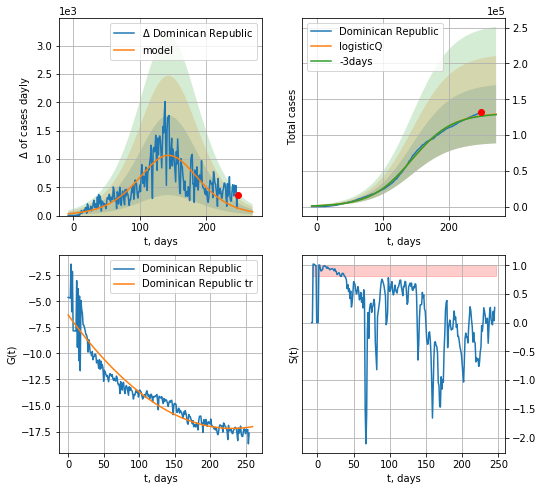

Dominican Republic data at: 2020-11-12
+3 day model MAPE: 0.004137
model: logisticQ
coeffs: [ 1.31087925e+05  2.71467191e-07  1.43579072e+02 -1.19383555e+05]
rational stdev: 0.315124
forecast at the end of period: +23 days
	 deltaDaycases: 66
	 total cases: 129031 ± 40660
	 total death: 2229 ± 2107
trend coefficient of determination: 0.911128
 intercept_: -6.3128422563502955
 coeffs_: [ 0.         -0.09422329  0.00020396]


In [1383]:
try:
    dfDM = read_df(pd.DataFrame(),"DM")
    x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


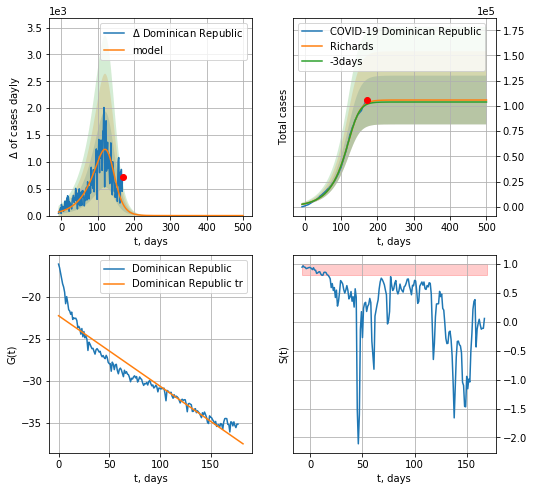

Dominican Republic data at: 2020-11-12
+3 day model MAPE: 0.011313
model: Richards
coeffs: [1.05835362e+05 2.63609615e-02 1.34410899e+02 2.61091122e+00]
rational stdev: 0.228213
forecast at the end of period: +331 days
	 deltaDaycases: 0
	 total cases: 105835 ± 24153
	 total death: 1828 ± 1251
trend coefficient of determination: 0.908946
 intercept: -22.261295
 slope: -0.083964


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


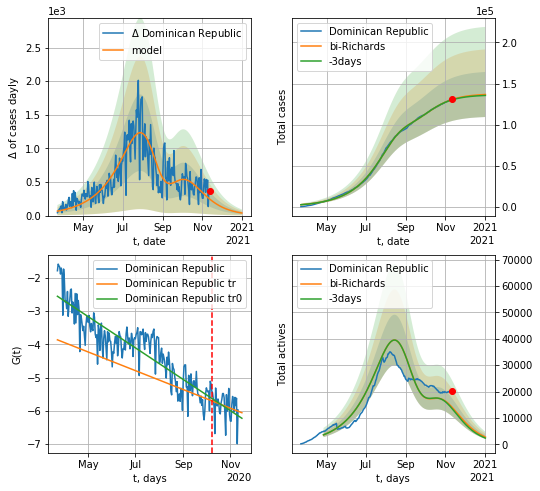

Dominican Republic data at: 2020-11-12
+3 day model MAPE: 0.003539
model: bi-Richards
coeffs: [3.17701876e+04 4.56832650e+00 7.80478182e+01 9.01352269e-03]
rational stdev: 0.200622
forecast at the end of period: +51 days
	 deltaDaycases: 38
	 total cases: 136680 ± 27421
	 total death: 2361 ± 1421
bi-Richards approximation splitting point: 200
trend coefficient of determination: 0.784492
 intercept: -2.556907
 slope: -0.015349
trend coefficient of determination: 0.057575
 intercept: -3.866482
 slope: -0.009172


In [1385]:
vL = 200+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RRD('Dominican Republic',dfDM[21:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active   death
246 2020-11-08  82346.0   17945  1893.0
247 2020-11-09  82677.0   17119  1912.0
248 2020-11-10  83592.0   16836  1930.0
249 2020-11-11  84707.0   16642  1950.0
250 2020-11-12  86038.0   16799  1969.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


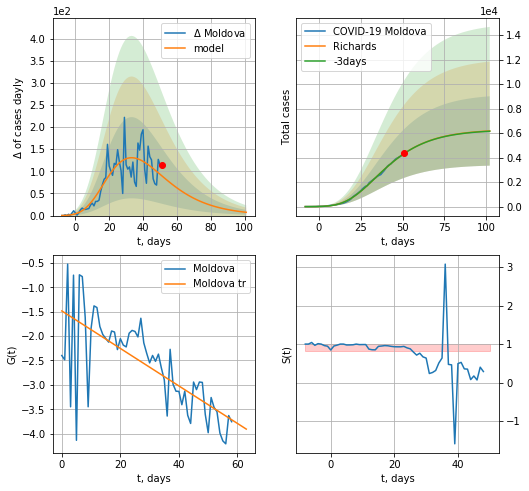

Moldova data at: 2020-11-12
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +51 days
	 deltaDaycases: 7
	 total cases: 6176 ± 2830
	 total death: 141 ± 193
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


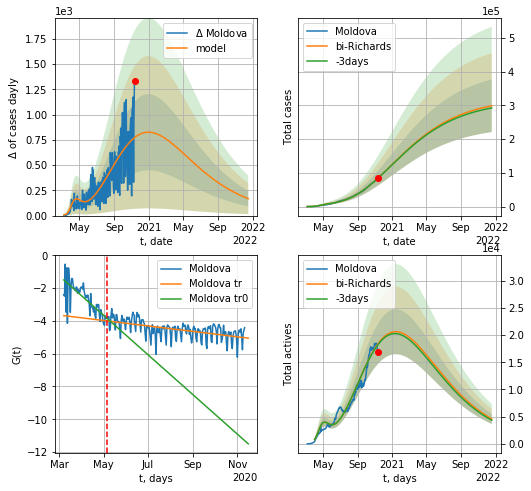

Moldova data at: 2020-11-12
+3 day model MAPE: 0.002614
model: bi-Richards
coeffs: [ 3.16630867e+05  3.40123743e-01 -2.48079300e+02  2.10712936e-02]
rational stdev: 0.260678
forecast at the end of period: +401 days
	 deltaDaycases: 167
	 total cases: 298627 ± 77845
	 total death: 6834 ± 5344
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.538431
 intercept: -1.500157
 slope: -0.039356
trend coefficient of determination: 0.314070
 intercept: -3.677271
 slope: -0.005404


In [1505]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Moldova",dfMD[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.75)
except:
    print("Exception occurs")

In [1387]:
#np.diff(dfAF["cases"])

AF
           date     cases  active    death
248 2020-11-08  737278.0   37781  19809.0
249 2020-11-09  738525.0   37954  19845.0
250 2020-11-10  740254.0   37109  19951.0
251 2020-11-11  742394.0   35925  20011.0
252 2020-11-12  744732.0   33753  20076.0


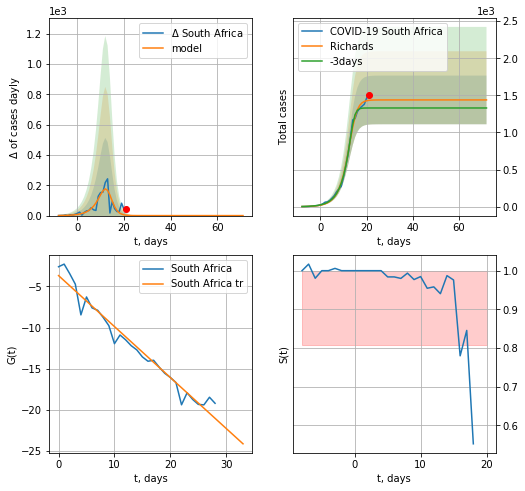

South Africa data at: 2020-11-12
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 38 ± 25
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide


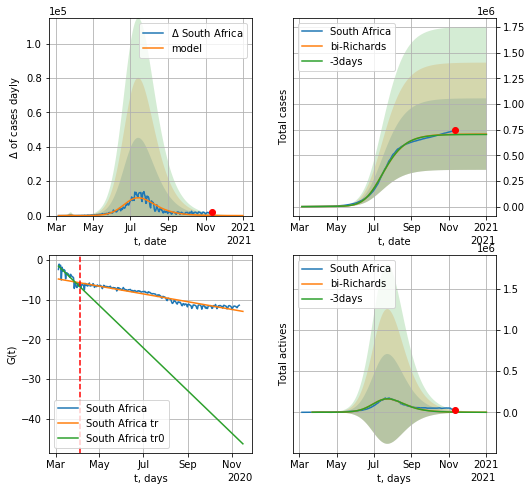

South Africa data at: 2020-11-12
+3 day model MAPE: 0.004765
model: bi-Richards
coeffs: [7.05904216e+05 1.14980813e-01 1.05016275e+02 4.18176518e-01]
rational stdev: 0.492856
forecast at the end of period: +51 days
	 deltaDaycases: 8
	 total cases: 707160 ± 348527
	 total death: 19063 ± 28185
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.757084
 intercept: -1.581810
 slope: -0.174437
trend coefficient of determination: 0.929460
 intercept: -4.836240
 slope: -0.031755


In [1507]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("South Africa",dfAF[:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.5)
except:
    print("Exception occurs")

UB
           date  cases  active  death
238 2020-11-08  68788    2232  585.0
239 2020-11-09  69027    2245  588.0
240 2020-11-10  69173    2151  589.0
241 2020-11-11  69397    2134  591.0
242 2020-11-12  69617    2138  593.0


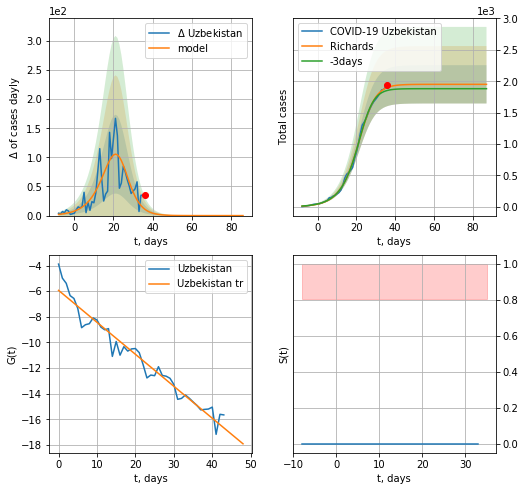

Uzbekistan data at: 2020-11-12
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 1950 ± 304
	 total death: 16 ± 7
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:336: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


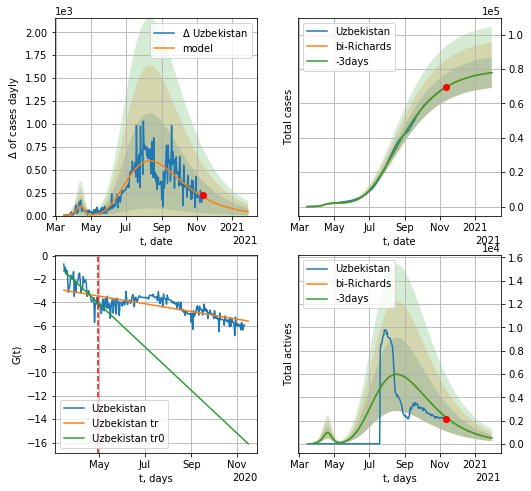

Uzbekistan data at: 2020-11-12
+3 day model MAPE: 0.000105
model: bi-Richards
coeffs: [ 7.79691643e+04  1.12073330e+00 -4.74031286e+01  1.87771231e-02]
rational stdev: 0.113808
forecast at the end of period: +79 days
	 deltaDaycases: 43
	 total cases: 77838 ± 8858
	 total death: 663 ± 226
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.596256
 intercept: -1.305591
 slope: -0.060188
trend coefficient of determination: 0.534276
 intercept: -2.965323
 slope: -0.010713


In [1509]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Uzbekistan",dfUB[:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL,amc=0.33)
except:
    print("Exception occurs")

In [1390]:
dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAFG['active'] = np.zeros(len(dfAFG))
#dfAFG.tail()

AFG
           date  cases  active   death
222 2020-11-08  42239  6211.0  1565.0
223 2020-11-09  42463  5932.0  1577.0
224 2020-11-10  42609  6061.0  1581.0
225 2020-11-11  42795  6180.0  1591.0
226 2020-11-12  42969  6338.0  1595.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


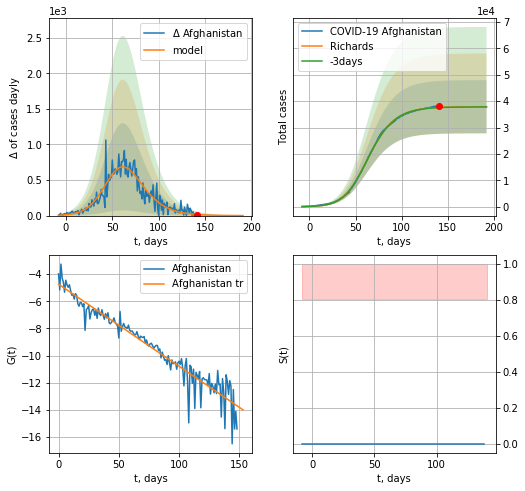

Afghanistan data at: 2020-11-12
+3 day model MAPE: 0.002095
model: Richards
coeffs: [3.79142308e+04 1.10640933e-01 5.26336374e+01 5.65351441e-01]
rational stdev: 0.266062
forecast at the end of period: +51 days
	 deltaDaycases: 0
	 total cases: 37903 ± 10084
	 total death: 1406 ± 1122
trend coefficient of determination: 0.920101
 intercept: -4.739385
 slope: -0.060561


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:475: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


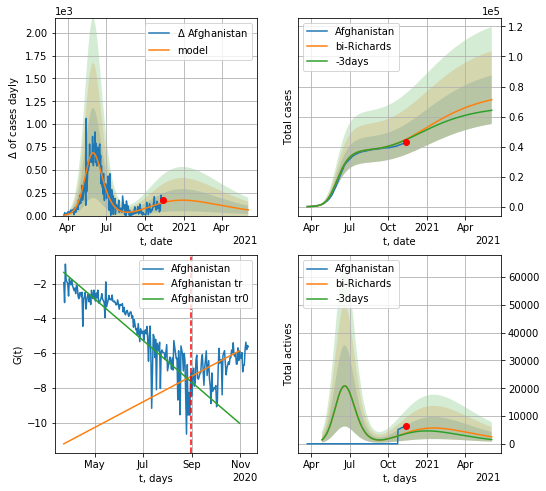

Afghanistan data at: 2020-11-12
+3 day model MAPE: 0.002560
model: bi-Richards
coeffs: [ 3.89469276e+04  1.02665153e+00 -1.03826790e+02  1.15395008e-02]
rational stdev: 0.227084
forecast at the end of period: +219 days
	 deltaDaycases: 62
	 total cases: 71201 ± 16168
	 total death: 2642 ± 1799
bi-Richards approximation splitting point: 150
trend coefficient of determination: 0.788694
 intercept: -1.352035
 slope: -0.039145
trend coefficient of determination: 0.284867
 intercept: -11.228544
 slope: 0.024161


In [1391]:
#dfAFG = read_df(pd.DataFrame(),"AFG").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 150 + 8
    x = forecastRR("Afghanistan",dfAFG[8:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RRD("Afghanistan",dfAFG[8:],d1,64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-8)
except:
    print("Exception occurs")

In [795]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [1014]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707, 707]


In [1015]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"12,867,459","+6,033","372,106",633,"8,224,098","+4,968","4,271,255","23,086",,,,,,North America,\n,,
1,,\nAsia\n,"14,816,700","+11,952","261,788",141,"13,221,391","+9,841","1,333,521","24,073",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,209,560",113,"306,911",7,"9,231,268",419,"671,381","17,458",,,,,,South America,\n,,
3,,\nEurope\n,"13,256,061","+43,869","311,753",815,"4,893,055","+25,632","8,051,253","28,603",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,946,369",,"46,626",,"1,641,278",,"258,465","2,509",,,,,,Africa,\n,,
5,,\n Oceania\n,"41,865",7,993,,"32,879",8,"7,993",24,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"53,138,735","+61,974","1,300,192","+1,596","37,244,628","+40,868","14,593,915","95,757","6,817",166.8,,,,All,\n,,
8,1,USA,"10,873,936",,"248,585",,"6,728,120",,"3,897,231","19,261","32,781",749,"163,454,705","492,754","331,716,877",North America,31,"1,334",2
9,2,India,"8,728,795",895,"128,686",,"8,115,580","+2,235","484,529","8,944","6,302",93,"123,101,739","88,884","1,384,974,946",Asia,159,"10,762",11


In [1016]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"12,867,459","+6,033","372,106",633,"8,224,098","+4,968","4,271,255","23,086",,,,,,North America,\n,,
1,,\nAsia\n,"14,816,700","+11,952","261,788",141,"13,221,391","+9,841","1,333,521","24,073",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,209,560",113,"306,911",7,"9,231,268",419,"671,381","17,458",,,,,,South America,\n,,
3,,\nEurope\n,"13,256,061","+43,869","311,753",815,"4,893,055","+25,632","8,051,253","28,603",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,946,369",,"46,626",,"1,641,278",,"258,465","2,509",,,,,,Africa,\n,,


In [1017]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
95,88,Lithuania,"29,812",,244,,"7,096",,"22,472",83,"11,009",90,"1,146,969","423,544","2,708,028",Europe,91,"11,098",2
332,89,Lithuania,"29,812","+1,553",244,9,"7,096",488,"22,472",83,"11,009",90,"1,146,969","423,544","2,708,028",Europe,91,"11,098",2
568,89,Lithuania,"28,259","+1,418",235,14,"6,608",646,"21,416",72,"10,435",87,"1,132,514","418,206","2,708,028",Europe,96,"11,524",2


In [1018]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

235


In [1019]:
df.head(55)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"12,867,459","+6,033","372,106",633,"8,224,098","+4,968","4,271,255","23,086",,,,,,North America,\n,,
1,,\nAsia\n,"14,816,700","+11,952","261,788",141,"13,221,391","+9,841","1,333,521","24,073",,,,,,Asia,\n,,
2,,\nSouth America\n,"10,209,560",113,"306,911",7,"9,231,268",419,"671,381","17,458",,,,,,South America,\n,,
3,,\nEurope\n,"13,256,061","+43,869","311,753",815,"4,893,055","+25,632","8,051,253","28,603",,,,,,Europe,\n,,
4,,\nAfrica\n,"1,946,369",,"46,626",,"1,641,278",,"258,465","2,509",,,,,,Africa,\n,,
5,,\n Oceania\n,"41,865",7,993,,"32,879",8,"7,993",24,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,659,,47,4,,,,,,,\n,,
7,,World,"53,138,735","+61,974","1,300,192","+1,596","37,244,628","+40,868","14,593,915","95,757","6,817",166.8,,,,All,\n,,
8,1,USA,"10,873,936",,"248,585",,"6,728,120",,"3,897,231","19,261","32,781",749,"163,454,705","492,754","331,716,877",North America,31,"1,334",2
9,2,India,"8,728,795",895,"128,686",,"8,115,580","+2,235","484,529","8,944","6,302",93,"123,101,739","88,884","1,384,974,946",Asia,159,"10,762",11


In [1020]:
df.at[14, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[30, 'TotalRecovered'] = 0
df.at[45, 'TotalRecovered'] = 0
#df.at[109, 'TotalRecovered'] = 0
df.at[14,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[30,"ActiveCases"] = 0
df.at[45,"ActiveCases"] = 0
#df.at[109,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [1021]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nAsia\n,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,\nSouth America\n,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,\nEurope\n,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,1946369,NaN,46626.0,NaN,1641278.0,,258465,2509.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\n Oceania\n,41865,7.0,993.0,NaN,32879.0,8,7993,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,53138735,61974.0,1300192.0,1596.0,37244628.0,"+40,868",14593915,95757.0,6817.0,166.8,NaN,NaN,,All,\n,,
8,1,USA,10873936,NaN,248585.0,NaN,6728120.0,,3897231,19261.0,32781.0,749.0,163454705.0,492754.0,"331,716,877",North America,31,"1,334",2
9,2,India,8728795,895.0,128686.0,NaN,8115580.0,"+2,235",484529,8944.0,6302.0,93.0,123101739.0,88884.0,"1,384,974,946",Asia,159,"10,762",11


In [1022]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
230,,Total:,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,,Europe,,,
231,,Total:,1946369,NaN,46626.0,NaN,1641278.0,,258465,2509.0,NaN,NaN,NaN,NaN,,Africa,,,
232,,Total:,41865,7.0,993.0,NaN,32879.0,,7993,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
233,,Total:,721,NaN,15.0,NaN,659.0,,47,4.0,NaN,NaN,NaN,NaN,,,,,
234,NaN,European Union,8851422,10099.0,207469.0,232.0,2321080.0,NaN,4291074,23726.0,19879.644653,465.960158,130784223.0,293731.77321,NaN,Europe,NaN,NaN,NaN


In [1023]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1946369,NaN,46626.0,NaN,1641278.0,,258465,2509.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [1024]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [1025]:
#df

In [1026]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,12867459,6033.0,372106.0,633.0,8224098.0,"+4,968",4271255,23086.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,Asia,14816700,11952.0,261788.0,141.0,13221391.0,"+9,841",1333521,24073.0,NaN,NaN,NaN,NaN,,Asia,\n,,
2,,South America,10209560,113.0,306911.0,7.0,9231268.0,419,671381,17458.0,NaN,NaN,NaN,NaN,,South America,\n,,
3,,Europe,13256061,43869.0,311753.0,815.0,4893055.0,"+25,632",8051253,28603.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,1946369,NaN,46626.0,NaN,1641278.0,,258465,2509.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,41865,7.0,993.0,NaN,32879.0,8,7993,24.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,53138735,61974.0,1300192.0,1596.0,37244628.0,"+40,868",14593915,95757.0,6817.0,166.8,NaN,NaN,,All,\n,,
8,1,USA,10873936,NaN,248585.0,NaN,6728120.0,,3897231,19261.0,32781.0,749.0,163454705.0,492754.0,"331,716,877",North America,31,"1,334",2
9,2,India,8728795,895.0,128686.0,NaN,8115580.0,"+2,235",484529,8944.0,6302.0,93.0,123101739.0,88884.0,"1,384,974,946",Asia,159,"10,762",11
10,3,Brazil,5783647,NaN,164332.0,NaN,5256767.0,,362548,8318.0,27139.0,771.0,21900000.0,102762.0,"213,114,648",South America,37,"1,297",10


In [1027]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [1028]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB",
    "Afghanistan":"AFG"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB
Afghanistan AFG


In [1029]:
len(countryDic)

77

In [1030]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-11-12,12867459,4271255,372106.0
Asia
Asia
Asia 2020-11-12,14816700,1333521,261788.0
South America
South America
South America 2020-11-12,10209560,671381,306911.0
Europe
Europe
Europe 2020-11-12,13256061,8051253,311753.0
Africa
Africa
Africa 2020-11-12,1946369,258465,46626.0
 Oceania
 Oceania
 Oceania 2020-11-12,41865,7993,993.0
World
World
World 2020-11-12,53138735,14593915,1300192.0
USA
USA
USA 2020-11-12,10873936,3897231,248585.0
India
India
India 2020-11-12,8728795,484529,128686.0
Brazil
Brazil
Brazil 2020-11-12,5783647,362548,164332.0
France
France
France 2020-11-12,1898710,1720796,42960.0
Russia
Russia
Russia 2020-11-12,1880551,441205,32443.0
Spain
Spain
Spain 2020-11-12,1484868,0,40461.0
UK
UK
UK 2020-11-12,1290195,0,50928.0
Argentina
Argentina
Argentina 2020-11-12,1284519,149557,34782.0
Colombia
Colombia
Colombia 2020-11-12,1174012,58830,33491.0
Italy
Italy
Italy 2020-11-12,1066401,635054,43589.0
Mexico
Mexico
Mexico 2020-11-12,9918

Martinique 2020-11-12,4732,4597,37.0
Guyana
Guyana
Guyana 2020-11-12,4662,908,138.0
Aruba
Aruba
Aruba 2020-11-12,4639,99,43.0
Belize
Belize
Belize 2020-11-12,4596,2008,75.0
Somalia
Somalia
Somalia 2020-11-12,4301,864,107.0
Thailand
Thailand
Thailand 2020-11-12,3861,104,60.0
Uruguay
Uruguay
Uruguay 2020-11-12,3795,629,63.0
Mali
Mali
Mali 2020-11-12,3792,731,138.0
Gambia
Gambia
Gambia 2020-11-12,3697,19,122.0
South Sudan
South Sudan
South Sudan 2020-11-12,2960,1611,59.0
Benin
Benin
Benin 2020-11-12,2844,286,43.0
Togo
Togo
Togo 2020-11-12,2605,730,60.0
Burkina Faso
Burkina Faso
Burkina Faso 2020-11-12,2586,108,67.0
Guinea-Bissau
Guinea-Bissau
Guinea-Bissau 2020-11-12,2419,121,43.0
Sierra Leone
Sierra Leone
Sierra Leone 2020-11-12,2387,497,74.0
Yemen
Yemen
Yemen 2020-11-12,2071,72,605.0
Lesotho
Lesotho
Lesotho 2020-11-12,2026,953,44.0
New Zealand
New Zealand
New Zealand 2020-11-12,1995,53,25.0
Chad
Chad
Chad 2020-11-12,1578,50,100.0
Liberia
Liberia
Liberia 2020-11-12,1468,74,82.0
Niger
Nig

In [1031]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [1032]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-11-12,10873936,3897231,248585.0

append data/coronaIT.csv 2020-11-12,1066401,635054,43589.0

append data/coronaSP.csv 2020-11-12,1484868,0,40461.0

append data/coronaGR.csv 2020-11-12,749638,269562,12276.0

append data/coronaFR.csv 2020-11-12,1898710,1720796,42960.0

append data/coronaIN.csv 2020-11-12,726585,144898,40121.0

append data/coronaGB.csv 2020-11-12,1290195,0,50928.0

append data/coronaSZ.csv 2020-11-12,250396,106180,3216.0

append data/coronaKR.csv 2020-11-12,28133,2108,488.0

append data/coronaNG.csv 2020-11-12,27228,15074,291.0

append data/coronaSW.csv 2020-11-12,171365,0,6122.0

append data/coronaIS.csv 2020-11-12,322159,8848,2706.0

append data/coronaDK.csv 2020-11-12,58963,13515,755.0

append data/coronaPL.csv 2020-11-12,641496,378067,9080.0

append data/coronaES.csv 2020-11-12,6881,2352,76.0

append data/coronaUkr.csv 2020-11-12,512652,269486,9317.0

append data/coronaLV.csv 2020-11-12,9381,7759,107.0

append data/coronaLT.csv 2020-11-12

In [1033]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [1034]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF","Afghanistan":"AFG"}
    
for  c in cD3:#countryDic1:
    if c != "Afghanistan":
        continue
    dfc = pd.read_csv("data/europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/data1/corona%s.csv'%(cD3[c]), index=False)#countryDic1

Afghanistan 42609


In [582]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [583]:
dfc.tail()#[['date', 'cases']]

,date,day,month,year,cases,deaths,countriesAndTerritories,geoId,countryterritoryCode,popData2019,continentExp,Cumulative_number_for_14_days_of_COVID-19_cases_per_100000
4,2020-11-04,4,11,2020,41814,4,Afghanistan,AF,AFG,38041757.0,Asia,3.782685
3,2020-11-05,5,11,2020,41935,6,Afghanistan,AF,AFG,38041757.0,Asia,3.745884
2,2020-11-06,6,11,2020,41975,0,Afghanistan,AF,AFG,38041757.0,Asia,3.546103
1,2020-11-07,7,11,2020,42033,2,Afghanistan,AF,AFG,38041757.0,Asia,3.538217
0,2020-11-08,8,11,2020,42159,6,Afghanistan,AF,AFG,38041757.0,Asia,3.656508


In [584]:
date(2012, 3, 16)

datetime.date(2012, 3, 16)

In [585]:
len(countriesEU)

27

In [586]:
dfc = pd.read_csv("data/europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('data/corona%s_new.csv'%("EU"), index=False)

Afghanistan 7862826


In [3589]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [3590]:
#dfD

In [3591]:
#dfAll[dfAll['Country'].isin(cLst)]

In [3592]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

825115267.0 106088.67349825139


In [3593]:
TT/7.7776e3

106088.67349825139

In [3594]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

257921.18232119546

In [3595]:
sum(dfp.Population)/1e6

16014.157998

In [3596]:
dfAll[dfAll.TotalTests>0]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
7,1.0,USA,9475788,1877.0,236501.0,30.0,6104417.0,812,3134870,17205.0,28571.00000,713.000000,145042416.0,437324.000000,"331,658,650",North America,35,"1,402",2
8,2.0,India,8230711,1389.0,122651.0,9.0,7544798.0,"+1,893",563262,8944.0,5945.00000,89.000000,110743103.0,79984.000000,"1,384,567,503",Asia,168,"11,289",13
9,3.0,Brazil,5545705,0.0,160104.0,0.0,4980942.0,0,404659,8318.0,26028.00000,751.000000,21900000.0,102783.000000,"213,069,306",South America,38,"1,331",10
10,4.0,Russia,1655038,18257.0,28473.0,238.0,1236033.0,"+10,360",390532,2300.0,11339.00000,195.000000,61541970.0,421648.000000,"145,955,748",Europe,88,"5,126",2
11,5.0,France,1413915,0.0,37019.0,0.0,118227.0,0,1258669,3578.0,21645.00000,567.000000,16303968.0,249592.000000,"65,322,540",Europe,46,"1,765",4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
218,212.0,Solomon Islands,13,5.0,0.0,0.0,4.0,0,9,0.0,19.00000,0.000000,115.0,166.000000,"692,441",Australia/Oceania,"53,265",0,"6,021"
221,215.0,Anguilla,3,0.0,0.0,0.0,3.0,0,0,0.0,199.00000,0.000000,1329.0,88317.000000,"15,048",North America,"5,016",0,11
223,217.0,Wallis and Futuna,1,0.0,0.0,0.0,1.0,0,0,0.0,90.00000,0.000000,1046.0,93635.000000,"11,171",Australia/Oceania,"11,171",0,11
224,218.0,China,86021,24.0,4634.0,0.0,81024.0,20,363,12.0,60.00000,3.000000,160000000.0,111163.000000,"1,439,323,776",Asia,"16,732","310,601",9


In [3597]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [3598]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [3599]:
#cDicEU["Ireland"][1]

In [3600]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

257921.18232119546

In [3601]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [3602]:
#dfAll

In [3603]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

112540.02452969245

In [3604]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [3605]:
len(CList)

73

In [3606]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5610505190

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400